<a href="https://colab.research.google.com/github/juniorka/Mask_RCNN/blob/master/DCGANs_for_road_potholes_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# <center>DCGAN (Deep Convolutional Generative Adversarial Networks)</center>

## Introduction

&nbsp;&nbsp;&nbsp;I decided to make this notebook as a kind of summary to the methods that I applied in the [Generative Dog Images](https://www.kaggle.com/c/generative-dog-images) competiton as this was my first introduction to the thrilling world of <b>GANs</b>. I hope that this can be of some use to the reader in terms of training, optimizing and creating a robust <b>GAN</b> that can generalize well to new data. I will also try to provide more detailed explanations on the theory behind <b>GANs</b> and why they are so effective.

&nbsp;&nbsp;&nbsp;The main tools for this exercise will be <b>Tensorflow</b>(eager) and <b>Keras</b>(mainly for custom NN layers).

## Generative Adversarial Networks (GANs)

&nbsp;&nbsp;&nbsp;Unlike most popular neural network architectures, <b>GANs</b> are trained to solve two problems simultaneously - <b>discrimination</b> (effectively separating real from fake images) and <b>"realistic"       fake data generation</b> (effectively generating samples considered as real). As we can see these tasks are complete polar opposites but what would happen if we separated them into different models?

&nbsp;&nbsp;&nbsp;Well the general names for these models are <b>Generator (G)</b> and <b>Discriminator (D)</b> and are considered the building blocks behind the theory of <b>GANs</b>.

&nbsp;&nbsp;&nbsp;The <b>Generator</b> network takes as input a simple random noise N-dimensional vector and transforms it according to a learned target distribution. Its output is also N-dimensional. The <b>Discriminator</b> on the other hand models a probability distribution function (like a classifier) and outputs a probability that the input image is real or fake <b>[0, 1]</b>. With this in mind, we can define the two main goals of the generation task:

<b>1. Train G to maximise D's final classification error.</b> (So that the generated images are perceived as real).

<b>2. Train D to minimise the final classification error.</b> (So that real data is correctly distinguished from fake data).

&nbsp;&nbsp;&nbsp;To achieve this, during <b>backpropagation</b>, <b>G</b>'s weights will be updated using <b>Gradient Ascent</b> to maximise the error, while <b>D</b> will use <b>Gradient Descent</b> to minimise it.

![General structure of GANs](https://miro.medium.com/max/1132/1*t82vgL9KcDVpT4JqCb9Q4Q.png)

&nbsp;&nbsp;&nbsp;Note that the two networks don't use the true distribution of images directly during training but instead use each other's outputs to estimate their performance.

&nbsp;&nbsp;&nbsp;So how do we define a <b>loss function</b> that estimates the cumulative performance of the two networks? Well, we can use the <b>Absolute Error</b> to estimate <b>D</b>'s error and then we can reuse the same function for <b>G</b> but maximised:

$$ E(G,D) =  \frac{1}{2}\;(E_{x\subset{p_{t}}\;}[1 - D(x)] + E_{x\subset{p_{g}}\;}[D(x)]) $$
$$ E = \underset{G}{max} (\underset{D}{min}\;E(G,D)) $$

&nbsp;&nbsp;&nbsp;In this case, <b>$p_{t}$</b> represents the true distribution of images, while <b>$p_{g}$</b> is the distribution created from <b>G</b>.

&nbsp;&nbsp;&nbsp;We can observe that this theory is based on some key concepts of <b>Reinforcement Learning</b>. It can thought of as a two-player minimax game, where the two players are competing against each other and thus progressively improving in their respective tasks.

&nbsp;&nbsp;&nbsp;We saw the basic idea behind the theory of <b>GANs</b>. Now let's take one step further and learn how <b>DCGANs</b> work by applying ideas and methods from <b>Convolutional Neural Networks</b>.

## Deep Convolutional Generative Adversarial Networks (DCGANs)

&nbsp;&nbsp;&nbsp;<b>DCGANs</b> utilize some of the basic principles of <b>CNNs</b> and have thus become one of the most widely used architectures in practice, due to their fast convergence and also due to the fact that they can be very easily adapted into more complex variants (using labels as conditions, applying residual blocks and so on). Here are some of the more important problems that <b>DCGANs</b> solve:

- <b>D is created so that it basically solves a supervised image classification task.</b> (for this case dog or no dog)
- <b>The filters learned by the GAN can be utilized to draw specific objects in the generated image.</b>
- <b>G contains vectorized properties that can learn very complex semantic representations of objects.</b>

&nbsp;&nbsp;&nbsp;Here are some of the core guidelines to consider when creating a stable <b>DCGAN</b>, as opposed to a standard <b>CNN</b>(taken from the official [paper](https://arxiv.org/pdf/1511.06434.pdf)):

- <b>Replace Pooling functions with Strided convolutions.</b> (this allows <b>D</b> to learn its own spatial downsampling and <b>G</b> its respective upsampling without adding any bias to the model)
- <b>Use BatchNorm</b> (it stabilizes learning by normalizing the input to each unit to have zero mean and unit variance, this also helps to create more robust deep models without having the gradients diverging)
- <b>Avoid using Fully-Connected hidden layers (not output).</b> (example for this is global average pooling which seems to hurt convergence speed)
- <b>For G - use ReLU activations and Tanh for the output.</b> (tanh is generally the more preffered activation when you have an image as an output as it has a range of [-1, 1])
- <b>For D - use LeakyReLU activations (and a sigmoid function for the output probabilites).</b> (this is tested empirically and seems to work well for modelling to a higher resolution)

&nbsp;&nbsp;&nbsp;Here is the most standard structure of a <b>DCGAN generator</b>:
![DCGAN generator](https://miro.medium.com/max/875/1*KvMnRfb76DponICrHIbSdg.png)

&nbsp;&nbsp;&nbsp;As we can observe, its initial input is simply a <b>(1, 100)</b> noise vector, which passes through <b>4 Convolutional</b> layers with upsampling and a stride of <b>2</b> to produce a result RGB image of size (64, 64, 3). To achieve this, the input vector is projected onto a 1024-dimensional output to match the input of the first <b>Conv</b> layer, which we will see more later on.

&nbsp;&nbsp;&nbsp;What would a standard discriminator look like? Well, about what you would expect, let's take a look:

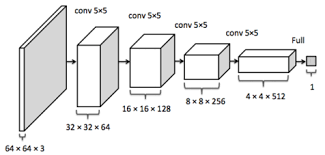

&nbsp;&nbsp;&nbsp;This time around we have an input image of <b>(64, 64, 3)</b>, same as <b>G</b>'s output. We pass it to <b>4 standard downsampling Conv layers</b>, again with a stride of <b>2</b>. In the final output layer, the image gets flattened to a vector, which is usually fed to a sigmoid function, which then outputs <b>D</b>'s prediction for that image <b>(a single value representing the probability in the range [0,1] - dog = 1 or no dog = 0)</b>.

&nbsp;&nbsp;&nbsp;Well, now you saw the basic idea behind <b>GANs</b> and <b>DCGANs</b>, so now we can proceed to generate some dogs :).

&nbsp;&nbsp;&nbsp;Let's first import some libraries and enable <b>Tensorflow's eager execution</b> by removing the computation graphs to speed up the computations.

## Importing libraries

In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt, zipfile
import os
import glob
import math
import random
import time
import datetime
import shutil
import imageio
from tqdm import tqdm, tqdm_notebook

from dataclasses import dataclass
from pathlib import Path
import warnings
from scipy import linalg

import xml.etree.ElementTree as ET 

import cv2
from PIL import Image

%tensorflow_version 1.x
import tensorflow as tf
from tensorflow.keras.initializers import RandomNormal
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, BatchNormalization, LeakyReLU, Reshape,\
Conv2DTranspose, Conv2D, Flatten, Dropout, Embedding, ReLU, UpSampling2D, Activation, ZeroPadding2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.constraints import Constraint
from tensorflow.contrib.eager.python import tfe
from tensorflow.python.compiler import tensorrt as trt

#from IPython import display

# libraries for SpectralNorm
from tensorflow.keras import backend as K
from keras.engine import *
from keras.legacy import interfaces
from tensorflow.keras import activations
from tensorflow.keras import initializers
from tensorflow.keras import regularizers
from tensorflow.keras import constraints
from keras.utils.generic_utils import func_dump
from keras.utils.generic_utils import func_load
from keras.utils.generic_utils import deserialize_keras_object
from keras.utils.generic_utils import has_arg
from keras.utils import conv_utils


TensorFlow 1.x selected.


Using TensorFlow backend.


In [ ]:
tf.enable_eager_execution()

In [ ]:
tf.test.gpu_device_name()

'/device:GPU:0'

Let's also set some input paths and default variables for later.

### Google Colab dataset loading

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


## Setting input variables

In [ ]:
image_width = 128
image_height = 128
image_channels = 3
image_sample_size = 280
image_output_dir = './output_images/'
image_input_dir = '/content/drive/My Drive/DamageDetection/Road_Damage_Dataset_2019/'
OUT_DIR = Path(image_output_dir)
TRAIN_DIR = Path(image_input_dir)

## Image preprocessing and EDA

&nbsp;&nbsp;&nbsp;Before we proceed with creating the <b>GAN</b> model let's first do a quick exploration of the <b>Stanford Dogs</b> dataset, which we'll be using. Because we also have the annotations for each image, we can use them to map each dog image to its respective breed. To do that, we can first make a dictionary that maps the breed code in the file name to the actual breed name.

### Creating the image features

Here I'm going to use <b>OpenCV</b> for a quick function to read and transform the images to <b>RGB</b>.

In [ ]:
def read_image(src, gray = False):
    if gray:
        img = cv2.imread(src,cv2.IMREAD_GRAYSCALE)
    else:
        img = cv2.imread(src)
    if img is None:
        raise FileNotFoundError
    if not gray: 
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

In [ ]:
%cd /content
import zipfile
import os

DATA_PATH = '/content/drive/My Drive/DamageDetection/Road_Damage_Dataset_2019/'
zip_file = DATA_PATH + 'pothole.zip'

z = zipfile.ZipFile(zip_file, 'r')
z.extractall()

print(os.listdir())

/content
['.config', 'drive', 'pothole', 'sample_data']


In [ ]:
idlist_img_name = "/content/pothole/list_of_img_ids.txt"
idlist_seg_name = "/content/pothole/list_of_seg_ids.txt"
img_folder_path = "/content/pothole/train_img/"
seg_folder_path = "/content/pothole/seg_gt/"

In [ ]:
my_file = open(idlist_img_name, "r")
img_list = my_file.read().splitlines()
my_file.close()

print("Images count: ",len(img_list))
sample_size = len(img_list) 

Images count:  280


### Crop the images and apply scaling

&nbsp;&nbsp;&nbsp;If we look at the dataset, we can see that each annotation folder contains a list of <b>xml</b> files. These files are associated with a specific image and contain very useful information, mainly the bounding boxes around each dog in the image. There are also images with more than one dog in them and this allows us to accurately crop them and make a dataset that contains <b>single dogs only</b> images.

&nbsp;&nbsp;&nbsp;Here we can utilize the <b>xml</b> library to create a tree and find the relevant elements for that annotation. For each object we can extract the bounding box coordinates, crop the images and normalize the crop by <b>shrinking</b> or <b>expanding</b> it depending on the result <b>image width</b>. Finally, we'll save the images in a numpy array.

In [ ]:
def load_cropped_images(image_dict, image_ann_dic, sample_size, 
                        image_width=image_width, image_height=image_height, image_channels=image_channels, dilate = True, gray = True):
    c = np.empty((image_width,image_height,image_channels+1))
    crack_images_np = np.zeros((sample_size,image_width,image_height,image_channels+1))

    for i, (img_file, mask_file) in enumerate(zip(image_dict, image_ann_dict)):
        if image_channels==3:
            img = read_image(img_file)
        else:
            img = read_image(img_file, gray=gray)
        mask = read_image(mask_file,gray=True)

        if img.shape[1] > image_width:
            interpolation = cv2.INTER_AREA          # shrink
            if dilate:
              kernel = np.ones((2,2),np.uint8)*255
              mask = cv2.dilate(mask,kernel,iterations = 1)
        else:
            interpolation = cv2.INTER_CUBIC         # expansion

        c[:,:,:image_channels] = np.asarray(cv2.resize(img, (image_width,image_height), interpolation = interpolation))
        c[:,:,-1] = np.asarray(cv2.resize(mask, (image_width,image_height), interpolation = cv2.INTER_NEAREST))
        crack_images_np[i] = c
    return crack_images_np  

In [ ]:
image_dict = [img_folder_path + x for x in img_list] 

my_file = open(idlist_seg_name, "r")
seg_list = my_file.read().splitlines()
my_file.close()

image_ann_dict = [seg_folder_path + x for x in seg_list] 

start_time = time.time()
crack_images_np = load_cropped_images(image_dict,image_ann_dict,sample_size, image_channels=3, dilate = True, gray = False)
est_time = round(time.time() - start_time)
print("Feature loading time: {}.".format(str(datetime.timedelta(seconds=est_time))))

Feature loading time: 0:00:00.


*The features take about 2-3 mins to load. *

&nbsp;&nbsp;&nbsp;By trial, we can figure out that the result images with single dogs only are <b>22125</b> and thus we can specify the exact size of our numpy array. There are <b>120</b> different dog breeds.

In [ ]:
print('Loaded features shape: ', crack_images_np.shape)
print('Loaded labels: ', crack_images_np.shape[0])

Loaded features shape:  (280, 128, 128, 4)
Loaded labels:  280


&nbsp;&nbsp;&nbsp;Now that we have the features and labels, we can plot them in a square grid to see what the crops look like and to make sure that they are labeled correctly.

In [ ]:
def plot_features(features, label='crack', image_width=image_width, image_height=image_height, 
                image_channels=image_channels,
                examples=25): 
  
    if not math.sqrt(examples).is_integer():
        print('Please select a valid number of examples.')
        return
    
    imgs = []
    classes = []
    for i in range(examples):
        rnd_idx = np.random.randint(0, features.shape[0])
        imgs.append(features[rnd_idx, :, :, :image_channels])
        imgs.append(features[rnd_idx, :, :, -1])
    
    
    fig, axes = plt.subplots(round(math.sqrt(examples)), 2*round(math.sqrt(examples)),figsize=(15,15),
    subplot_kw = {'xticks':[], 'yticks':[]},
    gridspec_kw = dict(hspace=0, wspace=0))
    
    for i, ax in enumerate(axes.flat):
        if imgs[i].shape[-1] == 3:
            ax.imshow(imgs[i])
        else:
            ax.imshow(imgs[i],cmap='gray')


Note that we need to normalize the pixel values to make sure that the dogs are plotted correctly.

Plotting cropped images by their specified coordinates..


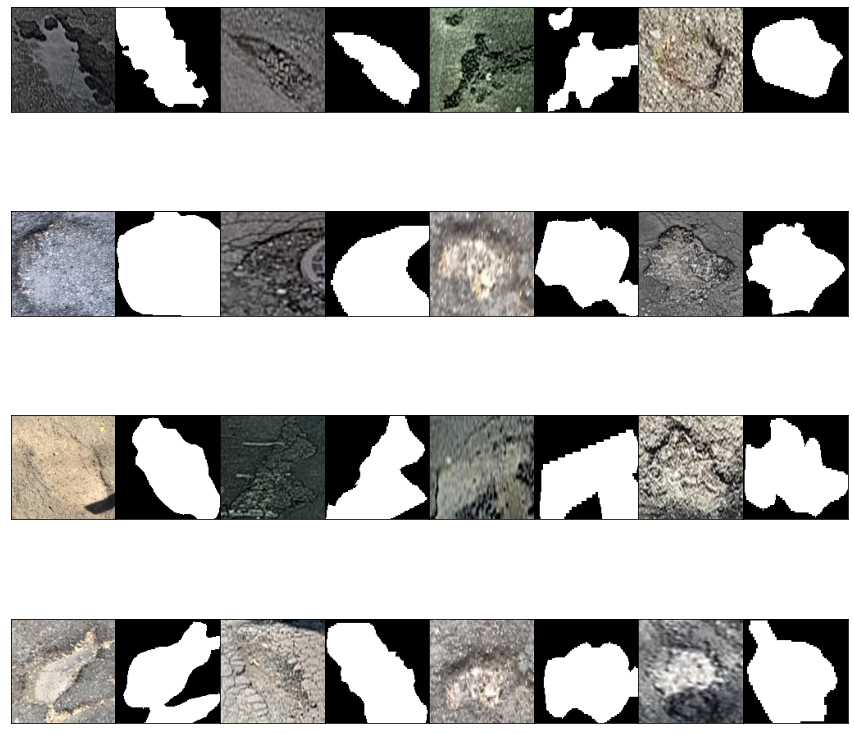

In [ ]:
print('Plotting cropped images by their specified coordinates..')
plot_features(crack_images_np / 255., examples=16)

The crops definitely are not perfect, but they do seem to capture only one dog in each image.

### Normalize the pixel values of the images

&nbsp;&nbsp;&nbsp;If you recall from the <b>DCGAN</b> guideline, the <b>Generator</b> is suggested to have a <b>Tanh</b> activation function for its output layer. This means that it produces values in the range <b>[-1, 1]</b> meaning that we also have to apply the same range to our features as a preprocessing step.

In [ ]:
crack_images_np = (crack_images_np - 127.5) / 127.5  # normalize the pixel range to [-1, 1] ((image - 127.5) / 127.5) or [0, 1] (image / 255.) alternatively

This is what the images would look like in the input layer of <b>D</b>.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Plotting cropped images by their specified coordinates..


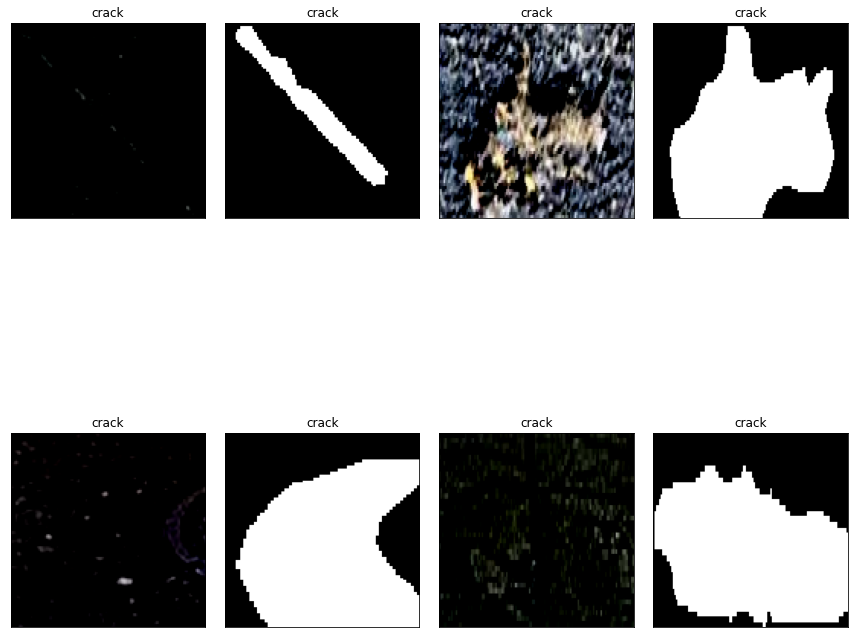

In [ ]:
print('Plotting cropped images by their specified coordinates..')
plot_features(crack_images_np, examples=4, disp_labels=True)

If we select a random image and print out the <b>max and min</b> we can see that the values are correct.

In [ ]:
print(np.max(crack_images_np[4,:,:,0]), np.min(crack_images_np[4,:,:,0]))

0.5215686274509804 -0.9058823529411765


In [ ]:
print(np.max(crack_images_np[4,:,:,-1]), np.min(crack_images_np[4,:,:-1]))

1.0 -1.0


### Deprocessing back to the original values

What if we want to return them back to normal? Easy, we just apply the reverse operations and plot them again.

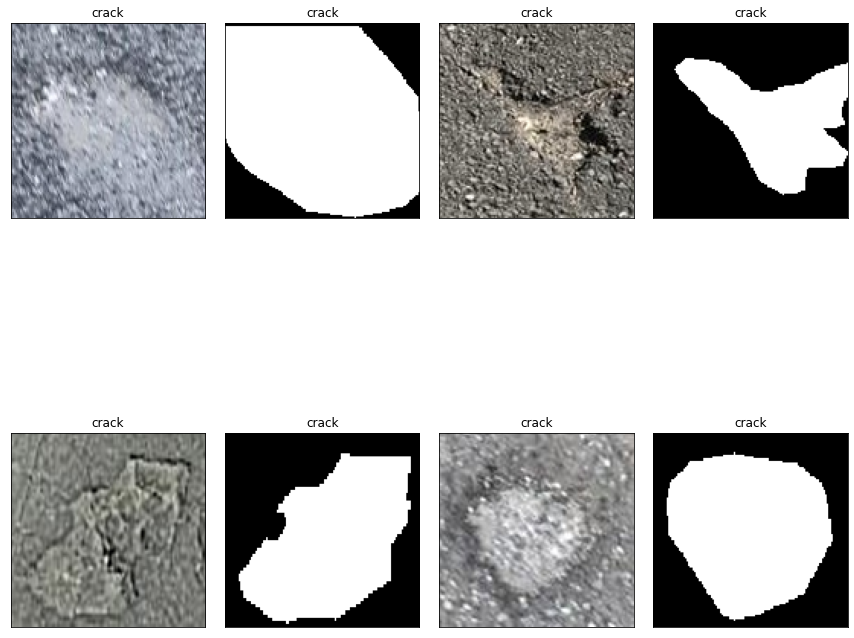

In [ ]:
plot_features((crack_images_np * 127.5 + 127.5) / 255., examples=4, disp_labels=True)

## Creating the image dataset

&nbsp;&nbsp;&nbsp;Now let's use our numpy array of features to construct a <b>Tensorflow</b> dataset object. First, we can convert the data types to <b>float32</b>, which always helps to preserve some memory.

In [ ]:
print("Crack features shape:", crack_images_np.shape)

Crack features shape: (280, 128, 128, 4)


In [ ]:
crack_features_tf = tf.cast(crack_images_np, 'float32')

### Data Augmentation

&nbsp;&nbsp;&nbsp;We could also apply <b>Data Augmentation</b> to our dataset. This includes random <b>horizontal flips</b>, zooming and cropping the image in random regions. Out of these, I found only the first method to be somewhat useful for adding some more variance to the dataset, as the other methods introduce a lot of noise.

&nbsp;&nbsp;&nbsp;So in this case, there will be a <b>50%</b> chance that an image in our dataset will be flipped from left to right.

In [ ]:
def flip(x: tf.Tensor) -> (tf.Tensor):
    x = tf.image.random_flip_left_right(x)
    x = tf.image.random_flip_up_down(x)
    return x

def zoom(x: tf.Tensor) -> (tf.Tensor):
    # Generate 20 crop settings, ranging from a 1% to 20% crop.
    scales = list(np.arange(0.7, 1.0, 0.01))
    boxes = np.zeros((len(scales), 4))

    for i, scale in enumerate(scales):
        x1 = y1 = 0.5 - (0.5 * scale)
        x2 = y2 = 0.5 + (0.5 * scale)
        boxes[i] = [x1, y1, x2, y2]

    def random_crop(img):
        # Create different crops for an image
        crops = tf.image.crop_and_resize([img], boxes=boxes, box_ind=np.zeros(len(scales)), crop_size=(64, 64))
        # Return a random crop
        return crops[tf.random_uniform(shape=[], minval=0, maxval=len(scales), dtype=tf.int32)]


    choice = tf.random_uniform(shape=[], minval=0., maxval=1., dtype=tf.float32)

    # Only apply cropping 50% of the time
    return (tf.cond(choice < 0.5, lambda: x, lambda: random_crop(x)))

### Set model hyperparameters

&nbsp;&nbsp;&nbsp;Here we have a whole list of hyperparameters that you can tune and play around with to try and improve the model. I've mostly gathered these values from research papers and experimented a bit with tweaking them and this is what I ended up with. Here's a list of things you could try out:

- <b>Sample size</b> - the number of features
- <b>Batch size</b> - 64 or 32 could improve performance, but are computationally heavy and you can only run the model for a small amount of epochs
- <b>Weight Init Std and Mean</b> - these values are come from research papers and seem to stabilize model training
- <b>Leaky ReLU slope</b> - the threshold for <b>D</b>'s activations, also seems robust
- <b>Downsize factor and Scale factor</b> - set up so that <b>G</b>'s noise vector can be reshaped to (4, 4, 512), other combinations might also work
- <b>Dropout</b> - amount of dropout layers, their placement and their rate could improve performance.
- <b>Learning rate and Learning rate decay</b> - very important to model convergence, hard to tune precisely, <b>G</b> and <b>D</b> can have different learning rates.
- <b>Noise vector shape</b> - usually 128 or 100 seems to be sufficient

In [ ]:
sample_size = 280
batch_size = 32
weight_init_std = 0.05
weight_init_mean = 0.0
leaky_relu_slope = 0.2
#downsize_factor = 2
downsize_factor = 2
dropout_rate = 0.5
#scale_factor = 4 ** downsize_factor
scale_factor = 4 ** downsize_factor
lr_initial_d = tfe.Variable(0.0001)
lr_initial_g = tfe.Variable(0.0002)
lr_decay_steps = 1000
noise_dim = 100

### Create tensorflow-type dataset

&nbsp;&nbsp;&nbsp;Now we can use <b>Tensorflow</b> to create the dataset by shuffling it, applying some augmentation, and finally separating it into batches of the specified <b>Batch size</b>.

In [ ]:
crack_features_data = tf.data.Dataset.from_tensor_slices(crack_features_tf).shuffle(sample_size).map(flip).batch(batch_size, drop_remainder=True)

In [ ]:
print(crack_features_data)

<DatasetV1Adapter shapes: (32, 128, 128, 4), types: tf.float32>


## Normalization techniques

### Weight Initialization

&nbsp;&nbsp;&nbsp;Before we actually make the <b>Generator</b>, let's see a few normalizations that can gradually speed up a <b>DCGAN</b>'s convergence. 

&nbsp;&nbsp;&nbsp;One of these methods is <b>Weight initialization</b>. It turns out that it's pretty important for training stable <b>GANs</b>. Firstly, the model weights need to be <b>zero-centered</b> with a slight increase of <b>std</b>(0.02). This stabilizes both <b>D</b> and <b>G</b> during training and prevents the model gradients from vanishing or exploding. This is a key step in every case, where we have to use random variables in our model (the random noise vector). 

&nbsp;&nbsp;&nbsp;Here is an example of how <b>Weight initialization</b> can seriously affect the learning process of a Neural Network.

![Weight Initialization example](https://intoli.com/blog/neural-network-initialization/img/training-losses.png)

&nbsp;&nbsp;&nbsp;We can also apply a <b>Truncated Normal</b> distribution using <b>Keras</b>, which will discard <b>values more than 2 standard deviations from the mean</b>. This could perhaps eliminate some outlier points during training.

In [ ]:
weight_initializer = tf.keras.initializers.TruncatedNormal(stddev=weight_init_std, mean=weight_init_mean,
                                                          seed=42)

### Spectral Normalization

&nbsp;&nbsp;&nbsp;<b>Spectral Normalization</b> is a new type of weight initialization, designed specifically for <b>GANs</b>, which seems to further stabilize model training (you can read more from this [paper](https://arxiv.org/pdf/1802.05957.pdf)). For a more detailed explanation on <b>Spectral Normalization</b> and why it works it also worth to check out this [post](https://christiancosgrove.com/blog/2018/01/04/spectral-normalization-explained.html), it has very intuitive examples.

&nbsp;&nbsp;&nbsp;<b>Spectral Normalization</b> of a single weight in our network can be defined as the following:

$$ \sigma(W) = ||Wv|| = u^{T}Wv $$
$$ W_{SN}(W) = \frac{W}{\sigma(W)} $$

&nbsp;&nbsp;&nbsp;Here $u$ and $v$ are simple random vectors of the same size. They are utilized to perform what's called a <b>power iteration</b> operation on the specific weight, for each learning step and it proves to be a lot more computationally efficient than simply penalizing the gradients.

&nbsp;&nbsp;&nbsp;Afterwards, in the backpropagation step, we use $W_{SN}(W)$ to update the weights instead of $W$.

&nbsp;&nbsp;&nbsp;For this project, I will reuse some custom <b>Keras</b> layers implemented by <b>IShengFang</b> ([official code](https://github.com/IShengFang/SpectralNormalizationKeras)), to apply <b>Spectral Normalization</b> on top of <b>Conv</b> and <b>Dense</b> layers.

&nbsp;&nbsp;&nbsp;Here is also a good example on the effect of <b>Spectral Normalization</b>:

<center><b>With SN</b></center>
![SNGAN](https://raw.githubusercontent.com/IShengFang/SpectralNormalizationKeras/master/img/generated_img_CIFAR10_resnet_SN_GP/loss.png)

<center><b>Without SN</b></center>
![StandardGAN](https://raw.githubusercontent.com/IShengFang/SpectralNormalizationKeras/master/img/generated_img_CIFAR10_resnet_noSN_GP/loss.png)

In [ ]:
class DenseSN(Dense):
    def build(self, input_shape):
        assert len(input_shape) >= 2
        input_dim = input_shape[-1]
        self.kernel = self.add_weight(shape=(input_dim, self.units),
                                      initializer=self.kernel_initializer,
                                      name='kernel',
                                      regularizer=self.kernel_regularizer,
                                      constraint=self.kernel_constraint)
        if self.use_bias:
            self.bias = self.add_weight(shape=(self.units,),
                                        initializer=self.bias_initializer,
                                        name='bias',
                                        regularizer=self.bias_regularizer,
                                        constraint=self.bias_constraint)
        else:
            self.bias = None
        self.u = self.add_weight(shape=tuple([1, self.kernel.shape.as_list()[-1]]),
                                 initializer=initializers.RandomNormal(0, 1),
                                 name='sn',
                                 trainable=False)
        self.input_spec = InputSpec(min_ndim=2, axes={-1: input_dim})
        self.built = True
        
    def call(self, inputs, training=None):
        def _l2normalize(v, eps=1e-12):
            return v / (K.sum(v ** 2) ** 0.5 + eps)
        def power_iteration(W, u):
            _u = u
            _v = _l2normalize(K.dot(_u, K.transpose(W)))
            _u = _l2normalize(K.dot(_v, W))
            return _u, _v
        W_shape = self.kernel.shape.as_list()
        #Flatten the Tensor
        W_reshaped = K.reshape(self.kernel, [-1, W_shape[-1]])
        _u, _v = power_iteration(W_reshaped, self.u)
        #Calculate Sigma
        sigma=K.dot(_v, W_reshaped)
        sigma=K.dot(sigma, K.transpose(_u))
        #normalize it
        W_bar = W_reshaped / sigma
        #reshape weight tensor
        if training in {0, False}:
            W_bar = K.reshape(W_bar, W_shape)
        else:
            with tf.control_dependencies([self.u.assign(_u)]):
                 W_bar = K.reshape(W_bar, W_shape)  
        output = K.dot(inputs, W_bar)
        if self.use_bias:
            output = K.bias_add(output, self.bias, data_format='channels_last')
        if self.activation is not None:
            output = self.activation(output)
        return output 

class ConvSN2D(Conv2D):

    def build(self, input_shape):
        if self.data_format == 'channels_first':
            channel_axis = 1
        else:
            channel_axis = -1
        if input_shape[channel_axis] is None:
            raise ValueError('The channel dimension of the inputs '
                             'should be defined. Found `None`.')
        input_dim = input_shape[channel_axis]
        kernel_shape = self.kernel_size + (input_dim, self.filters)

        self.kernel = self.add_weight(shape=kernel_shape,
                                      initializer=self.kernel_initializer,
                                      name='kernel',
                                      regularizer=self.kernel_regularizer,
                                      constraint=self.kernel_constraint)

        if self.use_bias:
            self.bias = self.add_weight(shape=(self.filters,),
                                        initializer=self.bias_initializer,
                                        name='bias',
                                        regularizer=self.bias_regularizer,
                                        constraint=self.bias_constraint)
        else:
            self.bias = None
            
        self.u = self.add_weight(shape=tuple([1, self.kernel.shape.as_list()[-1]]),
                         initializer=initializers.RandomNormal(0, 1),
                         name='sn',
                         trainable=False)
        
        # Set input spec.
        self.input_spec = InputSpec(ndim=self.rank + 2,
                                    axes={channel_axis: input_dim})
        self.built = True
    def call(self, inputs, training=None):
        def _l2normalize(v, eps=1e-12):
            return v / (K.sum(v ** 2) ** 0.5 + eps)
        def power_iteration(W, u):
            #Accroding the paper, we only need to do power iteration one time.
            _u = u
            _v = _l2normalize(K.dot(_u, K.transpose(W)))
            _u = _l2normalize(K.dot(_v, W))
            return _u, _v
        #Spectral Normalization
        W_shape = self.kernel.shape.as_list()
        #Flatten the Tensor
        W_reshaped = K.reshape(self.kernel, [-1, W_shape[-1]])
        _u, _v = power_iteration(W_reshaped, self.u)
        #Calculate Sigma
        sigma=K.dot(_v, W_reshaped)
        sigma=K.dot(sigma, K.transpose(_u))
        #normalize it
        W_bar = W_reshaped / sigma
        #reshape weight tensor
        if training in {0, False}:
            W_bar = K.reshape(W_bar, W_shape)
        else:
            with tf.control_dependencies([self.u.assign(_u)]):
                W_bar = K.reshape(W_bar, W_shape)
                
        outputs = K.conv2d(
                inputs,
                W_bar,
                strides=self.strides,
                padding=self.padding,
                data_format=self.data_format,
                dilation_rate=self.dilation_rate)
        if self.use_bias:
            outputs = K.bias_add(
                outputs,
                self.bias,
                data_format=self.data_format)
        if self.activation is not None:
            return self.activation(outputs)
        return outputs

class ConvSN2DTranspose(Conv2DTranspose):

    def build(self, input_shape):
        if len(input_shape) != 4:
            raise ValueError('Inputs should have rank ' +
                             str(4) +
                             '; Received input shape:', str(input_shape))
        if self.data_format == 'channels_first':
            channel_axis = 1
        else:
            channel_axis = -1
        if input_shape[channel_axis] is None:
            raise ValueError('The channel dimension of the inputs '
                             'should be defined. Found `None`.')
        input_dim = input_shape[channel_axis]
        kernel_shape = self.kernel_size + (self.filters, input_dim)

        self.kernel = self.add_weight(shape=kernel_shape,
                                      initializer=self.kernel_initializer,
                                      name='kernel',
                                      regularizer=self.kernel_regularizer,
                                      constraint=self.kernel_constraint)
        if self.use_bias:
            self.bias = self.add_weight(shape=(self.filters,),
                                        initializer=self.bias_initializer,
                                        name='bias',
                                        regularizer=self.bias_regularizer,
                                        constraint=self.bias_constraint)
        else:
            self.bias = None
            
        self.u = self.add_weight(shape=tuple([1, self.kernel.shape.as_list()[-1]]),
                         initializer=initializers.RandomNormal(0, 1),
                         name='sn',
                         trainable=False)
        
        # Set input spec.
        self.input_spec = InputSpec(ndim=4, axes={channel_axis: input_dim})
        self.built = True  
    
    def call(self, inputs):
        input_shape = K.shape(inputs)
        batch_size = input_shape[0]
        if self.data_format == 'channels_first':
            h_axis, w_axis = 2, 3
        else:
            h_axis, w_axis = 1, 2

        height, width = input_shape[h_axis], input_shape[w_axis]
        kernel_h, kernel_w = self.kernel_size
        stride_h, stride_w = self.strides
        if self.output_padding is None:
            out_pad_h = out_pad_w = None
        else:
            out_pad_h, out_pad_w = self.output_padding

        # Infer the dynamic output shape:
        out_height = conv_utils.deconv_length(height,
                                              stride_h, kernel_h,
                                              self.padding,
                                              out_pad_h)
        out_width = conv_utils.deconv_length(width,
                                             stride_w, kernel_w,
                                             self.padding,
                                             out_pad_w)
        if self.data_format == 'channels_first':
            output_shape = (batch_size, self.filters, out_height, out_width)
        else:
            output_shape = (batch_size, out_height, out_width, self.filters)
            
        #Spectral Normalization    
        def _l2normalize(v, eps=1e-12):
            return v / (K.sum(v ** 2) ** 0.5 + eps)
        def power_iteration(W, u):
            #Accroding the paper, we only need to do power iteration one time.
            _u = u
            _v = _l2normalize(K.dot(_u, K.transpose(W)))
            _u = _l2normalize(K.dot(_v, W))
            return _u, _v
        W_shape = self.kernel.shape.as_list()
        #Flatten the Tensor
        W_reshaped = K.reshape(self.kernel, [-1, W_shape[-1]])
        _u, _v = power_iteration(W_reshaped, self.u)
        #Calculate Sigma
        sigma=K.dot(_v, W_reshaped)
        sigma=K.dot(sigma, K.transpose(_u))
        #normalize it
        W_bar = W_reshaped / sigma
        #reshape weight tensor
        if training in {0, False}:
            W_bar = K.reshape(W_bar, W_shape)
        else:
            with tf.control_dependencies([self.u.assign(_u)]):
                W_bar = K.reshape(W_bar, W_shape)
        self.kernel = W_bar
        
        outputs = K.conv2d_transpose(
            inputs,
            self.kernel,
            output_shape,
            self.strides,
            padding=self.padding,
            data_format=self.data_format)

        if self.use_bias:
            outputs = K.bias_add(
                outputs,
                self.bias,
                data_format=self.data_format)

        if self.activation is not None:
            return self.activation(outputs)
        return outputs

&nbsp;&nbsp;&nbsp;Let's also define some template layers in <b>Keras</b>, so that we can create <b>G</b> and <b>D</b> more easily later on. The standard pattern for the layers will be:

<center><b>TP_Conv_Block = [(Conv(SN)2DTranspose (upsample)) -> (BatchNorm) -> (ReLU)]</b></center>

<center><b>Conv_Block = [(Conv(SN)2D (downsample)) -> (BatchNorm) -> (LeakyReLU)]</b></center>

In [ ]:
BN_MOMENTUM = 0.99

In [ ]:
def transposed_conv(model, out_channels, ksize, stride_size, ptype='same', function='relu'):
    model.add(Conv2DTranspose(out_channels, (ksize, ksize),
                              strides=(stride_size, stride_size), padding=ptype, 
                              kernel_initializer=weight_initializer, use_bias=False))
    model.add(BatchNormalization(momentum=BN_MOMENTUM))
    if function=='lrelu':
      model.add(LeakyReLU(alpha=alpha))
    if function=='relu':
      model.add(ReLU())
    return model

def transposed_convSN(model, out_channels, ksize, stride_size, ptype='same'):
    model.add(Conv2DTranspose(out_channels, (ksize, ksize), 
                              strides=(stride_size, stride_size), padding=ptype, 
                              kernel_initializer=weight_initializer, kernel_constraint=Spectral_Norm(), use_bias=False))
    model.add(BatchNormalization(momentum=BN_MOMENTUM))
    model.add(ReLU())
    return model

def convSN(model, out_channels, ksize, stride_size):
    model.add(Conv2D(out_channels, (ksize, ksize), strides=(stride_size, stride_size), padding='same',
              kernel_initializer=weight_initializer, kernel_constraint=Spectral_Norm(), use_bias=False))
    model.add(BatchNormalization(momentum=BN_MOMENTUM))
    model.add(LeakyReLU(alpha=leaky_relu_slope))
    #model.add(Dropout(dropout_rate))
    return model

def conv(model, out_channels, ksize, stride_size):
    model.add(Conv2D(out_channels, (ksize, ksize), strides=(stride_size, stride_size), padding='same',
                     kernel_initializer=weight_initializer, use_bias=False))
    model.add(BatchNormalization(momentum=BN_MOMENTUM))
    model.add(LeakyReLU(alpha=leaky_relu_slope))
    #model.add(Dropout(dropout_rate))
    return model

def upsampled_conv(model, out_channels, ksize, stride_size, ptype='same', function='relu', alpha=0.3):
    model.add(UpSampling2D())
    model.add(Conv2D(out_channels, (ksize, ksize), strides=(stride_size, stride_size), padding=ptype,
                     kernel_initializer=weight_initializer, use_bias=False))
    model.add(BatchNormalization(momentum=BN_MOMENTUM))
    if function=='lrelu':
      model.add(LeakyReLU(alpha=alpha))
    else:
      model.add(ReLU())

    return model

### Spectral Normalization Constraint
![alt text](https://discuss.pytorch.org/uploads/default/original/2X/d/d648f9e9c6547465033aeefbcaa751da5c461f22.png)

In [ ]:
POWER_ITERATIONS = 5

In [ ]:
def l2_normalize(x, eps=1e-12):
  '''
  Scale input by the inverse of it's euclidean norm
  '''
  return x / tf.linalg.norm(x + eps)

In [ ]:
class Spectral_Norm(Constraint):
    '''
    Uses power iteration method to calculate a fast approximation 
    of the spectral norm (Golub & Van der Vorst)
    The weights are then scaled by the inverse of the spectral norm
    '''
    def __init__(self, power_iters=POWER_ITERATIONS):
        self.n_iters = power_iters

    def __call__(self, w):
      flattened_w = tf.reshape(w, [w.shape[0], -1])
      u = tf.random.normal([flattened_w.shape[0]])
      v = tf.random.normal([flattened_w.shape[1]])
      for i in range(self.n_iters):
        v = tf.linalg.matvec(tf.transpose(flattened_w), u)
        v = l2_normalize(v)
        u = tf.linalg.matvec(flattened_w, v)
        u = l2_normalize(u)
      sigma = tf.tensordot(u, tf.linalg.matvec(flattened_w, v), axes=1)
      return w / sigma

    def get_config(self):
        return {'n_iters': self.n_iters}

## The Generator

&nbsp;&nbsp;&nbsp;We can finally define our generator. The model structure is mostly based on the official DCGAN [paper](https://arxiv.org/pdf/1511.06434.pdf) with a few tweaks that I found beneficial to the performance. Here is the overall structure:

<center><b>[Input(128, 1) -> Dense(2048,) -> Reshape(4, 4, 128) -> TP_Conv_Block(Depth=512, K=5x5, S=1x1) -> Dropout(0.5) -> TP_Conv_Block(Depth=256, K=5x5, S=2x2) -> Dropout(0.5) -> TP_Conv_Block(Depth=128, K=5x5, S=2x2) -> TP_Conv_Block(Depth=64, K=5x5, S=2x2) -> TP_Conv_Block(Depth=32, K=5x5, S=2x2) -> Dense(Depth=3, Tanh)]</b></center>

###Old

In [ ]:
def CrackGenerator():
    model = Sequential()
    model.add(Dense(image_width // scale_factor * image_height // scale_factor * 128,
                    input_shape=(noise_dim,), kernel_initializer=weight_initializer))
    #model.add(BatchNormalization(epsilon=BN_EPSILON, momentum=BN_MOMENTUM))
    #model.add(LeakyReLU(alpha=leaky_relu_slope))
    model.add(Reshape((image_height // scale_factor, image_width // scale_factor, 128)))
    
    model = transposed_conv(model, 512, ksize=5, stride_size=1)
    model.add(Dropout(dropout_rate))
    model = transposed_conv(model, 256, ksize=5, stride_size=2)
    model.add(Dropout(dropout_rate))
    model = transposed_conv(model, 128, ksize=5, stride_size=2)
    model = transposed_conv(model, 64, ksize=5, stride_size=2)
    model = transposed_conv(model, 32, ksize=5, stride_size=2)
    
    model.add(Dense(2, activation='tanh', kernel_initializer=weight_initializer))

    return model

In [ ]:
scale_factor = 32

In [ ]:
def CrackGenerator():
    model = Sequential()
    model.add(Dense(4 * 4 * 8 * 128,
                    input_shape=(noise_dim,), kernel_initializer=weight_initializer))
    #model.add(BatchNormalization(epsilon=BN_EPSILON, momentum=BN_MOMENTUM))
    #model.add(LeakyReLU(alpha=leaky_relu_slope))
    model.add(Reshape((4, 4, 8 * 128)))
    model.add(LeakyReLU(alpha=leaky_relu_slope))
    
    model = transposed_conv(model, 512, ksize=5, stride_size=2)
    model.add(Dropout(dropout_rate))
    model = transposed_conv(model, 256, ksize=5, stride_size=2)
    model.add(Dropout(dropout_rate))
    model = transposed_conv(model, 128, ksize=5, stride_size=2)
    model = transposed_conv(model, 64, ksize=5, stride_size=2)
    model = transposed_conv(model, 32, ksize=5, stride_size=2)
    #model = transposed_conv(model, 2, ksize=5, stride_size=1)

    # model.add(Conv2DTranspose(2, (5, 5),
    #                           strides=(1, 1), padding="same", 
    #                           kernel_initializer=weight_initializer, use_bias=False))
    model.add(Dense(2, activation='tanh', kernel_initializer=weight_initializer))

    return model

In [ ]:
def CrackGenerator():
    model = Sequential()
    model.add(Dense(4 * 4 * 512,
                    input_shape=(noise_dim,), kernel_initializer=weight_initializer))
    #model.add(BatchNormalization(epsilon=BN_EPSILON, momentum=BN_MOMENTUM))
    #model.add(LeakyReLU(alpha=leaky_relu_slope))
    model.add(Reshape((4, 4, 512)))
    
    model = transposed_conv(model, 256, ksize=5, stride_size=2)
    model.add(Dropout(dropout_rate))
    model = transposed_conv(model, 128, ksize=5, stride_size=2)
    model.add(Dropout(dropout_rate))
    model = transposed_conv(model, 64, ksize=5, stride_size=2)
    model = transposed_conv(model, 32, ksize=5, stride_size=2)
    
    model.add(Dense(2, activation='tanh', kernel_initializer=weight_initializer))

    return model

In [ ]:
crack_generator = CrackGenerator()
print(crack_generator.summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 8192)              827392    
_________________________________________________________________
reshape (Reshape)            (None, 4, 4, 512)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 8, 8, 256)         3276800   
_________________________________________________________________
batch_normalization (BatchNo (None, 8, 8, 256)         1024      
_________________________________________________________________
re_lu (ReLU)                 (None, 8, 8, 256)         0         
_________________________________________________________________
dropout (Dropout)            (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 16, 16, 128)       8

In [ ]:
downsize_factor = 5
dropout_rate = 0.5
scale_factor = 2 ** downsize_factor

In [ ]:
def CrackGenerator():
    model = Sequential()
    model.add(Dense(image_width // scale_factor * image_height // scale_factor * 512,
                    input_shape=(noise_dim,), kernel_initializer=weight_initializer))
    #model.add(BatchNormalization(epsilon=BN_EPSILON, momentum=BN_MOMENTUM))
    #model.add(LeakyReLU(alpha=leaky_relu_slope))
    model.add(Reshape((image_height // scale_factor, image_width // scale_factor, 512)))
    
    # model = transposed_conv(model, 512, ksize=4, stride_size=2)
    # # model = upsampled_conv(model, 512, ksize=4, stride_size=1)
    # model.add(Dropout(dropout_rate))
    model = transposed_conv(model, 512, ksize=4, stride_size=2)
    # model = upsampled_conv(model, 256, ksize=4, stride_size=2)
    model.add(Dropout(dropout_rate))
    model = transposed_conv(model, 256, ksize=4, stride_size=2)
    model = transposed_conv(model, 128, ksize=4, stride_size=1)

    model = upsampled_conv(model, 64, ksize=4, stride_size=1) 
    # model = transposed_conv(model, 64, ksize=4, stride_size=2)
    model = transposed_conv(model, 32, ksize=4, stride_size=2)

    model = upsampled_conv(model, 16, ksize=4, stride_size=1) 
    # model = transposed_conv(model, 16, ksize=4, stride_size=2) 

    model = transposed_conv(model, 8, ksize=4, stride_size=1) 
    # model = transposed_conv(model, 32, ksize=4, stride_size=1)    
    # model.add(Conv2D(2, kernel_size=4, padding="same"))
    # model.add(Activation("tanh"))
    model.add(Dense(4, activation='tanh', kernel_initializer=weight_initializer))

    return model

In [ ]:
def CrackGenerator():
    model = Sequential()
    model.add(Dense(image_width // scale_factor * image_height // scale_factor * 512,
                    input_shape=(noise_dim,), kernel_initializer=weight_initializer))
    #model.add(BatchNormalization(epsilon=BN_EPSILON, momentum=BN_MOMENTUM))
    #model.add(LeakyReLU(alpha=leaky_relu_slope))
    model.add(Reshape((image_height // scale_factor, image_width // scale_factor, 512)))
    

    model.add(Dropout(dropout_rate))
    model = transposed_conv(model, 512, ksize=4, stride_size=2)
    # model = upsampled_conv(model, 256, ksize=4, stride_size=2)
    model.add(Dropout(dropout_rate))
    model = transposed_conv(model, 256, ksize=4, stride_size=2)
    model = transposed_conv(model, 128, ksize=4, stride_size=1)

    # model = upsampled_conv(model, 64, ksize=4, stride_size=1) 
    model = transposed_conv(model, 64, ksize=4, stride_size=2)
    model = transposed_conv(model, 32, ksize=4, stride_size=2)

    # model = upsampled_conv(model, 16, ksize=4, stride_size=1) 
    model = transposed_conv(model, 16, ksize=4, stride_size=1) 

    model = transposed_conv(model, 8, ksize=4, stride_size=2) 
    # model = transposed_conv(model, 32, ksize=4, stride_size=1)    
    # model.add(Conv2D(2, kernel_size=4, padding="same"))
    # model.add(Activation("tanh"))
    model.add(Dense(4, activation='tanh', kernel_initializer=weight_initializer))

    return model

In [ ]:
crack_generator = CrackGenerator()
print(crack_generator.summary())

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2 (Dense)              (None, 8192)              827392    
_________________________________________________________________
reshape_1 (Reshape)          (None, 4, 4, 512)         0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 4, 4, 512)         0         
_________________________________________________________________
conv2d_transpose_4 (Conv2DTr (None, 8, 8, 512)         4194304   
_________________________________________________________________
batch_normalization_4 (Batch (None, 8, 8, 512)         2048      
_________________________________________________________________
re_lu_4 (ReLU)               (None, 8, 8, 512)         0         
_________________________________________________________________
dropout_3 (Dropout)          (None, 8, 8, 512)        

Deconv on last 3 layers, in first layers upsampling2D

In [ ]:
downsize_factor = 5
dropout_rate = 0.5
scale_factor = 2 ** downsize_factor

In [ ]:
def CrackGenerator():
    model = Sequential()
    model.add(Dense(image_width // scale_factor * image_height // scale_factor * 512,
                    input_shape=(noise_dim,), kernel_initializer=weight_initializer))
    model.add(Reshape((image_height // scale_factor, image_width // scale_factor, 512)))
    
    model.add(Dropout(dropout_rate))
    model = upsampled_conv(model, 512, ksize=4, stride_size=1)
    model.add(Dropout(dropout_rate))
    model = upsampled_conv(model, 256, ksize=4, stride_size=1)
    model.add(Dropout(dropout_rate))
    model = upsampled_conv(model, 128, ksize=4, stride_size=1)

    model = upsampled_conv(model, 64, ksize=4, stride_size=1) 
    model = upsampled_conv(model, 32, ksize=4, stride_size=1)
    model = conv(model, 16, ksize=4, stride_size=1)    
    model = conv(model, 8, ksize=4, stride_size=1)   
    # model.add(Conv2D(2, kernel_size=4, padding="same"))
    # model.add(Activation("tanh"))
    model.add(Dense(4, activation='tanh', kernel_initializer=weight_initializer))

    return model

In [ ]:
crack_generator = CrackGenerator()
print(crack_generator.summary())

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 8192)              827392    
_________________________________________________________________
reshape_2 (Reshape)          (None, 4, 4, 512)         0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 4, 4, 512)         0         
_________________________________________________________________
up_sampling2d (UpSampling2D) (None, 8, 8, 512)         0         
_________________________________________________________________
conv2d (Conv2D)              (None, 8, 8, 512)         4194304   
_________________________________________________________________
batch_normalization_11 (Batc (None, 8, 8, 512)         2048      
_________________________________________________________________
re_lu_11 (ReLU)              (None, 8, 8, 512)        

In [ ]:
downsize_factor = 4
dropout_rate = 0.5
scale_factor = 2 ** downsize_factor

In [ ]:
def CrackGenerator():
    model = Sequential()
    model.add(Dense(image_width // scale_factor * image_height // scale_factor * 1024,
                    input_shape=(noise_dim,), kernel_initializer=weight_initializer))
    #model.add(BatchNormalization(epsilon=BN_EPSILON, momentum=BN_MOMENTUM))
    model.add(Reshape((image_height // scale_factor, image_width // scale_factor, 1024)))
    model.add(LeakyReLU(alpha=leaky_relu_slope))

    model = transposed_conv(model, 512, ksize=5, stride_size=2)
    model.add(Dropout(dropout_rate))
    model = transposed_conv(model, 256, ksize=5, stride_size=2)
    model = transposed_conv(model, 128, ksize=5, stride_size=2)
    model = transposed_conv(model, 64, ksize=5, stride_size=2)
    model = transposed_conv(model, 4, ksize=5, stride_size=1)

    model.add(Activation("tanh"))
    # model.add(Dense(2, activation='tanh', kernel_initializer=weight_initializer))

    return model

In [ ]:
crack_generator = CrackGenerator()
print(crack_generator.summary())

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_6 (Dense)              (None, 65536)             6619136   
_________________________________________________________________
reshape_3 (Reshape)          (None, 8, 8, 1024)        0         
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 8, 8, 1024)        0         
_________________________________________________________________
conv2d_transpose_11 (Conv2DT (None, 16, 16, 512)       13107200  
_________________________________________________________________
batch_normalization_18 (Batc (None, 16, 16, 512)       2048      
_________________________________________________________________
re_lu_16 (ReLU)              (None, 16, 16, 512)       0         
_________________________________________________________________
dropout_7 (Dropout)          (None, 16, 16, 512)      

###Maeda sekiLab code for pothole DCGAN


In [ ]:
downsize_factor = 2
dropout_rate = 0.25
scale_factor = 2 ** downsize_factor
BN_MOMENTUM = 0.8

In [ ]:
def CrackGenerator():
    model = Sequential()

    model.add(Dense(image_width // scale_factor * image_height // scale_factor * 128,
                    input_shape=(noise_dim,), kernel_initializer=weight_initializer, activation="relu"))
    
    model.add(Reshape((image_height // scale_factor, image_width // scale_factor, 128)))
    model.add(BatchNormalization(momentum=BN_MOMENTUM))
    
    model.add(UpSampling2D())
    model.add(Conv2D(128, (3, 3), strides=(1, 1), padding='same',
            kernel_initializer=weight_initializer))
    model.add(Activation("relu"))
    model.add(BatchNormalization(momentum=BN_MOMENTUM))

    model.add(UpSampling2D())
    model.add(Conv2D(64, (3, 3), strides=(1, 1), padding='same',
            kernel_initializer=weight_initializer))
    model.add(Activation("relu"))
    model.add(BatchNormalization(momentum=BN_MOMENTUM))
    model.add(Conv2D(4, (3, 3), strides=(1, 1), padding='same',
            kernel_initializer=weight_initializer))
    model.add(Activation("tanh"))    

    return model

In [ ]:
crack_generator = CrackGenerator()
print(crack_generator.summary())

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_7 (Dense)              (None, 131072)            13238272  
_________________________________________________________________
reshape_4 (Reshape)          (None, 32, 32, 128)       0         
_________________________________________________________________
batch_normalization_23 (Batc (None, 32, 32, 128)       512       
_________________________________________________________________
up_sampling2d_5 (UpSampling2 (None, 64, 64, 128)       0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 64, 64, 128)       147584    
_________________________________________________________________
activation_1 (Activation)    (None, 64, 64, 128)       0         
_________________________________________________________________
batch_normalization_24 (Batc (None, 64, 64, 128)      

###Simple

In [ ]:
def CrackGenerator():
    # model.add(Dense(2, activation='tanh', kernel_initializer=weight_initializer))

    model=Sequential()
    model.add(Dense(8*8*512, input_shape=(noise_dim,), kernel_initializer=weight_initializer))
    model.add(Reshape((8,8,512)))

    model.add(UpSampling2D())
    model.add(Conv2D(512, (3, 3), strides=(1, 1), padding="same",
                     kernel_initializer=weight_initializer, use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.5))

    model.add(UpSampling2D())
    model.add(Conv2D(256, (3, 3), strides=(1, 1), padding="same",
                     kernel_initializer=weight_initializer, use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.5))

    model.add(UpSampling2D())
    model.add(Conv2D(128, (3, 3), strides=(1, 1), padding="same",
                     kernel_initializer=weight_initializer, use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.5))

    model.add(UpSampling2D())
    model.add(Conv2D(64, (3, 3), strides=(1, 1), padding="same",
                     kernel_initializer=weight_initializer, use_bias=False))
    model.add(BatchNormalization())
    model.add(LeakyReLU(alpha=0.5))

    model.add(Conv2D(4,kernel_size=3,activation='tanh', kernel_initializer=weight_initializer, padding="same"))
    return model

In [ ]:
downsize_factor = 4
dropout_rate = 0.5
scale_factor = 2 ** downsize_factor

In [ ]:
#Cat model
def CrackGenerator():
    model = Sequential()
    model.add(Dense(image_width // scale_factor * image_height // scale_factor * 1024,
                    input_shape=(noise_dim,), kernel_initializer=weight_initializer))
    #model.add(BatchNormalization(epsilon=BN_EPSILON, momentum=BN_MOMENTUM))
    model.add(Reshape((image_height // scale_factor, image_width // scale_factor, 1024)))
    model.add(LeakyReLU(alpha=leaky_relu_slope))

    model = transposed_conv(model, 512, ksize=5, stride_size=2)
    model.add(Dropout(dropout_rate))
    model = transposed_conv(model, 256, ksize=5, stride_size=2)
    model = transposed_conv(model, 128, ksize=5, stride_size=2)
    model = transposed_conv(model, 64, ksize=5, stride_size=2)

    model.add(Conv2DTranspose(4, (5, 5), strides=(1, 1), padding="same", 
                              kernel_initializer=weight_initializer))
    model.add(Activation("tanh"))
    # model.add(Dense(2, activation='tanh', kernel_initializer=weight_initializer))

    return model

In [ ]:
#Cat model - small
def CrackGenerator():
    model = Sequential()
    model.add(Dense(image_width // scale_factor * image_height // scale_factor * 128,
                    input_shape=(noise_dim,), kernel_initializer=weight_initializer))
    #model.add(BatchNormalization(epsilon=BN_EPSILON, momentum=BN_MOMENTUM))
    model.add(Reshape((image_height // scale_factor, image_width // scale_factor, 128)))
    model.add(LeakyReLU(alpha=leaky_relu_slope))

    model = transposed_conv(model, 512, ksize=5, stride_size=2)
    model.add(Dropout(dropout_rate))
    model = transposed_conv(model, 256, ksize=5, stride_size=2)
    model = transposed_conv(model, 128, ksize=5, stride_size=2)
    model = transposed_conv(model, 64, ksize=5, stride_size=2)

    model.add(Conv2DTranspose(4, (5, 5), strides=(1, 1), padding="same", 
                              kernel_initializer=weight_initializer))
    model.add(Activation("tanh"))
    # model.add(Dense(2, activation='tanh', kernel_initializer=weight_initializer))

    return model

In [ ]:
crack_generator = CrackGenerator()
print(crack_generator.summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 8192)              827392    
_________________________________________________________________
reshape (Reshape)            (None, 8, 8, 128)         0         
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 8, 8, 128)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 16, 16, 512)       1638400   
_________________________________________________________________
batch_normalization (BatchNo (None, 16, 16, 512)       2048      
_________________________________________________________________
re_lu (ReLU)                 (None, 16, 16, 512)       0         
_________________________________________________________________
dropout (Dropout)            (None, 16, 16, 512)       0

&nbsp;&nbsp;&nbsp;We can confirm that the <b>Generator</b> works initially by feeding it a random noise vector of the right size. The output image should be normalized to similar black-colored pixels due to the <b>Weight Initialization</b> step described earlier <b>(they should be relatively zero-centered)</b>.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


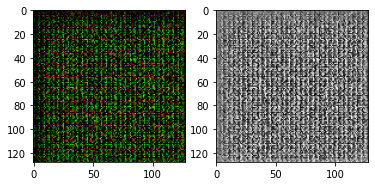

(1, 128, 128, 4)
(1, 100) 0.14077413 0.9685827


In [ ]:
# random noise vector
noise = tf.random.normal([1,noise_dim])
#sample = generate_latent_points(100, 50)
# run the generator model with the noise vector as input
generated_image = crack_generator(noise, training=False)
# display output
plt.subplot(121), plt.imshow(generated_image[0, :, :, :image_channels])
plt.subplot(122), plt.imshow(generated_image[0, :, :, 1],cmap='gray')
plt.show()
print(generated_image.shape)
#print(sample.shape, sample.mean(), sample.std())
print(noise.shape, tf.math.reduce_mean(noise).numpy(), tf.math.reduce_std(noise).numpy())

## The Discriminator

&nbsp;&nbsp;&nbsp;The <b>Discriminator</b> is relatively easier to implement, since its basically a small <b>CNN</b> two-class classifier. We can choose whether to apply <b>Spectral Normalization</b> or not and see the performance effects. For this example, I will try to apply <b>SN</b> only in <b>D</b>. Here is <b>D</b>'s structure:

<center><b>[Input(128, 128, 3) -> Conv(SN)2D(Depth=64, K=5x5, S=1x1, same) -> LeakyReLU -> Conv_Block(Depth=64, K=5x5, S=2x2) -> Conv_Block(Depth=128, K=5x5, S=2x2) -> Conv_Block(Depth=256, K=5x5, S=2x2) -> Flatten -> Dense(16384, Sigmoid)]</b></center>

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;
&nbsp;&nbsp;&nbsp;Also note that all <b>Conv</b> and <b>Dense</b> layers are initialized with the <b>Truncated Normal</b> distribution defined above. Another thing is that the <b>bias</b> term is removed from the <b>Conv</b> layers, which also stabilizes the model a little bit.

###Old version

In [ ]:
def CrackDiscriminator(spectral_normalization=True):
    model = Sequential()
    if spectral_normalization:
        model.add(ConvSN2D(64, (5, 5), strides=(1,1), padding='same', use_bias=False,
                         input_shape=[image_height, image_width, 2], 
                         kernel_initializer=weight_initializer))
        #model.add(BatchNormalization())
        model.add(LeakyReLU(alpha=leaky_relu_slope))
        model.add(Dropout(dropout_rate))
        
        #model = convSN(model, 128, ksize=3, stride_size=1)
        model = convSN(model, 64, ksize=5, stride_size=2)
        model = convSN(model, 128, ksize=5, stride_size=2)
        model = convSN(model, 256, ksize=5, stride_size=2)
        #model.add(Dropout(dropout_rate))

        model.add(Flatten())
        model.add(DenseSN(1, activation='sigmoid'))
    else:
        model.add(Conv2D(64, (5, 5), strides=(1,1), padding='same', use_bias=False,
                         input_shape=[image_height, image_width, 2], 
                         kernel_initializer=weight_initializer))
        # model.add(BatchNormalization())
        model.add(LeakyReLU(alpha=leaky_relu_slope))
        model.add(Dropout(dropout_rate))

        #model = convSN(model, 128, ksize=3, stride_size=1)
        model = conv(model, 64, ksize=5, stride_size=2)
        #model = convSN(model, 256, ksize=3, stride_size=1)
        model = conv(model, 128, ksize=5, stride_size=2)
        model = conv(model, 256, ksize=5, stride_size=2)

        model.add(Flatten())
        model.add(Dense(1, activation='sigmoid'))
    return model

In [ ]:
def CrackDiscriminator(spectral_normalization=True):
    model = Sequential()
    if spectral_normalization:
        model.add(ConvSN2D(32, (4, 4), strides=(2,2), padding='same', use_bias=False,
                         input_shape=[image_height, image_width, 4], 
                         kernel_initializer=weight_initializer))
        #model.add(BatchNormalization(epsilon=BN_EPSILON, momentum=BN_MOMENTUM))
        model.add(LeakyReLU(alpha=leaky_relu_slope))
        model.add(Dropout(dropout_rate))
        
        #model = conv(model, 32, ksize=4, stride_size=2)
        model = convSN(model, 64, ksize=4, stride_size=2)
        model = convSN(model, 128, ksize=4, stride_size=2)
        #model = convSN(model, 256, ksize=3, stride_size=1)
        model = convSN(model, 256, ksize=4, stride_size=2)
        model = convSN(model, 512, ksize=4, stride_size=1)
        #model.add(Dropout(dropout_rate))

        model.add(Flatten())
        model.add(DenseSN(1, activation='sigmoid'))
    else:
        model.add(Conv2D(32, (4, 4), strides=(2,2), padding='same', use_bias=False,
                         input_shape=[image_height, image_width, 4], 
                         kernel_initializer=weight_initializer))
        #model.add(BatchNormalization(epsilon=BN_EPSILON, momentum=BN_MOMENTUM))
        model.add(LeakyReLU(alpha=leaky_relu_slope))
        model.add(Dropout(dropout_rate))

        #model = conv(model, 32, ksize=4, stride_size=2)
        #model.add(Dropout(dropout_rate))
        model = conv(model, 64, ksize=4, stride_size=2)
        #model.add(Dropout(dropout_rate))
        #model = convSN(model, 128, ksize=3, stride_size=1)
        model = conv(model, 128, ksize=4, stride_size=2)
        #model = convSN(model, 256, ksize=3, stride_size=1)
        model = conv(model, 256, ksize=4, stride_size=2)
        model = conv(model, 512, ksize=4, stride_size=1)

        model.add(Flatten())
        model.add(Dense(1, activation='sigmoid'))
    return model

In [ ]:
crack_discriminator = CrackDiscriminator(spectral_normalization=False)
print(crack_discriminator.summary())

Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_81 (Conv2D)           (None, 64, 64, 32)        2048      
_________________________________________________________________
leaky_re_lu_28 (LeakyReLU)   (None, 64, 64, 32)        0         
_________________________________________________________________
dropout_41 (Dropout)         (None, 64, 64, 32)        0         
_________________________________________________________________
conv2d_82 (Conv2D)           (None, 32, 32, 64)        32768     
_________________________________________________________________
batch_normalization_114 (Bat (None, 32, 32, 64)        256       
_________________________________________________________________
leaky_re_lu_29 (LeakyReLU)   (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_83 (Conv2D)           (None, 16, 16, 128)     

In [ ]:
crack_discriminator = CrackDiscriminator(spectral_normalization=False)
print(crack_discriminator.summary())

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 64, 64, 32)        1024      
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 64, 64, 32)        0         
_________________________________________________________________
dropout_12 (Dropout)         (None, 64, 64, 32)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 32, 32, 32)        16384     
_________________________________________________________________
batch_normalization_22 (Batc (None, 32, 32, 32)        128       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 32, 32, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 16, 16, 64)       

In [ ]:
def CrackDiscriminator(spectral_normalization=True):
    model = Sequential()
    if spectral_normalization:
        model.add(ConvSN2D(64, (5, 5), strides=(2,2), padding='same', use_bias=False,
                         input_shape=[image_height, image_width, 4], 
                         kernel_initializer=weight_initializer))
        #model.add(BatchNormalization())
        model.add(LeakyReLU(alpha=leaky_relu_slope))
        model.add(Dropout(dropout_rate))
        
        #model = convSN(model, 128, ksize=3, stride_size=1)
        model = convSN(model, 64, ksize=5, stride_size=2)
        model = convSN(model, 128, ksize=5, stride_size=2)
        model = convSN(model, 256, ksize=5, stride_size=2)
        #model.add(Dropout(dropout_rate))

        model.add(Flatten())
        model.add(DenseSN(1, activation='sigmoid'))
    else:
        model.add(Conv2D(32, (5, 5), strides=(2,2), padding='same', use_bias=False,
                         input_shape=[image_height, image_width, 4], 
                         kernel_initializer=weight_initializer))
        model.add(BatchNormalization())
        model.add(LeakyReLU(alpha=leaky_relu_slope))
        model.add(Dropout(dropout_rate))
        model = conv(model, 64, ksize=5, stride_size=2)
        model.add(Dropout(dropout_rate))
        model = conv(model, 128, ksize=5, stride_size=2)
        model.add(Dropout(dropout_rate))
        model = conv(model, 256, ksize=5, stride_size=2)

        model.add(Flatten())
        model.add(Dense(1, activation='sigmoid'))
    return model

In [ ]:
crack_discriminator = CrackDiscriminator(spectral_normalization=False)
print(crack_discriminator.summary())

Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_86 (Conv2D)           (None, 64, 64, 32)        3200      
_________________________________________________________________
batch_normalization_125 (Bat (None, 64, 64, 32)        128       
_________________________________________________________________
leaky_re_lu_33 (LeakyReLU)   (None, 64, 64, 32)        0         
_________________________________________________________________
dropout_44 (Dropout)         (None, 64, 64, 32)        0         
_________________________________________________________________
conv2d_87 (Conv2D)           (None, 32, 32, 64)        51200     
_________________________________________________________________
batch_normalization_126 (Bat (None, 32, 32, 64)        256       
_________________________________________________________________
leaky_re_lu_34 (LeakyReLU)   (None, 32, 32, 64)      

### Maeda sekiLab code for pothole DCGAN

In [ ]:
leaky_relu_slope = 0.2
dropout_rate = 0.25

In [ ]:
def CrackDiscriminator(spectral_normalization=True):
    model = Sequential()
    if spectral_normalization:
        model.add(ConvSN2D(64, (5, 5), strides=(2,2), padding='same', use_bias=False,
                         input_shape=[image_height, image_width, 4], 
                         kernel_initializer=weight_initializer))
        #model.add(BatchNormalization())
        model.add(LeakyReLU(alpha=leaky_relu_slope))
        model.add(Dropout(dropout_rate))
        
        #model = convSN(model, 128, ksize=3, stride_size=1)
        model = convSN(model, 64, ksize=5, stride_size=2)
        model = convSN(model, 128, ksize=5, stride_size=2)
        model = convSN(model, 256, ksize=5, stride_size=2)
        #model.add(Dropout(dropout_rate))

        model.add(Flatten())
        model.add(DenseSN(1, activation='sigmoid'))
    else:
        model.add(Conv2D(32, (3, 3), strides=(2,2), padding='same',
                         input_shape=[image_height, image_width, 4], 
                         kernel_initializer=weight_initializer))
        model.add(LeakyReLU(alpha=leaky_relu_slope))
        model.add(Dropout(dropout_rate))

        model.add(Conv2D(64, (3, 3), strides=(2,2), padding='same',
                  kernel_initializer=weight_initializer))
        # model.add(ZeroPadding2D(padding=((0, 1), (0, 1))))        
        model.add(LeakyReLU(alpha=leaky_relu_slope))
        model.add(Dropout(dropout_rate))
        model.add(BatchNormalization(momentum=BN_MOMENTUM))

        model.add(Conv2D(128, (3, 3), strides=(2,2), padding='same',
                  kernel_initializer=weight_initializer))     
        model.add(LeakyReLU(alpha=leaky_relu_slope))
        model.add(Dropout(dropout_rate))
        model.add(BatchNormalization(momentum=BN_MOMENTUM))

        model.add(Conv2D(256, (3, 3), strides=(1,1), padding='same',
                  kernel_initializer=weight_initializer))     
        model.add(LeakyReLU(alpha=leaky_relu_slope))
        model.add(Dropout(dropout_rate))

        model.add(Flatten())
        model.add(Dense(1, activation='sigmoid'))
    return model

In [ ]:
def CrackDiscriminator(spectral_normalization=True):
    model = Sequential()
    if spectral_normalization:
        model.add(Conv2D(32, (5, 5), strides=(2,2), padding='same', use_bias=False,
                         input_shape=[image_height, image_width, 4], 
                         kernel_initializer=weight_initializer,
                         kernel_constraint=Spectral_Norm()))

        model.add(BatchNormalization())
        model.add(LeakyReLU(alpha=leaky_relu_slope))
        model.add(Dropout(dropout_rate))

        model = convSN(model, 64, ksize=5, stride_size=2)
        model.add(Dropout(dropout_rate))
        model = convSN(model, 128, ksize=5, stride_size=1)
        model = convSN(model, 256, ksize=5, stride_size=2)
        model = convSN(model, 512, ksize=5, stride_size=2)

        model.add(Flatten())
        model.add(Dense(1, activation='sigmoid', kernel_constraint=Spectral_Norm()))
    return model

In [ ]:
crack_discriminator = CrackDiscriminator(spectral_normalization=True)
print(crack_discriminator.summary())

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_14 (Conv2D)           (None, 64, 64, 32)        3200      
_________________________________________________________________
batch_normalization_11 (Batc (None, 64, 64, 32)        128       
_________________________________________________________________
leaky_re_lu_13 (LeakyReLU)   (None, 64, 64, 32)        0         
_________________________________________________________________
dropout_6 (Dropout)          (None, 64, 64, 32)        0         
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 32, 32, 64)        51200     
_________________________________________________________________
batch_normalization_12 (Batc (None, 32, 32, 64)        256       
_________________________________________________________________
leaky_re_lu_14 (LeakyReLU)   (None, 32, 32, 64)       

###Simple version with SN

In [ ]:
def CrackDiscriminator(spectral_normalization=True):
    model = Sequential()
    if spectral_normalization:
        model.add(Conv2D(32, (5, 5), strides=(2,2), padding='same', use_bias=False,
                         input_shape=[image_height, image_width, 4], 
                         kernel_initializer=weight_initializer,
                         kernel_constraint=Spectral_Norm()))

        model.add(BatchNormalization())
        model.add(LeakyReLU(alpha=leaky_relu_slope))
        model.add(Dropout(dropout_rate))
        model = convSN(model, 64, ksize=5, stride_size=2)
        # model.add(Dropout(dropout_rate))
        model = convSN(model, 128, ksize=5, stride_size=1)
        model = convSN(model, 256, ksize=5, stride_size=2)
        model = convSN(model,512, ksize=5, stride_size=2)

        model.add(Flatten())
        model.add(Dense(1, activation='sigmoid',  kernel_constraint=Spectral_Norm()))
    return model

In [ ]:
crack_discriminator = CrackDiscriminator(spectral_normalization=True)
print(crack_discriminator.summary())

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_10 (Conv2D)           (None, 64, 64, 32)        3200      
_________________________________________________________________
batch_normalization_14 (Batc (None, 64, 64, 32)        128       
_________________________________________________________________
leaky_re_lu_11 (LeakyReLU)   (None, 64, 64, 32)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 64, 64, 32)        0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 32, 32, 64)        51200     
_________________________________________________________________
batch_normalization_15 (Batc (None, 32, 32, 64)        256       
_________________________________________________________________
leaky_re_lu_12 (LeakyReLU)   (None, 32, 32, 64)       

In [ ]:
crack_discriminator = CrackDiscriminator(spectral_normalization=True)
print(crack_discriminator.summary())

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_24 (Conv2D)           (None, 64, 64, 64)        6400      
_________________________________________________________________
batch_normalization_25 (Batc (None, 64, 64, 64)        256       
_________________________________________________________________
leaky_re_lu_22 (LeakyReLU)   (None, 64, 64, 64)        0         
_________________________________________________________________
dropout_5 (Dropout)          (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_25 (Conv2D)           (None, 32, 32, 128)       204800    
_________________________________________________________________
batch_normalization_26 (Batc (None, 32, 32, 128)       512       
_________________________________________________________________
leaky_re_lu_23 (LeakyReLU)   (None, 32, 32, 128)     

Below we can observe, that <b>D</b> indeed outputs a probability very close to <b>0.5</b> for a noisy input.

In [ ]:
decision = crack_discriminator(generated_image)
print(decision)

tf.Tensor([[0.30739623]], shape=(1, 1), dtype=float32)


## Further optimization tricks

### Label smoothing

&nbsp;&nbsp;&nbsp;One regularization method that can be applied during training is called <b>Label smoothing</b>. What this does is that it essentially prevents <b>D</b> from being overconfident or underconfident in its predictions. If <b>D</b> becomes too certain that there is a dog in a specific image, <b>G</b> can exploit that fact and continuously start to generate only images of that sort and in turn, cease to improve. We can combat this, by setting the class labels to be in the range <b>[0, 0.3]</b> for the negative classes and <b>[0.7, 1]</b> for the positive ones. 

&nbsp;&nbsp;&nbsp;This will prevent the overall probabilities from getting very close to the two thresholds.

In [ ]:
# Label smoothing -- technique from GAN hacks, instead of assigning 1/0 as class labels, we assign a random integer in range [0.7, 1.0] for positive class
# and [0.0, 0.3] for negative class

def smooth_positive_labels(y):
    return y - 0.3 + (np.random.random(y.shape) * 0.3)

def smooth_negative_labels(y):
    return y + np.random.random(y.shape) * 0.3

### Introducing some noise to the labels

&nbsp;&nbsp;&nbsp;This technique is also called <b>Instance Noise</b>. By adding a small amount of error to the labels (let's say 5%), this tends to make the true and predicted distributions more spread out and thus start to overlap with each other. This in turn makes fitting a custom distribution of generated images easier in the learning process.

&nbsp;&nbsp;&nbsp;Here is a good example of how the two distributions look like with these techniques:

![Smoothing and noise effect on distributions](https://www.inference.vc/content/images/2016/10/instance_noise.png)

In [ ]:
# randomly flip some labels
def noisy_labels(y, p_flip):
    # determine the number of labels to flip
    n_select = int(p_flip * int(y.shape[0]))
    # choose labels to flip
    flip_ix = np.random.choice([i for i in range(int(y.shape[0]))], size=n_select)
    
    op_list = []
    # invert the labels in place
    #y_np[flip_ix] = 1 - y_np[flip_ix]
    for i in range(int(y.shape[0])):
        if i in flip_ix:
            op_list.append(tf.subtract(1, y[i]))
        else:
            op_list.append(y[i])
    
    outputs = tf.stack(op_list)
    return outputs

### Optimizers

&nbsp;&nbsp;&nbsp;The best proven optimization algorithm for this task is <b>Adam</b> with a standard learning rate of <b>0.0002</b> for both models and a beta of <b>0.5</b>.

In [ ]:
generator_optimizer = tf.train.AdamOptimizer(learning_rate=lr_initial_g, beta1=0.5)
discriminator_optimizer = tf.train.AdamOptimizer(learning_rate=lr_initial_d, beta1=0.5)
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=False)

### Defining the loss functions

&nbsp;&nbsp;&nbsp;Another new trend in optimizing <b>GANs</b> recently has been applying a <b>Relativistic</b> loss function as opposed to the standard one. Those functions measure the probability that the real data is more "realistic" than the generated data. One of the more popular relativistic function choices include <b>RaLSGAN (Relativistic Average Least Squares), RaSGAN (Relativistic Average Standard) and RaHinge (Relativistic Hinge loss)</b>.

&nbsp;&nbsp;&nbsp;But before all of that, let's define the standard <b>GAN</b> loss:

$$ \underset{D}{min}(V(D)) = - E_{x}[\log{D(x)}] - E_{z}[\log{(1-D(G(z)))}] $$

&nbsp;&nbsp;&nbsp;As we can observe, this is basically the standard <b>Binary Crossentropy loss</b> used for classification tasks or the <b>Logistic Loss</b> between the real and generated distributions.

&nbsp;&nbsp;&nbsp;In comparison, here is what an <b>RSGAN (Relativistic Standard)</b> loss looks like:

$$ L^{RSGAN}_{D} = - E_{(x_{r},x_{f})}[\log{(sigmoid(C(x_{r}) - C(x_{f})))}] $$
$$ L^{RSGAN}_{G} = - E_{(x_{r},x_{f})}[\log{(sigmoid(C(x_{f}) - C(x_{r})))}] $$

&nbsp;&nbsp;&nbsp;In this case the task is different, to measure the similarity between the <b>real (r)</b> and <b>fake (f)</b> data distributions. RSGAN reaches the optimal point when D(x) = 0.5 (i.e. $C(x_{r}) = C(x_{f})$). There are many relativistic loss function variants and they all contain different methods for measuring this similarity. In this project, I've tried out <b>3</b> of the variants that seemed to have the best documented <b>MIFID</b> score <b>(RaLSGAN, RaSGAN and RaHinge)</b>. Feel free to try out different losses for yourself to see if you can improve the performance ;). Here's a big list of the most commonly used ones:

![GAN losses](https://miro.medium.com/max/875/1*QKG1fVOMjGlVUvICYmz8vQ.png)

&nbsp;&nbsp;&nbsp;With this in mind, I have devised a nice little decision tree function for choosing the losses for both <b>G</b> and <b>D</b>. Note that <b>instance noise</b> and <b>label smoothing</b> need to be applied before calculating the actual losses. 

&nbsp;&nbsp;&nbsp;Throughout many trials for this particular problem, I didn't find any increase in performance by switching to <b>Relativistic</b> losses, so I decided to stick with the standard <b>GAN</b> loss function, as it is much simpler to estimate, though in some cases these losses can really speed up convergence in your model.

In [ ]:
def discriminator_loss(real_output, fake_output, loss_func, apply_label_smoothing=True, label_noise=True):
    if label_noise and apply_label_smoothing:
        real_output_noise = noisy_labels(tf.ones_like(real_output), 0.05)
        fake_output_noise = noisy_labels(tf.zeros_like(fake_output), 0.05)
        real_output_smooth = smooth_positive_labels(real_output_noise)
        fake_output_smooth = smooth_negative_labels(fake_output_noise)
        if loss_func == 'gan': 
            real_loss = cross_entropy(tf.ones_like(real_output_smooth), real_output)
            fake_loss = cross_entropy(tf.zeros_like(fake_output_smooth), fake_output)
        else:
            if loss_func == 'ralsgan':
                return (tf.reduce_mean(tf.square(real_output_smooth - tf.reduce_mean(fake_output_smooth) - tf.ones_like(real_output_smooth)))
        + tf.reduce_mean(tf.square(fake_output_smooth - tf.reduce_mean(real_output_smooth) + tf.ones_like(fake_output_smooth)))) / 2.
            elif loss_func == 'rasgan':
                avg_fake_logit = tf.reduce_mean(fake_output_smooth)
                avg_real_logit = tf.reduce_mean(real_output_smooth)
                D_r_tilde = tf.nn.sigmoid(real_output_smooth - avg_fake_logit)
                D_f_tilde = tf.nn.sigmoid(fake_output_smooth - avg_real_logit)
                total_loss = - tf.reduce_mean(tf.log(
                    D_r_tilde + 1e-14)) - tf.reduce_mean(tf.log(1 - D_f_tilde + 1e-14))
                return total_loss
            elif loss_func == 'rahinge':
                real_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(real_output_smooth) - (real_output_smooth - tf.reduce_mean(fake_output_smooth))))
                fake_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(fake_output_smooth) + (fake_output_smooth - tf.reduce_mean(real_output_smooth))))
        total_loss = real_loss + fake_loss
        return total_loss
    elif label_noise and not apply_label_smoothing:
        real_output_noise = noisy_labels(tf.ones_like(real_output), 0.05)
        fake_output_noise = noisy_labels(tf.zeros_like(fake_output), 0.05)
        if loss_func == 'gan': 
            real_loss = cross_entropy(tf.ones_like(real_output_noise), real_output)
            fake_loss = cross_entropy(tf.zeros_like(fake_output_noise), fake_output)
        else:
            if loss_func == 'ralsgan':
                return (tf.reduce_mean(tf.square(real_output_noise - tf.reduce_mean(fake_output_noise) - tf.ones_like(real_output_noise)))
        + tf.reduce_mean(tf.square(fake_output_noise - tf.reduce_mean(real_output_noise) + tf.ones_like(fake_output_noise)))) / 2.
            elif loss_func == 'rasgan':
                avg_fake_logit = tf.reduce_mean(fake_output_noise)
                avg_real_logit = tf.reduce_mean(real_output_noise)
                D_r_tilde = tf.nn.sigmoid(real_output_noise - avg_fake_logit)
                D_f_tilde = tf.nn.sigmoid(fake_output_noise - avg_real_logit)
                total_loss = - tf.reduce_mean(tf.log(
                    D_r_tilde + 1e-14)) - tf.reduce_mean(tf.log(1 - D_f_tilde + 1e-14))
                return total_loss
            elif loss_func == 'rahinge':
                real_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(real_output_noise) - (real_output_noise - tf.reduce_mean(fake_output_noise))))
                fake_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(fake_output_noise) + (fake_output_noise - tf.reduce_mean(real_output_noise))))
        total_loss = real_loss + fake_loss
        return total_loss
    elif apply_label_smoothing and not label_noise:
        real_output_smooth = smooth_positive_labels(tf.ones_like(real_output))
        fake_output_smooth = smooth_negative_labels(tf.zeros_like(fake_output))
        if loss_func == 'gan': 
            real_loss = cross_entropy(tf.ones_like(real_output_smooth), real_output)
            fake_loss = cross_entropy(tf.zeros_like(fake_output_smooth), fake_output)
        else:
            if loss_func == 'ralsgan':
                return (tf.reduce_mean(tf.square(real_output_smooth - tf.reduce_mean(fake_output_smooth) - tf.ones_like(real_output_smooth)))
        + tf.reduce_mean(tf.square(fake_output_smooth - tf.reduce_mean(real_output_smooth) + tf.ones_like(fake_output_smooth)))) / 2.
            elif loss_func == 'rasgan':
                avg_fake_logit = tf.reduce_mean(fake_output_smooth)
                avg_real_logit = tf.reduce_mean(real_output_smooth)
                D_r_tilde = tf.nn.sigmoid(real_output_smooth - avg_fake_logit)
                D_f_tilde = tf.nn.sigmoid(fake_output_smooth - avg_real_logit)
                total_loss = - tf.reduce_mean(tf.log(
                    D_r_tilde + 1e-14)) - tf.reduce_mean(tf.log(1 - D_f_tilde + 1e-14))
                return total_loss
            elif loss_func == 'rahinge':
                real_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(real_output_smooth) - (real_output_smooth - tf.reduce_mean(fake_output_smooth))))
                fake_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(fake_output_smooth) + (fake_output_smooth - tf.reduce_mean(real_output_smooth))))
        total_loss = real_loss + fake_loss
        return total_loss    
    else:
        if loss_func == 'gan': 
            real_loss = cross_entropy(tf.ones_like(real_output), real_output)
            fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
        else:
            if loss_func == 'ralsgan':
                return (tf.reduce_mean(tf.square(real_output - tf.reduce_mean(fake_output) - tf.ones_like(real_output)))
        + tf.reduce_mean(tf.square(fake_output - tf.reduce_mean(real_output) + tf.ones_like(fake_output)))) / 2.
            elif loss_func == 'rasgan':
                avg_fake_logit = tf.reduce_mean(fake_output)
                avg_real_logit = tf.reduce_mean(real_output)
                D_r_tilde = tf.nn.sigmoid(real_output - avg_fake_logit)
                D_f_tilde = tf.nn.sigmoid(fake_output - avg_real_logit)
                total_loss = - tf.reduce_mean(tf.log(
                    D_r_tilde + 1e-14)) - tf.reduce_mean(tf.log(1 - D_f_tilde + 1e-14))
                return total_loss
            elif loss_func == 'rahinge':
                real_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(real_output) - (real_output - tf.reduce_mean(fake_output))))
                fake_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(fake_output) + (fake_output - tf.reduce_mean(real_output))))
        total_loss = real_loss + fake_loss
        return total_loss

In [ ]:
def generator_loss(real_output, fake_output, loss_func, apply_label_smoothing=True):
    if apply_label_smoothing:
        fake_output_smooth = smooth_negative_labels(tf.ones_like(fake_output))
        if loss_func == 'gan':
            return cross_entropy(tf.ones_like(fake_output_smooth), fake_output)
        else:
            if loss_func == 'ralsgan':
                return (tf.reduce_mean(tf.square(real_output - tf.reduce_mean(fake_output_smooth) + tf.ones_like(real_output)))
        + tf.reduce_mean(tf.square(fake_output_smooth - tf.reduce_mean(real_output) - tf.ones_like(fake_output_smooth)))) / 2.
            elif loss_func == 'rasgan':
                avg_fake_logit = tf.reduce_mean(fake_output_smooth)
                avg_real_logit = tf.reduce_mean(real_output)
                D_r_tilde = tf.nn.sigmoid(real_output - avg_fake_logit)
                D_f_tilde = tf.nn.sigmoid(fake_output_smooth - avg_real_logit)
                total_loss = - tf.reduce_mean(tf.log(
                    D_f_tilde + 1e-14)) - tf.reduce_mean(tf.log(1 - D_r_tilde + 1e-14))
                return total_loss
            elif loss_func == 'rahinge':
                fake_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(fake_output_smooth) - (fake_output_smooth - tf.reduce_mean(real_output))))
                real_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(real_output) + (real_output - tf.reduce_mean(fake_output_smooth))))
                loss = fake_loss + real_loss
                return loss
    else:           
        if loss_func == 'gan':
            return cross_entropy(tf.ones_like(fake_output), fake_output)
        else:
            if loss_func == 'ralsgan':
                return (tf.reduce_mean(tf.square(real_output - tf.reduce_mean(fake_output) + tf.ones_like(real_output)))
        + tf.reduce_mean(tf.square(fake_output - tf.reduce_mean(real_output) - tf.ones_like(fake_output)))) / 2.
            elif loss_func == 'rasgan':
                avg_fake_logit = tf.reduce_mean(fake_output)
                avg_real_logit = tf.reduce_mean(real_output)
                D_r_tilde = tf.nn.sigmoid(real_output - avg_fake_logit)
                D_f_tilde = tf.nn.sigmoid(fake_output - avg_real_logit)
                total_loss = - tf.reduce_mean(tf.log(
                    D_f_tilde + 1e-14)) - tf.reduce_mean(tf.log(1 - D_r_tilde + 1e-14))
                return total_loss
            elif loss_func == 'rahinge':
                fake_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(fake_output) - (fake_output - tf.reduce_mean(real_output))))
                real_loss = tf.reduce_mean(tf.nn.relu(tf.ones_like(real_output) + (real_output - tf.reduce_mean(fake_output))))
                loss = fake_loss + real_loss
                return loss 

### Define a checkpointer

&nbsp;&nbsp;&nbsp;Let's finally add a checkpointer to be able to save and reuse our model.

In [ ]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=crack_generator,
                                 discriminator=crack_discriminator)

### Main training loop

&nbsp;&nbsp;&nbsp;Let's also fix the number of epochs for training and the number of images to feed to the <b>Generator</b> for visualizing results during that training.

In [ ]:
EPOCHS = 3000
num_examples_to_generate = 32
seed = tf.random.normal([num_examples_to_generate, noise_dim])

&nbsp;&nbsp;&nbsp;One training step of a <b>DCGAN</b> consists of three standard steps:

1. <b>Forward prop</b> - <b>G</b> creates a batch of fake images; this, alongside a batch of real images is fed to <b>D</b>.
2. <b>Calculate both G and D's loss function</b>.
3. <b>Backprop</b> - compute gradients for <b>G</b> and <b>D</b> optimize the weights.

In [ ]:
def train_step(images, loss_type='gan'):
    noise = tf.random.normal([batch_size, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = crack_generator(noise, training=True)
        
        real_output = crack_discriminator(images, training=True)
        fake_output = crack_discriminator(generated_images, training=True)
        
        gen_loss = generator_loss(real_output, fake_output, loss_type, apply_label_smoothing=True)
        disc_loss = discriminator_loss(real_output, fake_output, loss_type, 
                                       apply_label_smoothing=True, label_noise=True)
 
    gradients_of_generator = gen_tape.gradient(gen_loss, crack_generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, crack_discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, crack_generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, crack_discriminator.trainable_variables))
    
    return gen_loss, disc_loss

&nbsp;&nbsp;&nbsp;Let's also define some functions to visualize the model losses by epoch and as a whole.

In [ ]:
def plot_losses(G_losses, D_losses, all_gl, all_dl, epoch):
    plt.figure(figsize=(10,5))
    plt.title("Generator and Discriminator Loss - EPOCH {}".format(epoch))
    plt.plot(G_losses,label="G")
    plt.plot(D_losses,label="D")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.legend()
    ymax = plt.ylim()[1]
    plt.show()
    
    plt.figure(figsize=(10,5))
    plt.plot(np.arange(len(all_gl)),all_gl,label='G')
    plt.plot(np.arange(len(all_dl)),all_dl,label='D')
    plt.legend()
    #plt.ylim((0,np.min([1.1*np.max(all_gl),2*ymax])))
    plt.title('All Time Loss')
    plt.show()

&nbsp;&nbsp;&nbsp;We can also use the following function to plot a grid of the generated images.

In [ ]:
def generate_and_save_images(model, epoch, test_input, rows, cols):
    # Notice `training` is set to False.
    # This is so all layers run in inference mode (batchnorm).
    predictions = model(test_input, training=False)
    fig = plt.figure(figsize=(14,14))
    j = 1
    for i in range(predictions.shape[0]):
        plt.subplot(rows, cols*2, j)
        plt.axis('off') 
        plt.imshow((predictions[i, :, :, :image_channels] * 127.5 + 127.5) / 255.)#, cmap='gray')
        plt.subplot(rows, cols*2, j+1)
        plt.axis('off') 
        plt.imshow((predictions[i, :, :, -1] * 127.5 + 127.5) / 255., cmap='gray')
        j=j+2
        
    plt.subplots_adjust(wspace=0, hspace=0)
    plt.axis('off') 
    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

&nbsp;&nbsp;&nbsp;To generate a single test image, we can also reuse the same method.

In [ ]:
def generate_test_image(model, noise_dim=noise_dim):
    test_input = tf.random.normal([1, noise_dim])
    # Notice `training` is set to False.
    # This is so all layers run in inference mode (batchnorm).
    predictions = model(test_input, training=False)
    fig = plt.figure(figsize=(5,5))
    plt.subplot(1, 2, 1)
    plt.imshow((predictions[0, :, :, :image_channels] * 127.5 + 127.5) / 255.)
    plt.axis('off') 
    plt.subplot(1, 2, 2)
    plt.imshow((predictions[0, :, :, -1] * 127.5 + 127.5) / 255.)
    plt.axis('off') 
    plt.show()

## Evaluating GANs - FID and MIFID

### Inception Score

&nbsp;&nbsp;&nbsp;We still haven't mentioned how a <b>GAN</b> is usually evaluated. Most research papers that use benchmarks to estimate how well a <b>GAN</b> performs are usually based on what's called the <b>Inception Score</b>. This measures two main characteristics of the input images:

- <b>The variety (for example generating different types of dog breeds)</b>
- <b>The distinction (or quality of the image)</b>

&nbsp;&nbsp;&nbsp;If both things are true, the score will be high. If either or both are false, the score will be low.
A higher score is better. It means your GAN can generate many different distinct images. The lowest score possible is zero. Mathematically the highest possible score is infinity, although in practice there will probably emerge a non-infinite ceiling.

&nbsp;&nbsp;&nbsp;The <b>Inception Score</b> is derived from Google's [Inception Network](https://towardsdatascience.com/a-simple-guide-to-the-versions-of-the-inception-network-7fc52b863202), which is one of the state-of-the-art deep architectures for classifying images. By passing the images from our GAN through the classifier, we can measure properties of our generated images. To produce the score, we need to calculate the similarity/distance between the real and fake distributions of images. This is done using the <b>KL(Kullback–Leibler) divergence formula</b>: 

$$ D_{KL}(P \:||\:Q) = - \sum_{x \in X}P(x)\log{\frac{Q(x)}{P(x)}} $$

&nbsp;&nbsp;&nbsp;Here, <b>P and Q</b> are the two measured distributions. In this case, <b>higher KL divergence</b> means better results - the quality of the images is similar and there is a wide variety of labels present. In the opposite case, the <b>low KL divergence</b> can be due to either low quality or low variety of labels:

![KL divergence](https://miro.medium.com/max/2170/1*hPEJY3MkOZyKFA6yEqzuyg.png)

### FID (Frechet Inception Distance)

&nbsp;&nbsp;&nbsp;One shortcoming for <b>IS</b> is that it can misrepresent the performance if it only generates one image per class. To combat this we can use the <b>FID (Frechet Inception Distance)</b>. This measure defines the two previous types of images as multivariate <b>Gaussian distributions</b> with mean $\mu$ and covariance $\Sigma$ (Sigma). Let's see how this distance is calculated:

$$ FID(x,\:g) = \big\|\mu_{x} - \mu_{g}\big\|^2_2 + Tr(\Sigma_{x} + \Sigma_{g} - 2(\Sigma_{x}\Sigma_{g})^{\frac{1}{2}}) $$

&nbsp;&nbsp;&nbsp;Here, $x$ and $g$ represent the real and fake distribution of images, while $Tr$ is the sum of diagonal elements of the results.

> <b> Lower FID values mean better image quality and diversity. </b>

![FID in popular datasets](https://miro.medium.com/max/1848/1*8PzOnrzIeuM0E1unrFKLfg.png)

&nbsp;&nbsp;&nbsp;Here are also a few useful notes on why <b>FID</b> is a good measure:

> - <b>FID is more robust to noise than IS.</b>
> - <b>If the model only generates one image per class, the distance will be high. So FID is a better measurement for image diversity.</b>
> - <b>By computing the FID between a training dataset and a testing dataset, we should expect the FID to be zero since both are real images. (although there is usually a small amount of error)</b>
> - <b>FID and IS are based on feature extraction (the presence or the absence of features).</b>

### MIFID (Memorization Informed Frechet Inception Distance)

&nbsp;&nbsp;&nbsp;Here is Kaggle's official evaluation workflow for this competition:

![Kaggle workflow](https://i.imgur.com/Vl0AcWd.png)

&nbsp;&nbsp;&nbsp;As we can see, in addition to the <b>FID</b> metric, there is an additional <b>Memorization Score</b> added to the calculation. This is basically a <b>Cosine distance</b> formula that measures the similarity between the real and fake images. My guess is that this has been done to make sure that the images fed to the evaluation kernel have actually been generated by a <b>GAN</b> and not just replicated or modified from the real dataset.

&nbsp;&nbsp;&nbsp;Thankfully, the <b>MIFID</b> evaluator has been implemented by the Kaggle team [(here)](https://www.kaggle.com/wendykan/demo-mifid-metric-for-dog-image-generation-comp) and we don't have to worry about it. 
To use it, make sure you add this [dataset](https://www.kaggle.com/wendykan/dog-face-generation-competition-kid-metric-input) to your input.

In [ ]:
class KernelEvalException(Exception):
    pass


@dataclass
class MiFIDEvaluator(object):
    model_path: str
    train_images_path: str
    feature_path: str = None
    imsize: int = 64
    output_layer: str = 'Pretrained_Net/pool_3:0'
    input_layer: str = 'Pretrained_Net/ExpandDims:0'
    output_shape: int = 2048
    cosine_distance_eps: float = 0.1
    batch_size: int = 64
    fid_epsilon: float = 1e-14
    
    def __post_init__(self):
        tf.reset_default_graph()
        self.create_model_graph()
        with tf.Session() as sess:
            if self.feature_path is None:
                self.mu2, self.sigma2, self.features2 = self._handle_path_memorization(
                    self.train_images_path, sess, is_checksize=False, is_check_png=False)
            else:
                with np.load(self.feature_path) as f:
                    self.mu2, self.sigma2, self.features2 = f['m'], f['s'], f['features']
    
    def create_model_graph(self):
        with tf.gfile.FastGFile(self.model_path, 'rb') as f:
            graph_def = tf.GraphDef()
            graph_def.ParseFromString(f.read())
            _ = tf.import_graph_def(graph_def, name='Pretrained_Net')
            
    def img_read_checks(self, filename, is_checksize=False, is_check_png=False):
        im = Image.open(str(filename))
        if is_checksize and im.size != (self.imsize, self.imsize):
            raise KernelEvalException(f'The images are not of size {check_imsize}')
        if is_check_png and im.format != 'PNG':
            raise KernelEvalException('Only PNG images should be submitted.')

        if self.imsize is None:
            return im
        else:
            return im.resize((self.imsize, self.imsize), Image.ANTIALIAS)
        
    def _get_model_layer(self, sess):
        layer = sess.graph.get_tensor_by_name(self.output_layer)
        ops = layer.graph.get_operations()
        for op_idx, op in enumerate(ops):
            for o in op.outputs:
                shape = o.get_shape()
                if shape._dims != []:
                    shape = [s.value for s in shape]
                    new_shape = []
                    for j, s in enumerate(shape):
                        if s == 1 and j == 0:
                            new_shape.append(None)
                        else:
                            new_shape.append(s)
                    o.__dict__['_shape_val'] = tf.TensorShape(new_shape)
        return layer
        
    def get_activations(self, images, sess):
        inception_layer = self._get_model_layer(sess)
        n_images = images.shape[0]
        if self.batch_size > n_images:
            warnings.warn('batch size is bigger than the data size. setting batch size to data size')
            self.batch_size = n_images
        n_batches = n_images // self.batch_size + 1
        pred_arr = np.empty((n_images, self.output_shape))
        for i in range(n_batches):
            start = i * self.batch_size
            if start + self.batch_size < n_images:
                end = start + self.batch_size
            else:
                end = n_images

            batch = images[start:end]
            pred = sess.run(inception_layer, {self.input_layer: batch})
            pred_arr[start:end] = pred.reshape(-1, self.output_shape)
        return pred_arr
        
    def calculate_activation_statistics(self, images, sess):
        act = self.get_activations(images, sess)
        mu = np.mean(act, axis=0)
        sigma = np.cov(act, rowvar=False)
        return mu, sigma, act
            
    def _handle_path_memorization(self, path, sess, is_checksize, is_check_png):
        path = Path(path)
        files = list(path.glob('*.jpg')) + list(path.glob('*.png'))

        # In production we don't resize input images. This is just for demo purpose. 
        x = np.array([np.array(self.img_read_checks(fn, is_checksize, is_check_png)) for fn in files])
        m, s, features = self.calculate_activation_statistics(x, sess)
        del x
        return m, s, features
    
    def calculate_frechet_distance(self, mu1, sigma1):
        mu1 = np.atleast_1d(mu1)
        mu2 = np.atleast_1d(self.mu2)
        sigma1 = np.atleast_2d(sigma1)
        sigma2 = np.atleast_2d(self.sigma2)

        assert mu1.shape == mu2.shape, 'Training and test mean vectors have different lengths'
        assert sigma1.shape == sigma2.shape, 'Training and test covariances have different dimensions'

        # product might be almost singular
        covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)
        if not np.isfinite(covmean).all():
            msg = f'fid calculation produces singular product; adding {self.eps} to diagonal of cov estimates'
            warnings.warn(msg)
            offset = np.eye(sigma1.shape[0]) * self.eps
            covmean = linalg.sqrtm((sigma1 + offset).dot(sigma2 + offset))
            
        # numerical error might give slight imaginary component
        if np.iscomplexobj(covmean):
            if not np.allclose(np.diagonal(covmean).imag, 0, atol=1e-3):
                m = np.max(np.abs(covmean.imag))
                raise ValueError(f'Imaginary component {m}')
            covmean = covmean.real
        tr_covmean = np.trace(covmean)
        return (mu1 - mu2).dot(mu1 - mu2) + np.trace(sigma1) + np.trace(sigma2) - 2 * tr_covmean
    
    @staticmethod
    def normalize_rows(x):
        return np.nan_to_num(x / np.linalg.norm(x, ord=2, axis=1, keepdims=True))
    
    def cosine_distance(self, features1):
        features1_nozero = features1[np.sum(features1, axis=1) != 0]
        features2_nozero = self.features2[np.sum(self.features2, axis=1) != 0]
        norm_f1 = self.normalize_rows(features1_nozero)
        norm_f2 = self.normalize_rows(features2_nozero)

        d = 1.0 - np.abs(np.matmul(norm_f1, norm_f2.T))
        mean_min_d = np.mean(np.min(d, axis=1))
        return mean_min_d
            
    def calculate_kid_given_paths(self, user_images_unzipped_path):
        with tf.Session() as sess:
            sess.run(tf.global_variables_initializer())
            m1, s1, features1 = self._handle_path_memorization(
                user_images_unzipped_path, sess, is_checksize=True, is_check_png=True)

            fid_value = self.calculate_frechet_distance(m1, s1)
            distance = self.cosine_distance(features1)
            return fid_value, distance
        
    def distance_thresholding(self, d):
        if d < self.cosine_distance_eps:
            return d
        else:
            return 1
        
    def evaluate(self, user_images_unzipped_path):
        fid_value, distance = self.calculate_kid_given_paths(user_images_unzipped_path)
        distance = self.distance_thresholding(distance)
        return fid_value, distance, fid_value / (distance + self.fid_epsilon)

### Image zipping and saving functions

&nbsp;&nbsp;&nbsp;I'm just going to add two more for zipping the final <b>10K</b> images for submission and generating temporary images to calculate the <b>MIFID</b> in between certain epochs during training.

In [ ]:
def zip_images(filename='images.zip'):
    # SAVE TO ZIP FILE NAMED IMAGES.ZIP
    z = zipfile.PyZipFile(filename, mode='w')
    for k in range(image_sample_size):
        generated_image = crack_generator(tf.random.normal([1, noise_dim]), training=False)
        f = str(k)+'.png'
        imgg = np.array(generated_image)
        img = (imgg[0, :, :, 0] + 1.) / 2.
        img = Image.fromarray((255*img).astype('uint8').reshape((image_height,image_width)))
        img.save(f,'PNG')
        z.write(f)
        os.remove(f)

        f = str(k)+'-seg.png'
        img = (imgg[0, :, :, 1] + 1.) / 2.
        img = Image.fromarray((255*img).astype('uint8').reshape((image_height,image_width)))
        img.save(f,'PNG')
        z.write(f)
        os.remove(f)
        #if k % 1000==0: print(k)
    z.close()
    print('Saved final images for submission.')
    
def save_images(directory=OUT_DIR):
    for k in range(image_sample_size):
        generated_image = crack_generator(tf.random.normal([1, noise_dim]), training=False)
        f = str(k)+'.png'
        f = os.path.join(directory, f)
        imgg = np.array(generated_image)
        img = (imgg[0, :, :, :image_channels] + 1.) / 2.
        img = Image.fromarray((255*img).astype('uint8').reshape((image_height,image_width, image_channels)))
        img.save(f,'PNG')

        f = str(k)+'-seg.png'
        f = os.path.join(directory, f)
        img = (imgg[0, :, :, -1] + 1.) / 2.
        img = Image.fromarray((255*img).astype('uint8').reshape((image_height,image_width)))
        img.save(f,'PNG')
        #if k % 1000==0: print(k)
    print('Saved temporary images for evaluation.')

In [ ]:
save_images('/content/')

Saved temporary images for evaluation.


## Model training and avoiding Mode Collapse

&nbsp;&nbsp;&nbsp;It's finally time to implement the final training function that wraps up the whole process. There are also a few techniques used here that I haven't mentioned yet. Let's see what they are.

### Learning rate decay

&nbsp;&nbsp;&nbsp;This one is experimental and doesn't always help improve performance, but I don't think it would hurt either way. The idea here is to decrease the <b>learning rate</b> by a very small amount for each training step/steps, in order to stabilize the training process and speed up convergence (and escape from local minima). For this project, I am using the <b>[Cosine learning rate decay](https://www.tensorflow.org/api_docs/python/tf/train/cosine_decay)</b> in <b>Tensorflow</b> to reduce the learning rate for every ```decay_step``` iterations.

### Dealing with mode collapse

> Mode collapse is one of the hardest problems to solve in GANs. A complete collapse is not common but a partial collapse happens often. 

&nbsp;&nbsp;&nbsp;We've already seen some methods that can potentially eliminate <b>Mode Collapse</b> like <b>Label smoothing</b>, <b>Instance Noise</b>, <b>Weight Initialization</b> and so on. One other method that we could apply during training is called <b>Experience Replay</b>. 

&nbsp;&nbsp;&nbsp;<b>Experience Replay</b> preserves some of the recently generated images in memory. For every ```replay_step``` iterations, we train <b>D</b> on those previous images to "remind" the network of previous generations and thus decrease the chance of <b>overfitting</b> to a particular instance of data batches during training. In this example, I am using a slightly different form of <b>Experience Replay</b> in the sense that, I am generating a new extra image for each training step to store in a list, instead of feeding it actual generated images from previous iterations, since storing data during <b>Eager execution</b> isn't an easy task.

&nbsp;&nbsp;&nbsp;*EDIT: As Kaggle was running into memory issues after ~7-8 hours of runtime, I decided against using experience replay. Let me know if you find a workaround for this :D.*

&nbsp;&nbsp;&nbsp;Other than this the training process is fairly straight-forward. There are additional steps for displaying the intermediate results like the images, losses and calculating the <b>MIFID</b>. At the end of the learning process, we print out the final evaluation and a larger grid of the final images.

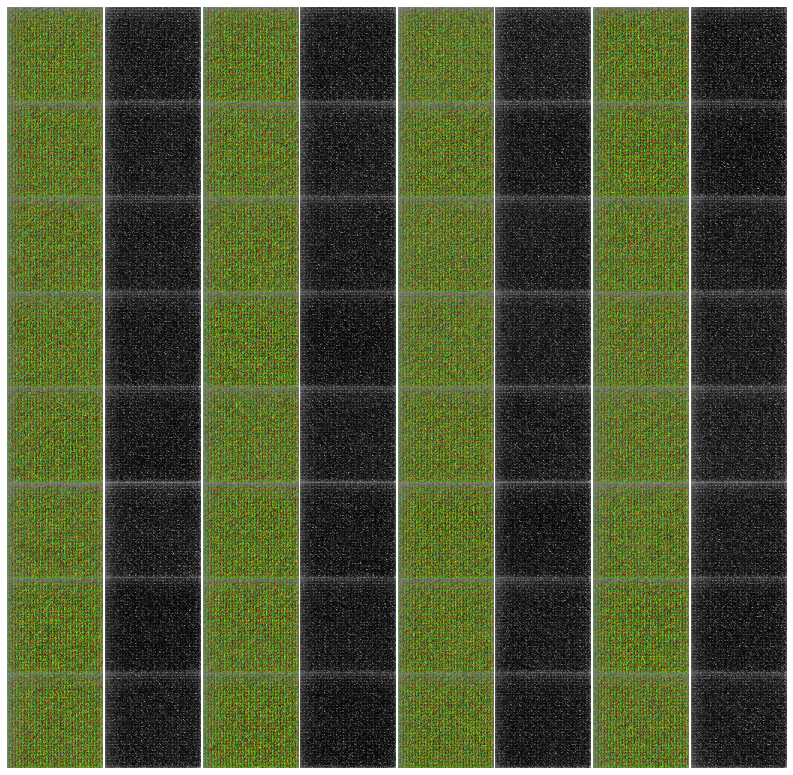

In [ ]:
generate_and_save_images(crack_generator, 1, seed, rows=8, cols=4)

In [ ]:
display_results = 40
calculate_mifid = 50
replay_step = 50
decay_step = 50
mi_fid_score = 0


def train(dataset, epochs, retrain=False):
    all_gl = np.array([]); all_dl = np.array([])
    #best recorded mifid, or default 1000
    best_mifid_score = 1000
    #last checkpointed epoch, used if continuing a checkpointed model
    last_saved_epoch = 300
    exp_replay = []
    for epoch in tqdm(range(epochs)):
        
        G_loss = []; D_loss = []
        
        start = time.time()
        new_lr_d = lr_initial_d
        new_lr_g = lr_initial_g
        global_step = 0
        
        for image_batch in dataset:
            g_loss, d_loss = train_step(image_batch)
            global_step = global_step + 1
            G_loss.append(g_loss); D_loss.append(d_loss)
        all_gl = np.append(all_gl,np.array([G_loss]))
        all_dl = np.append(all_dl,np.array([D_loss]))
            

        # generate an extra image for each epoch and store it in memory for experience replay
        
        '''
        generated_image = dog_generator(tf.random.normal([1, noise_dim]), training=False)
        exp_replay.append(generated_image)
        if len(exp_replay) == replay_step:
            print('Executing experience replay..')
            replay_images = np.array([p[0] for p in exp_replay])
            dog_discriminator(replay_images, training=True)
            exp_replay = []    
        '''
         
        #display.clear_output(wait=True)
        if (epoch + 1) % display_results == 0 or epoch == 0:
            plot_losses(G_loss, D_loss, all_gl, all_dl, epoch + 1)
            if retrain:
              generate_and_save_images(crack_generator, cur_epoch + 1, seed, rows=8, cols=4)
            else:
              generate_and_save_images(crack_generator, epoch + 1, seed, rows=8, cols=4)
        
        if (epoch + 1) % calculate_mifid == 0:            
            OUT_DIR.mkdir(exist_ok=True)
            save_images(OUT_DIR)
            # evaluator = MiFIDEvaluator(MODEL_PATH, TRAIN_DIR)
            # fid_value, distance, mi_fid_score = evaluator.evaluate(OUT_DIR)

            # print(f'FID: {fid_value:.5f}')
            # print(f'distance: {distance:.5f}')
            # print(f'MiFID: {mi_fid_score:.5f}')
            shutil.rmtree(OUT_DIR)
            print('Removed temporary image directory.')
            # if mi_fid_score < best_mifid_score:
            #   print('Found model improvement.., Checkpointing..')
            #   best_mifid_score = mi_fid_score
            checkpoint.save(file_prefix = checkpoint_prefix)

        
        # Cosine learning rate decay
        if (epoch + 1) % decay_step == 0:
            new_lr_d = tf.train.cosine_decay(new_lr_d, min(global_step, lr_decay_steps), lr_decay_steps)
            new_lr_g = tf.train.cosine_decay(new_lr_g, min(global_step, lr_decay_steps), lr_decay_steps)
            generator_optimizer = tf.train.AdamOptimizer(learning_rate=new_lr_d, beta1=0.5)
            discriminator_optimizer = tf.train.AdamOptimizer(learning_rate=new_lr_g, beta1=0.5)          

        print('Epoch: {} computed for {} sec'.format(epoch + 1, time.time() - start))
        print('Gen_loss mean: ', np.mean(G_loss),' std: ', np.std(G_loss))
        print('Disc_loss mean: ', np.mean(D_loss),' std: ', np.std(D_loss))

    # Generate after the final epoch
    #display.clear_output(wait=True)
    #final_seed = tf.random.normal([64, noise_dim])
    if retrain:
      generate_and_save_images(crack_generator, cur_epoch + 1, seed, rows=8, cols=4)
    else:
      generate_and_save_images(crack_generator, epochs, seed, rows=8, cols=4)
    
    OUT_DIR.mkdir(exist_ok=True)
    save_images(OUT_DIR)
    # evaluator = MiFIDEvaluator(MODEL_PATH, TRAIN_DIR)
    # fid_value, distance, mi_fid_score = evaluator.evaluate(OUT_DIR)
    # print(f'distance: {distance:.5f}')
    # print(f'MiFID: {mi_fid_score:.5f}')
    shutil.rmtree(OUT_DIR)
    print('Removed temporary image directory.')
    # if mi_fid_score < best_mifid_score:
    #   print('Found model improvement.., Checkpointing..')
    #   best_mifid_score = mi_fid_score
    checkpoint.save(file_prefix = checkpoint_prefix)
    
    
    print('Final epoch.')

In [ ]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [ ]:
lr_initial_d = tfe.Variable(0.0002)
lr_initial_g = tfe.Variable(0.0001)
lr_decay_steps = 1000





  0%|          | 0/3000 [00:00<?, ?it/s]

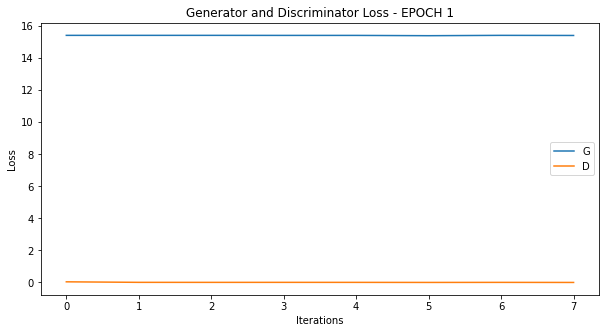

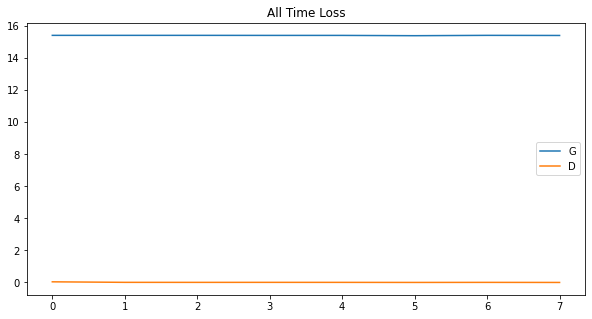

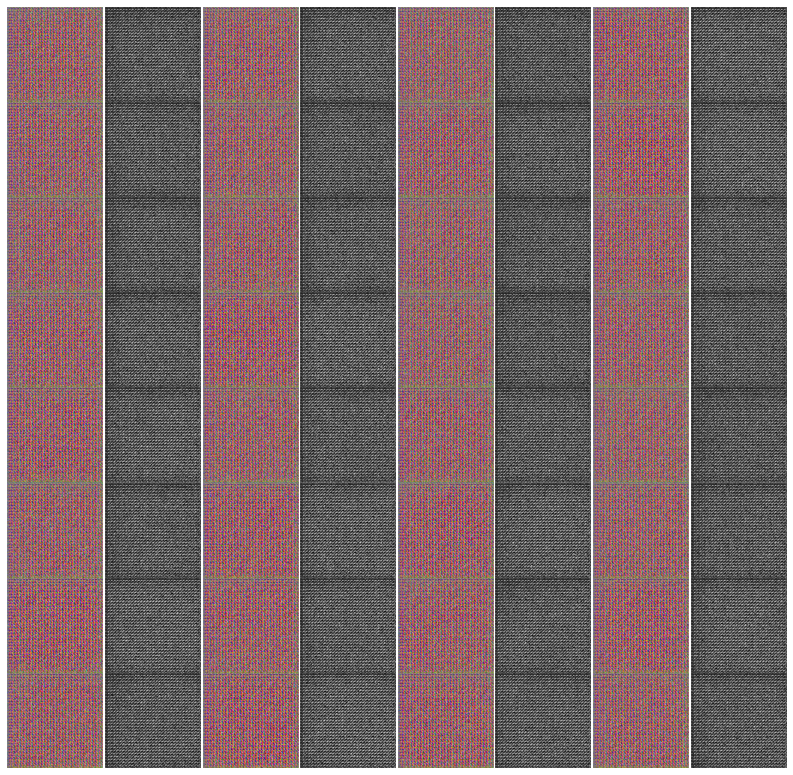





  0%|          | 1/3000 [00:14<11:49:33, 14.20s/it]

Epoch: 1 computed for 14.176459789276123 sec
Gen_loss mean:  15.420688  std:  0.006897668
Disc_loss mean:  0.009416424  std:  0.011851923






  0%|          | 2/3000 [00:24<10:49:56, 13.01s/it]

Epoch: 2 computed for 10.223384857177734 sec
Gen_loss mean:  14.292846  std:  1.85522
Disc_loss mean:  0.0029595676  std:  0.0029414655






  0%|          | 3/3000 [00:34<10:07:51, 12.17s/it]

Epoch: 3 computed for 10.1946702003479 sec
Gen_loss mean:  5.7135816  std:  4.8141522
Disc_loss mean:  2.4253497  std:  3.3941324






  0%|          | 4/3000 [00:44<9:36:51, 11.55s/it] 

Epoch: 4 computed for 10.101159572601318 sec
Gen_loss mean:  3.4397452  std:  0.7438212
Disc_loss mean:  0.27344042  std:  0.107863136






  0%|          | 5/3000 [00:54<9:16:12, 11.14s/it]

Epoch: 5 computed for 10.171900272369385 sec
Gen_loss mean:  4.3133345  std:  1.1239593
Disc_loss mean:  0.10503164  std:  0.055025097






  0%|          | 6/3000 [01:05<9:01:36, 10.85s/it]

Epoch: 6 computed for 10.166298151016235 sec
Gen_loss mean:  6.165326  std:  2.908774
Disc_loss mean:  0.1946797  std:  0.19557779






  0%|          | 7/3000 [01:15<8:50:25, 10.63s/it]

Epoch: 7 computed for 10.10540771484375 sec
Gen_loss mean:  4.901261  std:  2.658144
Disc_loss mean:  0.22980508  std:  0.14091368






  0%|          | 8/3000 [01:25<8:42:26, 10.48s/it]

Epoch: 8 computed for 10.094958543777466 sec
Gen_loss mean:  5.6439643  std:  2.2168262
Disc_loss mean:  0.065359  std:  0.08341621






  0%|          | 9/3000 [01:35<8:36:48, 10.37s/it]

Epoch: 9 computed for 10.097776651382446 sec
Gen_loss mean:  8.6316395  std:  3.8125358
Disc_loss mean:  0.10161239  std:  0.12569845






  0%|          | 10/3000 [01:45<8:32:45, 10.29s/it]

Epoch: 10 computed for 10.093063831329346 sec
Gen_loss mean:  7.7139263  std:  2.8295867
Disc_loss mean:  0.029835466  std:  0.028190523






  0%|          | 11/3000 [01:55<8:32:21, 10.28s/it]

Epoch: 11 computed for 10.259840965270996 sec
Gen_loss mean:  9.535647  std:  4.8360095
Disc_loss mean:  0.22655469  std:  0.30695564






  0%|          | 12/3000 [02:05<8:29:37, 10.23s/it]

Epoch: 12 computed for 10.100228071212769 sec
Gen_loss mean:  15.308546  std:  0.13890924
Disc_loss mean:  0.03135382  std:  0.040918157






  0%|          | 13/3000 [02:16<8:27:27, 10.19s/it]

Epoch: 13 computed for 10.086159467697144 sec
Gen_loss mean:  14.337231  std:  0.7869338
Disc_loss mean:  0.0028891182  std:  0.0018679148






  0%|          | 14/3000 [02:26<8:27:28, 10.20s/it]

Epoch: 14 computed for 10.186223983764648 sec
Gen_loss mean:  7.619563  std:  2.7632651
Disc_loss mean:  0.017881673  std:  0.023298971






  0%|          | 15/3000 [02:36<8:25:28, 10.16s/it]

Epoch: 15 computed for 10.059226036071777 sec
Gen_loss mean:  6.854829  std:  1.9134803
Disc_loss mean:  0.026661362  std:  0.019176288






  1%|          | 16/3000 [02:46<8:24:55, 10.15s/it]

Epoch: 16 computed for 10.122065544128418 sec
Gen_loss mean:  10.479852  std:  3.8991938
Disc_loss mean:  0.034720853  std:  0.02896141






  1%|          | 17/3000 [02:56<8:24:31, 10.15s/it]

Epoch: 17 computed for 10.122884511947632 sec
Gen_loss mean:  6.201077  std:  1.0353563
Disc_loss mean:  0.010860073  std:  0.005378566






  1%|          | 18/3000 [03:06<8:23:07, 10.12s/it]

Epoch: 18 computed for 10.051536083221436 sec
Gen_loss mean:  5.6204453  std:  0.41604024
Disc_loss mean:  0.01682015  std:  0.0061767413






  1%|          | 19/3000 [03:16<8:23:56, 10.14s/it]

Epoch: 19 computed for 10.172938585281372 sec
Gen_loss mean:  5.4230547  std:  0.47202104
Disc_loss mean:  0.02212335  std:  0.0070338496






  1%|          | 20/3000 [03:26<8:22:31, 10.12s/it]

Epoch: 20 computed for 10.043086051940918 sec
Gen_loss mean:  6.3975115  std:  1.7372205
Disc_loss mean:  0.028369345  std:  0.021314757






  1%|          | 21/3000 [03:36<8:19:48, 10.07s/it]

Epoch: 21 computed for 9.93036437034607 sec
Gen_loss mean:  6.9603033  std:  5.566407
Disc_loss mean:  3.1458213  std:  4.8193564






  1%|          | 22/3000 [03:46<8:19:36, 10.07s/it]

Epoch: 22 computed for 10.050471067428589 sec
Gen_loss mean:  3.9214673  std:  0.7082984
Disc_loss mean:  0.20073116  std:  0.118025795






  1%|          | 23/3000 [03:57<8:20:43, 10.09s/it]

Epoch: 23 computed for 10.139312505722046 sec
Gen_loss mean:  6.3447633  std:  2.348954
Disc_loss mean:  0.10265011  std:  0.09140866






  1%|          | 24/3000 [04:07<8:20:45, 10.10s/it]

Epoch: 24 computed for 10.090709924697876 sec
Gen_loss mean:  5.295512  std:  1.2836429
Disc_loss mean:  0.06459744  std:  0.032211307






  1%|          | 25/3000 [04:17<8:19:51, 10.08s/it]

Epoch: 25 computed for 10.03087306022644 sec
Gen_loss mean:  6.992408  std:  2.7690024
Disc_loss mean:  0.088699974  std:  0.051977426






  1%|          | 26/3000 [04:27<8:19:26, 10.08s/it]

Epoch: 26 computed for 10.050903081893921 sec
Gen_loss mean:  6.659507  std:  0.9836499
Disc_loss mean:  0.026156567  std:  0.022404332






  1%|          | 27/3000 [04:37<8:20:02, 10.09s/it]

Epoch: 27 computed for 10.1143217086792 sec
Gen_loss mean:  5.3936963  std:  1.1175499
Disc_loss mean:  0.042164218  std:  0.023900233






  1%|          | 28/3000 [04:47<8:19:32, 10.09s/it]

Epoch: 28 computed for 10.056999683380127 sec
Gen_loss mean:  6.969757  std:  3.0727577
Disc_loss mean:  0.052332524  std:  0.03750624






  1%|          | 29/3000 [04:57<8:18:30, 10.07s/it]

Epoch: 29 computed for 10.013364553451538 sec
Gen_loss mean:  7.666324  std:  2.407976
Disc_loss mean:  0.03650956  std:  0.044229425






  1%|          | 30/3000 [05:07<8:18:11, 10.06s/it]

Epoch: 30 computed for 10.042332172393799 sec
Gen_loss mean:  6.7797403  std:  4.415769
Disc_loss mean:  1.2731335  std:  1.9552926






  1%|          | 31/3000 [05:17<8:18:00, 10.06s/it]

Epoch: 31 computed for 10.047741413116455 sec
Gen_loss mean:  4.17798  std:  0.4580657
Disc_loss mean:  0.08480462  std:  0.04101381






  1%|          | 32/3000 [05:27<8:18:01, 10.07s/it]

Epoch: 32 computed for 10.062650680541992 sec
Gen_loss mean:  4.5456057  std:  2.0957954
Disc_loss mean:  0.16751075  std:  0.08077922






  1%|          | 33/3000 [05:37<8:18:56, 10.09s/it]

Epoch: 33 computed for 10.125267744064331 sec
Gen_loss mean:  5.1580205  std:  1.4928007
Disc_loss mean:  0.062567316  std:  0.02594048






  1%|          | 34/3000 [05:47<8:19:04, 10.10s/it]

Epoch: 34 computed for 10.090556621551514 sec
Gen_loss mean:  6.9018044  std:  2.706976
Disc_loss mean:  0.05642374  std:  0.039469462






  1%|          | 35/3000 [05:58<8:19:25, 10.11s/it]

Epoch: 35 computed for 10.113276243209839 sec
Gen_loss mean:  5.3231506  std:  1.1750702
Disc_loss mean:  0.051043745  std:  0.020906929






  1%|          | 36/3000 [06:08<8:18:19, 10.09s/it]

Epoch: 36 computed for 10.030461072921753 sec
Gen_loss mean:  7.2452164  std:  4.155275
Disc_loss mean:  1.3791658  std:  3.2497997






  1%|          | 37/3000 [06:18<8:17:59, 10.08s/it]

Epoch: 37 computed for 10.060519218444824 sec
Gen_loss mean:  4.5249615  std:  0.9935397
Disc_loss mean:  0.09711546  std:  0.061659534






  1%|▏         | 38/3000 [06:28<8:18:42, 10.10s/it]

Epoch: 38 computed for 10.127440452575684 sec
Gen_loss mean:  5.3414288  std:  1.3499348
Disc_loss mean:  0.07022051  std:  0.045077957






  1%|▏         | 39/3000 [06:38<8:18:26, 10.10s/it]

Epoch: 39 computed for 10.081647396087646 sec
Gen_loss mean:  5.354491  std:  0.65329146
Disc_loss mean:  0.03447254  std:  0.010903177


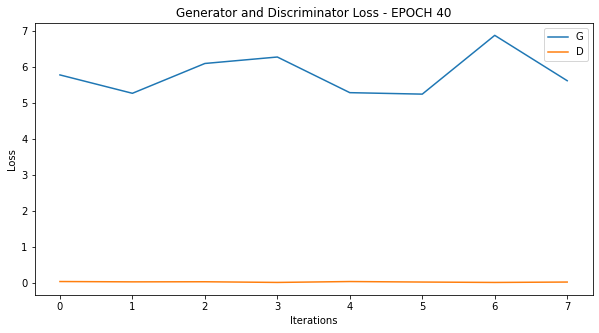

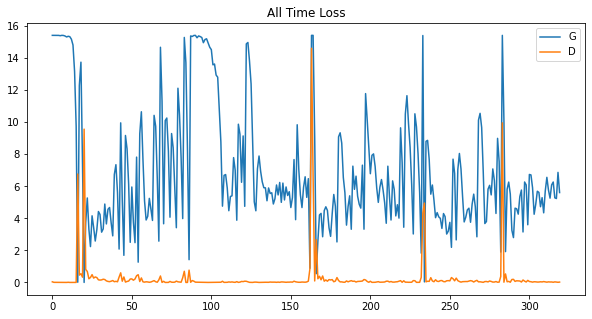

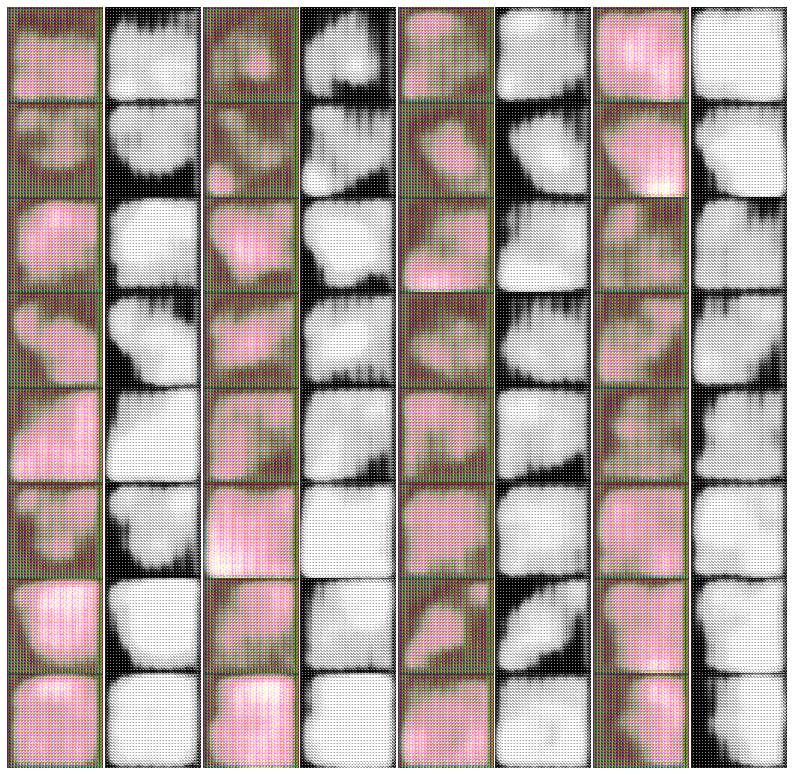





  1%|▏         | 40/3000 [06:52<9:20:13, 11.36s/it]

Epoch: 40 computed for 14.261223554611206 sec
Gen_loss mean:  5.7994213  std:  0.5432911
Disc_loss mean:  0.025257252  std:  0.009270247






  1%|▏         | 41/3000 [07:03<9:04:52, 11.05s/it]

Epoch: 41 computed for 10.32087779045105 sec
Gen_loss mean:  6.120126  std:  1.2348464
Disc_loss mean:  0.01912621  std:  0.012362536






  1%|▏         | 42/3000 [07:13<8:52:39, 10.80s/it]

Epoch: 42 computed for 10.21862530708313 sec
Gen_loss mean:  5.4931097  std:  0.22010015
Disc_loss mean:  0.017230742  std:  0.0072743855






  1%|▏         | 43/3000 [07:23<8:43:10, 10.62s/it]

Epoch: 43 computed for 10.159652709960938 sec
Gen_loss mean:  5.974874  std:  1.7092813
Disc_loss mean:  0.029410185  std:  0.01651829






  1%|▏         | 44/3000 [07:33<8:34:19, 10.44s/it]

Epoch: 44 computed for 10.007540941238403 sec
Gen_loss mean:  6.684123  std:  4.4204373
Disc_loss mean:  2.798806  std:  4.7475476






  2%|▏         | 45/3000 [07:43<8:28:41, 10.33s/it]

Epoch: 45 computed for 10.05433440208435 sec
Gen_loss mean:  3.5533357  std:  1.4458095
Disc_loss mean:  0.2974593  std:  0.34898442






  2%|▏         | 46/3000 [07:53<8:26:09, 10.28s/it]

Epoch: 46 computed for 10.148377656936646 sec
Gen_loss mean:  3.8323076  std:  0.3696817
Disc_loss mean:  0.09597311  std:  0.022237245






  2%|▏         | 47/3000 [08:03<8:23:16, 10.23s/it]

Epoch: 47 computed for 10.078068494796753 sec
Gen_loss mean:  3.7847927  std:  0.6001773
Disc_loss mean:  0.13803507  std:  0.050856076






  2%|▏         | 48/3000 [08:14<8:22:20, 10.21s/it]

Epoch: 48 computed for 10.160275220870972 sec
Gen_loss mean:  4.601342  std:  1.5591269
Disc_loss mean:  0.1149495  std:  0.03615557






  2%|▏         | 49/3000 [08:24<8:20:36, 10.18s/it]

Epoch: 49 computed for 10.091593265533447 sec
Gen_loss mean:  4.5129666  std:  1.4256777
Disc_loss mean:  0.087118946  std:  0.08181057
Saved temporary images for evaluation.
Removed temporary image directory.






  2%|▏         | 50/3000 [08:40<9:44:27, 11.89s/it]

Epoch: 50 computed for 15.850401401519775 sec
Gen_loss mean:  5.4374433  std:  4.4030843
Disc_loss mean:  0.6115886  std:  1.0617702






  2%|▏         | 51/3000 [08:50<9:19:24, 11.38s/it]

Epoch: 51 computed for 10.182660818099976 sec
Gen_loss mean:  4.171945  std:  1.673562
Disc_loss mean:  0.12183596  std:  0.13250354






  2%|▏         | 52/3000 [09:00<9:00:43, 11.01s/it]

Epoch: 52 computed for 10.109374523162842 sec
Gen_loss mean:  6.980486  std:  3.6802688
Disc_loss mean:  0.33475262  std:  0.5009638






  2%|▏         | 53/3000 [09:10<8:47:29, 10.74s/it]

Epoch: 53 computed for 10.103012084960938 sec
Gen_loss mean:  4.778717  std:  0.594235
Disc_loss mean:  0.099629804  std:  0.0410548






  2%|▏         | 54/3000 [09:20<8:38:57, 10.57s/it]

Epoch: 54 computed for 10.159319400787354 sec
Gen_loss mean:  5.4546437  std:  2.5353918
Disc_loss mean:  0.09668259  std:  0.0445304






  2%|▏         | 55/3000 [09:30<8:31:58, 10.43s/it]

Epoch: 55 computed for 10.09168028831482 sec
Gen_loss mean:  6.6519437  std:  1.5353606
Disc_loss mean:  0.04864672  std:  0.029705476






  2%|▏         | 56/3000 [09:40<8:25:18, 10.30s/it]

Epoch: 56 computed for 9.976048231124878 sec
Gen_loss mean:  5.622487  std:  4.0566306
Disc_loss mean:  0.6243551  std:  1.060957






  2%|▏         | 57/3000 [09:50<8:23:49, 10.27s/it]

Epoch: 57 computed for 10.19118618965149 sec
Gen_loss mean:  5.4413395  std:  1.2773286
Disc_loss mean:  0.0719201  std:  0.034157727






  2%|▏         | 58/3000 [10:01<8:21:05, 10.22s/it]

Epoch: 58 computed for 10.083941221237183 sec
Gen_loss mean:  5.535069  std:  1.5676004
Disc_loss mean:  0.06157689  std:  0.02616619






  2%|▏         | 59/3000 [10:11<8:19:02, 10.18s/it]

Epoch: 59 computed for 10.075105428695679 sec
Gen_loss mean:  7.8342237  std:  4.629758
Disc_loss mean:  0.29082948  std:  0.35820025






  2%|▏         | 60/3000 [10:21<8:18:27, 10.17s/it]

Epoch: 60 computed for 10.139279842376709 sec
Gen_loss mean:  10.313759  std:  4.411894
Disc_loss mean:  0.061089687  std:  0.09544153






  2%|▏         | 61/3000 [10:31<8:16:59, 10.15s/it]

Epoch: 61 computed for 10.070538520812988 sec
Gen_loss mean:  8.854294  std:  4.9000645
Disc_loss mean:  0.26904073  std:  0.2981161






  2%|▏         | 62/3000 [10:41<8:17:01, 10.15s/it]

Epoch: 62 computed for 10.146453619003296 sec
Gen_loss mean:  7.1086845  std:  1.9431946
Disc_loss mean:  0.09225596  std:  0.09135686






  2%|▏         | 63/3000 [10:51<8:16:19, 10.14s/it]

Epoch: 63 computed for 10.100086688995361 sec
Gen_loss mean:  7.758853  std:  3.7655146
Disc_loss mean:  0.16524935  std:  0.117238835






  2%|▏         | 64/3000 [11:01<8:16:41, 10.15s/it]

Epoch: 64 computed for 10.160242795944214 sec
Gen_loss mean:  8.36511  std:  5.1490607
Disc_loss mean:  0.5870924  std:  0.5711987






  2%|▏         | 65/3000 [11:11<8:16:37, 10.15s/it]

Epoch: 65 computed for 10.143383264541626 sec
Gen_loss mean:  6.8672237  std:  2.4324348
Disc_loss mean:  0.19863257  std:  0.22817999






  2%|▏         | 66/3000 [11:22<8:16:32, 10.15s/it]

Epoch: 66 computed for 10.145498514175415 sec
Gen_loss mean:  7.393152  std:  3.8671246
Disc_loss mean:  0.26005134  std:  0.3653634






  2%|▏         | 67/3000 [11:32<8:15:24, 10.13s/it]

Epoch: 67 computed for 10.071069955825806 sec
Gen_loss mean:  4.9872284  std:  0.9934823
Disc_loss mean:  0.06258473  std:  0.0524527






  2%|▏         | 68/3000 [11:42<8:15:56, 10.15s/it]

Epoch: 68 computed for 10.161353588104248 sec
Gen_loss mean:  6.6093254  std:  3.2448523
Disc_loss mean:  0.18808647  std:  0.16762674






  2%|▏         | 69/3000 [11:52<8:14:56, 10.13s/it]

Epoch: 69 computed for 10.07405138015747 sec
Gen_loss mean:  6.743542  std:  2.2803383
Disc_loss mean:  0.1088574  std:  0.07346542






  2%|▏         | 70/3000 [12:02<8:15:03, 10.14s/it]

Epoch: 70 computed for 10.13729739189148 sec
Gen_loss mean:  9.971589  std:  5.2938037
Disc_loss mean:  0.44072524  std:  0.5451163






  2%|▏         | 71/3000 [12:12<8:15:46, 10.16s/it]

Epoch: 71 computed for 10.18155550956726 sec
Gen_loss mean:  5.1873655  std:  1.499528
Disc_loss mean:  0.086276576  std:  0.045539893






  2%|▏         | 72/3000 [12:23<8:17:19, 10.19s/it]

Epoch: 72 computed for 10.258044481277466 sec
Gen_loss mean:  4.986297  std:  1.9192098
Disc_loss mean:  0.34904563  std:  0.70962274






  2%|▏         | 73/3000 [12:33<8:15:54, 10.17s/it]

Epoch: 73 computed for 10.091933012008667 sec
Gen_loss mean:  7.322258  std:  5.2247224
Disc_loss mean:  3.7771065  std:  5.601868






  2%|▏         | 74/3000 [12:43<8:15:09, 10.15s/it]

Epoch: 74 computed for 10.109401226043701 sec
Gen_loss mean:  3.8242157  std:  0.8792309
Disc_loss mean:  0.22472344  std:  0.0837411






  2%|▎         | 75/3000 [12:53<8:15:14, 10.16s/it]

Epoch: 75 computed for 10.15626573562622 sec
Gen_loss mean:  3.580902  std:  2.0591662
Disc_loss mean:  0.59603417  std:  1.0162532






  3%|▎         | 76/3000 [13:03<8:14:52, 10.15s/it]

Epoch: 76 computed for 10.129063129425049 sec
Gen_loss mean:  6.7061453  std:  2.475687
Disc_loss mean:  0.18384244  std:  0.20274831






  3%|▎         | 77/3000 [13:13<8:14:50, 10.16s/it]

Epoch: 77 computed for 10.151437282562256 sec
Gen_loss mean:  4.1439643  std:  1.1792233
Disc_loss mean:  0.14486799  std:  0.057884604






  3%|▎         | 78/3000 [13:23<8:13:44, 10.14s/it]

Epoch: 78 computed for 10.07525634765625 sec
Gen_loss mean:  4.4884706  std:  1.949869
Disc_loss mean:  0.24967879  std:  0.38689947






  3%|▎         | 79/3000 [13:34<8:13:46, 10.14s/it]

Epoch: 79 computed for 10.135151147842407 sec
Gen_loss mean:  4.912013  std:  3.9421682
Disc_loss mean:  1.173629  std:  2.4776814


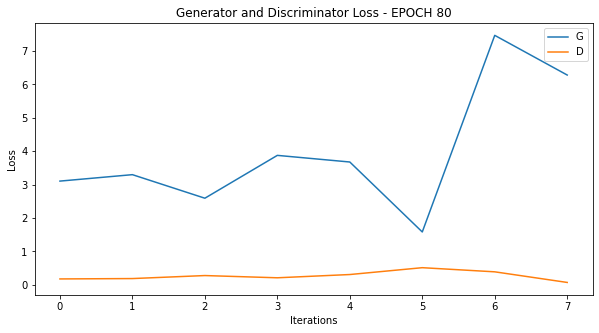

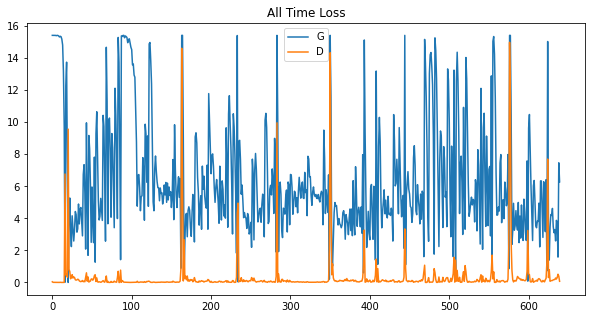

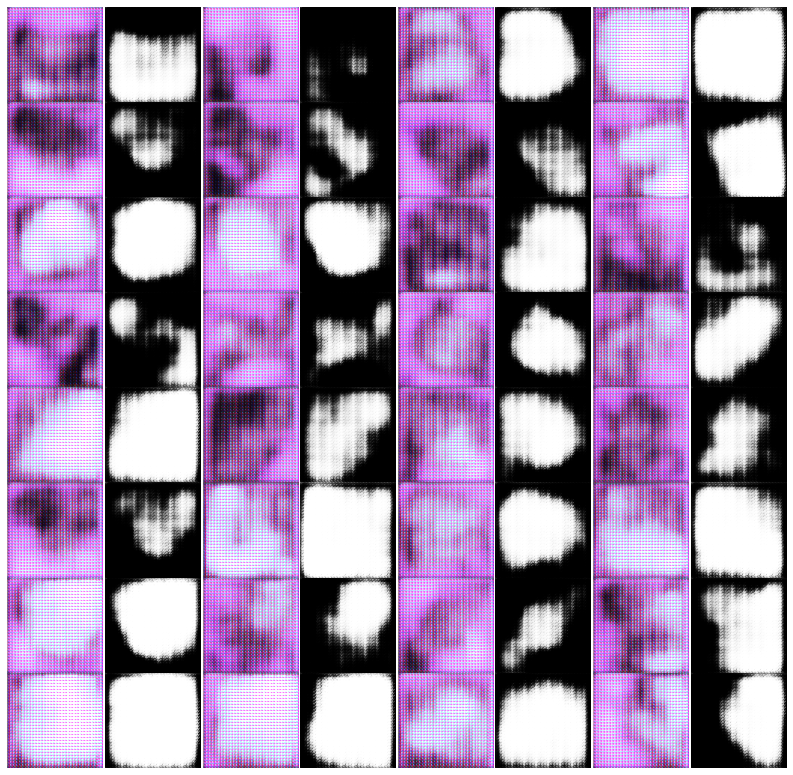





  3%|▎         | 80/3000 [13:48<9:15:24, 11.41s/it]

Epoch: 80 computed for 14.344254732131958 sec
Gen_loss mean:  3.9851556  std:  1.8188981
Disc_loss mean:  0.2667157  std:  0.12910585






  3%|▎         | 81/3000 [13:58<8:57:20, 11.05s/it]

Epoch: 81 computed for 10.173816204071045 sec
Gen_loss mean:  4.2321005  std:  2.2562928
Disc_loss mean:  0.42647305  std:  0.5692862






  3%|▎         | 82/3000 [14:08<8:43:31, 10.76s/it]

Epoch: 82 computed for 10.093523979187012 sec
Gen_loss mean:  5.9228196  std:  3.0262477
Disc_loss mean:  0.3921824  std:  0.72837585






  3%|▎         | 83/3000 [14:18<8:34:10, 10.58s/it]

Epoch: 83 computed for 10.119351625442505 sec
Gen_loss mean:  4.6632824  std:  1.4464965
Disc_loss mean:  0.13187557  std:  0.04346759






  3%|▎         | 84/3000 [14:28<8:27:06, 10.43s/it]

Epoch: 84 computed for 10.086478233337402 sec
Gen_loss mean:  4.649699  std:  0.77560383
Disc_loss mean:  0.095958814  std:  0.045730066






  3%|▎         | 85/3000 [14:39<8:21:31, 10.32s/it]

Epoch: 85 computed for 10.047970533370972 sec
Gen_loss mean:  5.2693133  std:  1.0515761
Disc_loss mean:  0.08126329  std:  0.0730785






  3%|▎         | 86/3000 [14:49<8:18:52, 10.27s/it]

Epoch: 86 computed for 10.136741876602173 sec
Gen_loss mean:  5.75535  std:  4.037777
Disc_loss mean:  1.3175398  std:  2.1804857






  3%|▎         | 87/3000 [14:59<8:16:50, 10.23s/it]

Epoch: 87 computed for 10.128185272216797 sec
Gen_loss mean:  4.8754015  std:  0.65578055
Disc_loss mean:  0.06885493  std:  0.057501044






  3%|▎         | 88/3000 [15:09<8:15:05, 10.20s/it]

Epoch: 88 computed for 10.110459566116333 sec
Gen_loss mean:  3.474713  std:  0.26469448
Disc_loss mean:  0.11134285  std:  0.02484357






  3%|▎         | 89/3000 [15:19<8:13:30, 10.17s/it]

Epoch: 89 computed for 10.091233253479004 sec
Gen_loss mean:  4.6503587  std:  1.8598183
Disc_loss mean:  0.21776694  std:  0.14194046






  3%|▎         | 90/3000 [15:29<8:14:07, 10.19s/it]

Epoch: 90 computed for 10.202955484390259 sec
Gen_loss mean:  4.593692  std:  0.5463361
Disc_loss mean:  0.083368436  std:  0.04015396






  3%|▎         | 91/3000 [15:39<8:13:45, 10.18s/it]

Epoch: 91 computed for 10.161745071411133 sec
Gen_loss mean:  4.8138804  std:  0.49052915
Disc_loss mean:  0.044684093  std:  0.029751644






  3%|▎         | 92/3000 [15:50<8:12:14, 10.16s/it]

Epoch: 92 computed for 10.076441764831543 sec
Gen_loss mean:  5.6523895  std:  4.143848
Disc_loss mean:  1.3146183  std:  2.8522873






  3%|▎         | 93/3000 [16:00<8:13:10, 10.18s/it]

Epoch: 93 computed for 10.217909097671509 sec
Gen_loss mean:  4.118191  std:  0.43883282
Disc_loss mean:  0.050168667  std:  0.01361444






  3%|▎         | 94/3000 [16:10<8:12:38, 10.17s/it]

Epoch: 94 computed for 10.139770984649658 sec
Gen_loss mean:  4.354429  std:  0.3199166
Disc_loss mean:  0.048965372  std:  0.013749245






  3%|▎         | 95/3000 [16:20<8:12:48, 10.18s/it]

Epoch: 95 computed for 10.178760051727295 sec
Gen_loss mean:  4.7635775  std:  0.4700447
Disc_loss mean:  0.042480625  std:  0.00791592






  3%|▎         | 96/3000 [16:30<8:12:02, 10.17s/it]

Epoch: 96 computed for 10.123548984527588 sec
Gen_loss mean:  4.664156  std:  0.33498836
Disc_loss mean:  0.03974326  std:  0.012360764






  3%|▎         | 97/3000 [16:40<8:11:25, 10.16s/it]

Epoch: 97 computed for 10.117562294006348 sec
Gen_loss mean:  5.1636953  std:  0.40410456
Disc_loss mean:  0.02672853  std:  0.013586396






  3%|▎         | 98/3000 [16:51<8:11:43, 10.17s/it]

Epoch: 98 computed for 10.175339221954346 sec
Gen_loss mean:  5.0265765  std:  0.29455867
Disc_loss mean:  0.028534308  std:  0.011089036






  3%|▎         | 99/3000 [17:01<8:13:56, 10.22s/it]

Epoch: 99 computed for 10.317745685577393 sec
Gen_loss mean:  4.997519  std:  0.25604382
Disc_loss mean:  0.027260575  std:  0.013019953
Saved temporary images for evaluation.
Removed temporary image directory.






  3%|▎         | 100/3000 [17:17<9:40:51, 12.02s/it]

Epoch: 100 computed for 16.193110704421997 sec
Gen_loss mean:  5.1556826  std:  0.4311626
Disc_loss mean:  0.01995869  std:  0.004600544






  3%|▎         | 101/3000 [17:28<9:16:27, 11.52s/it]

Epoch: 101 computed for 10.323508501052856 sec
Gen_loss mean:  5.6945767  std:  1.9191127
Disc_loss mean:  0.036113523  std:  0.027487498






  3%|▎         | 102/3000 [17:38<8:57:40, 11.13s/it]

Epoch: 102 computed for 10.217014074325562 sec
Gen_loss mean:  7.2081375  std:  2.888637
Disc_loss mean:  0.1854027  std:  0.42135584






  3%|▎         | 103/3000 [17:48<8:42:18, 10.82s/it]

Epoch: 103 computed for 10.058704376220703 sec
Gen_loss mean:  1.909116  std:  1.2613695
Disc_loss mean:  2.5323334  std:  3.5529537






  3%|▎         | 104/3000 [17:58<8:32:43, 10.62s/it]

Epoch: 104 computed for 10.155383348464966 sec
Gen_loss mean:  3.162537  std:  0.5142949
Disc_loss mean:  0.21298489  std:  0.10049547






  4%|▎         | 105/3000 [18:08<8:24:32, 10.46s/it]

Epoch: 105 computed for 10.055829048156738 sec
Gen_loss mean:  4.0909166  std:  0.5298832
Disc_loss mean:  0.09191438  std:  0.06284974






  4%|▎         | 106/3000 [18:18<8:20:03, 10.37s/it]

Epoch: 106 computed for 10.143173694610596 sec
Gen_loss mean:  5.0789766  std:  4.1205664
Disc_loss mean:  1.3273757  std:  1.7165521






  4%|▎         | 107/3000 [18:28<8:16:11, 10.29s/it]

Epoch: 107 computed for 10.095940828323364 sec
Gen_loss mean:  3.8343303  std:  1.3304279
Disc_loss mean:  0.17655054  std:  0.07143806






  4%|▎         | 108/3000 [18:38<8:12:35, 10.22s/it]

Epoch: 108 computed for 10.03732442855835 sec
Gen_loss mean:  4.4127812  std:  2.7323675
Disc_loss mean:  0.71236056  std:  0.8806656






  4%|▎         | 109/3000 [18:49<8:11:19, 10.20s/it]

Epoch: 109 computed for 10.130878448486328 sec
Gen_loss mean:  4.0420876  std:  0.36099356
Disc_loss mean:  0.080949835  std:  0.026705103






  4%|▎         | 110/3000 [18:59<8:09:31, 10.16s/it]

Epoch: 110 computed for 10.061946392059326 sec
Gen_loss mean:  4.3687053  std:  0.41958654
Disc_loss mean:  0.09646487  std:  0.030202989






  4%|▎         | 111/3000 [19:09<8:08:37, 10.15s/it]

Epoch: 111 computed for 10.097638607025146 sec
Gen_loss mean:  4.615528  std:  1.7061002
Disc_loss mean:  0.19794516  std:  0.16869237






  4%|▎         | 112/3000 [19:19<8:08:03, 10.14s/it]

Epoch: 112 computed for 10.105481147766113 sec
Gen_loss mean:  4.658821  std:  3.9386353
Disc_loss mean:  1.59328  std:  2.2447112






  4%|▍         | 113/3000 [19:29<8:06:44, 10.12s/it]

Epoch: 113 computed for 10.046578168869019 sec
Gen_loss mean:  3.1833663  std:  0.24714981
Disc_loss mean:  0.17778206  std:  0.035168007






  4%|▍         | 114/3000 [19:39<8:07:35, 10.14s/it]

Epoch: 114 computed for 10.171847820281982 sec
Gen_loss mean:  4.0357985  std:  1.6212096
Disc_loss mean:  0.2312233  std:  0.16207072






  4%|▍         | 115/3000 [19:49<8:06:47, 10.12s/it]

Epoch: 115 computed for 10.074934482574463 sec
Gen_loss mean:  3.958902  std:  4.295023
Disc_loss mean:  2.8861365  std:  3.3662493






  4%|▍         | 116/3000 [19:59<8:05:56, 10.11s/it]

Epoch: 116 computed for 10.057915925979614 sec
Gen_loss mean:  2.9404979  std:  0.5789595
Disc_loss mean:  0.24783987  std:  0.12969698






  4%|▍         | 117/3000 [20:09<8:06:17, 10.12s/it]

Epoch: 117 computed for 10.129781246185303 sec
Gen_loss mean:  3.2502666  std:  0.54598814
Disc_loss mean:  0.16476789  std:  0.03206981






  4%|▍         | 118/3000 [20:19<8:05:27, 10.11s/it]

Epoch: 118 computed for 10.061542510986328 sec
Gen_loss mean:  3.5553226  std:  1.1014819
Disc_loss mean:  0.23284352  std:  0.13661267






  4%|▍         | 119/3000 [20:30<8:05:17, 10.11s/it]

Epoch: 119 computed for 10.092321634292603 sec
Gen_loss mean:  3.9946823  std:  2.8265746
Disc_loss mean:  1.6169488  std:  2.4798262


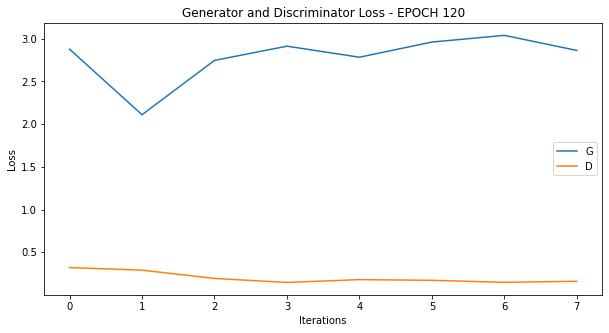

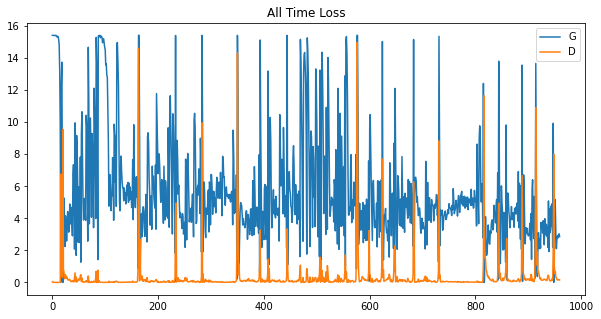

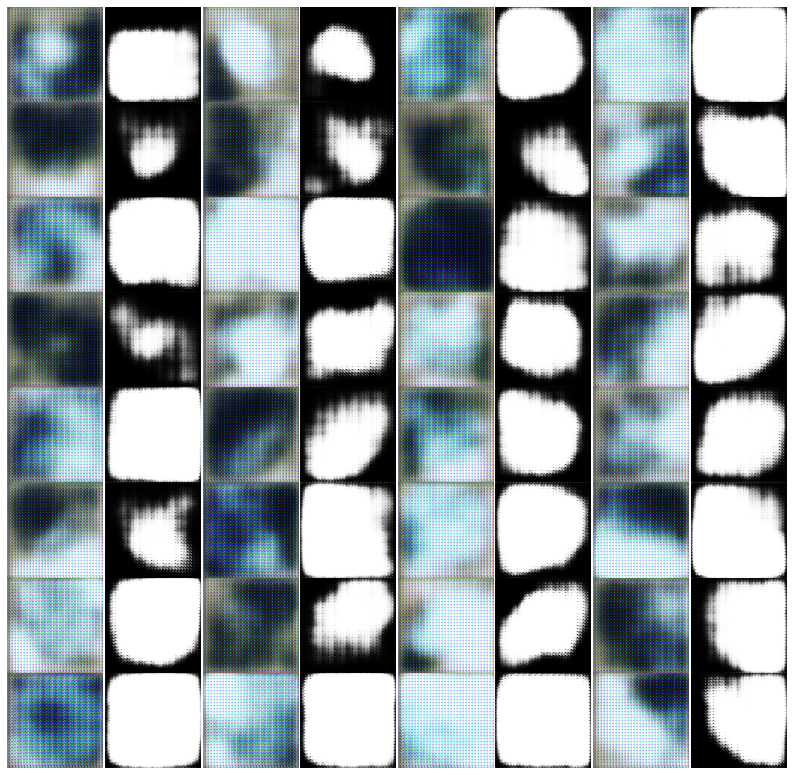





  4%|▍         | 120/3000 [20:44<9:04:09, 11.34s/it]

Epoch: 120 computed for 14.18340015411377 sec
Gen_loss mean:  2.7857084  std:  0.26986203
Disc_loss mean:  0.20167238  std:  0.062299255






  4%|▍         | 121/3000 [20:54<8:47:55, 11.00s/it]

Epoch: 121 computed for 10.208089351654053 sec
Gen_loss mean:  3.6829467  std:  1.05657
Disc_loss mean:  0.12696153  std:  0.04345935






  4%|▍         | 122/3000 [21:04<8:34:19, 10.72s/it]

Epoch: 122 computed for 10.056265592575073 sec
Gen_loss mean:  3.9309452  std:  4.355213
Disc_loss mean:  2.5844018  std:  3.362435






  4%|▍         | 123/3000 [21:14<8:25:29, 10.54s/it]

Epoch: 123 computed for 10.10416316986084 sec
Gen_loss mean:  3.0574737  std:  0.5056089
Disc_loss mean:  0.2446256  std:  0.12969755






  4%|▍         | 124/3000 [21:24<8:20:02, 10.43s/it]

Epoch: 124 computed for 10.161098957061768 sec
Gen_loss mean:  3.494145  std:  0.68960345
Disc_loss mean:  0.14369501  std:  0.052815046






  4%|▍         | 125/3000 [21:35<8:16:26, 10.36s/it]

Epoch: 125 computed for 10.179269552230835 sec
Gen_loss mean:  4.679663  std:  2.962092
Disc_loss mean:  0.69572204  std:  0.84038144






  4%|▍         | 126/3000 [21:45<8:12:13, 10.28s/it]

Epoch: 126 computed for 10.065210103988647 sec
Gen_loss mean:  4.230548  std:  1.4998397
Disc_loss mean:  0.18295035  std:  0.3199027






  4%|▍         | 127/3000 [21:55<8:09:26, 10.22s/it]

Epoch: 127 computed for 10.078367710113525 sec
Gen_loss mean:  4.3812304  std:  0.6679284
Disc_loss mean:  0.08207263  std:  0.030356972






  4%|▍         | 128/3000 [22:05<8:07:38, 10.19s/it]

Epoch: 128 computed for 10.092026472091675 sec
Gen_loss mean:  4.492857  std:  0.44843802
Disc_loss mean:  0.064347774  std:  0.024228364






  4%|▍         | 129/3000 [22:15<8:06:24, 10.17s/it]

Epoch: 129 computed for 10.099721431732178 sec
Gen_loss mean:  4.816327  std:  1.600429
Disc_loss mean:  0.0814338  std:  0.032567337






  4%|▍         | 130/3000 [22:25<8:06:15, 10.17s/it]

Epoch: 130 computed for 10.142037391662598 sec
Gen_loss mean:  5.2117815  std:  1.3921628
Disc_loss mean:  0.04746263  std:  0.020274067






  4%|▍         | 131/3000 [22:35<8:07:22, 10.19s/it]

Epoch: 131 computed for 10.226428985595703 sec
Gen_loss mean:  4.5949154  std:  0.83598703
Disc_loss mean:  0.050430126  std:  0.02997308






  4%|▍         | 132/3000 [22:46<8:08:06, 10.21s/it]

Epoch: 132 computed for 10.242315769195557 sec
Gen_loss mean:  7.7032914  std:  3.1810958
Disc_loss mean:  0.10534525  std:  0.12959579






  4%|▍         | 133/3000 [22:56<8:06:31, 10.18s/it]

Epoch: 133 computed for 10.097330331802368 sec
Gen_loss mean:  5.751459  std:  1.5669891
Disc_loss mean:  0.032014497  std:  0.024331119






  4%|▍         | 134/3000 [23:06<8:05:37, 10.17s/it]

Epoch: 134 computed for 10.113747596740723 sec
Gen_loss mean:  5.5004025  std:  4.1198635
Disc_loss mean:  1.4558611  std:  2.789608






  4%|▍         | 135/3000 [23:16<8:04:42, 10.15s/it]

Epoch: 135 computed for 10.101231098175049 sec
Gen_loss mean:  3.3619938  std:  0.90539545
Disc_loss mean:  0.14663929  std:  0.07343511






  5%|▍         | 136/3000 [23:26<8:04:06, 10.14s/it]

Epoch: 136 computed for 10.102548837661743 sec
Gen_loss mean:  4.068199  std:  0.74004394
Disc_loss mean:  0.12734911  std:  0.055073764






  5%|▍         | 137/3000 [23:36<8:03:54, 10.14s/it]

Epoch: 137 computed for 10.124221086502075 sec
Gen_loss mean:  4.9178  std:  4.271866
Disc_loss mean:  1.140489  std:  2.2054062






  5%|▍         | 138/3000 [23:46<8:03:04, 10.13s/it]

Epoch: 138 computed for 10.079838991165161 sec
Gen_loss mean:  3.5891814  std:  0.5908468
Disc_loss mean:  0.10848954  std:  0.046163704






  5%|▍         | 139/3000 [23:57<8:03:25, 10.14s/it]

Epoch: 139 computed for 10.149498701095581 sec
Gen_loss mean:  3.9507742  std:  0.97056705
Disc_loss mean:  0.19234878  std:  0.1512825






  5%|▍         | 140/3000 [24:07<8:02:24, 10.12s/it]

Epoch: 140 computed for 10.065613031387329 sec
Gen_loss mean:  4.289024  std:  0.4016238
Disc_loss mean:  0.06382644  std:  0.02059508






  5%|▍         | 141/3000 [24:17<8:01:56, 10.11s/it]

Epoch: 141 computed for 10.0829598903656 sec
Gen_loss mean:  5.32031  std:  0.74249566
Disc_loss mean:  0.05699127  std:  0.04254447






  5%|▍         | 142/3000 [24:27<8:02:09, 10.12s/it]

Epoch: 142 computed for 10.125777959823608 sec
Gen_loss mean:  4.682392  std:  4.1847982
Disc_loss mean:  1.259479  std:  2.2955818






  5%|▍         | 143/3000 [24:37<8:01:31, 10.11s/it]

Epoch: 143 computed for 10.075931072235107 sec
Gen_loss mean:  3.164441  std:  0.7004159
Disc_loss mean:  0.20854256  std:  0.06018328






  5%|▍         | 144/3000 [24:47<8:01:44, 10.12s/it]

Epoch: 144 computed for 10.126161098480225 sec
Gen_loss mean:  4.7020273  std:  2.44967
Disc_loss mean:  0.5443642  std:  0.6727444






  5%|▍         | 145/3000 [24:57<8:01:00, 10.11s/it]

Epoch: 145 computed for 10.06430459022522 sec
Gen_loss mean:  3.3354287  std:  0.95350647
Disc_loss mean:  0.19973187  std:  0.15014897






  5%|▍         | 146/3000 [25:07<8:00:16, 10.10s/it]

Epoch: 146 computed for 10.055684804916382 sec
Gen_loss mean:  2.9692702  std:  2.2246766
Disc_loss mean:  1.4230015  std:  1.5682458






  5%|▍         | 147/3000 [25:18<8:02:59, 10.16s/it]

Epoch: 147 computed for 10.2845299243927 sec
Gen_loss mean:  2.3912978  std:  0.37351274
Disc_loss mean:  0.40877724  std:  0.08113003






  5%|▍         | 148/3000 [25:28<8:02:49, 10.16s/it]

Epoch: 148 computed for 10.14345645904541 sec
Gen_loss mean:  4.545912  std:  1.6301568
Disc_loss mean:  0.23225418  std:  0.13800947






  5%|▍         | 149/3000 [25:38<8:01:18, 10.13s/it]

Epoch: 149 computed for 10.04993200302124 sec
Gen_loss mean:  4.9826355  std:  3.209207
Disc_loss mean:  0.55854857  std:  0.5875458
Saved temporary images for evaluation.
Removed temporary image directory.






  5%|▌         | 150/3000 [25:53<9:17:15, 11.73s/it]

Epoch: 150 computed for 15.442224979400635 sec
Gen_loss mean:  3.4998043  std:  2.41509
Disc_loss mean:  0.77842915  std:  1.15839






  5%|▌         | 151/3000 [26:03<8:53:45, 11.24s/it]

Epoch: 151 computed for 10.074574708938599 sec
Gen_loss mean:  3.5985742  std:  2.0849173
Disc_loss mean:  0.5282784  std:  0.5924326






  5%|▌         | 152/3000 [26:13<8:37:20, 10.90s/it]

Epoch: 152 computed for 10.085986852645874 sec
Gen_loss mean:  4.1397076  std:  3.14533
Disc_loss mean:  1.1464211  std:  1.879202






  5%|▌         | 153/3000 [26:24<8:26:29, 10.67s/it]

Epoch: 153 computed for 10.128990173339844 sec
Gen_loss mean:  2.7581158  std:  1.056957
Disc_loss mean:  0.24231035  std:  0.12590015






  5%|▌         | 154/3000 [26:34<8:19:06, 10.52s/it]

Epoch: 154 computed for 10.153932332992554 sec
Gen_loss mean:  5.1699953  std:  2.3818572
Disc_loss mean:  0.22235253  std:  0.22290759






  5%|▌         | 155/3000 [26:44<8:13:12, 10.40s/it]

Epoch: 155 computed for 10.105510950088501 sec
Gen_loss mean:  4.592848  std:  2.973864
Disc_loss mean:  0.73363084  std:  1.3079493






  5%|▌         | 156/3000 [26:54<8:09:46, 10.33s/it]

Epoch: 156 computed for 10.159383535385132 sec
Gen_loss mean:  2.9186559  std:  0.5493638
Disc_loss mean:  0.22606003  std:  0.1155893






  5%|▌         | 157/3000 [27:04<8:06:13, 10.26s/it]

Epoch: 157 computed for 10.082167863845825 sec
Gen_loss mean:  3.4444492  std:  2.1330605
Disc_loss mean:  0.53163946  std:  0.6171701






  5%|▌         | 158/3000 [27:14<8:03:56, 10.22s/it]

Epoch: 158 computed for 10.098535060882568 sec
Gen_loss mean:  5.092022  std:  1.755782
Disc_loss mean:  0.34116408  std:  0.48243967






  5%|▌         | 159/3000 [27:24<8:02:32, 10.19s/it]

Epoch: 159 computed for 10.117494344711304 sec
Gen_loss mean:  3.8853946  std:  0.91338927
Disc_loss mean:  0.11995448  std:  0.062910065


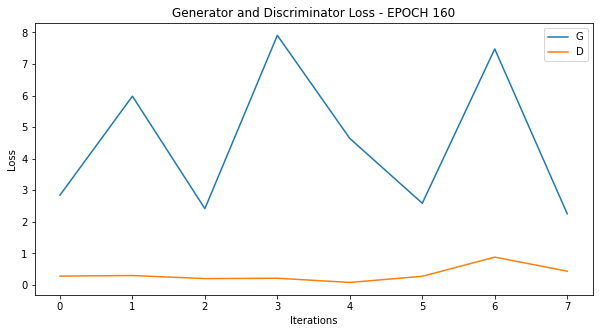

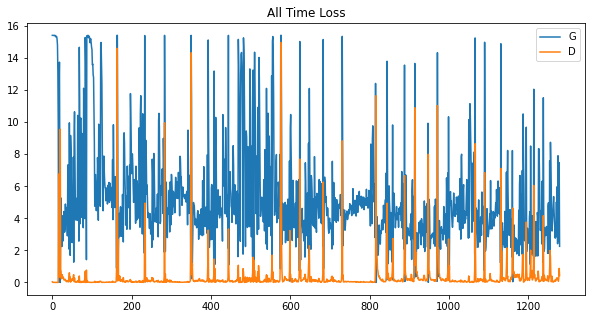

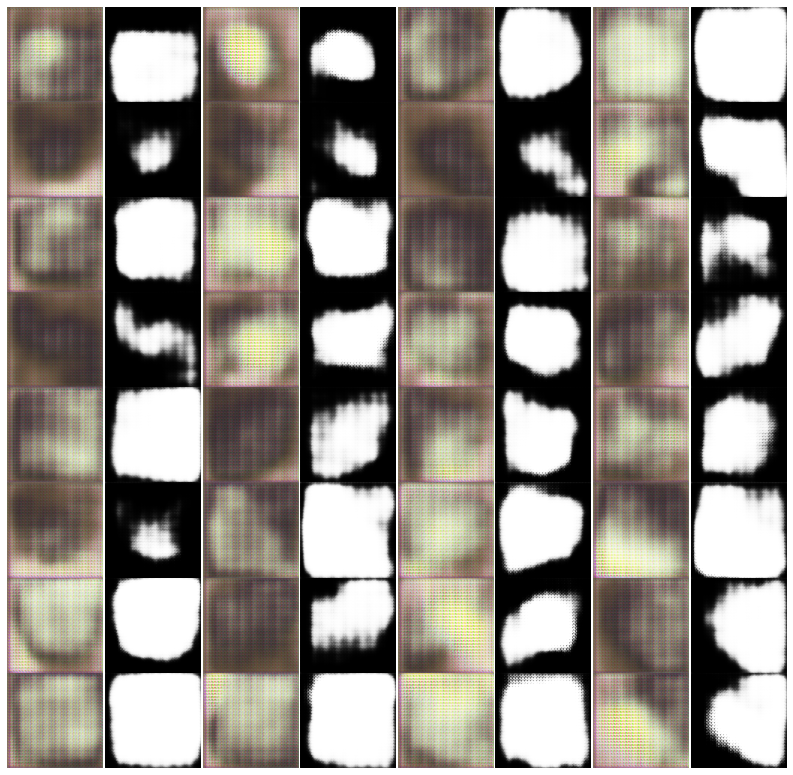





  5%|▌         | 160/3000 [27:39<9:00:20, 11.42s/it]

Epoch: 160 computed for 14.239491701126099 sec
Gen_loss mean:  4.514102  std:  2.1935534
Disc_loss mean:  0.33125988  std:  0.22777243






  5%|▌         | 161/3000 [27:49<8:49:20, 11.19s/it]

Epoch: 161 computed for 10.641256332397461 sec
Gen_loss mean:  4.044937  std:  2.886647
Disc_loss mean:  1.6696416  std:  1.6987121






  5%|▌         | 162/3000 [27:59<8:34:52, 10.89s/it]

Epoch: 162 computed for 10.164009094238281 sec
Gen_loss mean:  3.4083922  std:  1.780661
Disc_loss mean:  0.40405783  std:  0.19499134






  5%|▌         | 163/3000 [28:10<8:23:55, 10.66s/it]

Epoch: 163 computed for 10.112322330474854 sec
Gen_loss mean:  3.4328418  std:  2.3051515
Disc_loss mean:  0.59413767  std:  0.5644764






  5%|▌         | 164/3000 [28:20<8:15:52, 10.49s/it]

Epoch: 164 computed for 10.080698490142822 sec
Gen_loss mean:  3.9052324  std:  2.330136
Disc_loss mean:  0.7414099  std:  0.80518246






  6%|▌         | 165/3000 [28:30<8:09:42, 10.36s/it]

Epoch: 165 computed for 10.053691148757935 sec
Gen_loss mean:  5.1471457  std:  2.1504817
Disc_loss mean:  0.17644285  std:  0.23133312






  6%|▌         | 166/3000 [28:40<8:05:06, 10.27s/it]

Epoch: 166 computed for 10.033107042312622 sec
Gen_loss mean:  3.4677  std:  0.84244657
Disc_loss mean:  0.17551383  std:  0.09881766






  6%|▌         | 167/3000 [28:50<8:01:56, 10.21s/it]

Epoch: 167 computed for 10.04523491859436 sec
Gen_loss mean:  3.524837  std:  3.1876578
Disc_loss mean:  1.3957407  std:  1.9123229






  6%|▌         | 168/3000 [29:00<8:00:12, 10.17s/it]

Epoch: 168 computed for 10.083052635192871 sec
Gen_loss mean:  2.7157543  std:  0.96586245
Disc_loss mean:  0.3804462  std:  0.15030628






  6%|▌         | 169/3000 [29:10<7:58:23, 10.14s/it]

Epoch: 169 computed for 10.043407440185547 sec
Gen_loss mean:  3.317341  std:  2.7945824
Disc_loss mean:  1.5236709  std:  1.8531






  6%|▌         | 170/3000 [29:20<7:56:52, 10.11s/it]

Epoch: 170 computed for 10.025397300720215 sec
Gen_loss mean:  2.2588692  std:  0.4216044
Disc_loss mean:  0.35725325  std:  0.10226999






  6%|▌         | 171/3000 [29:30<7:55:25, 10.08s/it]

Epoch: 171 computed for 10.006147384643555 sec
Gen_loss mean:  2.7709293  std:  0.8202324
Disc_loss mean:  0.2827155  std:  0.117487155






  6%|▌         | 172/3000 [29:40<7:54:33, 10.07s/it]

Epoch: 172 computed for 10.019459962844849 sec
Gen_loss mean:  4.184  std:  2.8330195
Disc_loss mean:  1.2693746  std:  1.7332997






  6%|▌         | 173/3000 [29:50<7:54:23, 10.07s/it]

Epoch: 173 computed for 10.054704427719116 sec
Gen_loss mean:  2.6228251  std:  0.6310794
Disc_loss mean:  0.3789873  std:  0.22797954






  6%|▌         | 174/3000 [30:00<7:54:15, 10.07s/it]

Epoch: 174 computed for 10.058283567428589 sec
Gen_loss mean:  3.3641787  std:  0.9325981
Disc_loss mean:  0.23816594  std:  0.13649517






  6%|▌         | 175/3000 [30:10<7:54:31, 10.08s/it]

Epoch: 175 computed for 10.085599899291992 sec
Gen_loss mean:  3.8421435  std:  3.0293586
Disc_loss mean:  1.2051847  std:  1.5305891






  6%|▌         | 176/3000 [30:21<7:55:13, 10.10s/it]

Epoch: 176 computed for 10.125120162963867 sec
Gen_loss mean:  2.7724085  std:  0.51845354
Disc_loss mean:  0.20982634  std:  0.07202645






  6%|▌         | 177/3000 [30:31<7:54:47, 10.09s/it]

Epoch: 177 computed for 10.058272123336792 sec
Gen_loss mean:  3.904183  std:  1.6494298
Disc_loss mean:  0.25287175  std:  0.16861923






  6%|▌         | 178/3000 [30:41<7:54:53, 10.10s/it]

Epoch: 178 computed for 10.096785068511963 sec
Gen_loss mean:  3.9295287  std:  2.2855532
Disc_loss mean:  1.65547  std:  1.741139






  6%|▌         | 179/3000 [30:51<7:54:28, 10.09s/it]

Epoch: 179 computed for 10.066489219665527 sec
Gen_loss mean:  2.6414082  std:  1.0225956
Disc_loss mean:  0.40789282  std:  0.22799097






  6%|▌         | 180/3000 [31:01<7:53:47, 10.08s/it]

Epoch: 180 computed for 10.041067361831665 sec
Gen_loss mean:  3.0739126  std:  1.5867473
Disc_loss mean:  0.4271717  std:  0.21180825






  6%|▌         | 181/3000 [31:11<7:54:07, 10.09s/it]

Epoch: 181 computed for 10.09891128540039 sec
Gen_loss mean:  3.6067085  std:  1.2270154
Disc_loss mean:  0.24306372  std:  0.1593217






  6%|▌         | 182/3000 [31:21<7:53:22, 10.08s/it]

Epoch: 182 computed for 10.030716896057129 sec
Gen_loss mean:  3.2292259  std:  2.0534668
Disc_loss mean:  0.6907753  std:  0.6529336






  6%|▌         | 183/3000 [31:31<7:54:03, 10.10s/it]

Epoch: 183 computed for 10.125065803527832 sec
Gen_loss mean:  3.1017582  std:  0.5373718
Disc_loss mean:  0.21324775  std:  0.079728484






  6%|▌         | 184/3000 [31:41<7:54:05, 10.10s/it]

Epoch: 184 computed for 10.095560073852539 sec
Gen_loss mean:  4.069186  std:  1.9155264
Disc_loss mean:  0.27648935  std:  0.11579767






  6%|▌         | 185/3000 [31:51<7:53:36, 10.09s/it]

Epoch: 185 computed for 10.064083337783813 sec
Gen_loss mean:  4.3196793  std:  1.5120488
Disc_loss mean:  0.07476239  std:  0.06496031






  6%|▌         | 186/3000 [32:01<7:52:38, 10.08s/it]

Epoch: 186 computed for 10.025491952896118 sec
Gen_loss mean:  5.606274  std:  3.3287466
Disc_loss mean:  2.2044206  std:  3.6922278






  6%|▌         | 187/3000 [32:11<7:52:04, 10.07s/it]

Epoch: 187 computed for 10.030195474624634 sec
Gen_loss mean:  1.2968823  std:  0.33363855
Disc_loss mean:  1.0508562  std:  0.39128765






  6%|▋         | 188/3000 [32:22<7:52:01, 10.07s/it]

Epoch: 188 computed for 10.060248613357544 sec
Gen_loss mean:  1.9413359  std:  0.75640965
Disc_loss mean:  0.6165164  std:  0.19208391






  6%|▋         | 189/3000 [32:32<7:51:57, 10.07s/it]

Epoch: 189 computed for 10.063937664031982 sec
Gen_loss mean:  2.7543902  std:  1.7190533
Disc_loss mean:  0.7297293  std:  0.60910755






  6%|▋         | 190/3000 [32:42<7:51:15, 10.06s/it]

Epoch: 190 computed for 10.021059274673462 sec
Gen_loss mean:  3.1963248  std:  0.9124378
Disc_loss mean:  0.2411846  std:  0.24537748






  6%|▋         | 191/3000 [32:52<7:50:34, 10.05s/it]

Epoch: 191 computed for 10.013016700744629 sec
Gen_loss mean:  3.5121222  std:  0.4106124
Disc_loss mean:  0.089852795  std:  0.026505113






  6%|▋         | 192/3000 [33:02<7:55:32, 10.16s/it]

Epoch: 192 computed for 10.3999605178833 sec
Gen_loss mean:  4.0530796  std:  2.3819091
Disc_loss mean:  0.8889712  std:  1.775141






  6%|▋         | 193/3000 [33:12<7:54:15, 10.14s/it]

Epoch: 193 computed for 10.067721128463745 sec
Gen_loss mean:  2.8256087  std:  0.80703294
Disc_loss mean:  0.27932182  std:  0.33478045






  6%|▋         | 194/3000 [33:22<7:52:32, 10.10s/it]

Epoch: 194 computed for 10.013548612594604 sec
Gen_loss mean:  3.1603231  std:  0.57320607
Disc_loss mean:  0.16211975  std:  0.055963617






  6%|▋         | 195/3000 [33:32<7:51:15, 10.08s/it]

Epoch: 195 computed for 10.00406002998352 sec
Gen_loss mean:  3.2050543  std:  3.3131258
Disc_loss mean:  2.5982673  std:  2.2549927






  7%|▋         | 196/3000 [33:42<7:50:33, 10.07s/it]

Epoch: 196 computed for 10.023267269134521 sec
Gen_loss mean:  1.2385329  std:  0.110417776
Disc_loss mean:  0.9434906  std:  0.13145402






  7%|▋         | 197/3000 [33:52<7:49:41, 10.05s/it]

Epoch: 197 computed for 10.003180265426636 sec
Gen_loss mean:  2.0191221  std:  0.3651801
Disc_loss mean:  0.43228638  std:  0.14418125






  7%|▋         | 198/3000 [34:02<7:48:50, 10.04s/it]

Epoch: 198 computed for 9.98910403251648 sec
Gen_loss mean:  2.8298454  std:  0.4598574
Disc_loss mean:  0.20475197  std:  0.08902715






  7%|▋         | 199/3000 [34:12<7:48:34, 10.04s/it]

Epoch: 199 computed for 10.018943548202515 sec
Gen_loss mean:  4.0587564  std:  1.1642416
Disc_loss mean:  0.1495357  std:  0.14588472


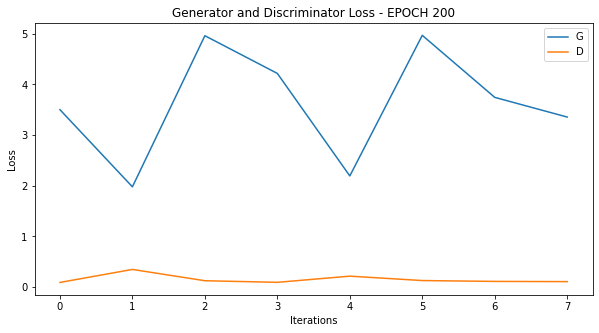

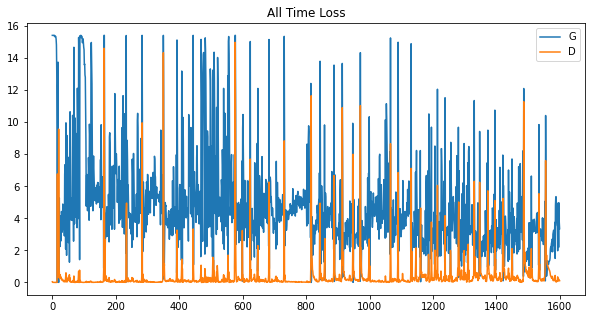

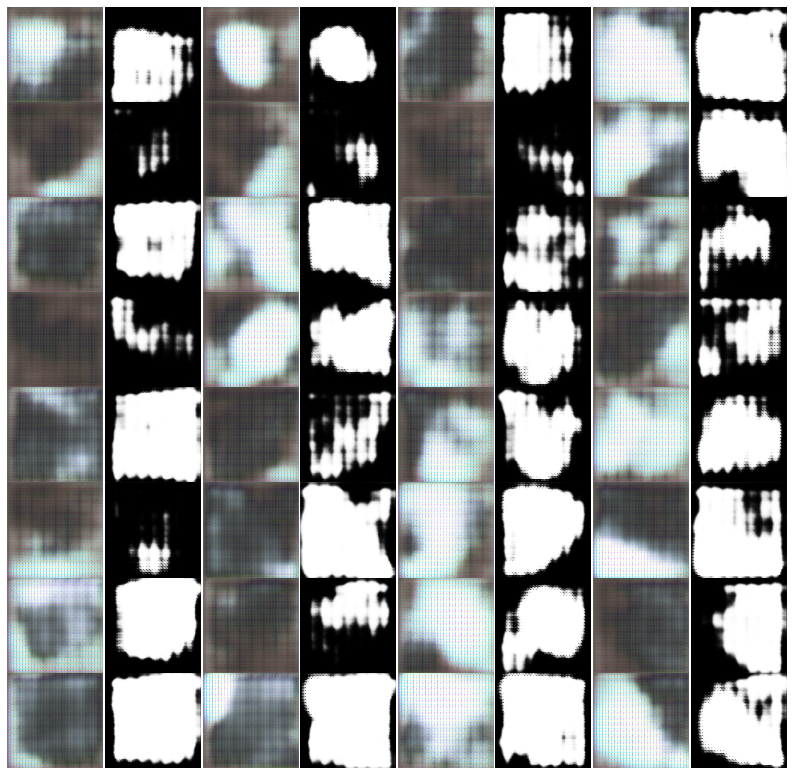

Saved temporary images for evaluation.
Removed temporary image directory.






  7%|▋         | 200/3000 [34:32<10:04:38, 12.96s/it]

Epoch: 200 computed for 19.73797106742859 sec
Gen_loss mean:  3.6138568  std:  1.04848
Disc_loss mean:  0.15259793  std:  0.082453184






  7%|▋         | 201/3000 [34:42<9:26:16, 12.14s/it] 

Epoch: 201 computed for 10.216785430908203 sec
Gen_loss mean:  2.4509835  std:  2.9678147
Disc_loss mean:  2.3402145  std:  2.3553574






  7%|▋         | 202/3000 [34:52<8:57:28, 11.53s/it]

Epoch: 202 computed for 10.071609020233154 sec
Gen_loss mean:  1.3113852  std:  0.18962142
Disc_loss mean:  0.89330876  std:  0.15534414






  7%|▋         | 203/3000 [35:03<8:38:29, 11.12s/it]

Epoch: 203 computed for 10.169165849685669 sec
Gen_loss mean:  2.286715  std:  0.5961754
Disc_loss mean:  0.42498353  std:  0.1652737






  7%|▋         | 204/3000 [35:13<8:23:40, 10.81s/it]

Epoch: 204 computed for 10.060544967651367 sec
Gen_loss mean:  2.9056206  std:  1.2955283
Disc_loss mean:  0.5784803  std:  0.57778






  7%|▋         | 205/3000 [35:23<8:15:03, 10.63s/it]

Epoch: 205 computed for 10.189615249633789 sec
Gen_loss mean:  3.449428  std:  0.5310814
Disc_loss mean:  0.1621488  std:  0.1321676






  7%|▋         | 206/3000 [35:33<8:07:18, 10.46s/it]

Epoch: 206 computed for 10.066039085388184 sec
Gen_loss mean:  3.8515553  std:  0.7790133
Disc_loss mean:  0.20107737  std:  0.110705316






  7%|▋         | 207/3000 [35:43<8:03:13, 10.38s/it]

Epoch: 207 computed for 10.16593313217163 sec
Gen_loss mean:  4.9814377  std:  2.4934907
Disc_loss mean:  0.63249254  std:  1.2767948






  7%|▋         | 208/3000 [35:53<7:59:44, 10.31s/it]

Epoch: 208 computed for 10.12823486328125 sec
Gen_loss mean:  2.103716  std:  0.9844284
Disc_loss mean:  0.97918653  std:  1.2952427






  7%|▋         | 209/3000 [36:03<7:57:40, 10.27s/it]

Epoch: 209 computed for 10.160145282745361 sec
Gen_loss mean:  3.0488842  std:  0.33738154
Disc_loss mean:  0.16319138  std:  0.04847244






  7%|▋         | 210/3000 [36:14<7:55:43, 10.23s/it]

Epoch: 210 computed for 10.127745151519775 sec
Gen_loss mean:  3.6912847  std:  0.8305298
Disc_loss mean:  0.1494132  std:  0.11305418






  7%|▋         | 211/3000 [36:24<7:54:45, 10.21s/it]

Epoch: 211 computed for 10.157958030700684 sec
Gen_loss mean:  3.0367332  std:  2.2087672
Disc_loss mean:  1.3202878  std:  1.1650822






  7%|▋         | 212/3000 [36:34<7:54:05, 10.20s/it]

Epoch: 212 computed for 10.157196283340454 sec
Gen_loss mean:  2.4902453  std:  0.68212646
Disc_loss mean:  0.38644648  std:  0.28822103






  7%|▋         | 213/3000 [36:44<7:53:03, 10.18s/it]

Epoch: 213 computed for 10.12587022781372 sec
Gen_loss mean:  3.5610757  std:  2.5771306
Disc_loss mean:  1.4028987  std:  2.2033617






  7%|▋         | 214/3000 [36:54<7:52:31, 10.18s/it]

Epoch: 214 computed for 10.14606785774231 sec
Gen_loss mean:  2.0405576  std:  0.84410816
Disc_loss mean:  0.6307437  std:  0.47370288






  7%|▋         | 215/3000 [37:04<7:51:31, 10.16s/it]

Epoch: 215 computed for 10.102398872375488 sec
Gen_loss mean:  2.984188  std:  0.8321487
Disc_loss mean:  0.22457808  std:  0.0955257






  7%|▋         | 216/3000 [37:15<7:51:37, 10.16s/it]

Epoch: 216 computed for 10.16230583190918 sec
Gen_loss mean:  3.4616997  std:  2.6342251
Disc_loss mean:  1.0350822  std:  1.4801505






  7%|▋         | 217/3000 [37:25<7:51:14, 10.16s/it]

Epoch: 217 computed for 10.130394458770752 sec
Gen_loss mean:  3.327301  std:  0.9527941
Disc_loss mean:  0.21941708  std:  0.1362489






  7%|▋         | 218/3000 [37:35<7:51:04, 10.16s/it]

Epoch: 218 computed for 10.144227504730225 sec
Gen_loss mean:  3.3518553  std:  2.3671756
Disc_loss mean:  0.82804084  std:  1.0035281






  7%|▋         | 219/3000 [37:45<7:50:00, 10.14s/it]

Epoch: 219 computed for 10.076395988464355 sec
Gen_loss mean:  3.3411345  std:  0.6590903
Disc_loss mean:  0.17467521  std:  0.08197212






  7%|▋         | 220/3000 [37:55<7:50:18, 10.15s/it]

Epoch: 220 computed for 10.160907745361328 sec
Gen_loss mean:  3.7695293  std:  2.1792388
Disc_loss mean:  0.60168415  std:  0.80566156






  7%|▋         | 221/3000 [38:05<7:50:01, 10.15s/it]

Epoch: 221 computed for 10.1249258518219 sec
Gen_loss mean:  3.76136  std:  1.8864895
Disc_loss mean:  0.2192831  std:  0.14349282






  7%|▋         | 222/3000 [38:16<7:52:08, 10.20s/it]

Epoch: 222 computed for 10.293313026428223 sec
Gen_loss mean:  4.272247  std:  1.0877765
Disc_loss mean:  0.1160675  std:  0.08184107






  7%|▋         | 223/3000 [38:26<7:51:20, 10.18s/it]

Epoch: 223 computed for 10.133525848388672 sec
Gen_loss mean:  4.929612  std:  2.7207038
Disc_loss mean:  1.5211339  std:  2.0827892






  7%|▋         | 224/3000 [38:36<7:50:22, 10.17s/it]

Epoch: 224 computed for 10.11402416229248 sec
Gen_loss mean:  2.6753697  std:  0.55807114
Disc_loss mean:  0.23491499  std:  0.13975093






  8%|▊         | 225/3000 [38:46<7:49:28, 10.15s/it]

Epoch: 225 computed for 10.098760843276978 sec
Gen_loss mean:  2.9731374  std:  0.72499835
Disc_loss mean:  0.33240068  std:  0.277945






  8%|▊         | 226/3000 [38:56<7:48:36, 10.14s/it]

Epoch: 226 computed for 10.086258888244629 sec
Gen_loss mean:  3.0041604  std:  1.8778421
Disc_loss mean:  0.7427967  std:  0.4913048






  8%|▊         | 227/3000 [39:06<7:51:49, 10.21s/it]

Epoch: 227 computed for 10.327095031738281 sec
Gen_loss mean:  3.8377912  std:  2.3382368
Disc_loss mean:  0.74322224  std:  1.2062907






  8%|▊         | 228/3000 [39:17<7:55:14, 10.29s/it]

Epoch: 228 computed for 10.447952032089233 sec
Gen_loss mean:  2.6302762  std:  0.823094
Disc_loss mean:  0.2841606  std:  0.12916513






  8%|▊         | 229/3000 [39:27<7:53:32, 10.25s/it]

Epoch: 229 computed for 10.161856651306152 sec
Gen_loss mean:  3.9418979  std:  2.332041
Disc_loss mean:  1.0792472  std:  1.7069566






  8%|▊         | 230/3000 [39:37<7:51:37, 10.22s/it]

Epoch: 230 computed for 10.110177040100098 sec
Gen_loss mean:  1.9127008  std:  0.73654276
Disc_loss mean:  0.54503864  std:  0.24849048






  8%|▊         | 231/3000 [39:47<7:50:05, 10.19s/it]

Epoch: 231 computed for 10.103476762771606 sec
Gen_loss mean:  3.290795  std:  2.1725652
Disc_loss mean:  1.0237671  std:  1.3233728






  8%|▊         | 232/3000 [39:57<7:48:49, 10.16s/it]

Epoch: 232 computed for 10.090711116790771 sec
Gen_loss mean:  2.531763  std:  0.6817882
Disc_loss mean:  0.24594986  std:  0.11638407






  8%|▊         | 233/3000 [40:08<7:48:40, 10.16s/it]

Epoch: 233 computed for 10.145774841308594 sec
Gen_loss mean:  2.88211  std:  0.7886877
Disc_loss mean:  0.2352264  std:  0.108191974






  8%|▊         | 234/3000 [40:18<7:47:58, 10.15s/it]

Epoch: 234 computed for 10.111257076263428 sec
Gen_loss mean:  3.635771  std:  2.2561326
Disc_loss mean:  1.068266  std:  1.0342941






  8%|▊         | 235/3000 [40:28<7:47:40, 10.15s/it]

Epoch: 235 computed for 10.127512693405151 sec
Gen_loss mean:  1.9086576  std:  0.6787762
Disc_loss mean:  0.4911563  std:  0.18864012






  8%|▊         | 236/3000 [40:38<7:46:57, 10.14s/it]

Epoch: 236 computed for 10.095931053161621 sec
Gen_loss mean:  3.0269141  std:  0.63328594
Disc_loss mean:  0.21572542  std:  0.14365865






  8%|▊         | 237/3000 [40:48<7:47:32, 10.15s/it]

Epoch: 237 computed for 10.173228740692139 sec
Gen_loss mean:  4.1928043  std:  1.9894836
Disc_loss mean:  0.19492242  std:  0.2107269






  8%|▊         | 238/3000 [40:58<7:48:19, 10.17s/it]

Epoch: 238 computed for 10.197566509246826 sec
Gen_loss mean:  3.1600811  std:  3.2662764
Disc_loss mean:  0.8856045  std:  0.92323405






  8%|▊         | 239/3000 [41:08<7:46:54, 10.15s/it]

Epoch: 239 computed for 10.060607671737671 sec
Gen_loss mean:  3.519502  std:  2.5253122
Disc_loss mean:  0.6819533  std:  0.61022043


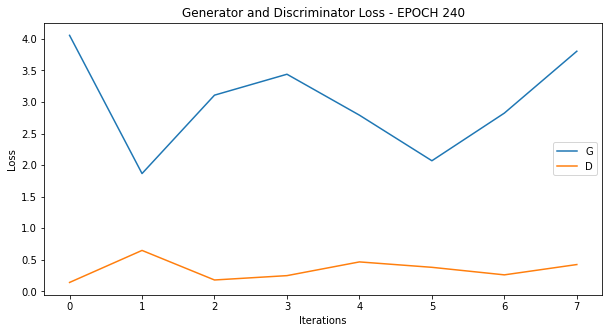

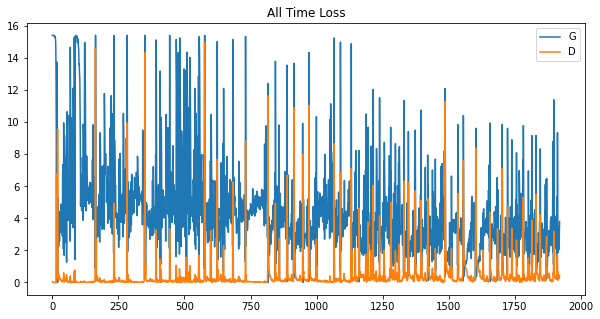

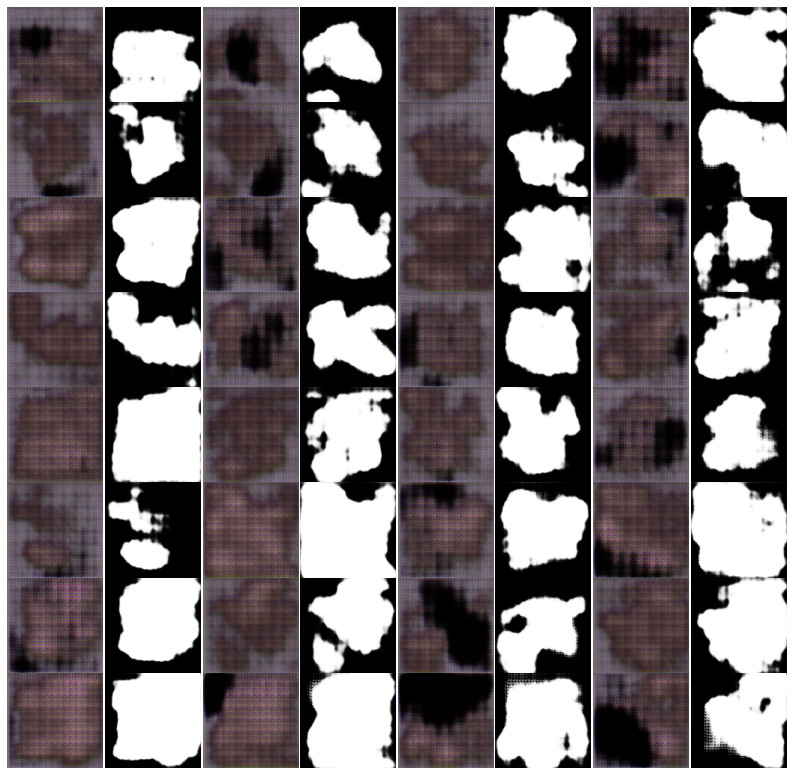





  8%|▊         | 240/3000 [41:23<8:44:32, 11.40s/it]

Epoch: 240 computed for 14.309925556182861 sec
Gen_loss mean:  2.9941254  std:  0.7235976
Disc_loss mean:  0.34444112  std:  0.15782772






  8%|▊         | 241/3000 [41:33<8:31:03, 11.11s/it]

Epoch: 241 computed for 10.427647590637207 sec
Gen_loss mean:  4.072632  std:  2.518817
Disc_loss mean:  1.1710507  std:  2.3168476






  8%|▊         | 242/3000 [41:43<8:17:55, 10.83s/it]

Epoch: 242 computed for 10.158355474472046 sec
Gen_loss mean:  1.6560433  std:  0.41927403
Disc_loss mean:  0.75011235  std:  0.21587805






  8%|▊         | 243/3000 [41:54<8:07:52, 10.62s/it]

Epoch: 243 computed for 10.099390268325806 sec
Gen_loss mean:  2.5779905  std:  1.142577
Disc_loss mean:  0.38836816  std:  0.20935942






  8%|▊         | 244/3000 [42:04<8:00:51, 10.47s/it]

Epoch: 244 computed for 10.106277465820312 sec
Gen_loss mean:  2.7884169  std:  1.6514666
Disc_loss mean:  0.908972  std:  0.845505






  8%|▊         | 245/3000 [42:14<7:56:09, 10.37s/it]

Epoch: 245 computed for 10.126063585281372 sec
Gen_loss mean:  2.7344131  std:  1.0296489
Disc_loss mean:  0.33717883  std:  0.1406231






  8%|▊         | 246/3000 [42:24<7:52:57, 10.30s/it]

Epoch: 246 computed for 10.136425495147705 sec
Gen_loss mean:  3.196373  std:  0.92851007
Disc_loss mean:  0.18696576  std:  0.14507504






  8%|▊         | 247/3000 [42:34<7:50:28, 10.25s/it]

Epoch: 247 computed for 10.121835947036743 sec
Gen_loss mean:  4.6602917  std:  2.8492432
Disc_loss mean:  0.51706535  std:  0.51823217






  8%|▊         | 248/3000 [42:44<7:48:41, 10.22s/it]

Epoch: 248 computed for 10.120209217071533 sec
Gen_loss mean:  3.3936124  std:  1.2907498
Disc_loss mean:  0.4557765  std:  0.3613135






  8%|▊         | 249/3000 [42:54<7:47:08, 10.19s/it]

Epoch: 249 computed for 10.104840278625488 sec
Gen_loss mean:  1.9782915  std:  1.6954278
Disc_loss mean:  2.1536179  std:  2.406572
Saved temporary images for evaluation.
Removed temporary image directory.






  8%|▊         | 250/3000 [43:10<8:57:29, 11.73s/it]

Epoch: 250 computed for 15.259724855422974 sec
Gen_loss mean:  2.4135237  std:  0.18133631
Disc_loss mean:  0.23041525  std:  0.067518815






  8%|▊         | 251/3000 [43:20<8:37:40, 11.30s/it]

Epoch: 251 computed for 10.278528928756714 sec
Gen_loss mean:  2.2621331  std:  0.64786935
Disc_loss mean:  0.40497476  std:  0.23776014






  8%|▊         | 252/3000 [43:30<8:23:18, 10.99s/it]

Epoch: 252 computed for 10.247152328491211 sec
Gen_loss mean:  3.7162752  std:  0.7819631
Disc_loss mean:  0.13862026  std:  0.05938155






  8%|▊         | 253/3000 [43:40<8:11:09, 10.73s/it]

Epoch: 253 computed for 10.093388557434082 sec
Gen_loss mean:  3.2218142  std:  2.6596997
Disc_loss mean:  1.0636264  std:  1.2281088






  8%|▊         | 254/3000 [43:50<8:02:45, 10.55s/it]

Epoch: 254 computed for 10.111876964569092 sec
Gen_loss mean:  2.4413085  std:  0.4480168
Disc_loss mean:  0.33422518  std:  0.086646065






  8%|▊         | 255/3000 [44:01<7:56:34, 10.42s/it]

Epoch: 255 computed for 10.095806121826172 sec
Gen_loss mean:  2.8370557  std:  0.91816425
Disc_loss mean:  0.37409627  std:  0.21327873






  9%|▊         | 256/3000 [44:11<7:52:31, 10.33s/it]

Epoch: 256 computed for 10.119583368301392 sec
Gen_loss mean:  3.8462434  std:  1.3253914
Disc_loss mean:  0.20084655  std:  0.09520155






  9%|▊         | 257/3000 [44:21<7:49:53, 10.28s/it]

Epoch: 257 computed for 10.138871908187866 sec
Gen_loss mean:  3.9513798  std:  1.3531494
Disc_loss mean:  0.16266058  std:  0.06957754






  9%|▊         | 258/3000 [44:31<7:48:07, 10.24s/it]

Epoch: 258 computed for 10.147367715835571 sec
Gen_loss mean:  3.151475  std:  3.3451157
Disc_loss mean:  2.2922854  std:  2.0913115






  9%|▊         | 259/3000 [44:41<7:45:24, 10.19s/it]

Epoch: 259 computed for 10.044599056243896 sec
Gen_loss mean:  1.9979455  std:  0.30894256
Disc_loss mean:  0.46481842  std:  0.11652767






  9%|▊         | 260/3000 [44:51<7:43:12, 10.14s/it]

Epoch: 260 computed for 10.025476932525635 sec
Gen_loss mean:  2.530219  std:  0.37189022
Disc_loss mean:  0.24506465  std:  0.04270976






  9%|▊         | 261/3000 [45:01<7:43:36, 10.16s/it]

Epoch: 261 computed for 10.167515993118286 sec
Gen_loss mean:  3.3062727  std:  1.8796924
Disc_loss mean:  1.0555692  std:  1.9139707






  9%|▊         | 262/3000 [45:11<7:42:47, 10.14s/it]

Epoch: 262 computed for 10.09360122680664 sec
Gen_loss mean:  2.0289183  std:  0.5813027
Disc_loss mean:  0.33534852  std:  0.15903248






  9%|▉         | 263/3000 [45:22<7:42:40, 10.14s/it]

Epoch: 263 computed for 10.130314111709595 sec
Gen_loss mean:  2.7975266  std:  1.2349361
Disc_loss mean:  0.3918198  std:  0.2733138






  9%|▉         | 264/3000 [45:32<7:41:57, 10.13s/it]

Epoch: 264 computed for 10.086122751235962 sec
Gen_loss mean:  2.7718546  std:  0.90178275
Disc_loss mean:  0.25761816  std:  0.10026372






  9%|▉         | 265/3000 [45:42<7:42:36, 10.15s/it]

Epoch: 265 computed for 10.172095775604248 sec
Gen_loss mean:  3.751562  std:  1.1339065
Disc_loss mean:  0.1566642  std:  0.0944398






  9%|▉         | 266/3000 [45:52<7:41:51, 10.14s/it]

Epoch: 266 computed for 10.091408014297485 sec
Gen_loss mean:  3.753293  std:  2.623146
Disc_loss mean:  1.9022123  std:  1.7051924






  9%|▉         | 267/3000 [46:02<7:42:10, 10.15s/it]

Epoch: 267 computed for 10.158744812011719 sec
Gen_loss mean:  1.6713138  std:  0.38053602
Disc_loss mean:  0.5987255  std:  0.21882181






  9%|▉         | 268/3000 [46:12<7:41:17, 10.13s/it]

Epoch: 268 computed for 10.075683832168579 sec
Gen_loss mean:  2.1140306  std:  0.34558916
Disc_loss mean:  0.4191323  std:  0.097228706






  9%|▉         | 269/3000 [46:22<7:41:10, 10.13s/it]

Epoch: 269 computed for 10.118261337280273 sec
Gen_loss mean:  2.721511  std:  1.8508004
Disc_loss mean:  1.1987712  std:  1.8227671






  9%|▉         | 270/3000 [46:32<7:40:24, 10.12s/it]

Epoch: 270 computed for 10.065719366073608 sec
Gen_loss mean:  1.7264758  std:  0.45671564
Disc_loss mean:  0.6298597  std:  0.19143246






  9%|▉         | 271/3000 [46:43<7:39:53, 10.11s/it]

Epoch: 271 computed for 10.073926210403442 sec
Gen_loss mean:  2.4175  std:  0.3722048
Disc_loss mean:  0.3336987  std:  0.07962581






  9%|▉         | 272/3000 [46:53<7:41:27, 10.15s/it]

Epoch: 272 computed for 10.223386526107788 sec
Gen_loss mean:  3.6149745  std:  2.2281532
Disc_loss mean:  0.25276136  std:  0.18754235






  9%|▉         | 273/3000 [47:03<7:41:57, 10.16s/it]

Epoch: 273 computed for 10.184016942977905 sec
Gen_loss mean:  3.245472  std:  2.5134234
Disc_loss mean:  0.9502219  std:  1.0622693






  9%|▉         | 274/3000 [47:13<7:40:46, 10.14s/it]

Epoch: 274 computed for 10.074759483337402 sec
Gen_loss mean:  3.3707626  std:  0.48320115
Disc_loss mean:  0.15105703  std:  0.07382827






  9%|▉         | 275/3000 [47:23<7:39:46, 10.12s/it]

Epoch: 275 computed for 10.063050985336304 sec
Gen_loss mean:  2.7158484  std:  1.5420823
Disc_loss mean:  0.46404535  std:  0.31747276






  9%|▉         | 276/3000 [47:33<7:39:53, 10.13s/it]

Epoch: 276 computed for 10.131250143051147 sec
Gen_loss mean:  2.9612608  std:  1.8283371
Disc_loss mean:  0.8502666  std:  0.74605906






  9%|▉         | 277/3000 [47:43<7:38:45, 10.11s/it]

Epoch: 277 computed for 10.045719861984253 sec
Gen_loss mean:  3.3562248  std:  1.2253611
Disc_loss mean:  0.27297312  std:  0.2188288






  9%|▉         | 278/3000 [47:54<7:39:39, 10.13s/it]

Epoch: 278 computed for 10.169418334960938 sec
Gen_loss mean:  4.65273  std:  1.9087226
Disc_loss mean:  0.18675762  std:  0.122380726






  9%|▉         | 279/3000 [48:04<7:38:44, 10.12s/it]

Epoch: 279 computed for 10.059287786483765 sec
Gen_loss mean:  4.755915  std:  3.0189981
Disc_loss mean:  2.3835592  std:  3.3845267


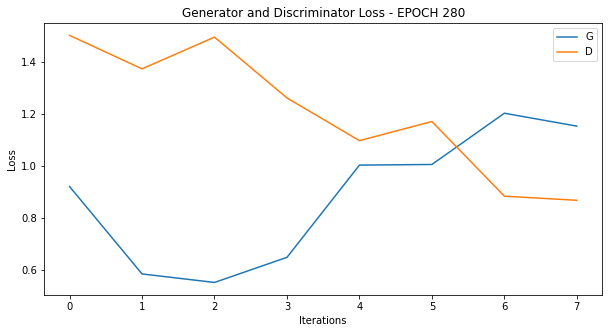

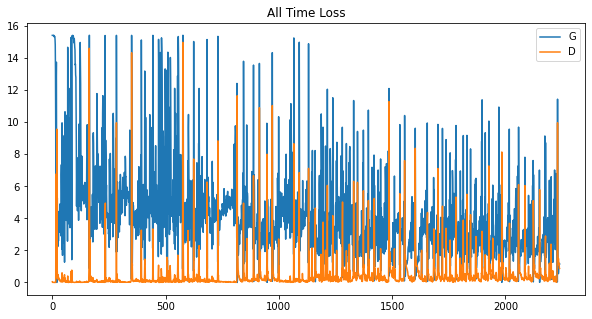

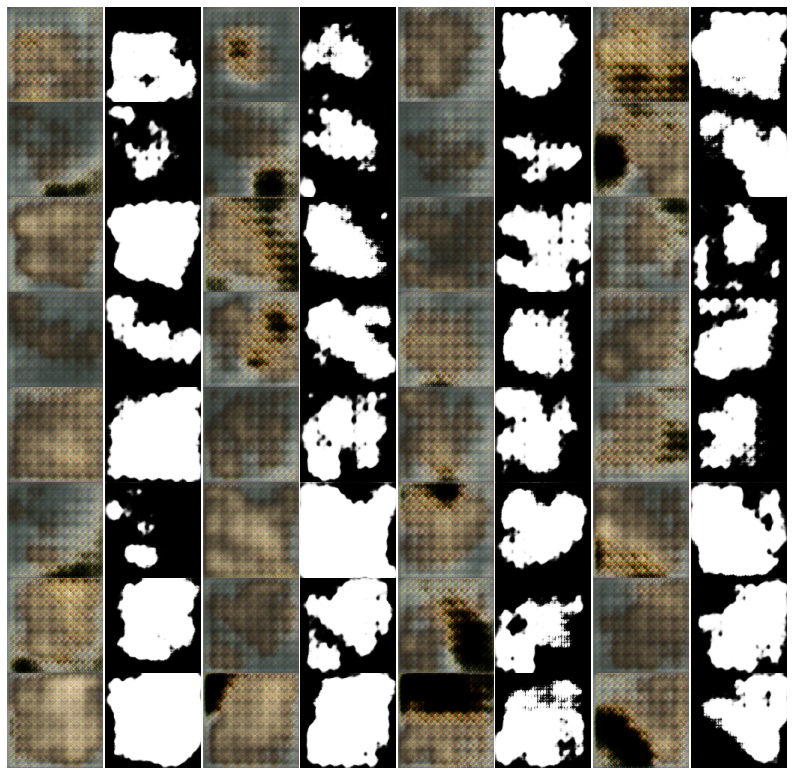





  9%|▉         | 280/3000 [48:18<8:38:10, 11.43s/it]

Epoch: 280 computed for 14.464745044708252 sec
Gen_loss mean:  0.8826324  std:  0.24010958
Disc_loss mean:  1.2058847  std:  0.23324597






  9%|▉         | 281/3000 [48:28<8:23:14, 11.11s/it]

Epoch: 281 computed for 10.333906173706055 sec
Gen_loss mean:  1.6038259  std:  0.42048475
Disc_loss mean:  0.5690002  std:  0.16216038






  9%|▉         | 282/3000 [48:39<8:12:13, 10.87s/it]

Epoch: 282 computed for 10.294439315795898 sec
Gen_loss mean:  2.2429938  std:  0.82348996
Disc_loss mean:  0.43011108  std:  0.13797991






  9%|▉         | 283/3000 [48:49<8:02:06, 10.65s/it]

Epoch: 283 computed for 10.116751432418823 sec
Gen_loss mean:  2.2441373  std:  0.9427556
Disc_loss mean:  0.46406877  std:  0.2978362






  9%|▉         | 284/3000 [48:59<7:54:35, 10.48s/it]

Epoch: 284 computed for 10.092489957809448 sec
Gen_loss mean:  2.8226662  std:  0.582574
Disc_loss mean:  0.27039945  std:  0.1711265






 10%|▉         | 285/3000 [49:09<7:50:11, 10.39s/it]

Epoch: 285 computed for 10.159662246704102 sec
Gen_loss mean:  2.03828  std:  1.4480436
Disc_loss mean:  0.91998  std:  0.83072823






 10%|▉         | 286/3000 [49:19<7:46:35, 10.32s/it]

Epoch: 286 computed for 10.1157968044281 sec
Gen_loss mean:  2.7926738  std:  0.6340887
Disc_loss mean:  0.20504466  std:  0.06065948






 10%|▉         | 287/3000 [49:29<7:44:12, 10.27s/it]

Epoch: 287 computed for 10.13399052619934 sec
Gen_loss mean:  2.3390002  std:  1.7960038
Disc_loss mean:  1.4334049  std:  1.108239






 10%|▉         | 288/3000 [49:40<7:41:28, 10.21s/it]

Epoch: 288 computed for 10.05709981918335 sec
Gen_loss mean:  2.3398495  std:  0.6795755
Disc_loss mean:  0.41813296  std:  0.14154135






 10%|▉         | 289/3000 [49:50<7:40:49, 10.20s/it]

Epoch: 289 computed for 10.159357786178589 sec
Gen_loss mean:  3.3508003  std:  0.87887675
Disc_loss mean:  0.16421893  std:  0.063598394






 10%|▉         | 290/3000 [50:00<7:38:55, 10.16s/it]

Epoch: 290 computed for 10.058881521224976 sec
Gen_loss mean:  3.7328045  std:  3.0907466
Disc_loss mean:  1.0225534  std:  0.96268874






 10%|▉         | 291/3000 [50:10<7:37:26, 10.13s/it]

Epoch: 291 computed for 10.047502279281616 sec
Gen_loss mean:  2.9025908  std:  0.7392302
Disc_loss mean:  0.30152512  std:  0.17979158






 10%|▉         | 292/3000 [50:20<7:37:43, 10.14s/it]

Epoch: 292 computed for 10.151175737380981 sec
Gen_loss mean:  4.196695  std:  1.250648
Disc_loss mean:  0.10569699  std:  0.06905004






 10%|▉         | 293/3000 [50:30<7:37:15, 10.14s/it]

Epoch: 293 computed for 10.104566097259521 sec
Gen_loss mean:  4.10839  std:  1.1131681
Disc_loss mean:  0.106678106  std:  0.050874513






 10%|▉         | 294/3000 [50:40<7:37:13, 10.14s/it]

Epoch: 294 computed for 10.13133692741394 sec
Gen_loss mean:  3.895934  std:  1.8485156
Disc_loss mean:  1.1676999  std:  2.0668502






 10%|▉         | 295/3000 [50:50<7:36:09, 10.12s/it]

Epoch: 295 computed for 10.052846431732178 sec
Gen_loss mean:  2.8598795  std:  0.3978754
Disc_loss mean:  0.16707179  std:  0.08382871






 10%|▉         | 296/3000 [51:01<7:36:32, 10.13s/it]

Epoch: 296 computed for 10.144133567810059 sec
Gen_loss mean:  3.1675768  std:  0.9153382
Disc_loss mean:  0.15891583  std:  0.032917548






 10%|▉         | 297/3000 [51:11<7:35:56, 10.12s/it]

Epoch: 297 computed for 10.083030462265015 sec
Gen_loss mean:  3.7031608  std:  3.1067898
Disc_loss mean:  1.3644806  std:  2.1193109






 10%|▉         | 298/3000 [51:21<7:35:15, 10.11s/it]

Epoch: 298 computed for 10.06792426109314 sec
Gen_loss mean:  2.9276056  std:  0.2971794
Disc_loss mean:  0.14986  std:  0.05468004






 10%|▉         | 299/3000 [51:31<7:35:34, 10.12s/it]

Epoch: 299 computed for 10.13089632987976 sec
Gen_loss mean:  3.915989  std:  2.2772748
Disc_loss mean:  1.0149467  std:  2.154264
Saved temporary images for evaluation.
Removed temporary image directory.






 10%|█         | 300/3000 [51:46<8:45:15, 11.67s/it]

Epoch: 300 computed for 15.262744188308716 sec
Gen_loss mean:  2.4496024  std:  0.5097982
Disc_loss mean:  0.2336107  std:  0.1540424






 10%|█         | 301/3000 [51:56<8:26:44, 11.27s/it]

Epoch: 301 computed for 10.289045572280884 sec
Gen_loss mean:  3.3143215  std:  0.40582833
Disc_loss mean:  0.09036009  std:  0.02522133






 10%|█         | 302/3000 [52:07<8:10:21, 10.90s/it]

Epoch: 302 computed for 10.050977230072021 sec
Gen_loss mean:  3.8669384  std:  1.0819107
Disc_loss mean:  0.111741416  std:  0.07511785






 10%|█         | 303/3000 [52:17<8:00:35, 10.69s/it]

Epoch: 303 computed for 10.181006908416748 sec
Gen_loss mean:  4.684473  std:  0.7665426
Disc_loss mean:  0.02857732  std:  0.014556554






 10%|█         | 304/3000 [52:27<7:52:48, 10.52s/it]

Epoch: 304 computed for 10.115345239639282 sec
Gen_loss mean:  5.353941  std:  1.363459
Disc_loss mean:  0.035749715  std:  0.027090628






 10%|█         | 305/3000 [52:37<7:48:02, 10.42s/it]

Epoch: 305 computed for 10.165831804275513 sec
Gen_loss mean:  5.496928  std:  2.5597327
Disc_loss mean:  0.4192143  std:  0.52211374






 10%|█         | 306/3000 [52:47<7:43:22, 10.32s/it]

Epoch: 306 computed for 10.071442365646362 sec
Gen_loss mean:  4.2745295  std:  0.9678936
Disc_loss mean:  0.060193956  std:  0.024815386






 10%|█         | 307/3000 [52:57<7:41:32, 10.28s/it]

Epoch: 307 computed for 10.18009090423584 sec
Gen_loss mean:  4.796529  std:  1.2452883
Disc_loss mean:  0.039234232  std:  0.030073669






 10%|█         | 308/3000 [53:07<7:38:30, 10.22s/it]

Epoch: 308 computed for 10.054174423217773 sec
Gen_loss mean:  3.3071342  std:  2.773135
Disc_loss mean:  1.198025  std:  2.2571359






 10%|█         | 309/3000 [53:18<7:37:28, 10.20s/it]

Epoch: 309 computed for 10.135234832763672 sec
Gen_loss mean:  3.2543416  std:  0.42651555
Disc_loss mean:  0.09860192  std:  0.047871854






 10%|█         | 310/3000 [53:28<7:36:18, 10.18s/it]

Epoch: 310 computed for 10.111512660980225 sec
Gen_loss mean:  3.5247672  std:  1.0912731
Disc_loss mean:  0.176958  std:  0.100023344






 10%|█         | 311/3000 [53:38<7:36:23, 10.18s/it]

Epoch: 311 computed for 10.182543992996216 sec
Gen_loss mean:  4.213664  std:  4.0386825
Disc_loss mean:  2.0025315  std:  2.4675033






 10%|█         | 312/3000 [53:48<7:37:37, 10.21s/it]

Epoch: 312 computed for 10.274402379989624 sec
Gen_loss mean:  2.8023787  std:  0.58737546
Disc_loss mean:  0.24181995  std:  0.066293664






 10%|█         | 313/3000 [53:58<7:36:01, 10.18s/it]

Epoch: 313 computed for 10.093373537063599 sec
Gen_loss mean:  3.1369538  std:  1.0898718
Disc_loss mean:  0.31131652  std:  0.10974275






 10%|█         | 314/3000 [54:08<7:35:21, 10.17s/it]

Epoch: 314 computed for 10.132728576660156 sec
Gen_loss mean:  3.660752  std:  2.0888622
Disc_loss mean:  0.38949618  std:  0.32531455






 10%|█         | 315/3000 [54:18<7:33:36, 10.14s/it]

Epoch: 315 computed for 10.037472486495972 sec
Gen_loss mean:  4.20531  std:  1.2732111
Disc_loss mean:  0.13414785  std:  0.08614982






 11%|█         | 316/3000 [54:29<7:33:07, 10.13s/it]

Epoch: 316 computed for 10.097780466079712 sec
Gen_loss mean:  3.5686245  std:  2.8192556
Disc_loss mean:  1.0031946  std:  1.2249402






 11%|█         | 317/3000 [54:39<7:32:56, 10.13s/it]

Epoch: 317 computed for 10.113384008407593 sec
Gen_loss mean:  2.7613223  std:  0.81351686
Disc_loss mean:  0.32958108  std:  0.1384169






 11%|█         | 318/3000 [54:49<7:32:03, 10.11s/it]

Epoch: 318 computed for 10.057530879974365 sec
Gen_loss mean:  3.5473568  std:  2.0209842
Disc_loss mean:  0.46765983  std:  0.34773505






 11%|█         | 319/3000 [54:59<7:30:33, 10.08s/it]

Epoch: 319 computed for 10.000860929489136 sec
Gen_loss mean:  3.1005826  std:  1.0888089
Disc_loss mean:  0.27445602  std:  0.23730841


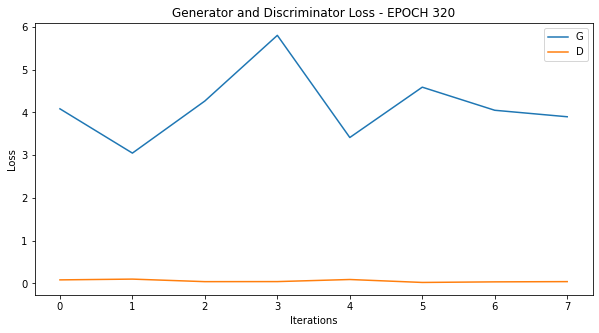

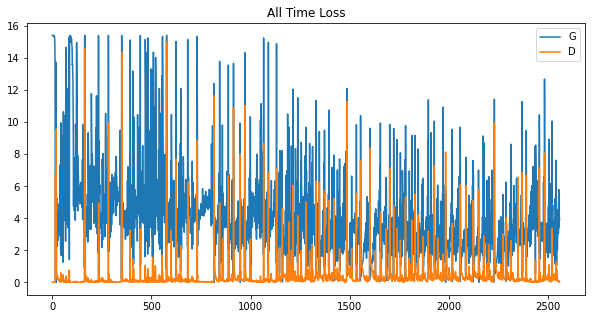

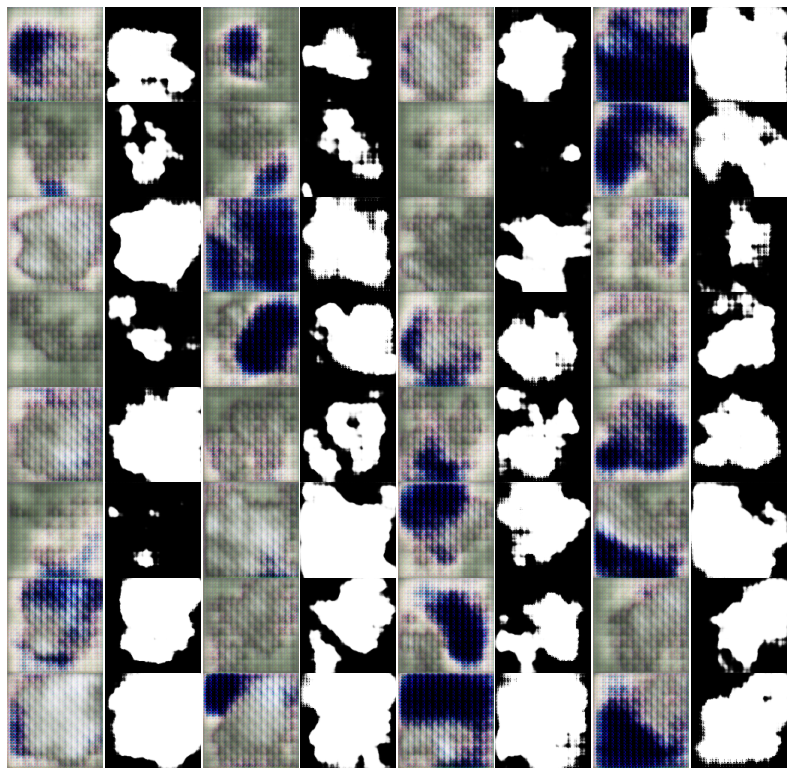





 11%|█         | 320/3000 [55:13<8:26:03, 11.33s/it]

Epoch: 320 computed for 14.212448835372925 sec
Gen_loss mean:  4.1420527  std:  0.77190906
Disc_loss mean:  0.058057  std:  0.02743659






 11%|█         | 321/3000 [55:23<8:13:48, 11.06s/it]

Epoch: 321 computed for 10.406462669372559 sec
Gen_loss mean:  4.6156015  std:  2.843543
Disc_loss mean:  1.3820937  std:  2.2968454






 11%|█         | 322/3000 [55:34<8:01:01, 10.78s/it]

Epoch: 322 computed for 10.101123094558716 sec
Gen_loss mean:  2.414007  std:  0.54342335
Disc_loss mean:  0.28456587  std:  0.13796474






 11%|█         | 323/3000 [55:44<7:51:35, 10.57s/it]

Epoch: 323 computed for 10.071701049804688 sec
Gen_loss mean:  2.723631  std:  0.31315807
Disc_loss mean:  0.17287566  std:  0.047901317






 11%|█         | 324/3000 [55:54<7:46:11, 10.45s/it]

Epoch: 324 computed for 10.165233373641968 sec
Gen_loss mean:  3.248409  std:  0.9548124
Disc_loss mean:  0.16720805  std:  0.09212602






 11%|█         | 325/3000 [56:04<7:41:09, 10.34s/it]

Epoch: 325 computed for 10.07356882095337 sec
Gen_loss mean:  4.702536  std:  3.2141187
Disc_loss mean:  1.5803741  std:  1.6755584






 11%|█         | 326/3000 [56:14<7:38:45, 10.29s/it]

Epoch: 326 computed for 10.16129994392395 sec
Gen_loss mean:  2.2048814  std:  0.5791879
Disc_loss mean:  0.5353943  std:  0.3001156






 11%|█         | 327/3000 [56:24<7:36:04, 10.24s/it]

Epoch: 327 computed for 10.088537693023682 sec
Gen_loss mean:  2.9153464  std:  1.891807
Disc_loss mean:  0.81693166  std:  0.72809404






 11%|█         | 328/3000 [56:34<7:35:01, 10.22s/it]

Epoch: 328 computed for 10.152655124664307 sec
Gen_loss mean:  2.2372224  std:  0.5038204
Disc_loss mean:  0.34200397  std:  0.096479274






 11%|█         | 329/3000 [56:44<7:33:00, 10.18s/it]

Epoch: 329 computed for 10.06483793258667 sec
Gen_loss mean:  3.0716238  std:  2.3356407
Disc_loss mean:  0.79940104  std:  1.0064138






 11%|█         | 330/3000 [56:55<7:32:19, 10.16s/it]

Epoch: 330 computed for 10.122557878494263 sec
Gen_loss mean:  2.1760924  std:  0.6204049
Disc_loss mean:  0.38361064  std:  0.13664098






 11%|█         | 331/3000 [57:05<7:33:08, 10.19s/it]

Epoch: 331 computed for 10.223404169082642 sec
Gen_loss mean:  3.17961  std:  1.0759956
Disc_loss mean:  0.21883789  std:  0.067476146






 11%|█         | 332/3000 [57:15<7:32:30, 10.18s/it]

Epoch: 332 computed for 10.13489055633545 sec
Gen_loss mean:  4.5561204  std:  1.4387834
Disc_loss mean:  0.089707926  std:  0.055194948






 11%|█         | 333/3000 [57:25<7:32:46, 10.19s/it]

Epoch: 333 computed for 10.194403648376465 sec
Gen_loss mean:  4.5453706  std:  1.8461637
Disc_loss mean:  0.1400254  std:  0.07630274






 11%|█         | 334/3000 [57:35<7:33:11, 10.20s/it]

Epoch: 334 computed for 10.207774639129639 sec
Gen_loss mean:  4.408866  std:  4.602407
Disc_loss mean:  1.788842  std:  2.761637






 11%|█         | 335/3000 [57:46<7:31:26, 10.16s/it]

Epoch: 335 computed for 10.062421083450317 sec
Gen_loss mean:  1.9290619  std:  0.42048895
Disc_loss mean:  0.5029743  std:  0.12905303






 11%|█         | 336/3000 [57:56<7:30:46, 10.15s/it]

Epoch: 336 computed for 10.108493089675903 sec
Gen_loss mean:  2.6680517  std:  0.8750312
Disc_loss mean:  0.3081084  std:  0.10970763






 11%|█         | 337/3000 [58:06<7:30:44, 10.16s/it]

Epoch: 337 computed for 10.146772623062134 sec
Gen_loss mean:  3.1897547  std:  2.3601816
Disc_loss mean:  1.0422267  std:  0.8411569






 11%|█▏        | 338/3000 [58:16<7:29:40, 10.14s/it]

Epoch: 338 computed for 10.075077056884766 sec
Gen_loss mean:  2.7889569  std:  0.70862657
Disc_loss mean:  0.24374059  std:  0.03383009






 11%|█▏        | 339/3000 [58:26<7:30:07, 10.15s/it]

Epoch: 339 computed for 10.167036294937134 sec
Gen_loss mean:  3.6285167  std:  2.8859537
Disc_loss mean:  0.83738506  std:  1.149486






 11%|█▏        | 340/3000 [58:36<7:29:04, 10.13s/it]

Epoch: 340 computed for 10.064979076385498 sec
Gen_loss mean:  2.5246382  std:  1.0066026
Disc_loss mean:  0.52799594  std:  0.18714646






 11%|█▏        | 341/3000 [58:46<7:29:03, 10.13s/it]

Epoch: 341 computed for 10.127221584320068 sec
Gen_loss mean:  3.683449  std:  1.5400572
Disc_loss mean:  0.4901464  std:  0.5071165






 11%|█▏        | 342/3000 [58:57<7:31:01, 10.18s/it]

Epoch: 342 computed for 10.278061151504517 sec
Gen_loss mean:  3.6750674  std:  2.3340173
Disc_loss mean:  1.1205882  std:  1.1600512






 11%|█▏        | 343/3000 [59:07<7:30:01, 10.16s/it]

Epoch: 343 computed for 10.102516889572144 sec
Gen_loss mean:  2.5759826  std:  0.4996188
Disc_loss mean:  0.21265736  std:  0.09515721






 11%|█▏        | 344/3000 [59:17<7:30:15, 10.17s/it]

Epoch: 344 computed for 10.179322719573975 sec
Gen_loss mean:  2.5310206  std:  1.4092461
Disc_loss mean:  0.58532405  std:  0.4151213






 12%|█▏        | 345/3000 [59:27<7:28:42, 10.14s/it]

Epoch: 345 computed for 10.042038917541504 sec
Gen_loss mean:  3.2370286  std:  0.8932527
Disc_loss mean:  0.18236893  std:  0.11267359






 12%|█▏        | 346/3000 [59:37<7:28:32, 10.14s/it]

Epoch: 346 computed for 10.126593828201294 sec
Gen_loss mean:  3.7118988  std:  1.0659691
Disc_loss mean:  0.13448265  std:  0.07793427






 12%|█▏        | 347/3000 [59:47<7:28:18, 10.14s/it]

Epoch: 347 computed for 10.11533260345459 sec
Gen_loss mean:  4.551688  std:  1.8574231
Disc_loss mean:  0.24068764  std:  0.30179337






 12%|█▏        | 348/3000 [59:57<7:28:10, 10.14s/it]

Epoch: 348 computed for 10.126939535140991 sec
Gen_loss mean:  2.646297  std:  2.8260043
Disc_loss mean:  2.3019478  std:  2.023062






 12%|█▏        | 349/3000 [1:00:07<7:27:37, 10.13s/it]

Epoch: 349 computed for 10.096001863479614 sec
Gen_loss mean:  1.997601  std:  0.25981623
Disc_loss mean:  0.38042292  std:  0.031044547
Saved temporary images for evaluation.
Removed temporary image directory.






 12%|█▏        | 350/3000 [1:00:23<8:35:16, 11.67s/it]

Epoch: 350 computed for 15.214489459991455 sec
Gen_loss mean:  3.1463742  std:  1.7910438
Disc_loss mean:  1.1300657  std:  1.1099247






 12%|█▏        | 351/3000 [1:00:33<8:15:43, 11.23s/it]

Epoch: 351 computed for 10.180853843688965 sec
Gen_loss mean:  1.8566091  std:  0.57545334
Disc_loss mean:  0.51565826  std:  0.18603173






 12%|█▏        | 352/3000 [1:00:43<8:00:25, 10.89s/it]

Epoch: 352 computed for 10.072680950164795 sec
Gen_loss mean:  2.7164123  std:  1.5640246
Disc_loss mean:  0.6000538  std:  0.40767962






 12%|█▏        | 353/3000 [1:00:53<7:50:17, 10.66s/it]

Epoch: 353 computed for 10.119296789169312 sec
Gen_loss mean:  3.270653  std:  0.9736477
Disc_loss mean:  0.16134773  std:  0.061507966






 12%|█▏        | 354/3000 [1:01:03<7:43:21, 10.51s/it]

Epoch: 354 computed for 10.128952503204346 sec
Gen_loss mean:  3.6949015  std:  3.04326
Disc_loss mean:  0.8788201  std:  1.1631291






 12%|█▏        | 355/3000 [1:01:13<7:37:34, 10.38s/it]

Epoch: 355 computed for 10.071085929870605 sec
Gen_loss mean:  2.2810354  std:  0.50394636
Disc_loss mean:  0.39880043  std:  0.07520935






 12%|█▏        | 356/3000 [1:01:24<7:34:33, 10.32s/it]

Epoch: 356 computed for 10.151042699813843 sec
Gen_loss mean:  3.3092217  std:  1.0791191
Disc_loss mean:  0.20615119  std:  0.15856238






 12%|█▏        | 357/3000 [1:01:34<7:31:47, 10.26s/it]

Epoch: 357 computed for 10.101374387741089 sec
Gen_loss mean:  3.3547924  std:  1.8737507
Disc_loss mean:  0.5907967  std:  0.7223761






 12%|█▏        | 358/3000 [1:01:44<7:30:31, 10.23s/it]

Epoch: 358 computed for 10.152856349945068 sec
Gen_loss mean:  2.5106082  std:  2.1001236
Disc_loss mean:  1.1299502  std:  1.1363544






 12%|█▏        | 359/3000 [1:01:54<7:28:47, 10.20s/it]

Epoch: 359 computed for 10.097149848937988 sec
Gen_loss mean:  2.7918763  std:  0.7756265
Disc_loss mean:  0.30559564  std:  0.17923531


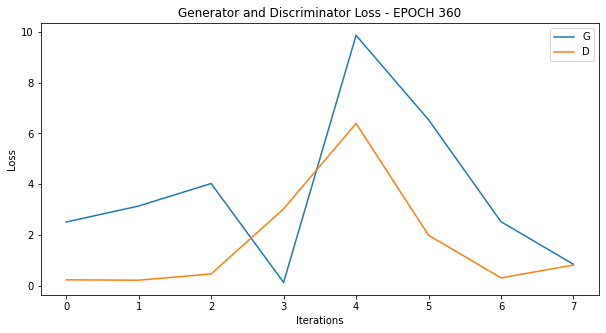

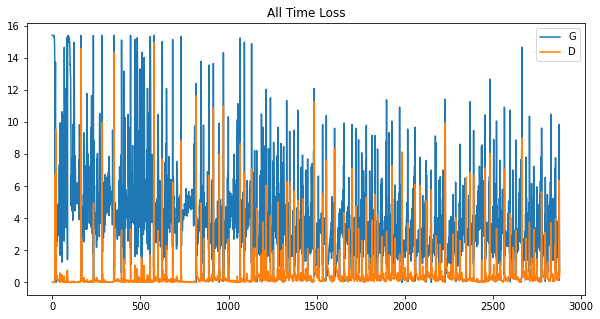

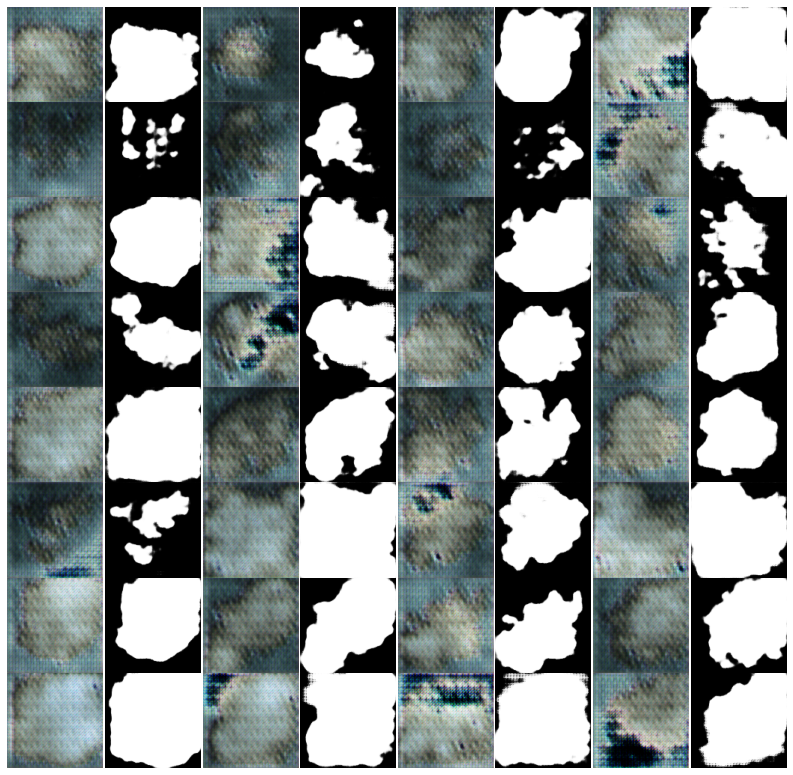





 12%|█▏        | 360/3000 [1:02:08<8:25:47, 11.50s/it]

Epoch: 360 computed for 14.492639541625977 sec
Gen_loss mean:  3.6942422  std:  2.9618642
Disc_loss mean:  1.6787676  std:  2.014785






 12%|█▏        | 361/3000 [1:02:19<8:09:48, 11.14s/it]

Epoch: 361 computed for 10.286121129989624 sec
Gen_loss mean:  2.338761  std:  0.6886675
Disc_loss mean:  0.32399303  std:  0.22837265






 12%|█▏        | 362/3000 [1:02:29<7:56:54, 10.85s/it]

Epoch: 362 computed for 10.155434131622314 sec
Gen_loss mean:  2.4984388  std:  1.1338863
Disc_loss mean:  0.48172602  std:  0.2003271






 12%|█▏        | 363/3000 [1:02:39<7:47:10, 10.63s/it]

Epoch: 363 computed for 10.106736183166504 sec
Gen_loss mean:  2.87808  std:  0.856947
Disc_loss mean:  0.27016175  std:  0.15533286






 12%|█▏        | 364/3000 [1:02:49<7:40:54, 10.49s/it]

Epoch: 364 computed for 10.14758825302124 sec
Gen_loss mean:  3.1725926  std:  1.7324755
Disc_loss mean:  0.59629536  std:  0.4043703






 12%|█▏        | 365/3000 [1:02:59<7:35:10, 10.36s/it]

Epoch: 365 computed for 10.055639505386353 sec
Gen_loss mean:  3.1461902  std:  1.2666194
Disc_loss mean:  0.31379065  std:  0.21719047






 12%|█▏        | 366/3000 [1:03:09<7:32:14, 10.30s/it]

Epoch: 366 computed for 10.136064291000366 sec
Gen_loss mean:  4.0434685  std:  2.2543716
Disc_loss mean:  1.9223726  std:  2.4735448






 12%|█▏        | 367/3000 [1:03:20<7:29:24, 10.24s/it]

Epoch: 367 computed for 10.085445880889893 sec
Gen_loss mean:  1.1926134  std:  0.55137056
Disc_loss mean:  1.1153523  std:  0.29609403






 12%|█▏        | 368/3000 [1:03:30<7:27:32, 10.20s/it]

Epoch: 368 computed for 10.097167491912842 sec
Gen_loss mean:  1.9117143  std:  0.47513556
Disc_loss mean:  0.52646416  std:  0.17298709






 12%|█▏        | 369/3000 [1:03:40<7:26:04, 10.17s/it]

Epoch: 369 computed for 10.086222887039185 sec
Gen_loss mean:  2.6273792  std:  1.475732
Disc_loss mean:  0.5965679  std:  0.37202048






 12%|█▏        | 370/3000 [1:03:50<7:25:55, 10.17s/it]

Epoch: 370 computed for 10.15905237197876 sec
Gen_loss mean:  2.9291906  std:  1.290205
Disc_loss mean:  0.32623756  std:  0.21360925






 12%|█▏        | 371/3000 [1:04:00<7:25:17, 10.16s/it]

Epoch: 371 computed for 10.120132684707642 sec
Gen_loss mean:  3.148503  std:  1.1962888
Disc_loss mean:  0.30530566  std:  0.1948922






 12%|█▏        | 372/3000 [1:04:10<7:27:03, 10.21s/it]

Epoch: 372 computed for 10.289265632629395 sec
Gen_loss mean:  2.9495387  std:  2.680336
Disc_loss mean:  1.4545653  std:  1.0577248






 12%|█▏        | 373/3000 [1:04:21<7:26:37, 10.20s/it]

Epoch: 373 computed for 10.168689727783203 sec
Gen_loss mean:  1.894552  std:  0.23758738
Disc_loss mean:  0.5179628  std:  0.20793617






 12%|█▏        | 374/3000 [1:04:31<7:25:33, 10.18s/it]

Epoch: 374 computed for 10.120227098464966 sec
Gen_loss mean:  2.6567054  std:  1.6807325
Disc_loss mean:  0.8730576  std:  0.9481117






 12%|█▎        | 375/3000 [1:04:41<7:25:07, 10.17s/it]

Epoch: 375 computed for 10.146489143371582 sec
Gen_loss mean:  2.1889086  std:  0.4473604
Disc_loss mean:  0.35200796  std:  0.11988197






 13%|█▎        | 376/3000 [1:04:51<7:23:44, 10.15s/it]

Epoch: 376 computed for 10.06854248046875 sec
Gen_loss mean:  3.2618816  std:  1.6289594
Disc_loss mean:  0.48983043  std:  0.36439657






 13%|█▎        | 377/3000 [1:05:01<7:24:15, 10.16s/it]

Epoch: 377 computed for 10.185352802276611 sec
Gen_loss mean:  3.1027284  std:  1.3663201
Disc_loss mean:  0.27706122  std:  0.223008






 13%|█▎        | 378/3000 [1:05:11<7:23:30, 10.15s/it]

Epoch: 378 computed for 10.094996929168701 sec
Gen_loss mean:  3.3171985  std:  1.2026467
Disc_loss mean:  0.20079589  std:  0.11862831






 13%|█▎        | 379/3000 [1:05:21<7:23:06, 10.14s/it]

Epoch: 379 computed for 10.113192796707153 sec
Gen_loss mean:  3.0111861  std:  2.8529756
Disc_loss mean:  1.7967391  std:  1.5679333






 13%|█▎        | 380/3000 [1:05:32<7:22:28, 10.13s/it]

Epoch: 380 computed for 10.09598159790039 sec
Gen_loss mean:  2.13475  std:  0.6071292
Disc_loss mean:  0.49211788  std:  0.20867679






 13%|█▎        | 381/3000 [1:05:42<7:22:22, 10.13s/it]

Epoch: 381 computed for 10.123621463775635 sec
Gen_loss mean:  2.531743  std:  0.600577
Disc_loss mean:  0.31326976  std:  0.14909862






 13%|█▎        | 382/3000 [1:05:52<7:21:40, 10.12s/it]

Epoch: 382 computed for 10.070377349853516 sec
Gen_loss mean:  3.0921533  std:  2.7517047
Disc_loss mean:  1.5215812  std:  1.432663






 13%|█▎        | 383/3000 [1:06:02<7:20:41, 10.10s/it]

Epoch: 383 computed for 10.044290542602539 sec
Gen_loss mean:  2.248938  std:  0.54641324
Disc_loss mean:  0.45260173  std:  0.19730641






 13%|█▎        | 384/3000 [1:06:12<7:21:23, 10.12s/it]

Epoch: 384 computed for 10.153852224349976 sec
Gen_loss mean:  3.1120737  std:  2.187345
Disc_loss mean:  0.8133117  std:  0.5263136






 13%|█▎        | 385/3000 [1:06:22<7:21:11, 10.12s/it]

Epoch: 385 computed for 10.108646392822266 sec
Gen_loss mean:  3.3547146  std:  1.6200738
Disc_loss mean:  0.3980586  std:  0.25566903






 13%|█▎        | 386/3000 [1:06:32<7:21:28, 10.13s/it]

Epoch: 386 computed for 10.143764734268188 sec
Gen_loss mean:  2.759328  std:  1.6447835
Disc_loss mean:  0.59699744  std:  0.38684642






 13%|█▎        | 387/3000 [1:06:42<7:20:53, 10.12s/it]

Epoch: 387 computed for 10.08780288696289 sec
Gen_loss mean:  2.8729656  std:  0.6866311
Disc_loss mean:  0.24093169  std:  0.11349319






 13%|█▎        | 388/3000 [1:06:52<7:20:29, 10.12s/it]

Epoch: 388 computed for 10.089302062988281 sec
Gen_loss mean:  3.5045853  std:  1.3968539
Disc_loss mean:  0.1662122  std:  0.06638648






 13%|█▎        | 389/3000 [1:07:03<7:20:43, 10.13s/it]

Epoch: 389 computed for 10.136322498321533 sec
Gen_loss mean:  4.75108  std:  2.526155
Disc_loss mean:  0.29860753  std:  0.33196607






 13%|█▎        | 390/3000 [1:07:13<7:20:54, 10.14s/it]

Epoch: 390 computed for 10.14122200012207 sec
Gen_loss mean:  4.3311453  std:  1.9921697
Disc_loss mean:  0.31994155  std:  0.23845865






 13%|█▎        | 391/3000 [1:07:23<7:20:44, 10.14s/it]

Epoch: 391 computed for 10.124932289123535 sec
Gen_loss mean:  5.402235  std:  3.8278353
Disc_loss mean:  0.9620482  std:  0.87555045






 13%|█▎        | 392/3000 [1:07:33<7:19:46, 10.12s/it]

Epoch: 392 computed for 10.05955171585083 sec
Gen_loss mean:  2.6365566  std:  0.7097926
Disc_loss mean:  0.21438682  std:  0.14045902






 13%|█▎        | 393/3000 [1:07:43<7:19:57, 10.13s/it]

Epoch: 393 computed for 10.129406690597534 sec
Gen_loss mean:  3.7415488  std:  2.4940066
Disc_loss mean:  0.76031864  std:  0.75790817






 13%|█▎        | 394/3000 [1:07:53<7:19:11, 10.11s/it]

Epoch: 394 computed for 10.066492319107056 sec
Gen_loss mean:  2.7809765  std:  1.506745
Disc_loss mean:  0.56983525  std:  0.72073585






 13%|█▎        | 395/3000 [1:08:03<7:19:47, 10.13s/it]

Epoch: 395 computed for 10.151490688323975 sec
Gen_loss mean:  3.1311464  std:  2.29066
Disc_loss mean:  0.7583062  std:  0.99686843






 13%|█▎        | 396/3000 [1:08:14<7:19:35, 10.13s/it]

Epoch: 396 computed for 10.11387324333191 sec
Gen_loss mean:  2.5151653  std:  0.5449895
Disc_loss mean:  0.30322146  std:  0.07261026






 13%|█▎        | 397/3000 [1:08:24<7:20:27, 10.15s/it]

Epoch: 397 computed for 10.189035415649414 sec
Gen_loss mean:  3.51764  std:  2.34323
Disc_loss mean:  0.74186057  std:  1.0442845






 13%|█▎        | 398/3000 [1:08:34<7:19:27, 10.13s/it]

Epoch: 398 computed for 10.073790788650513 sec
Gen_loss mean:  2.7610154  std:  0.95896196
Disc_loss mean:  0.39002544  std:  0.3469683






 13%|█▎        | 399/3000 [1:08:44<7:19:58, 10.15s/it]

Epoch: 399 computed for 10.166816711425781 sec
Gen_loss mean:  2.9514883  std:  1.1642691
Disc_loss mean:  0.22347562  std:  0.15872133


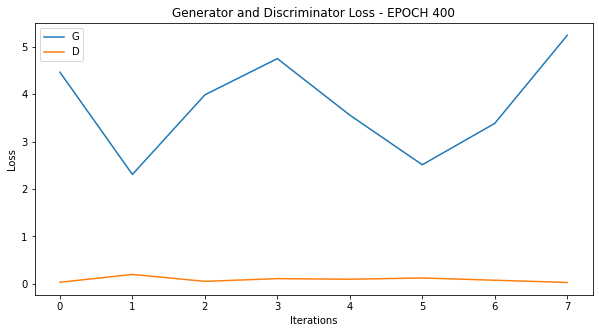

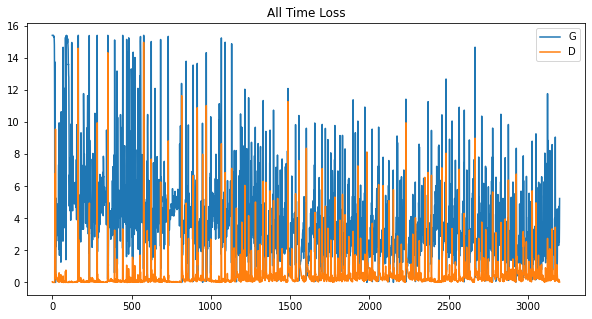

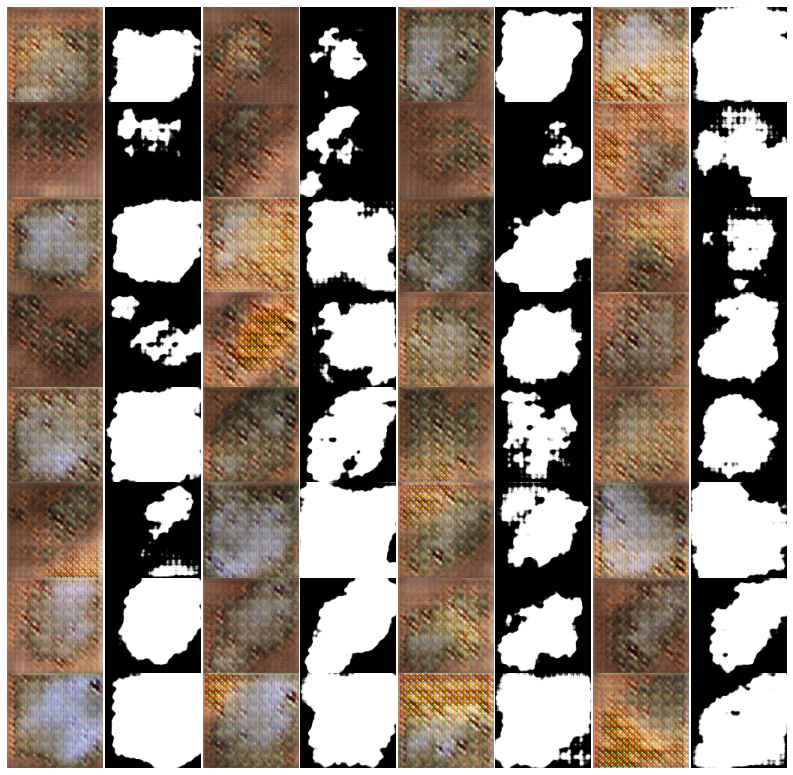

Saved temporary images for evaluation.
Removed temporary image directory.






 13%|█▎        | 400/3000 [1:09:04<9:25:38, 13.05s/it]

Epoch: 400 computed for 19.803833723068237 sec
Gen_loss mean:  3.7750015  std:  0.97265613
Disc_loss mean:  0.090201125  std:  0.052346375






 13%|█▎        | 401/3000 [1:09:14<8:49:48, 12.23s/it]

Epoch: 401 computed for 10.295973062515259 sec
Gen_loss mean:  4.008004  std:  1.256196
Disc_loss mean:  0.110141516  std:  0.088350296






 13%|█▎        | 402/3000 [1:09:24<8:23:44, 11.63s/it]

Epoch: 402 computed for 10.22255277633667 sec
Gen_loss mean:  3.8288853  std:  2.5701315
Disc_loss mean:  1.0187222  std:  1.588509






 13%|█▎        | 403/3000 [1:09:35<8:05:05, 11.21s/it]

Epoch: 403 computed for 10.193608283996582 sec
Gen_loss mean:  3.451355  std:  2.2583606
Disc_loss mean:  0.5854045  std:  0.4618216






 13%|█▎        | 404/3000 [1:09:45<7:50:37, 10.88s/it]

Epoch: 404 computed for 10.091037511825562 sec
Gen_loss mean:  2.074975  std:  1.0702373
Disc_loss mean:  0.708719  std:  0.3054794






 14%|█▎        | 405/3000 [1:09:55<7:41:18, 10.67s/it]

Epoch: 405 computed for 10.157834768295288 sec
Gen_loss mean:  2.986977  std:  1.0698301
Disc_loss mean:  0.26559785  std:  0.19668037






 14%|█▎        | 406/3000 [1:10:05<7:33:33, 10.49s/it]

Epoch: 406 computed for 10.06713056564331 sec
Gen_loss mean:  2.9614615  std:  1.6140304
Disc_loss mean:  0.43823105  std:  0.17462304






 14%|█▎        | 407/3000 [1:10:15<7:28:18, 10.37s/it]

Epoch: 407 computed for 10.083181619644165 sec
Gen_loss mean:  3.9741735  std:  2.2607496
Disc_loss mean:  0.7130388  std:  0.41997284






 14%|█▎        | 408/3000 [1:10:25<7:25:13, 10.31s/it]

Epoch: 408 computed for 10.12952470779419 sec
Gen_loss mean:  2.959714  std:  1.111054
Disc_loss mean:  0.29272717  std:  0.27095315






 14%|█▎        | 409/3000 [1:10:35<7:23:09, 10.26s/it]

Epoch: 409 computed for 10.144909620285034 sec
Gen_loss mean:  3.6358685  std:  1.9392761
Disc_loss mean:  1.0001673  std:  1.3118567






 14%|█▎        | 410/3000 [1:10:45<7:21:17, 10.22s/it]

Epoch: 410 computed for 10.115458250045776 sec
Gen_loss mean:  2.6066904  std:  0.98158365
Disc_loss mean:  0.40829813  std:  0.31264713






 14%|█▎        | 411/3000 [1:10:56<7:19:06, 10.18s/it]

Epoch: 411 computed for 10.05236268043518 sec
Gen_loss mean:  2.7960796  std:  0.6691793
Disc_loss mean:  0.21886075  std:  0.08193987






 14%|█▎        | 412/3000 [1:11:06<7:18:10, 10.16s/it]

Epoch: 412 computed for 10.101867198944092 sec
Gen_loss mean:  4.5097284  std:  2.045002
Disc_loss mean:  0.15500633  std:  0.056956463






 14%|█▍        | 413/3000 [1:11:16<7:17:22, 10.14s/it]

Epoch: 413 computed for 10.092169046401978 sec
Gen_loss mean:  5.022827  std:  3.8028908
Disc_loss mean:  2.3782012  std:  4.0503993






 14%|█▍        | 414/3000 [1:11:26<7:16:19, 10.12s/it]

Epoch: 414 computed for 10.058266639709473 sec
Gen_loss mean:  0.880641  std:  0.31186992
Disc_loss mean:  1.2818513  std:  0.29882544






 14%|█▍        | 415/3000 [1:11:36<7:16:51, 10.14s/it]

Epoch: 415 computed for 10.159389972686768 sec
Gen_loss mean:  1.3356698  std:  0.27406818
Disc_loss mean:  0.7235409  std:  0.12621027






 14%|█▍        | 416/3000 [1:11:46<7:16:08, 10.13s/it]

Epoch: 416 computed for 10.072189569473267 sec
Gen_loss mean:  2.0789523  std:  0.37056747
Disc_loss mean:  0.3316539  std:  0.13119857






 14%|█▍        | 417/3000 [1:11:56<7:16:07, 10.13s/it]

Epoch: 417 computed for 10.125080585479736 sec
Gen_loss mean:  2.4490979  std:  0.34533364
Disc_loss mean:  0.32462966  std:  0.28573707






 14%|█▍        | 418/3000 [1:12:06<7:15:15, 10.11s/it]

Epoch: 418 computed for 10.062792301177979 sec
Gen_loss mean:  2.1138651  std:  0.6398116
Disc_loss mean:  0.59864575  std:  0.4413472






 14%|█▍        | 419/3000 [1:12:17<7:16:54, 10.16s/it]

Epoch: 419 computed for 10.241308689117432 sec
Gen_loss mean:  2.917316  std:  1.6258497
Disc_loss mean:  0.7394841  std:  0.9291246






 14%|█▍        | 420/3000 [1:12:27<7:16:17, 10.15s/it]

Epoch: 420 computed for 10.09923505783081 sec
Gen_loss mean:  2.8991618  std:  0.92815477
Disc_loss mean:  0.24319413  std:  0.10238301






 14%|█▍        | 421/3000 [1:12:37<7:16:13, 10.15s/it]

Epoch: 421 computed for 10.139953374862671 sec
Gen_loss mean:  3.7616425  std:  1.6763519
Disc_loss mean:  0.3760864  std:  0.29191005






 14%|█▍        | 422/3000 [1:12:47<7:16:54, 10.17s/it]

Epoch: 422 computed for 10.201497793197632 sec
Gen_loss mean:  3.0993733  std:  1.5304258
Disc_loss mean:  1.3015254  std:  1.80469






 14%|█▍        | 423/3000 [1:12:57<7:15:30, 10.14s/it]

Epoch: 423 computed for 10.053749084472656 sec
Gen_loss mean:  2.050218  std:  0.73240584
Disc_loss mean:  0.4456206  std:  0.30515844






 14%|█▍        | 424/3000 [1:13:07<7:15:31, 10.14s/it]

Epoch: 424 computed for 10.13590669631958 sec
Gen_loss mean:  2.9616418  std:  1.0457791
Disc_loss mean:  0.2803784  std:  0.12585482






 14%|█▍        | 425/3000 [1:13:17<7:15:03, 10.14s/it]

Epoch: 425 computed for 10.10310959815979 sec
Gen_loss mean:  3.3623648  std:  0.95646447
Disc_loss mean:  0.14879458  std:  0.06418901






 14%|█▍        | 426/3000 [1:13:28<7:14:19, 10.12s/it]

Epoch: 426 computed for 10.07272720336914 sec
Gen_loss mean:  4.046788  std:  3.1176944
Disc_loss mean:  2.3067975  std:  3.395172






 14%|█▍        | 427/3000 [1:13:38<7:14:40, 10.14s/it]

Epoch: 427 computed for 10.145520687103271 sec
Gen_loss mean:  1.073753  std:  0.37010276
Disc_loss mean:  0.9381572  std:  0.27839062






 14%|█▍        | 428/3000 [1:13:48<7:14:20, 10.13s/it]

Epoch: 428 computed for 10.109134435653687 sec
Gen_loss mean:  1.7350562  std:  0.36547288
Disc_loss mean:  0.49527833  std:  0.102921955






 14%|█▍        | 429/3000 [1:13:58<7:14:15, 10.13s/it]

Epoch: 429 computed for 10.123745918273926 sec
Gen_loss mean:  1.9880548  std:  1.3518283
Disc_loss mean:  0.94623744  std:  0.66276675






 14%|█▍        | 430/3000 [1:14:08<7:13:46, 10.13s/it]

Epoch: 430 computed for 10.09162163734436 sec
Gen_loss mean:  2.6678286  std:  1.7508311
Disc_loss mean:  0.6874604  std:  0.65143174






 14%|█▍        | 431/3000 [1:14:18<7:14:39, 10.15s/it]

Epoch: 431 computed for 10.195913314819336 sec
Gen_loss mean:  2.563856  std:  0.8122172
Disc_loss mean:  0.34257865  std:  0.23303317






 14%|█▍        | 432/3000 [1:14:29<7:15:42, 10.18s/it]

Epoch: 432 computed for 10.234548568725586 sec
Gen_loss mean:  3.1591334  std:  1.9111542
Disc_loss mean:  0.784466  std:  0.95366883






 14%|█▍        | 433/3000 [1:14:39<7:14:15, 10.15s/it]

Epoch: 433 computed for 10.061756134033203 sec
Gen_loss mean:  2.3458266  std:  0.74670935
Disc_loss mean:  0.30406266  std:  0.23514168






 14%|█▍        | 434/3000 [1:14:49<7:13:27, 10.14s/it]

Epoch: 434 computed for 10.086271047592163 sec
Gen_loss mean:  3.5337617  std:  1.8073716
Disc_loss mean:  0.37328744  std:  0.18460672






 14%|█▍        | 435/3000 [1:14:59<7:13:18, 10.14s/it]

Epoch: 435 computed for 10.12207317352295 sec
Gen_loss mean:  3.6538746  std:  1.2828948
Disc_loss mean:  0.18076563  std:  0.08938598






 15%|█▍        | 436/3000 [1:15:09<7:12:43, 10.13s/it]

Epoch: 436 computed for 10.090381145477295 sec
Gen_loss mean:  2.6924992  std:  2.6183949
Disc_loss mean:  1.3832014  std:  1.3461422






 15%|█▍        | 437/3000 [1:15:19<7:12:49, 10.13s/it]

Epoch: 437 computed for 10.12466049194336 sec
Gen_loss mean:  2.0965202  std:  0.3506406
Disc_loss mean:  0.33080137  std:  0.06427236






 15%|█▍        | 438/3000 [1:15:29<7:12:29, 10.13s/it]

Epoch: 438 computed for 10.10442852973938 sec
Gen_loss mean:  2.904202  std:  1.8647039
Disc_loss mean:  0.547254  std:  0.53859997






 15%|█▍        | 439/3000 [1:15:39<7:12:37, 10.14s/it]

Epoch: 439 computed for 10.135844230651855 sec
Gen_loss mean:  2.752482  std:  0.73816097
Disc_loss mean:  0.23864911  std:  0.124980405


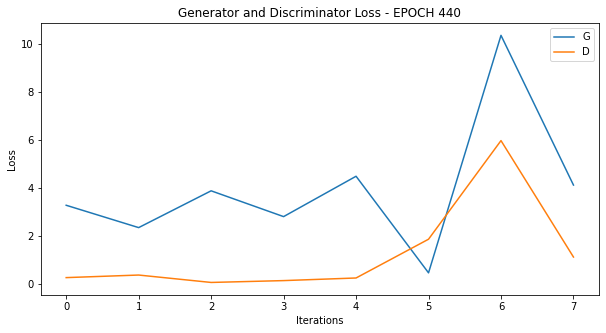

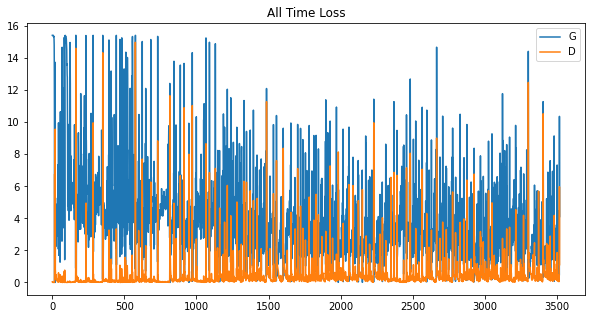

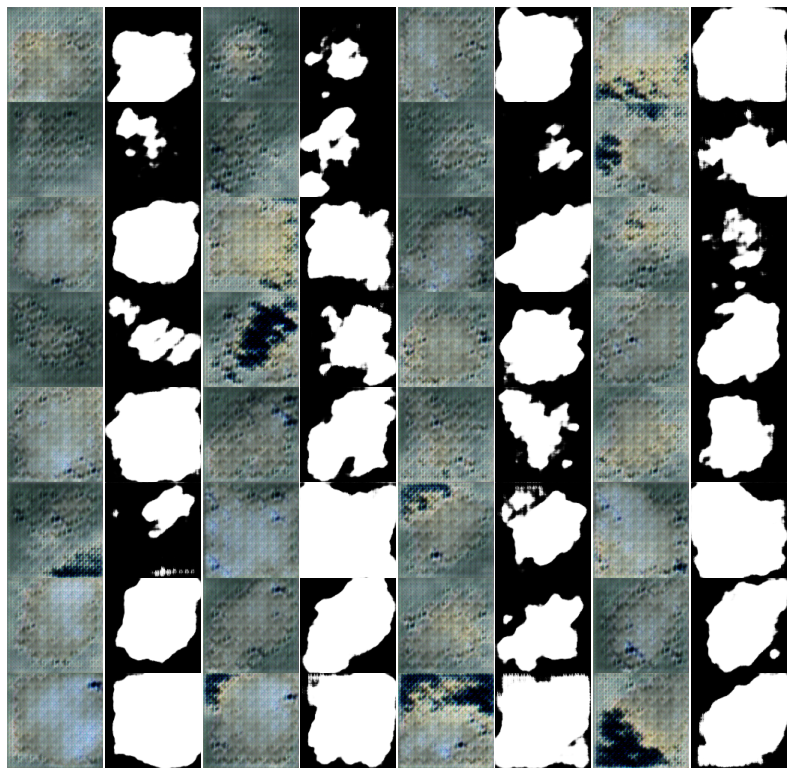





 15%|█▍        | 440/3000 [1:15:54<8:04:54, 11.37s/it]

Epoch: 440 computed for 14.202121496200562 sec
Gen_loss mean:  3.9622293  std:  2.6958742
Disc_loss mean:  1.2435958  std:  1.8781337






 15%|█▍        | 441/3000 [1:16:04<7:50:19, 11.03s/it]

Epoch: 441 computed for 10.221753358840942 sec
Gen_loss mean:  1.7969954  std:  0.51945055
Disc_loss mean:  0.43059894  std:  0.28001478






 15%|█▍        | 442/3000 [1:16:14<7:38:48, 10.76s/it]

Epoch: 442 computed for 10.116479396820068 sec
Gen_loss mean:  2.6341166  std:  1.6078522
Disc_loss mean:  0.57071584  std:  0.40692747






 15%|█▍        | 443/3000 [1:16:24<7:29:21, 10.54s/it]

Epoch: 443 computed for 10.024280548095703 sec
Gen_loss mean:  2.5675135  std:  0.66045725
Disc_loss mean:  0.30693734  std:  0.09329017






 15%|█▍        | 444/3000 [1:16:34<7:24:54, 10.44s/it]

Epoch: 444 computed for 10.19316816329956 sec
Gen_loss mean:  3.685799  std:  2.984421
Disc_loss mean:  1.9395262  std:  2.3307931






 15%|█▍        | 445/3000 [1:16:44<7:20:46, 10.35s/it]

Epoch: 445 computed for 10.118762969970703 sec
Gen_loss mean:  1.4092177  std:  0.38661203
Disc_loss mean:  0.6647058  std:  0.15913968






 15%|█▍        | 446/3000 [1:16:55<7:18:17, 10.30s/it]

Epoch: 446 computed for 10.155146837234497 sec
Gen_loss mean:  1.7822683  std:  0.2536149
Disc_loss mean:  0.47383803  std:  0.059803892






 15%|█▍        | 447/3000 [1:17:05<7:16:08, 10.25s/it]

Epoch: 447 computed for 10.123267889022827 sec
Gen_loss mean:  2.3689003  std:  1.3725995
Disc_loss mean:  0.7632771  std:  0.6232691






 15%|█▍        | 448/3000 [1:17:15<7:14:30, 10.22s/it]

Epoch: 448 computed for 10.122252702713013 sec
Gen_loss mean:  2.6501646  std:  0.89339846
Disc_loss mean:  0.33456677  std:  0.16491762






 15%|█▍        | 449/3000 [1:17:25<7:14:39, 10.22s/it]

Epoch: 449 computed for 10.227850914001465 sec
Gen_loss mean:  3.29681  std:  1.327734
Disc_loss mean:  0.21157481  std:  0.15776853
Saved temporary images for evaluation.
Removed temporary image directory.






 15%|█▌        | 450/3000 [1:17:40<8:20:10, 11.77s/it]

Epoch: 450 computed for 15.34126901626587 sec
Gen_loss mean:  3.5734468  std:  2.9833019
Disc_loss mean:  1.0895905  std:  1.8742037






 15%|█▌        | 451/3000 [1:17:51<8:00:11, 11.30s/it]

Epoch: 451 computed for 10.203213453292847 sec
Gen_loss mean:  2.7445917  std:  0.5374161
Disc_loss mean:  0.23628007  std:  0.09979127






 15%|█▌        | 452/3000 [1:18:01<7:45:16, 10.96s/it]

Epoch: 452 computed for 10.132002115249634 sec
Gen_loss mean:  3.4933374  std:  2.27707
Disc_loss mean:  0.81027275  std:  0.96016335






 15%|█▌        | 453/3000 [1:18:11<7:35:19, 10.73s/it]

Epoch: 453 computed for 10.171202182769775 sec
Gen_loss mean:  2.3597202  std:  0.8379718
Disc_loss mean:  0.31651586  std:  0.1421379






 15%|█▌        | 454/3000 [1:18:21<7:27:47, 10.55s/it]

Epoch: 454 computed for 10.116863250732422 sec
Gen_loss mean:  3.1699991  std:  0.5249746
Disc_loss mean:  0.14321277  std:  0.07048637






 15%|█▌        | 455/3000 [1:18:31<7:21:49, 10.42s/it]

Epoch: 455 computed for 10.085181713104248 sec
Gen_loss mean:  4.075616  std:  1.830614
Disc_loss mean:  0.24311896  std:  0.14690214






 15%|█▌        | 456/3000 [1:18:41<7:18:11, 10.33s/it]

Epoch: 456 computed for 10.124566555023193 sec
Gen_loss mean:  4.790303  std:  2.987249
Disc_loss mean:  1.239028  std:  1.812963






 15%|█▌        | 457/3000 [1:18:52<7:17:46, 10.33s/it]

Epoch: 457 computed for 10.301429271697998 sec
Gen_loss mean:  2.2103233  std:  0.3949438
Disc_loss mean:  0.29119676  std:  0.0704303






 15%|█▌        | 458/3000 [1:19:02<7:14:03, 10.25s/it]

Epoch: 458 computed for 10.031777620315552 sec
Gen_loss mean:  3.4343827  std:  0.9576254
Disc_loss mean:  0.1697484  std:  0.101841375






 15%|█▌        | 459/3000 [1:19:12<7:11:56, 10.20s/it]

Epoch: 459 computed for 10.07228708267212 sec
Gen_loss mean:  4.27782  std:  2.332292
Disc_loss mean:  0.27236336  std:  0.29028624






 15%|█▌        | 460/3000 [1:19:22<7:11:10, 10.19s/it]

Epoch: 460 computed for 10.13390064239502 sec
Gen_loss mean:  3.984878  std:  2.4628153
Disc_loss mean:  0.8367818  std:  1.1538577






 15%|█▌        | 461/3000 [1:19:32<7:09:49, 10.16s/it]

Epoch: 461 computed for 10.07499647140503 sec
Gen_loss mean:  2.1950321  std:  0.9981328
Disc_loss mean:  0.42507353  std:  0.15876822






 15%|█▌        | 462/3000 [1:19:42<7:11:19, 10.20s/it]

Epoch: 462 computed for 10.27042531967163 sec
Gen_loss mean:  2.9628508  std:  1.7657723
Disc_loss mean:  0.81928825  std:  0.9256624






 15%|█▌        | 463/3000 [1:19:52<7:10:10, 10.17s/it]

Epoch: 463 computed for 10.103200912475586 sec
Gen_loss mean:  2.4206285  std:  0.76746976
Disc_loss mean:  0.24238473  std:  0.11703998






 15%|█▌        | 464/3000 [1:20:03<7:08:57, 10.15s/it]

Epoch: 464 computed for 10.078155517578125 sec
Gen_loss mean:  3.7180033  std:  2.646628
Disc_loss mean:  0.7460356  std:  1.1950784






 16%|█▌        | 465/3000 [1:20:13<7:08:20, 10.14s/it]

Epoch: 465 computed for 10.100011348724365 sec
Gen_loss mean:  2.5788665  std:  0.77927727
Disc_loss mean:  0.27983618  std:  0.19080037






 16%|█▌        | 466/3000 [1:20:23<7:08:23, 10.14s/it]

Epoch: 466 computed for 10.135455846786499 sec
Gen_loss mean:  3.1257443  std:  2.0916915
Disc_loss mean:  0.5950063  std:  0.6934769






 16%|█▌        | 467/3000 [1:20:33<7:07:14, 10.12s/it]

Epoch: 467 computed for 10.047191381454468 sec
Gen_loss mean:  3.2765608  std:  1.3844812
Disc_loss mean:  0.29140258  std:  0.23454866






 16%|█▌        | 468/3000 [1:20:43<7:06:21, 10.10s/it]

Epoch: 468 computed for 10.047201156616211 sec
Gen_loss mean:  3.7785869  std:  2.369088
Disc_loss mean:  0.58834004  std:  0.7420894






 16%|█▌        | 469/3000 [1:20:53<7:06:25, 10.11s/it]

Epoch: 469 computed for 10.105905294418335 sec
Gen_loss mean:  2.8025818  std:  1.9052342
Disc_loss mean:  1.0016463  std:  1.1361933






 16%|█▌        | 470/3000 [1:21:03<7:06:07, 10.11s/it]

Epoch: 470 computed for 10.08210563659668 sec
Gen_loss mean:  3.6660268  std:  2.4534883
Disc_loss mean:  0.37591922  std:  0.20126848






 16%|█▌        | 471/3000 [1:21:13<7:05:37, 10.10s/it]

Epoch: 471 computed for 10.063211917877197 sec
Gen_loss mean:  3.8951125  std:  1.2912011
Disc_loss mean:  0.18552902  std:  0.14539814






 16%|█▌        | 472/3000 [1:21:23<7:06:05, 10.11s/it]

Epoch: 472 computed for 10.128308057785034 sec
Gen_loss mean:  3.4198656  std:  2.2493012
Disc_loss mean:  0.45316246  std:  0.48302191






 16%|█▌        | 473/3000 [1:21:34<7:05:23, 10.10s/it]

Epoch: 473 computed for 10.050781965255737 sec
Gen_loss mean:  4.0093656  std:  2.097029
Disc_loss mean:  0.26789328  std:  0.2202971






 16%|█▌        | 474/3000 [1:21:44<7:05:16, 10.10s/it]

Epoch: 474 computed for 10.089750051498413 sec
Gen_loss mean:  3.9029346  std:  4.007955
Disc_loss mean:  1.9868662  std:  2.4340718






 16%|█▌        | 475/3000 [1:21:54<7:05:34, 10.11s/it]

Epoch: 475 computed for 10.119869709014893 sec
Gen_loss mean:  2.5292075  std:  1.0455128
Disc_loss mean:  0.44507208  std:  0.21409556






 16%|█▌        | 476/3000 [1:22:04<7:04:55, 10.10s/it]

Epoch: 476 computed for 10.058802843093872 sec
Gen_loss mean:  2.6651678  std:  0.8177858
Disc_loss mean:  0.31260595  std:  0.14964814






 16%|█▌        | 477/3000 [1:22:14<7:04:33, 10.10s/it]

Epoch: 477 computed for 10.070334672927856 sec
Gen_loss mean:  3.1161919  std:  1.5511374
Disc_loss mean:  0.70602375  std:  0.74053967






 16%|█▌        | 478/3000 [1:22:24<7:05:09, 10.11s/it]

Epoch: 478 computed for 10.139131546020508 sec
Gen_loss mean:  2.956952  std:  0.7763078
Disc_loss mean:  0.22289154  std:  0.13210231






 16%|█▌        | 479/3000 [1:22:34<7:06:01, 10.14s/it]

Epoch: 479 computed for 10.183310508728027 sec
Gen_loss mean:  3.3211753  std:  0.89764535
Disc_loss mean:  0.17349124  std:  0.08988918


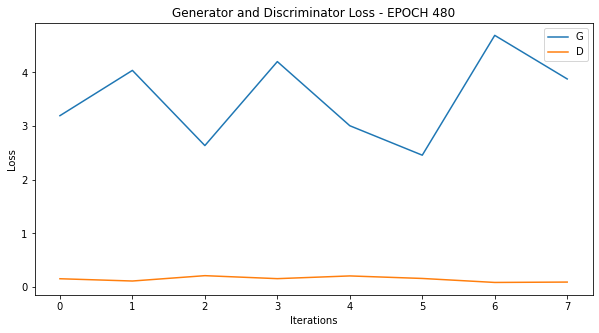

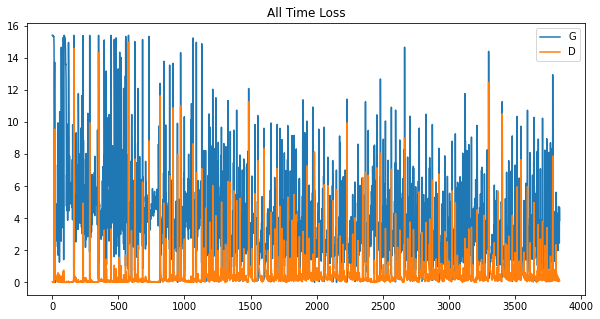

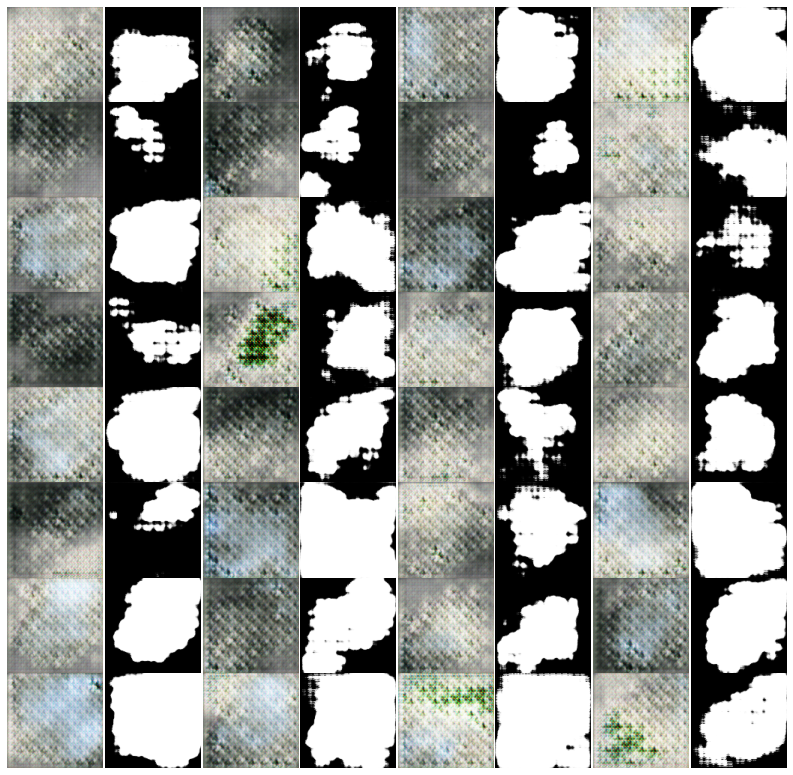





 16%|█▌        | 480/3000 [1:22:48<7:56:12, 11.34s/it]

Epoch: 480 computed for 14.110172748565674 sec
Gen_loss mean:  3.5140605  std:  0.75121
Disc_loss mean:  0.14737067  std:  0.044862103






 16%|█▌        | 481/3000 [1:22:59<7:43:01, 11.03s/it]

Epoch: 481 computed for 10.293712377548218 sec
Gen_loss mean:  4.8303647  std:  2.8695014
Disc_loss mean:  0.4534305  std:  0.42275786






 16%|█▌        | 482/3000 [1:23:09<7:32:13, 10.78s/it]

Epoch: 482 computed for 10.16351866722107 sec
Gen_loss mean:  5.232697  std:  4.397223
Disc_loss mean:  2.4836454  std:  3.5733354






 16%|█▌        | 483/3000 [1:23:19<7:23:30, 10.57s/it]

Epoch: 483 computed for 10.082645416259766 sec
Gen_loss mean:  1.8330293  std:  0.5820498
Disc_loss mean:  0.64051276  std:  0.38404247






 16%|█▌        | 484/3000 [1:23:29<7:18:17, 10.45s/it]

Epoch: 484 computed for 10.156901597976685 sec
Gen_loss mean:  2.1911342  std:  0.31367534
Disc_loss mean:  0.3835698  std:  0.09493491






 16%|█▌        | 485/3000 [1:23:39<7:13:08, 10.33s/it]

Epoch: 485 computed for 10.040346145629883 sec
Gen_loss mean:  3.3997726  std:  1.3668555
Disc_loss mean:  0.3976073  std:  0.27487248






 16%|█▌        | 486/3000 [1:23:49<7:09:28, 10.25s/it]

Epoch: 486 computed for 10.040562868118286 sec
Gen_loss mean:  3.6905608  std:  1.8690747
Disc_loss mean:  0.39097232  std:  0.35370404






 16%|█▌        | 487/3000 [1:23:59<7:08:19, 10.23s/it]

Epoch: 487 computed for 10.158538818359375 sec
Gen_loss mean:  3.0462852  std:  0.87773633
Disc_loss mean:  0.21834067  std:  0.121209174






 16%|█▋        | 488/3000 [1:24:09<7:06:01, 10.18s/it]

Epoch: 488 computed for 10.044497728347778 sec
Gen_loss mean:  3.3285165  std:  2.7169085
Disc_loss mean:  0.81388557  std:  1.2676961






 16%|█▋        | 489/3000 [1:24:20<7:05:02, 10.16s/it]

Epoch: 489 computed for 10.097949743270874 sec
Gen_loss mean:  3.067452  std:  0.39996713
Disc_loss mean:  0.13684681  std:  0.045906655






 16%|█▋        | 490/3000 [1:24:30<7:04:36, 10.15s/it]

Epoch: 490 computed for 10.110827684402466 sec
Gen_loss mean:  3.8651454  std:  2.6418035
Disc_loss mean:  1.268164  std:  1.8911259






 16%|█▋        | 491/3000 [1:24:40<7:04:47, 10.16s/it]

Epoch: 491 computed for 10.16051959991455 sec
Gen_loss mean:  1.6323687  std:  0.69672775
Disc_loss mean:  0.74057317  std:  0.45594025






 16%|█▋        | 492/3000 [1:24:50<7:06:05, 10.19s/it]

Epoch: 492 computed for 10.258837461471558 sec
Gen_loss mean:  2.892253  std:  0.35604444
Disc_loss mean:  0.2066359  std:  0.048458636






 16%|█▋        | 493/3000 [1:25:00<7:05:04, 10.17s/it]

Epoch: 493 computed for 10.111268043518066 sec
Gen_loss mean:  3.294435  std:  1.6004945
Disc_loss mean:  0.31148708  std:  0.09485687






 16%|█▋        | 494/3000 [1:25:11<7:05:12, 10.18s/it]

Epoch: 494 computed for 10.182132244110107 sec
Gen_loss mean:  3.23253  std:  2.5976114
Disc_loss mean:  0.88086563  std:  0.7136989






 16%|█▋        | 495/3000 [1:25:21<7:04:01, 10.16s/it]

Epoch: 495 computed for 10.08234691619873 sec
Gen_loss mean:  3.800941  std:  1.7669637
Disc_loss mean:  0.45070347  std:  0.29350922






 17%|█▋        | 496/3000 [1:25:31<7:03:39, 10.15s/it]

Epoch: 496 computed for 10.126740217208862 sec
Gen_loss mean:  3.431641  std:  2.0752273
Disc_loss mean:  0.8046756  std:  1.0149345






 17%|█▋        | 497/3000 [1:25:41<7:03:06, 10.14s/it]

Epoch: 497 computed for 10.1059730052948 sec
Gen_loss mean:  2.525675  std:  0.6049199
Disc_loss mean:  0.2576197  std:  0.08379453






 17%|█▋        | 498/3000 [1:25:51<7:03:54, 10.17s/it]

Epoch: 498 computed for 10.204272747039795 sec
Gen_loss mean:  3.1053057  std:  1.0995343
Disc_loss mean:  0.32102525  std:  0.37645632






 17%|█▋        | 499/3000 [1:26:01<7:02:19, 10.13s/it]

Epoch: 499 computed for 10.035171747207642 sec
Gen_loss mean:  3.800962  std:  3.1083732
Disc_loss mean:  0.8683501  std:  1.2393409
Saved temporary images for evaluation.
Removed temporary image directory.






 17%|█▋        | 500/3000 [1:26:17<8:08:38, 11.73s/it]

Epoch: 500 computed for 15.432749032974243 sec
Gen_loss mean:  3.2018502  std:  1.2738214
Disc_loss mean:  0.40094414  std:  0.2978123






 17%|█▋        | 501/3000 [1:26:27<7:49:05, 11.26s/it]

Epoch: 501 computed for 10.164757013320923 sec
Gen_loss mean:  3.2223532  std:  0.61323863
Disc_loss mean:  0.16077965  std:  0.056071743






 17%|█▋        | 502/3000 [1:26:37<7:34:55, 10.93s/it]

Epoch: 502 computed for 10.119625568389893 sec
Gen_loss mean:  3.2115803  std:  1.106364
Disc_loss mean:  0.24123858  std:  0.28822783






 17%|█▋        | 503/3000 [1:26:47<7:24:10, 10.67s/it]

Epoch: 503 computed for 10.061943769454956 sec
Gen_loss mean:  4.77445  std:  2.9897692
Disc_loss mean:  0.78895247  std:  1.1894358






 17%|█▋        | 504/3000 [1:26:57<7:18:02, 10.53s/it]

Epoch: 504 computed for 10.177675724029541 sec
Gen_loss mean:  3.0322657  std:  1.0601863
Disc_loss mean:  0.21603248  std:  0.06468517






 17%|█▋        | 505/3000 [1:27:07<7:12:44, 10.41s/it]

Epoch: 505 computed for 10.10782504081726 sec
Gen_loss mean:  3.8429193  std:  2.7585745
Disc_loss mean:  0.7171308  std:  0.87324166






 17%|█▋        | 506/3000 [1:27:17<7:09:39, 10.34s/it]

Epoch: 506 computed for 10.15900468826294 sec
Gen_loss mean:  3.5861459  std:  2.6174786
Disc_loss mean:  0.7105545  std:  0.6452765






 17%|█▋        | 507/3000 [1:27:28<7:06:35, 10.27s/it]

Epoch: 507 computed for 10.087114095687866 sec
Gen_loss mean:  3.0722976  std:  0.59517455
Disc_loss mean:  0.20908555  std:  0.05469705






 17%|█▋        | 508/3000 [1:27:38<7:05:52, 10.25s/it]

Epoch: 508 computed for 10.210026741027832 sec
Gen_loss mean:  3.4760652  std:  1.5940158
Disc_loss mean:  0.3350007  std:  0.32485512






 17%|█▋        | 509/3000 [1:27:48<7:04:36, 10.23s/it]

Epoch: 509 computed for 10.149932622909546 sec
Gen_loss mean:  4.0944166  std:  2.0816393
Disc_loss mean:  0.38608247  std:  0.3999668






 17%|█▋        | 510/3000 [1:27:58<7:02:42, 10.19s/it]

Epoch: 510 computed for 10.076188564300537 sec
Gen_loss mean:  3.4442713  std:  2.011362
Disc_loss mean:  0.35064107  std:  0.34414443






 17%|█▋        | 511/3000 [1:28:08<7:01:29, 10.16s/it]

Epoch: 511 computed for 10.08847188949585 sec
Gen_loss mean:  5.122326  std:  2.7294693
Disc_loss mean:  0.43296987  std:  0.44014874






 17%|█▋        | 512/3000 [1:28:18<7:01:36, 10.17s/it]

Epoch: 512 computed for 10.157918691635132 sec
Gen_loss mean:  3.0124106  std:  1.3039075
Disc_loss mean:  0.3106225  std:  0.15928188






 17%|█▋        | 513/3000 [1:28:28<7:00:24, 10.14s/it]

Epoch: 513 computed for 10.071351289749146 sec
Gen_loss mean:  5.03117  std:  2.1583161
Disc_loss mean:  0.25126973  std:  0.19311722






 17%|█▋        | 514/3000 [1:28:39<7:00:19, 10.14s/it]

Epoch: 514 computed for 10.132509469985962 sec
Gen_loss mean:  3.1569982  std:  2.451433
Disc_loss mean:  1.1072223  std:  1.4684037






 17%|█▋        | 515/3000 [1:28:49<7:04:55, 10.26s/it]

Epoch: 515 computed for 10.513877391815186 sec
Gen_loss mean:  3.1185899  std:  1.209979
Disc_loss mean:  0.306018  std:  0.23453353






 17%|█▋        | 516/3000 [1:28:59<7:02:38, 10.21s/it]

Epoch: 516 computed for 10.066489458084106 sec
Gen_loss mean:  3.3431609  std:  1.5887531
Disc_loss mean:  0.74413824  std:  1.0260975






 17%|█▋        | 517/3000 [1:29:09<7:03:16, 10.23s/it]

Epoch: 517 computed for 10.258041143417358 sec
Gen_loss mean:  2.3523312  std:  0.8834926
Disc_loss mean:  0.31920028  std:  0.22983947






 17%|█▋        | 518/3000 [1:29:20<7:02:08, 10.20s/it]

Epoch: 518 computed for 10.135674476623535 sec
Gen_loss mean:  3.476771  std:  1.0896864
Disc_loss mean:  0.1469628  std:  0.070547335






 17%|█▋        | 519/3000 [1:29:30<7:00:31, 10.17s/it]

Epoch: 519 computed for 10.072990655899048 sec
Gen_loss mean:  4.905651  std:  3.9453657
Disc_loss mean:  2.1396048  std:  2.9832704


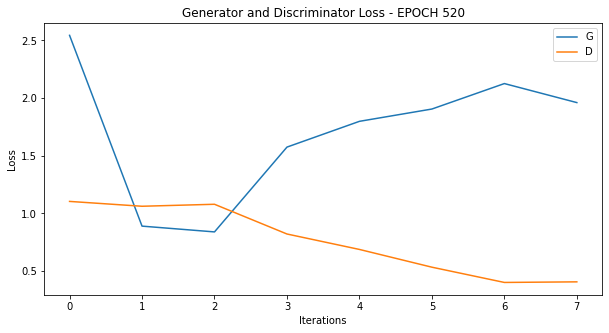

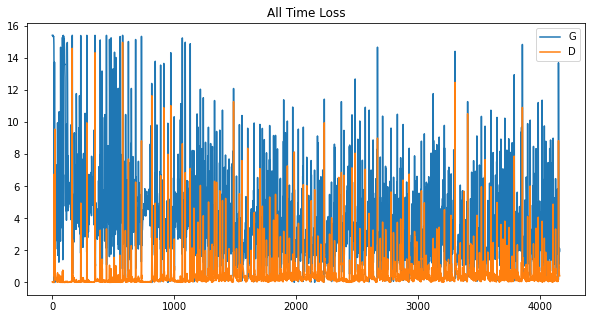

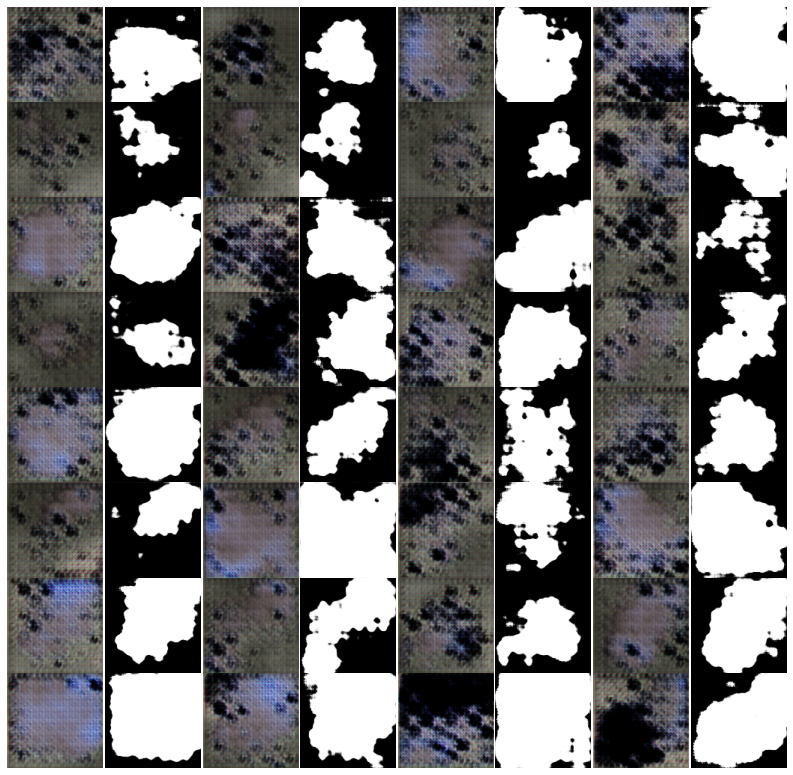





 17%|█▋        | 520/3000 [1:29:44<7:51:28, 11.41s/it]

Epoch: 520 computed for 14.239465236663818 sec
Gen_loss mean:  1.7038691  std:  0.55064386
Disc_loss mean:  0.7610615  std:  0.27956218






 17%|█▋        | 521/3000 [1:29:55<7:40:05, 11.14s/it]

Epoch: 521 computed for 10.491124868392944 sec
Gen_loss mean:  2.0391173  std:  0.62257195
Disc_loss mean:  0.5456493  std:  0.19816506






 17%|█▋        | 522/3000 [1:30:05<7:29:49, 10.89s/it]

Epoch: 522 computed for 10.307194471359253 sec
Gen_loss mean:  2.686779  std:  1.2756462
Disc_loss mean:  0.41718262  std:  0.14839256






 17%|█▋        | 523/3000 [1:30:15<7:20:00, 10.66s/it]

Epoch: 523 computed for 10.098864555358887 sec
Gen_loss mean:  3.0636826  std:  1.5504122
Disc_loss mean:  0.42262876  std:  0.421383






 17%|█▋        | 524/3000 [1:30:25<7:13:09, 10.50s/it]

Epoch: 524 computed for 10.103639841079712 sec
Gen_loss mean:  2.737216  std:  1.0934231
Disc_loss mean:  0.376361  std:  0.20665291






 18%|█▊        | 525/3000 [1:30:35<7:08:28, 10.39s/it]

Epoch: 525 computed for 10.118432998657227 sec
Gen_loss mean:  3.0785646  std:  1.7195759
Disc_loss mean:  0.59671307  std:  0.66763014






 18%|█▊        | 526/3000 [1:30:45<7:05:08, 10.31s/it]

Epoch: 526 computed for 10.11932897567749 sec
Gen_loss mean:  3.2926412  std:  2.9449944
Disc_loss mean:  2.0789785  std:  2.2109694






 18%|█▊        | 527/3000 [1:30:55<7:03:01, 10.26s/it]

Epoch: 527 computed for 10.132640600204468 sec
Gen_loss mean:  1.9289774  std:  0.4629331
Disc_loss mean:  0.57262444  std:  0.19491225






 18%|█▊        | 528/3000 [1:31:06<7:01:23, 10.23s/it]

Epoch: 528 computed for 10.129764556884766 sec
Gen_loss mean:  2.0120182  std:  0.4826
Disc_loss mean:  0.4571936  std:  0.17290416






 18%|█▊        | 529/3000 [1:31:16<7:00:40, 10.21s/it]

Epoch: 529 computed for 10.165199756622314 sec
Gen_loss mean:  3.2349668  std:  1.0594896
Disc_loss mean:  0.28892258  std:  0.19338468






 18%|█▊        | 530/3000 [1:31:26<6:59:11, 10.18s/it]

Epoch: 530 computed for 10.095160722732544 sec
Gen_loss mean:  3.4690375  std:  1.210896
Disc_loss mean:  0.18129987  std:  0.13040498






 18%|█▊        | 531/3000 [1:31:36<6:57:55, 10.16s/it]

Epoch: 531 computed for 10.078910112380981 sec
Gen_loss mean:  3.1876798  std:  2.3097327
Disc_loss mean:  1.0554277  std:  0.9523718






 18%|█▊        | 532/3000 [1:31:46<6:57:48, 10.16s/it]

Epoch: 532 computed for 10.148011684417725 sec
Gen_loss mean:  3.1728282  std:  0.41468427
Disc_loss mean:  0.14019021  std:  0.040166564






 18%|█▊        | 533/3000 [1:31:56<6:56:42, 10.13s/it]

Epoch: 533 computed for 10.061272621154785 sec
Gen_loss mean:  3.1625047  std:  0.82092685
Disc_loss mean:  0.21158963  std:  0.047439758






 18%|█▊        | 534/3000 [1:32:06<6:56:49, 10.14s/it]

Epoch: 534 computed for 10.14445424079895 sec
Gen_loss mean:  3.7285304  std:  3.9588404
Disc_loss mean:  2.063992  std:  1.510181






 18%|█▊        | 535/3000 [1:32:17<6:56:56, 10.15s/it]

Epoch: 535 computed for 10.150518417358398 sec
Gen_loss mean:  2.2313035  std:  0.30922833
Disc_loss mean:  0.37492776  std:  0.11267102






 18%|█▊        | 536/3000 [1:32:27<6:57:08, 10.16s/it]

Epoch: 536 computed for 10.157679080963135 sec
Gen_loss mean:  2.7543116  std:  1.2945676
Disc_loss mean:  0.5828234  std:  0.40558258






 18%|█▊        | 537/3000 [1:32:37<6:58:12, 10.19s/it]

Epoch: 537 computed for 10.24239444732666 sec
Gen_loss mean:  2.8959756  std:  1.638892
Disc_loss mean:  0.52947026  std:  0.47151095






 18%|█▊        | 538/3000 [1:32:47<6:57:17, 10.17s/it]

Epoch: 538 computed for 10.112398386001587 sec
Gen_loss mean:  3.0451765  std:  0.5279245
Disc_loss mean:  0.20323296  std:  0.10368566






 18%|█▊        | 539/3000 [1:32:58<6:59:46, 10.23s/it]

Epoch: 539 computed for 10.370688438415527 sec
Gen_loss mean:  3.3899155  std:  1.8407445
Disc_loss mean:  1.1378857  std:  1.6078689






 18%|█▊        | 540/3000 [1:33:08<6:57:26, 10.18s/it]

Epoch: 540 computed for 10.044877529144287 sec
Gen_loss mean:  2.5063038  std:  0.6130066
Disc_loss mean:  0.32010913  std:  0.11697096






 18%|█▊        | 541/3000 [1:33:18<6:56:42, 10.17s/it]

Epoch: 541 computed for 10.121022701263428 sec
Gen_loss mean:  3.2349787  std:  1.7406845
Disc_loss mean:  0.34160525  std:  0.35813677






 18%|█▊        | 542/3000 [1:33:28<6:55:56, 10.15s/it]

Epoch: 542 computed for 10.103053569793701 sec
Gen_loss mean:  3.9907696  std:  2.4693396
Disc_loss mean:  0.49036026  std:  0.64373803






 18%|█▊        | 543/3000 [1:33:38<6:54:34, 10.12s/it]

Epoch: 543 computed for 10.040565252304077 sec
Gen_loss mean:  3.5570638  std:  2.0923522
Disc_loss mean:  0.46451342  std:  0.3948607






 18%|█▊        | 544/3000 [1:33:48<6:55:00, 10.14s/it]

Epoch: 544 computed for 10.156794309616089 sec
Gen_loss mean:  3.341106  std:  1.469034
Disc_loss mean:  0.2836421  std:  0.15543918






 18%|█▊        | 545/3000 [1:33:58<6:54:07, 10.12s/it]

Epoch: 545 computed for 10.060572624206543 sec
Gen_loss mean:  3.5706608  std:  2.9989326
Disc_loss mean:  1.0828791  std:  1.3117028






 18%|█▊        | 546/3000 [1:34:08<6:53:28, 10.11s/it]

Epoch: 546 computed for 10.063002109527588 sec
Gen_loss mean:  2.6995692  std:  0.9008179
Disc_loss mean:  0.32238305  std:  0.14421964






 18%|█▊        | 547/3000 [1:34:18<6:53:29, 10.11s/it]

Epoch: 547 computed for 10.111172914505005 sec
Gen_loss mean:  3.4789577  std:  0.95760864
Disc_loss mean:  0.1704842  std:  0.10233404






 18%|█▊        | 548/3000 [1:34:28<6:53:15, 10.11s/it]

Epoch: 548 computed for 10.094584941864014 sec
Gen_loss mean:  4.8428116  std:  2.641557
Disc_loss mean:  0.37490457  std:  0.36252043






 18%|█▊        | 549/3000 [1:34:39<6:52:49, 10.11s/it]

Epoch: 549 computed for 10.073512077331543 sec
Gen_loss mean:  3.7622387  std:  2.1835682
Disc_loss mean:  0.3358485  std:  0.29329675
Saved temporary images for evaluation.
Removed temporary image directory.






 18%|█▊        | 550/3000 [1:34:54<7:57:42, 11.70s/it]

Epoch: 550 computed for 15.39283537864685 sec
Gen_loss mean:  3.5840309  std:  2.8193538
Disc_loss mean:  0.8378342  std:  1.2248589






 18%|█▊        | 551/3000 [1:35:04<7:37:59, 11.22s/it]

Epoch: 551 computed for 10.091341733932495 sec
Gen_loss mean:  2.5827112  std:  0.69335365
Disc_loss mean:  0.29194623  std:  0.1684852






 18%|█▊        | 552/3000 [1:35:14<7:27:25, 10.97s/it]

Epoch: 552 computed for 10.358994960784912 sec
Gen_loss mean:  4.131722  std:  2.9759254
Disc_loss mean:  0.6355884  std:  0.7717809






 18%|█▊        | 553/3000 [1:35:25<7:16:51, 10.71s/it]

Epoch: 553 computed for 10.104974269866943 sec
Gen_loss mean:  3.1135097  std:  1.3218603
Disc_loss mean:  0.27814436  std:  0.13236144






 18%|█▊        | 554/3000 [1:35:35<7:10:22, 10.56s/it]

Epoch: 554 computed for 10.1817626953125 sec
Gen_loss mean:  4.7075505  std:  1.7151266
Disc_loss mean:  0.14307499  std:  0.12557502






 18%|█▊        | 555/3000 [1:35:45<7:04:18, 10.41s/it]

Epoch: 555 computed for 10.057677030563354 sec
Gen_loss mean:  4.585929  std:  1.55554
Disc_loss mean:  0.19676013  std:  0.13092682






 19%|█▊        | 556/3000 [1:35:55<7:01:14, 10.34s/it]

Epoch: 556 computed for 10.159854650497437 sec
Gen_loss mean:  4.829506  std:  4.1986394
Disc_loss mean:  1.7634084  std:  2.3945174






 19%|█▊        | 557/3000 [1:36:05<6:57:50, 10.26s/it]

Epoch: 557 computed for 10.059337377548218 sec
Gen_loss mean:  2.5434155  std:  0.56024617
Disc_loss mean:  0.3463821  std:  0.13994548






 19%|█▊        | 558/3000 [1:36:15<6:55:39, 10.21s/it]

Epoch: 558 computed for 10.086164474487305 sec
Gen_loss mean:  3.541616  std:  1.1515996
Disc_loss mean:  0.21196961  std:  0.1522827






 19%|█▊        | 559/3000 [1:36:25<6:55:03, 10.20s/it]

Epoch: 559 computed for 10.161994934082031 sec
Gen_loss mean:  3.0636275  std:  1.0275457
Disc_loss mean:  0.3368948  std:  0.19070141


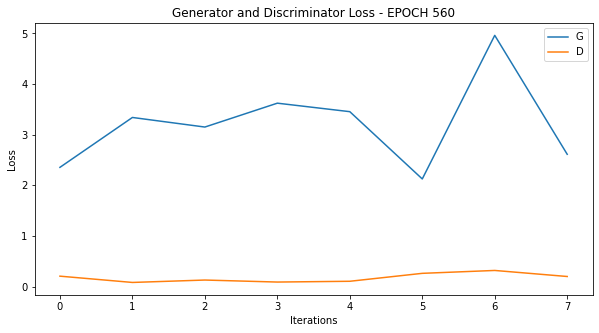

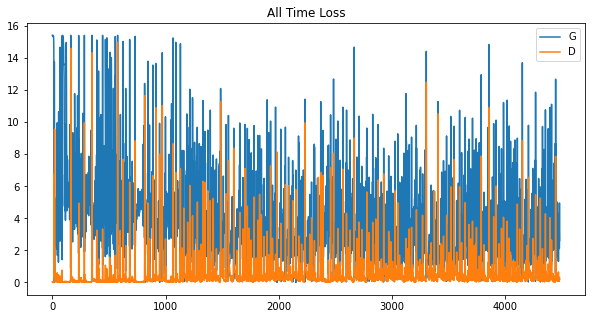

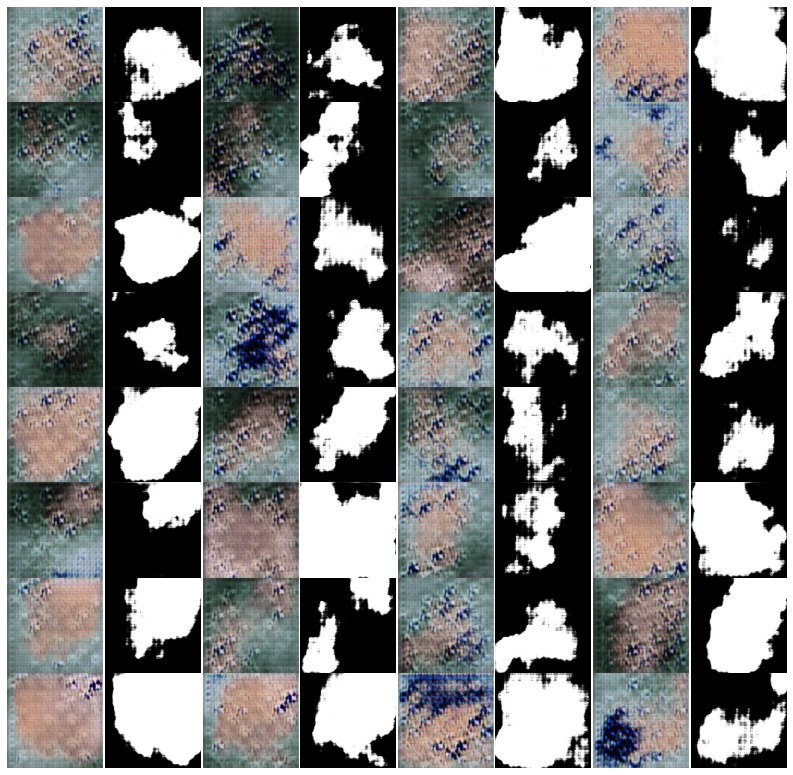





 19%|█▊        | 560/3000 [1:36:40<7:43:17, 11.39s/it]

Epoch: 560 computed for 14.143518209457397 sec
Gen_loss mean:  3.2013154  std:  0.83498347
Disc_loss mean:  0.17321776  std:  0.081105255






 19%|█▊        | 561/3000 [1:36:50<7:30:44, 11.09s/it]

Epoch: 561 computed for 10.365906238555908 sec
Gen_loss mean:  3.792129  std:  2.8631623
Disc_loss mean:  1.0130087  std:  1.4885298






 19%|█▊        | 562/3000 [1:37:00<7:18:26, 10.79s/it]

Epoch: 562 computed for 10.076076030731201 sec
Gen_loss mean:  2.945063  std:  0.48332283
Disc_loss mean:  0.18505621  std:  0.055600755






 19%|█▉        | 563/3000 [1:37:10<7:10:43, 10.60s/it]

Epoch: 563 computed for 10.152675867080688 sec
Gen_loss mean:  3.349935  std:  1.6497861
Disc_loss mean:  0.304134  std:  0.19604263






 19%|█▉        | 564/3000 [1:37:20<7:04:22, 10.45s/it]

Epoch: 564 computed for 10.082517862319946 sec
Gen_loss mean:  3.5512776  std:  1.3542694
Disc_loss mean:  0.3298252  std:  0.3643281






 19%|█▉        | 565/3000 [1:37:31<7:01:22, 10.38s/it]

Epoch: 565 computed for 10.199940919876099 sec
Gen_loss mean:  3.0150146  std:  3.2254577
Disc_loss mean:  1.8051816  std:  2.0143642






 19%|█▉        | 566/3000 [1:37:41<6:57:38, 10.30s/it]

Epoch: 566 computed for 10.068967342376709 sec
Gen_loss mean:  2.4597373  std:  0.31908175
Disc_loss mean:  0.27851385  std:  0.06741948






 19%|█▉        | 567/3000 [1:37:51<6:56:39, 10.28s/it]

Epoch: 567 computed for 10.214091300964355 sec
Gen_loss mean:  3.066564  std:  0.516176
Disc_loss mean:  0.24557248  std:  0.07523107






 19%|█▉        | 568/3000 [1:38:01<6:55:07, 10.24s/it]

Epoch: 568 computed for 10.143280982971191 sec
Gen_loss mean:  3.2656684  std:  2.2224207
Disc_loss mean:  0.78939646  std:  0.8160625






 19%|█▉        | 569/3000 [1:38:11<6:53:34, 10.21s/it]

Epoch: 569 computed for 10.111948728561401 sec
Gen_loss mean:  3.0019188  std:  0.4442443
Disc_loss mean:  0.17611066  std:  0.06408922






 19%|█▉        | 570/3000 [1:38:21<6:53:01, 10.20s/it]

Epoch: 570 computed for 10.1630277633667 sec
Gen_loss mean:  3.544335  std:  1.3680168
Disc_loss mean:  0.25976953  std:  0.17632458






 19%|█▉        | 571/3000 [1:38:31<6:51:34, 10.17s/it]

Epoch: 571 computed for 10.078055143356323 sec
Gen_loss mean:  5.158781  std:  3.1608698
Disc_loss mean:  0.4873226  std:  0.4856457






 19%|█▉        | 572/3000 [1:38:42<6:51:15, 10.16s/it]

Epoch: 572 computed for 10.1396803855896 sec
Gen_loss mean:  4.2322636  std:  2.6528783
Disc_loss mean:  0.51923424  std:  0.6647782






 19%|█▉        | 573/3000 [1:38:52<6:50:09, 10.14s/it]

Epoch: 573 computed for 10.070255756378174 sec
Gen_loss mean:  3.218842  std:  1.5561951
Disc_loss mean:  0.43559235  std:  0.28185248






 19%|█▉        | 574/3000 [1:39:02<6:50:40, 10.16s/it]

Epoch: 574 computed for 10.182918787002563 sec
Gen_loss mean:  3.6613398  std:  1.5020531
Disc_loss mean:  0.20610006  std:  0.13023199






 19%|█▉        | 575/3000 [1:39:12<6:49:38, 10.14s/it]

Epoch: 575 computed for 10.06845760345459 sec
Gen_loss mean:  4.060846  std:  1.7475238
Disc_loss mean:  0.1843848  std:  0.16191646






 19%|█▉        | 576/3000 [1:39:22<6:49:11, 10.13s/it]

Epoch: 576 computed for 10.09256649017334 sec
Gen_loss mean:  4.024724  std:  3.6064143
Disc_loss mean:  1.3296485  std:  1.5772332






 19%|█▉        | 577/3000 [1:39:32<6:49:09, 10.13s/it]

Epoch: 577 computed for 10.124068260192871 sec
Gen_loss mean:  2.5517142  std:  1.1238937
Disc_loss mean:  0.40514117  std:  0.17169052






 19%|█▉        | 578/3000 [1:39:42<6:48:30, 10.12s/it]

Epoch: 578 computed for 10.074947834014893 sec
Gen_loss mean:  3.9134588  std:  1.2274342
Disc_loss mean:  0.1442129  std:  0.08039139






 19%|█▉        | 579/3000 [1:39:52<6:49:32, 10.15s/it]

Epoch: 579 computed for 10.202099561691284 sec
Gen_loss mean:  3.492431  std:  2.2885935
Disc_loss mean:  0.5383273  std:  0.5654445






 19%|█▉        | 580/3000 [1:40:03<6:48:48, 10.14s/it]

Epoch: 580 computed for 10.090523481369019 sec
Gen_loss mean:  8.157786  std:  3.5432897
Disc_loss mean:  0.13252501  std:  0.17858648






 19%|█▉        | 581/3000 [1:40:13<6:48:33, 10.13s/it]

Epoch: 581 computed for 10.11161994934082 sec
Gen_loss mean:  5.2849936  std:  3.630224
Disc_loss mean:  1.3388063  std:  1.9187748






 19%|█▉        | 582/3000 [1:40:23<6:51:04, 10.20s/it]

Epoch: 582 computed for 10.34514856338501 sec
Gen_loss mean:  3.2834382  std:  1.1729872
Disc_loss mean:  0.24173588  std:  0.19062115






 19%|█▉        | 583/3000 [1:40:33<6:49:58, 10.18s/it]

Epoch: 583 computed for 10.102583646774292 sec
Gen_loss mean:  2.8068762  std:  1.055387
Disc_loss mean:  0.45904386  std:  0.3069582






 19%|█▉        | 584/3000 [1:40:43<6:49:04, 10.16s/it]

Epoch: 584 computed for 10.09997034072876 sec
Gen_loss mean:  2.9801733  std:  0.88501614
Disc_loss mean:  0.2308918  std:  0.08441467






 20%|█▉        | 585/3000 [1:40:53<6:49:08, 10.17s/it]

Epoch: 585 computed for 10.163893222808838 sec
Gen_loss mean:  3.9741135  std:  1.4190488
Disc_loss mean:  0.16459703  std:  0.11993949






 20%|█▉        | 586/3000 [1:41:04<6:48:10, 10.15s/it]

Epoch: 586 computed for 10.084638357162476 sec
Gen_loss mean:  4.6239862  std:  1.6366738
Disc_loss mean:  0.1716981  std:  0.18327254






 20%|█▉        | 587/3000 [1:41:14<6:48:00, 10.15s/it]

Epoch: 587 computed for 10.121777296066284 sec
Gen_loss mean:  4.2603807  std:  2.7338457
Disc_loss mean:  1.4977599  std:  1.6635454






 20%|█▉        | 588/3000 [1:41:24<6:47:21, 10.13s/it]

Epoch: 588 computed for 10.089879274368286 sec
Gen_loss mean:  1.9661033  std:  0.71382266
Disc_loss mean:  0.58592457  std:  0.28613523






 20%|█▉        | 589/3000 [1:41:34<6:47:22, 10.14s/it]

Epoch: 589 computed for 10.135572910308838 sec
Gen_loss mean:  2.9533143  std:  1.0922244
Disc_loss mean:  0.28176248  std:  0.07489471






 20%|█▉        | 590/3000 [1:41:44<6:47:20, 10.14s/it]

Epoch: 590 computed for 10.135292768478394 sec
Gen_loss mean:  4.455122  std:  2.7174315
Disc_loss mean:  0.42260957  std:  0.28435093






 20%|█▉        | 591/3000 [1:41:54<6:47:08, 10.14s/it]

Epoch: 591 computed for 10.12174129486084 sec
Gen_loss mean:  3.6566162  std:  1.7215072
Disc_loss mean:  0.38308132  std:  0.34093878






 20%|█▉        | 592/3000 [1:42:04<6:46:58, 10.14s/it]

Epoch: 592 computed for 10.125712633132935 sec
Gen_loss mean:  2.7666879  std:  1.7039433
Disc_loss mean:  1.205379  std:  1.8735393






 20%|█▉        | 593/3000 [1:42:15<6:46:20, 10.13s/it]

Epoch: 593 computed for 10.087345123291016 sec
Gen_loss mean:  2.854401  std:  1.0626057
Disc_loss mean:  0.38288113  std:  0.22929493






 20%|█▉        | 594/3000 [1:42:25<6:46:13, 10.13s/it]

Epoch: 594 computed for 10.121123313903809 sec
Gen_loss mean:  3.347189  std:  1.029959
Disc_loss mean:  0.17134035  std:  0.10264077






 20%|█▉        | 595/3000 [1:42:35<6:45:37, 10.12s/it]

Epoch: 595 computed for 10.078900337219238 sec
Gen_loss mean:  4.56192  std:  3.2515655
Disc_loss mean:  0.8165233  std:  1.3727697






 20%|█▉        | 596/3000 [1:42:45<6:45:03, 10.11s/it]

Epoch: 596 computed for 10.073519468307495 sec
Gen_loss mean:  2.6785803  std:  0.6228293
Disc_loss mean:  0.26527983  std:  0.053438228






 20%|█▉        | 597/3000 [1:42:55<6:45:59, 10.14s/it]

Epoch: 597 computed for 10.18492865562439 sec
Gen_loss mean:  2.859189  std:  1.1025654
Disc_loss mean:  0.28295326  std:  0.14031221






 20%|█▉        | 598/3000 [1:43:05<6:45:25, 10.13s/it]

Epoch: 598 computed for 10.082880735397339 sec
Gen_loss mean:  4.0273786  std:  2.3875806
Disc_loss mean:  0.6780025  std:  0.64336365






 20%|█▉        | 599/3000 [1:43:15<6:45:37, 10.14s/it]

Epoch: 599 computed for 10.130772590637207 sec
Gen_loss mean:  3.6593444  std:  1.817639
Disc_loss mean:  0.35585988  std:  0.15973333


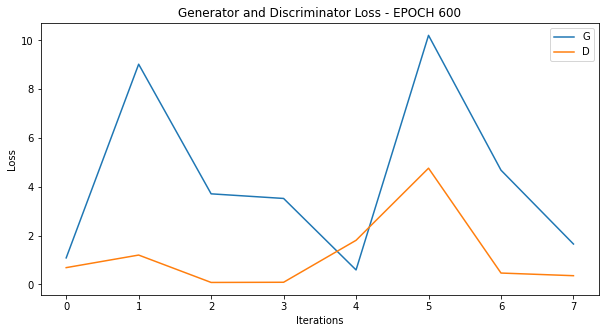

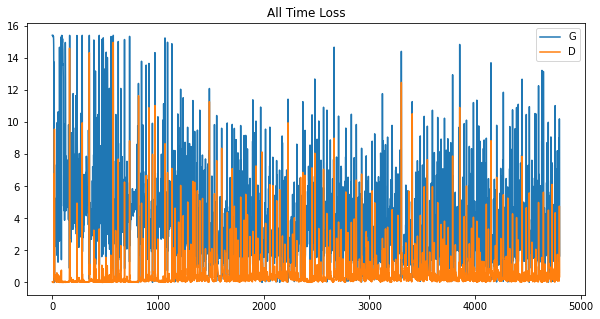

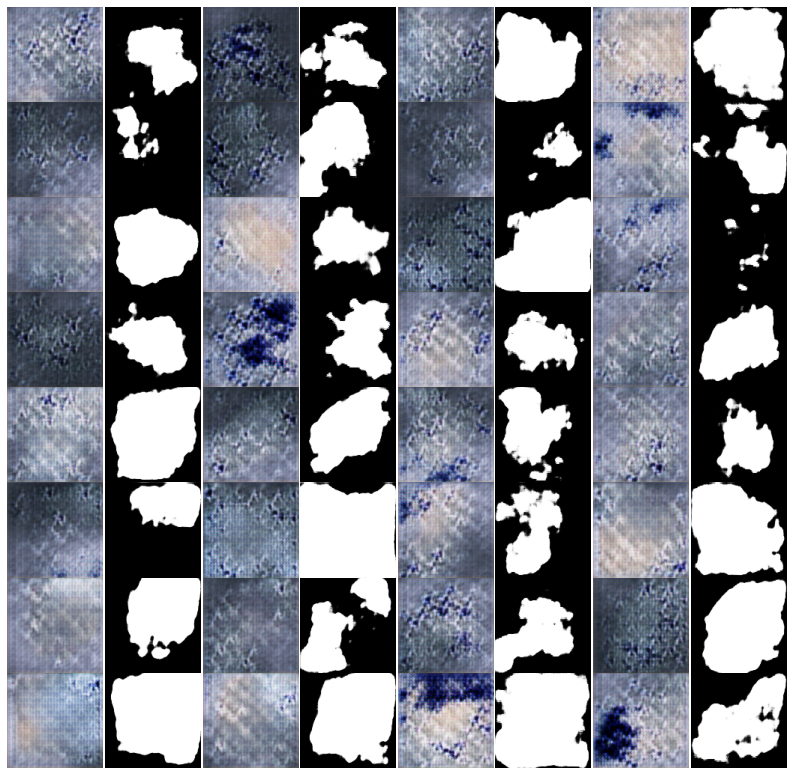

Saved temporary images for evaluation.
Removed temporary image directory.






 20%|██        | 600/3000 [1:43:35<8:43:48, 13.10s/it]

Epoch: 600 computed for 19.972297191619873 sec
Gen_loss mean:  4.3124495  std:  3.3430762
Disc_loss mean:  1.182928  std:  1.4607831






 20%|██        | 601/3000 [1:43:46<8:09:06, 12.23s/it]

Epoch: 601 computed for 10.202433824539185 sec
Gen_loss mean:  2.4160094  std:  0.9197168
Disc_loss mean:  0.35020977  std:  0.21676214






 20%|██        | 602/3000 [1:43:56<7:43:42, 11.60s/it]

Epoch: 602 computed for 10.118212461471558 sec
Gen_loss mean:  2.6955109  std:  1.0597612
Disc_loss mean:  0.32817388  std:  0.1079677






 20%|██        | 603/3000 [1:44:06<7:26:13, 11.17s/it]

Epoch: 603 computed for 10.133732795715332 sec
Gen_loss mean:  3.139807  std:  1.115555
Disc_loss mean:  0.2062726  std:  0.066141665






 20%|██        | 604/3000 [1:44:16<7:13:13, 10.85s/it]

Epoch: 604 computed for 10.081754207611084 sec
Gen_loss mean:  3.639591  std:  3.1500328
Disc_loss mean:  1.0986322  std:  1.2738237






 20%|██        | 605/3000 [1:44:26<7:04:32, 10.64s/it]

Epoch: 605 computed for 10.123839378356934 sec
Gen_loss mean:  3.2294135  std:  1.3590271
Disc_loss mean:  0.32985985  std:  0.12786536






 20%|██        | 606/3000 [1:44:36<6:58:06, 10.48s/it]

Epoch: 606 computed for 10.098336219787598 sec
Gen_loss mean:  3.7775407  std:  2.6632388
Disc_loss mean:  1.0595071  std:  1.2422136






 20%|██        | 607/3000 [1:44:46<6:54:00, 10.38s/it]

Epoch: 607 computed for 10.13639760017395 sec
Gen_loss mean:  2.344304  std:  0.6538943
Disc_loss mean:  0.2994513  std:  0.1573164






 20%|██        | 608/3000 [1:44:56<6:50:50, 10.31s/it]

Epoch: 608 computed for 10.115699291229248 sec
Gen_loss mean:  2.5699475  std:  0.4898314
Disc_loss mean:  0.27843285  std:  0.0558274






 20%|██        | 609/3000 [1:45:07<6:48:19, 10.25s/it]

Epoch: 609 computed for 10.095928430557251 sec
Gen_loss mean:  2.9043648  std:  1.1844276
Disc_loss mean:  0.32082915  std:  0.15298688






 20%|██        | 610/3000 [1:45:17<6:47:24, 10.23s/it]

Epoch: 610 computed for 10.163191318511963 sec
Gen_loss mean:  3.9273915  std:  1.5982671
Disc_loss mean:  0.2574151  std:  0.2210479






 20%|██        | 611/3000 [1:45:27<6:45:42, 10.19s/it]

Epoch: 611 computed for 10.085598230361938 sec
Gen_loss mean:  3.884938  std:  1.277977
Disc_loss mean:  0.1562412  std:  0.24674682






 20%|██        | 612/3000 [1:45:37<6:47:39, 10.24s/it]

Epoch: 612 computed for 10.350827693939209 sec
Gen_loss mean:  4.400073  std:  3.4705758
Disc_loss mean:  1.1306131  std:  1.6555493






 20%|██        | 613/3000 [1:45:47<6:45:59, 10.21s/it]

Epoch: 613 computed for 10.101922273635864 sec
Gen_loss mean:  3.2736232  std:  2.5544293
Disc_loss mean:  0.9072373  std:  1.23911






 20%|██        | 614/3000 [1:45:57<6:45:16, 10.19s/it]

Epoch: 614 computed for 10.144967794418335 sec
Gen_loss mean:  3.287931  std:  1.8620049
Disc_loss mean:  0.49474752  std:  0.40133286






 20%|██        | 615/3000 [1:46:08<6:43:33, 10.15s/it]

Epoch: 615 computed for 10.04921007156372 sec
Gen_loss mean:  3.8000827  std:  2.2170804
Disc_loss mean:  0.4331538  std:  0.4025487






 21%|██        | 616/3000 [1:46:18<6:42:37, 10.13s/it]

Epoch: 616 computed for 10.069840669631958 sec
Gen_loss mean:  3.6413183  std:  1.8913058
Disc_loss mean:  0.32010007  std:  0.3291633






 21%|██        | 617/3000 [1:46:28<6:42:28, 10.13s/it]

Epoch: 617 computed for 10.12149715423584 sec
Gen_loss mean:  4.238617  std:  1.8858585
Disc_loss mean:  0.37516212  std:  0.34941503






 21%|██        | 618/3000 [1:46:38<6:42:11, 10.13s/it]

Epoch: 618 computed for 10.106731414794922 sec
Gen_loss mean:  3.612922  std:  2.1310477
Disc_loss mean:  0.5738723  std:  0.35821286






 21%|██        | 619/3000 [1:46:48<6:42:20, 10.14s/it]

Epoch: 619 computed for 10.144948720932007 sec
Gen_loss mean:  2.9230723  std:  0.9314023
Disc_loss mean:  0.25588226  std:  0.15976298






 21%|██        | 620/3000 [1:46:58<6:42:01, 10.14s/it]

Epoch: 620 computed for 10.112809181213379 sec
Gen_loss mean:  4.2529926  std:  1.7841442
Disc_loss mean:  0.2118452  std:  0.14776906






 21%|██        | 621/3000 [1:47:08<6:41:42, 10.13s/it]

Epoch: 621 computed for 10.105928659439087 sec
Gen_loss mean:  4.86567  std:  3.4685233
Disc_loss mean:  1.5822457  std:  2.7854898






 21%|██        | 622/3000 [1:47:18<6:41:32, 10.13s/it]

Epoch: 622 computed for 10.11889362335205 sec
Gen_loss mean:  1.8207381  std:  0.6007097
Disc_loss mean:  0.48469153  std:  0.21415186






 21%|██        | 623/3000 [1:47:29<6:41:41, 10.14s/it]

Epoch: 623 computed for 10.13765811920166 sec
Gen_loss mean:  3.320166  std:  2.5259972
Disc_loss mean:  1.5502646  std:  1.593295






 21%|██        | 624/3000 [1:47:39<6:41:15, 10.13s/it]

Epoch: 624 computed for 10.099032640457153 sec
Gen_loss mean:  1.7359891  std:  0.59387213
Disc_loss mean:  0.47650784  std:  0.19163539






 21%|██        | 625/3000 [1:47:49<6:41:31, 10.14s/it]

Epoch: 625 computed for 10.157143831253052 sec
Gen_loss mean:  2.8740942  std:  0.84734714
Disc_loss mean:  0.32945976  std:  0.16732624






 21%|██        | 626/3000 [1:47:59<6:41:33, 10.15s/it]

Epoch: 626 computed for 10.148117065429688 sec
Gen_loss mean:  3.0458536  std:  0.9127288
Disc_loss mean:  0.23798952  std:  0.068005726






 21%|██        | 627/3000 [1:48:09<6:41:17, 10.15s/it]

Epoch: 627 computed for 10.125757217407227 sec
Gen_loss mean:  3.7205248  std:  0.97603244
Disc_loss mean:  0.16640075  std:  0.063317955






 21%|██        | 628/3000 [1:48:19<6:40:21, 10.13s/it]

Epoch: 628 computed for 10.068841457366943 sec
Gen_loss mean:  4.433935  std:  2.204686
Disc_loss mean:  0.38380295  std:  0.2105617






 21%|██        | 629/3000 [1:48:29<6:40:51, 10.14s/it]

Epoch: 629 computed for 10.166051626205444 sec
Gen_loss mean:  4.982052  std:  2.0499442
Disc_loss mean:  0.18642552  std:  0.21653202






 21%|██        | 630/3000 [1:48:40<6:42:29, 10.19s/it]

Epoch: 630 computed for 10.281152486801147 sec
Gen_loss mean:  3.80401  std:  1.0470837
Disc_loss mean:  0.21824428  std:  0.3423123






 21%|██        | 631/3000 [1:48:50<6:41:06, 10.16s/it]

Epoch: 631 computed for 10.06938362121582 sec
Gen_loss mean:  3.1739628  std:  3.7371712
Disc_loss mean:  2.5969973  std:  2.5052454






 21%|██        | 632/3000 [1:49:00<6:39:46, 10.13s/it]

Epoch: 632 computed for 10.042174100875854 sec
Gen_loss mean:  2.3659554  std:  0.7801139
Disc_loss mean:  0.5145805  std:  0.0931013






 21%|██        | 633/3000 [1:49:10<6:40:18, 10.15s/it]

Epoch: 633 computed for 10.174026727676392 sec
Gen_loss mean:  2.9276981  std:  1.2927264
Disc_loss mean:  0.55539167  std:  0.33108053






 21%|██        | 634/3000 [1:49:20<6:40:13, 10.15s/it]

Epoch: 634 computed for 10.129729986190796 sec
Gen_loss mean:  2.4845157  std:  1.5174531
Disc_loss mean:  1.0278505  std:  0.98015374






 21%|██        | 635/3000 [1:49:30<6:39:47, 10.14s/it]

Epoch: 635 computed for 10.108067035675049 sec
Gen_loss mean:  2.0655334  std:  0.60258734
Disc_loss mean:  0.6713083  std:  0.40593094






 21%|██        | 636/3000 [1:49:40<6:39:21, 10.14s/it]

Epoch: 636 computed for 10.104355812072754 sec
Gen_loss mean:  2.9450507  std:  0.7669936
Disc_loss mean:  0.3030684  std:  0.11420026






 21%|██        | 637/3000 [1:49:51<6:39:38, 10.15s/it]

Epoch: 637 computed for 10.145049571990967 sec
Gen_loss mean:  2.065185  std:  2.0153205
Disc_loss mean:  1.2718034  std:  0.97941506






 21%|██▏       | 638/3000 [1:50:01<6:38:17, 10.12s/it]

Epoch: 638 computed for 10.03453254699707 sec
Gen_loss mean:  1.999773  std:  0.63101935
Disc_loss mean:  0.511148  std:  0.21838291






 21%|██▏       | 639/3000 [1:50:11<6:38:37, 10.13s/it]

Epoch: 639 computed for 10.140649795532227 sec
Gen_loss mean:  2.388218  std:  1.3152425
Disc_loss mean:  0.8334765  std:  0.5991295


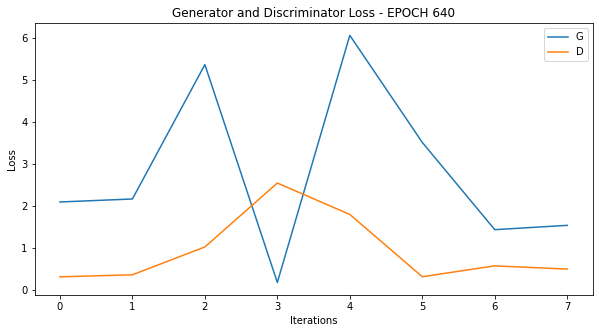

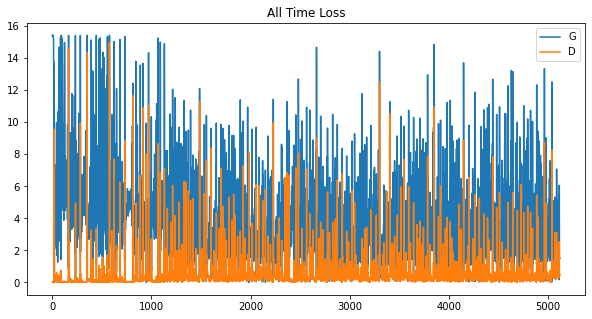

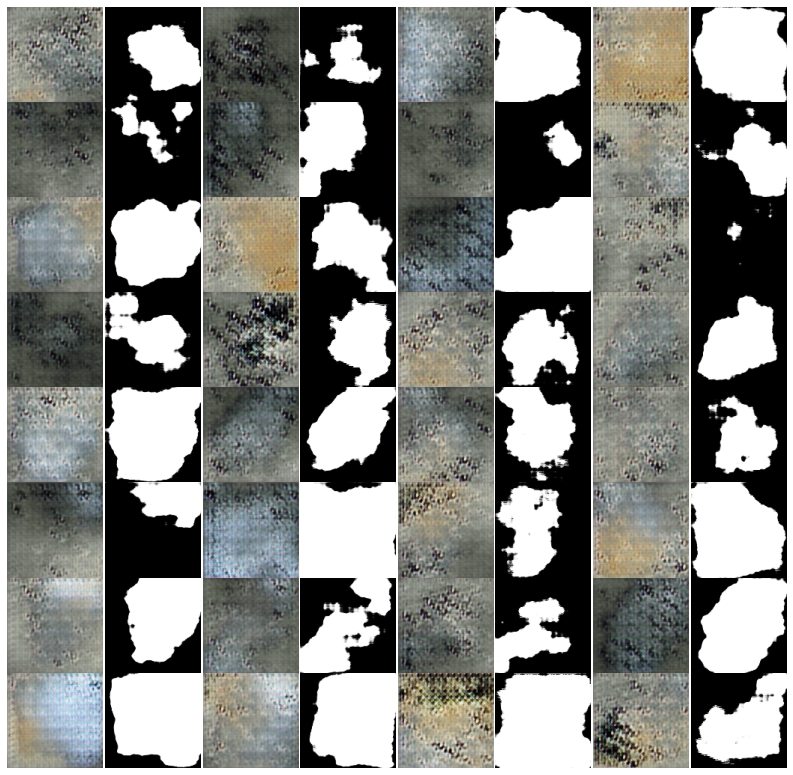





 21%|██▏       | 640/3000 [1:50:25<7:26:19, 11.35s/it]

Epoch: 640 computed for 14.155677080154419 sec
Gen_loss mean:  2.7946463  std:  1.9035307
Disc_loss mean:  0.9275518  std:  0.7726548






 21%|██▏       | 641/3000 [1:50:35<7:15:08, 11.07s/it]

Epoch: 641 computed for 10.40368914604187 sec
Gen_loss mean:  2.4232583  std:  1.2453009
Disc_loss mean:  0.49367595  std:  0.1770248






 21%|██▏       | 642/3000 [1:50:46<7:06:31, 10.85s/it]

Epoch: 642 computed for 10.335903644561768 sec
Gen_loss mean:  2.787217  std:  1.945835
Disc_loss mean:  0.88633895  std:  0.9299455






 21%|██▏       | 643/3000 [1:50:56<6:58:19, 10.65s/it]

Epoch: 643 computed for 10.157226800918579 sec
Gen_loss mean:  3.093912  std:  1.718901
Disc_loss mean:  0.4832502  std:  0.35354406






 21%|██▏       | 644/3000 [1:51:06<6:51:36, 10.48s/it]

Epoch: 644 computed for 10.077206134796143 sec
Gen_loss mean:  2.9433455  std:  1.6797258
Disc_loss mean:  0.69979656  std:  0.5220336






 22%|██▏       | 645/3000 [1:51:16<6:47:02, 10.37s/it]

Epoch: 645 computed for 10.089411735534668 sec
Gen_loss mean:  2.9800916  std:  1.2636998
Disc_loss mean:  0.41349015  std:  0.30822507






 22%|██▏       | 646/3000 [1:51:26<6:43:48, 10.29s/it]

Epoch: 646 computed for 10.096545219421387 sec
Gen_loss mean:  2.944869  std:  1.357589
Disc_loss mean:  0.39717692  std:  0.4153275






 22%|██▏       | 647/3000 [1:51:36<6:41:42, 10.24s/it]

Epoch: 647 computed for 10.113962888717651 sec
Gen_loss mean:  3.810767  std:  1.7549717
Disc_loss mean:  0.2985502  std:  0.12805758






 22%|██▏       | 648/3000 [1:51:47<6:40:18, 10.21s/it]

Epoch: 648 computed for 10.124783992767334 sec
Gen_loss mean:  3.507305  std:  2.2730212
Disc_loss mean:  0.6831206  std:  0.5171039






 22%|██▏       | 649/3000 [1:51:57<6:39:06, 10.19s/it]

Epoch: 649 computed for 10.111162900924683 sec
Gen_loss mean:  3.319672  std:  0.682921
Disc_loss mean:  0.18837574  std:  0.047170013
Saved temporary images for evaluation.
Removed temporary image directory.






 22%|██▏       | 650/3000 [1:52:12<7:40:37, 11.76s/it]

Epoch: 650 computed for 15.408619165420532 sec
Gen_loss mean:  4.523031  std:  1.9399437
Disc_loss mean:  0.16544873  std:  0.085655645






 22%|██▏       | 651/3000 [1:52:22<7:21:40, 11.28s/it]

Epoch: 651 computed for 10.139521837234497 sec
Gen_loss mean:  4.572222  std:  1.8366531
Disc_loss mean:  0.21468341  std:  0.14079578






 22%|██▏       | 652/3000 [1:52:32<7:07:57, 10.94s/it]

Epoch: 652 computed for 10.114086866378784 sec
Gen_loss mean:  3.4813585  std:  3.4889574
Disc_loss mean:  2.403463  std:  2.2137337






 22%|██▏       | 653/3000 [1:52:43<6:58:05, 10.69s/it]

Epoch: 653 computed for 10.091428518295288 sec
Gen_loss mean:  1.4817255  std:  0.32438782
Disc_loss mean:  0.680235  std:  0.22925356






 22%|██▏       | 654/3000 [1:52:53<6:51:28, 10.52s/it]

Epoch: 654 computed for 10.12113642692566 sec
Gen_loss mean:  2.1076663  std:  0.65106493
Disc_loss mean:  0.46564734  std:  0.07427931






 22%|██▏       | 655/3000 [1:53:03<6:47:41, 10.43s/it]

Epoch: 655 computed for 10.196574687957764 sec
Gen_loss mean:  2.2684214  std:  1.6957657
Disc_loss mean:  1.0064186  std:  0.97252893






 22%|██▏       | 656/3000 [1:53:13<6:43:19, 10.32s/it]

Epoch: 656 computed for 10.060676574707031 sec
Gen_loss mean:  2.289618  std:  1.0094844
Disc_loss mean:  0.52576673  std:  0.17173567






 22%|██▏       | 657/3000 [1:53:23<6:40:56, 10.27s/it]

Epoch: 657 computed for 10.121407747268677 sec
Gen_loss mean:  2.7253742  std:  1.5965809
Disc_loss mean:  0.7095854  std:  0.5370728






 22%|██▏       | 658/3000 [1:53:33<6:39:26, 10.23s/it]

Epoch: 658 computed for 10.132708311080933 sec
Gen_loss mean:  2.635415  std:  0.7667512
Disc_loss mean:  0.40240502  std:  0.093593724






 22%|██▏       | 659/3000 [1:53:43<6:38:13, 10.21s/it]

Epoch: 659 computed for 10.12688946723938 sec
Gen_loss mean:  3.0345807  std:  2.0878577
Disc_loss mean:  0.76640224  std:  0.582517






 22%|██▏       | 660/3000 [1:53:54<6:37:21, 10.19s/it]

Epoch: 660 computed for 10.131818056106567 sec
Gen_loss mean:  3.3107805  std:  2.2021635
Disc_loss mean:  0.96912074  std:  0.98410916






 22%|██▏       | 661/3000 [1:54:04<6:36:04, 10.16s/it]

Epoch: 661 computed for 10.077937841415405 sec
Gen_loss mean:  2.4142175  std:  0.72493297
Disc_loss mean:  0.382709  std:  0.2901602






 22%|██▏       | 662/3000 [1:54:14<6:35:43, 10.16s/it]

Epoch: 662 computed for 10.12660551071167 sec
Gen_loss mean:  2.9950733  std:  2.2422304
Disc_loss mean:  0.7092036  std:  0.685319






 22%|██▏       | 663/3000 [1:54:24<6:34:37, 10.13s/it]

Epoch: 663 computed for 10.062751531600952 sec
Gen_loss mean:  2.8277586  std:  0.6902943
Disc_loss mean:  0.2912915  std:  0.10258352






 22%|██▏       | 664/3000 [1:54:34<6:34:37, 10.14s/it]

Epoch: 664 computed for 10.12584900856018 sec
Gen_loss mean:  3.1974053  std:  1.9737719
Disc_loss mean:  0.7834808  std:  0.70922273






 22%|██▏       | 665/3000 [1:54:44<6:33:56, 10.12s/it]

Epoch: 665 computed for 10.073264360427856 sec
Gen_loss mean:  2.8955579  std:  1.2208757
Disc_loss mean:  0.29690886  std:  0.12147072






 22%|██▏       | 666/3000 [1:54:54<6:33:06, 10.11s/it]

Epoch: 666 computed for 10.048009157180786 sec
Gen_loss mean:  3.404272  std:  2.664044
Disc_loss mean:  1.0144604  std:  1.3112922






 22%|██▏       | 667/3000 [1:55:04<6:32:48, 10.10s/it]

Epoch: 667 computed for 10.080553531646729 sec
Gen_loss mean:  2.678412  std:  0.58632773
Disc_loss mean:  0.2723517  std:  0.043304082






 22%|██▏       | 668/3000 [1:55:14<6:33:08, 10.12s/it]

Epoch: 668 computed for 10.132150650024414 sec
Gen_loss mean:  3.0136414  std:  1.501881
Disc_loss mean:  0.337014  std:  0.21747911






 22%|██▏       | 669/3000 [1:55:24<6:32:13, 10.10s/it]

Epoch: 669 computed for 10.034881353378296 sec
Gen_loss mean:  2.8263128  std:  1.026905
Disc_loss mean:  0.2856286  std:  0.18491374






 22%|██▏       | 670/3000 [1:55:35<6:32:05, 10.10s/it]

Epoch: 670 computed for 10.083760976791382 sec
Gen_loss mean:  3.4678454  std:  2.1705966
Disc_loss mean:  0.7149651  std:  1.171565






 22%|██▏       | 671/3000 [1:55:45<6:32:25, 10.11s/it]

Epoch: 671 computed for 10.126022338867188 sec
Gen_loss mean:  2.8628  std:  1.2747451
Disc_loss mean:  0.5190483  std:  0.48517007






 22%|██▏       | 672/3000 [1:55:55<6:33:52, 10.15s/it]

Epoch: 672 computed for 10.232672929763794 sec
Gen_loss mean:  2.7485404  std:  0.5061426
Disc_loss mean:  0.21535897  std:  0.08625496






 22%|██▏       | 673/3000 [1:56:05<6:33:18, 10.14s/it]

Epoch: 673 computed for 10.10167646408081 sec
Gen_loss mean:  3.112386  std:  2.6755571
Disc_loss mean:  1.2213798  std:  1.1924082






 22%|██▏       | 674/3000 [1:56:15<6:32:46, 10.13s/it]

Epoch: 674 computed for 10.09220552444458 sec
Gen_loss mean:  2.8656268  std:  0.96078277
Disc_loss mean:  0.32380334  std:  0.15311483






 22%|██▎       | 675/3000 [1:56:25<6:32:12, 10.12s/it]

Epoch: 675 computed for 10.081180810928345 sec
Gen_loss mean:  2.9265912  std:  1.7760102
Disc_loss mean:  0.5600188  std:  0.4555258






 23%|██▎       | 676/3000 [1:56:35<6:32:09, 10.12s/it]

Epoch: 676 computed for 10.111664533615112 sec
Gen_loss mean:  3.0126252  std:  2.585706
Disc_loss mean:  1.1030707  std:  1.586155






 23%|██▎       | 677/3000 [1:56:45<6:31:53, 10.12s/it]

Epoch: 677 computed for 10.10237455368042 sec
Gen_loss mean:  2.2716582  std:  0.4881018
Disc_loss mean:  0.33387303  std:  0.07099854






 23%|██▎       | 678/3000 [1:56:56<6:31:10, 10.11s/it]

Epoch: 678 computed for 10.059060335159302 sec
Gen_loss mean:  2.4449751  std:  0.5948422
Disc_loss mean:  0.31235826  std:  0.11871715






 23%|██▎       | 679/3000 [1:57:06<6:31:01, 10.11s/it]

Epoch: 679 computed for 10.095475673675537 sec
Gen_loss mean:  3.2357647  std:  1.7376832
Disc_loss mean:  0.5958434  std:  0.45287147


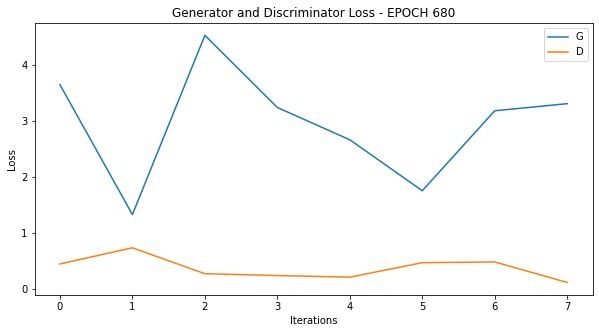

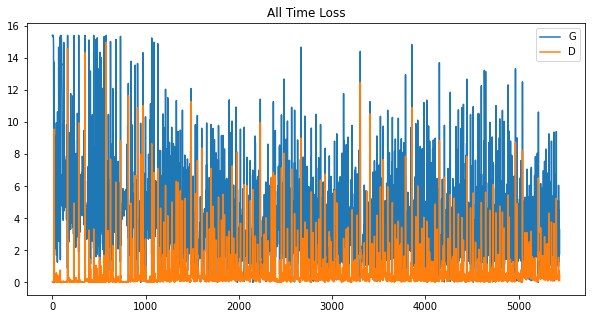

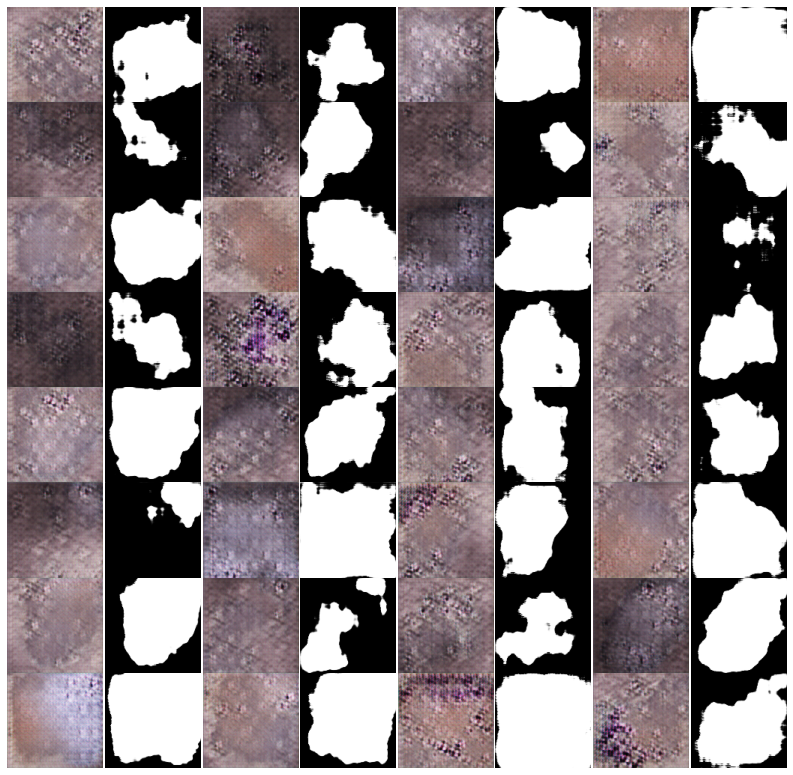





 23%|██▎       | 680/3000 [1:57:20<7:19:06, 11.36s/it]

Epoch: 680 computed for 14.240966320037842 sec
Gen_loss mean:  2.9534245  std:  0.96081656
Disc_loss mean:  0.36846226  std:  0.18647769






 23%|██▎       | 681/3000 [1:57:30<7:08:30, 11.09s/it]

Epoch: 681 computed for 10.444983005523682 sec
Gen_loss mean:  4.0969315  std:  3.3525188
Disc_loss mean:  1.041517  std:  1.7007412






 23%|██▎       | 682/3000 [1:57:41<6:58:07, 10.82s/it]

Epoch: 682 computed for 10.194881200790405 sec
Gen_loss mean:  2.7420077  std:  1.2632492
Disc_loss mean:  0.5072351  std:  0.26381943






 23%|██▎       | 683/3000 [1:57:51<6:49:07, 10.59s/it]

Epoch: 683 computed for 10.04938554763794 sec
Gen_loss mean:  2.7292218  std:  1.1205382
Disc_loss mean:  0.35545325  std:  0.24453986






 23%|██▎       | 684/3000 [1:58:01<6:44:31, 10.48s/it]

Epoch: 684 computed for 10.198870420455933 sec
Gen_loss mean:  3.2395008  std:  1.6238632
Disc_loss mean:  0.33961725  std:  0.17874236






 23%|██▎       | 685/3000 [1:58:11<6:40:31, 10.38s/it]

Epoch: 685 computed for 10.135883092880249 sec
Gen_loss mean:  3.9345093  std:  1.1083992
Disc_loss mean:  0.1303921  std:  0.11870159






 23%|██▎       | 686/3000 [1:58:21<6:37:53, 10.32s/it]

Epoch: 686 computed for 10.14974331855774 sec
Gen_loss mean:  4.381188  std:  2.6201892
Disc_loss mean:  0.6124851  std:  1.1003137






 23%|██▎       | 687/3000 [1:58:31<6:36:37, 10.29s/it]

Epoch: 687 computed for 10.20584774017334 sec
Gen_loss mean:  3.594149  std:  1.627355
Disc_loss mean:  0.4389815  std:  0.4716738






 23%|██▎       | 688/3000 [1:58:41<6:33:52, 10.22s/it]

Epoch: 688 computed for 10.04623031616211 sec
Gen_loss mean:  3.063844  std:  2.4529612
Disc_loss mean:  1.1066351  std:  1.0566021






 23%|██▎       | 689/3000 [1:58:52<6:33:14, 10.21s/it]

Epoch: 689 computed for 10.163214445114136 sec
Gen_loss mean:  2.7845042  std:  0.7452521
Disc_loss mean:  0.2472251  std:  0.1110799






 23%|██▎       | 690/3000 [1:59:02<6:31:48, 10.18s/it]

Epoch: 690 computed for 10.087146997451782 sec
Gen_loss mean:  3.567485  std:  1.5245937
Disc_loss mean:  0.26483792  std:  0.1816739






 23%|██▎       | 691/3000 [1:59:12<6:31:25, 10.17s/it]

Epoch: 691 computed for 10.143147468566895 sec
Gen_loss mean:  3.9143834  std:  2.5034707
Disc_loss mean:  1.034341  std:  1.8096896






 23%|██▎       | 692/3000 [1:59:22<6:30:32, 10.15s/it]

Epoch: 692 computed for 10.094970464706421 sec
Gen_loss mean:  2.1844172  std:  0.5863408
Disc_loss mean:  0.3437289  std:  0.1747263






 23%|██▎       | 693/3000 [1:59:32<6:29:38, 10.13s/it]

Epoch: 693 computed for 10.074254512786865 sec
Gen_loss mean:  2.7129111  std:  0.7784094
Disc_loss mean:  0.2682783  std:  0.08005406






 23%|██▎       | 694/3000 [1:59:42<6:29:59, 10.15s/it]

Epoch: 694 computed for 10.164291143417358 sec
Gen_loss mean:  3.391212  std:  0.7772009
Disc_loss mean:  0.15935802  std:  0.04309567






 23%|██▎       | 695/3000 [1:59:52<6:29:10, 10.13s/it]

Epoch: 695 computed for 10.072545766830444 sec
Gen_loss mean:  3.0709398  std:  2.4423158
Disc_loss mean:  0.69426805  std:  1.0983883






 23%|██▎       | 696/3000 [2:00:03<6:29:27, 10.14s/it]

Epoch: 696 computed for 10.155233383178711 sec
Gen_loss mean:  3.3114955  std:  1.8385153
Disc_loss mean:  0.5243657  std:  0.4600495






 23%|██▎       | 697/3000 [2:00:13<6:28:25, 10.12s/it]

Epoch: 697 computed for 10.053746700286865 sec
Gen_loss mean:  2.9453743  std:  1.7513089
Disc_loss mean:  0.5950866  std:  0.5128212






 23%|██▎       | 698/3000 [2:00:23<6:27:43, 10.11s/it]

Epoch: 698 computed for 10.058914422988892 sec
Gen_loss mean:  3.320382  std:  0.6351502
Disc_loss mean:  0.12628914  std:  0.0741689






 23%|██▎       | 699/3000 [2:00:33<6:28:19, 10.13s/it]

Epoch: 699 computed for 10.157200813293457 sec
Gen_loss mean:  4.055988  std:  2.7161603
Disc_loss mean:  1.6428928  std:  1.6821405
Saved temporary images for evaluation.
Removed temporary image directory.






 23%|██▎       | 700/3000 [2:00:48<7:26:59, 11.66s/it]

Epoch: 700 computed for 15.211744785308838 sec
Gen_loss mean:  2.0970633  std:  0.9002991
Disc_loss mean:  0.56578577  std:  0.31507537






 23%|██▎       | 701/3000 [2:00:58<7:09:08, 11.20s/it]

Epoch: 701 computed for 10.097447395324707 sec
Gen_loss mean:  2.5608687  std:  1.3650537
Disc_loss mean:  0.584321  std:  0.28834677






 23%|██▎       | 702/3000 [2:01:09<6:58:44, 10.93s/it]

Epoch: 702 computed for 10.290992975234985 sec
Gen_loss mean:  2.7922096  std:  2.3596528
Disc_loss mean:  1.1397892  std:  0.56363475






 23%|██▎       | 703/3000 [2:01:19<6:49:41, 10.70s/it]

Epoch: 703 computed for 10.144477367401123 sec
Gen_loss mean:  2.9491363  std:  2.5817935
Disc_loss mean:  0.9054271  std:  0.8625913






 23%|██▎       | 704/3000 [2:01:29<6:43:57, 10.56s/it]

Epoch: 704 computed for 10.201419591903687 sec
Gen_loss mean:  2.200901  std:  0.57314336
Disc_loss mean:  0.43361932  std:  0.13414723






 24%|██▎       | 705/3000 [2:01:39<6:38:27, 10.42s/it]

Epoch: 705 computed for 10.078680753707886 sec
Gen_loss mean:  3.0106769  std:  2.3051732
Disc_loss mean:  1.2203895  std:  0.86110777






 24%|██▎       | 706/3000 [2:01:49<6:34:56, 10.33s/it]

Epoch: 706 computed for 10.106794595718384 sec
Gen_loss mean:  2.0373402  std:  0.6369763
Disc_loss mean:  0.5018688  std:  0.20326987






 24%|██▎       | 707/3000 [2:01:59<6:32:33, 10.27s/it]

Epoch: 707 computed for 10.11764931678772 sec
Gen_loss mean:  2.915934  std:  1.9855653
Disc_loss mean:  0.8583574  std:  1.0039889






 24%|██▎       | 708/3000 [2:02:10<6:32:00, 10.26s/it]

Epoch: 708 computed for 10.227230310440063 sec
Gen_loss mean:  1.9567742  std:  0.7732411
Disc_loss mean:  0.41596437  std:  0.23856385






 24%|██▎       | 709/3000 [2:02:20<6:30:44, 10.23s/it]

Epoch: 709 computed for 10.144899845123291 sec
Gen_loss mean:  2.829568  std:  1.0156926
Disc_loss mean:  0.35746717  std:  0.26650184






 24%|██▎       | 710/3000 [2:02:30<6:29:31, 10.21s/it]

Epoch: 710 computed for 10.121733665466309 sec
Gen_loss mean:  3.0334218  std:  2.1491995
Disc_loss mean:  0.82145345  std:  1.0450362






 24%|██▎       | 711/3000 [2:02:40<6:29:30, 10.21s/it]

Epoch: 711 computed for 10.203618049621582 sec
Gen_loss mean:  2.2695305  std:  0.57739735
Disc_loss mean:  0.31903154  std:  0.09618734






 24%|██▎       | 712/3000 [2:02:50<6:29:36, 10.22s/it]

Epoch: 712 computed for 10.217022895812988 sec
Gen_loss mean:  2.6637018  std:  2.1672235
Disc_loss mean:  0.8921745  std:  0.83414125






 24%|██▍       | 713/3000 [2:03:00<6:27:53, 10.18s/it]

Epoch: 713 computed for 10.059593915939331 sec
Gen_loss mean:  2.7399762  std:  1.0272312
Disc_loss mean:  0.3948796  std:  0.14146431






 24%|██▍       | 714/3000 [2:03:11<6:27:36, 10.17s/it]

Epoch: 714 computed for 10.150492668151855 sec
Gen_loss mean:  2.370745  std:  1.5670304
Disc_loss mean:  0.7056136  std:  0.46995196






 24%|██▍       | 715/3000 [2:03:21<6:26:52, 10.16s/it]

Epoch: 715 computed for 10.109439373016357 sec
Gen_loss mean:  3.952908  std:  2.2410848
Disc_loss mean:  0.3314975  std:  0.16105664






 24%|██▍       | 716/3000 [2:03:31<6:25:48, 10.14s/it]

Epoch: 716 computed for 10.065670728683472 sec
Gen_loss mean:  3.526515  std:  1.4175467
Disc_loss mean:  0.30337706  std:  0.18033169






 24%|██▍       | 717/3000 [2:03:41<6:25:39, 10.14s/it]

Epoch: 717 computed for 10.121548175811768 sec
Gen_loss mean:  3.3436027  std:  1.3608761
Disc_loss mean:  0.33364192  std:  0.21798468






 24%|██▍       | 718/3000 [2:03:51<6:24:56, 10.12s/it]

Epoch: 718 computed for 10.073887825012207 sec
Gen_loss mean:  3.311459  std:  3.1436152
Disc_loss mean:  1.2312545  std:  2.0539393






 24%|██▍       | 719/3000 [2:04:01<6:24:28, 10.11s/it]

Epoch: 719 computed for 10.082175970077515 sec
Gen_loss mean:  2.7724736  std:  1.2536609
Disc_loss mean:  0.41859943  std:  0.16102281


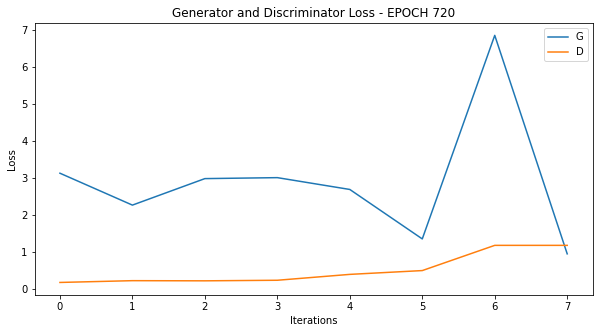

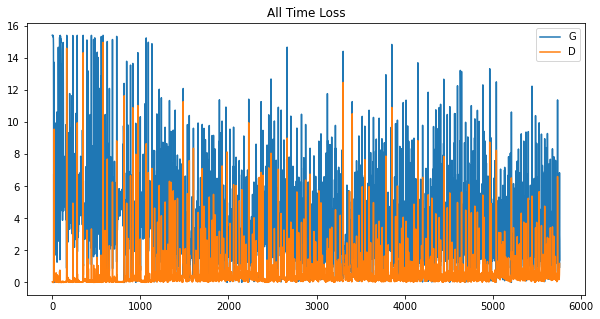

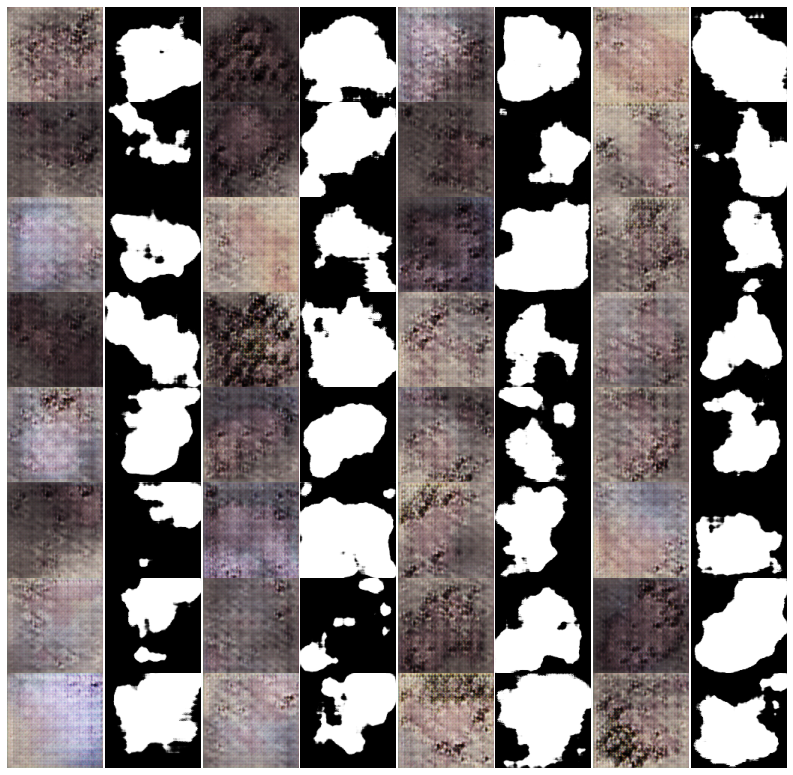





 24%|██▍       | 720/3000 [2:04:16<7:14:00, 11.42s/it]

Epoch: 720 computed for 14.441686153411865 sec
Gen_loss mean:  2.9037795  std:  1.6687313
Disc_loss mean:  0.5168998  std:  0.39624694






 24%|██▍       | 721/3000 [2:04:26<7:00:11, 11.06s/it]

Epoch: 721 computed for 10.215681076049805 sec
Gen_loss mean:  4.343002  std:  3.0577717
Disc_loss mean:  1.0106375  std:  1.0750896






 24%|██▍       | 722/3000 [2:04:36<6:49:02, 10.77s/it]

Epoch: 722 computed for 10.085686683654785 sec
Gen_loss mean:  2.8523374  std:  1.3725603
Disc_loss mean:  0.4144207  std:  0.193417






 24%|██▍       | 723/3000 [2:04:46<6:41:50, 10.59s/it]

Epoch: 723 computed for 10.141980648040771 sec
Gen_loss mean:  2.6378527  std:  0.73382753
Disc_loss mean:  0.45079356  std:  0.1387789






 24%|██▍       | 724/3000 [2:04:56<6:36:22, 10.45s/it]

Epoch: 724 computed for 10.104171514511108 sec
Gen_loss mean:  3.7357779  std:  2.40596
Disc_loss mean:  0.6223409  std:  0.59617656






 24%|██▍       | 725/3000 [2:05:06<6:32:32, 10.35s/it]

Epoch: 725 computed for 10.112011909484863 sec
Gen_loss mean:  3.355397  std:  2.1867487
Disc_loss mean:  1.1277616  std:  1.1730952






 24%|██▍       | 726/3000 [2:05:16<6:29:26, 10.28s/it]

Epoch: 726 computed for 10.081986427307129 sec
Gen_loss mean:  2.243871  std:  0.6862779
Disc_loss mean:  0.383043  std:  0.10222817






 24%|██▍       | 727/3000 [2:05:27<6:28:06, 10.24s/it]

Epoch: 727 computed for 10.158342599868774 sec
Gen_loss mean:  3.4143  std:  2.163855
Disc_loss mean:  0.37616417  std:  0.2794231






 24%|██▍       | 728/3000 [2:05:37<6:26:27, 10.21s/it]

Epoch: 728 computed for 10.09970474243164 sec
Gen_loss mean:  3.6000469  std:  2.0642269
Disc_loss mean:  0.4459868  std:  0.1666403






 24%|██▍       | 729/3000 [2:05:47<6:24:43, 10.16s/it]

Epoch: 729 computed for 10.046203374862671 sec
Gen_loss mean:  3.1642737  std:  1.8597535
Disc_loss mean:  0.66592276  std:  0.65632683






 24%|██▍       | 730/3000 [2:05:57<6:24:14, 10.16s/it]

Epoch: 730 computed for 10.121339082717896 sec
Gen_loss mean:  3.3564  std:  3.108628
Disc_loss mean:  1.435279  std:  1.9792558






 24%|██▍       | 731/3000 [2:06:07<6:23:03, 10.13s/it]

Epoch: 731 computed for 10.048655986785889 sec
Gen_loss mean:  2.3842425  std:  0.81429183
Disc_loss mean:  0.4243787  std:  0.2629173






 24%|██▍       | 732/3000 [2:06:17<6:25:00, 10.19s/it]

Epoch: 732 computed for 10.301938772201538 sec
Gen_loss mean:  2.7850761  std:  1.4005088
Disc_loss mean:  0.42622107  std:  0.2873778






 24%|██▍       | 733/3000 [2:06:27<6:24:54, 10.19s/it]

Epoch: 733 computed for 10.174787282943726 sec
Gen_loss mean:  3.7780778  std:  1.8731722
Disc_loss mean:  0.44126272  std:  0.5085877






 24%|██▍       | 734/3000 [2:06:38<6:23:33, 10.16s/it]

Epoch: 734 computed for 10.067599773406982 sec
Gen_loss mean:  3.323233  std:  1.868717
Disc_loss mean:  0.55216134  std:  0.60369575






 24%|██▍       | 735/3000 [2:06:48<6:22:12, 10.12s/it]

Epoch: 735 computed for 10.036056280136108 sec
Gen_loss mean:  2.9842997  std:  1.5345954
Disc_loss mean:  0.42863584  std:  0.2925562






 25%|██▍       | 736/3000 [2:06:58<6:22:26, 10.14s/it]

Epoch: 736 computed for 10.141238451004028 sec
Gen_loss mean:  3.450398  std:  3.0246444
Disc_loss mean:  1.2738346  std:  1.4354849






 25%|██▍       | 737/3000 [2:07:08<6:21:51, 10.12s/it]

Epoch: 737 computed for 10.084749937057495 sec
Gen_loss mean:  2.4925673  std:  0.8162819
Disc_loss mean:  0.3639471  std:  0.10582713






 25%|██▍       | 738/3000 [2:07:18<6:21:30, 10.12s/it]

Epoch: 738 computed for 10.089708805084229 sec
Gen_loss mean:  3.2972975  std:  2.0323315
Disc_loss mean:  1.3605846  std:  1.507787






 25%|██▍       | 739/3000 [2:07:28<6:21:25, 10.12s/it]

Epoch: 739 computed for 10.111125707626343 sec
Gen_loss mean:  2.0202463  std:  0.6153514
Disc_loss mean:  0.4683285  std:  0.17904328






 25%|██▍       | 740/3000 [2:07:38<6:21:58, 10.14s/it]

Epoch: 740 computed for 10.169680118560791 sec
Gen_loss mean:  2.6677012  std:  1.3956052
Disc_loss mean:  0.54543316  std:  0.26829708






 25%|██▍       | 741/3000 [2:07:48<6:21:29, 10.13s/it]

Epoch: 741 computed for 10.100118637084961 sec
Gen_loss mean:  2.9187193  std:  1.4983695
Disc_loss mean:  0.41413176  std:  0.16141067






 25%|██▍       | 742/3000 [2:07:58<6:21:06, 10.13s/it]

Epoch: 742 computed for 10.092942714691162 sec
Gen_loss mean:  3.8513987  std:  2.4441078
Disc_loss mean:  0.8169506  std:  0.8009798






 25%|██▍       | 743/3000 [2:08:09<6:20:50, 10.12s/it]

Epoch: 743 computed for 10.099825382232666 sec
Gen_loss mean:  2.7045655  std:  1.40003
Disc_loss mean:  0.51802236  std:  0.19910672






 25%|██▍       | 744/3000 [2:08:19<6:21:32, 10.15s/it]

Epoch: 744 computed for 10.186012744903564 sec
Gen_loss mean:  3.4296665  std:  0.95478976
Disc_loss mean:  0.21794751  std:  0.074010104






 25%|██▍       | 745/3000 [2:08:29<6:20:43, 10.13s/it]

Epoch: 745 computed for 10.077301263809204 sec
Gen_loss mean:  2.9641533  std:  2.743945
Disc_loss mean:  1.1295896  std:  1.3850676






 25%|██▍       | 746/3000 [2:08:39<6:20:12, 10.12s/it]

Epoch: 746 computed for 10.082427740097046 sec
Gen_loss mean:  2.860187  std:  0.8766294
Disc_loss mean:  0.33577323  std:  0.08898192






 25%|██▍       | 747/3000 [2:08:49<6:20:37, 10.14s/it]

Epoch: 747 computed for 10.158864259719849 sec
Gen_loss mean:  4.8789253  std:  3.9248953
Disc_loss mean:  1.8332138  std:  2.37219






 25%|██▍       | 748/3000 [2:08:59<6:19:51, 10.12s/it]

Epoch: 748 computed for 10.064576864242554 sec
Gen_loss mean:  2.0282269  std:  0.54071915
Disc_loss mean:  0.47250026  std:  0.20140798






 25%|██▍       | 749/3000 [2:09:09<6:19:30, 10.12s/it]

Epoch: 749 computed for 10.084722518920898 sec
Gen_loss mean:  2.1959374  std:  0.7836676
Disc_loss mean:  0.561213  std:  0.25891516
Saved temporary images for evaluation.
Removed temporary image directory.






 25%|██▌       | 750/3000 [2:09:25<7:19:04, 11.71s/it]

Epoch: 750 computed for 15.370104789733887 sec
Gen_loss mean:  2.692289  std:  1.8737533
Disc_loss mean:  0.5461819  std:  0.25689796






 25%|██▌       | 751/3000 [2:09:35<7:02:09, 11.26s/it]

Epoch: 751 computed for 10.198707103729248 sec
Gen_loss mean:  3.6136415  std:  1.5995034
Disc_loss mean:  0.44240153  std:  0.18013903






 25%|██▌       | 752/3000 [2:09:45<6:48:51, 10.91s/it]

Epoch: 752 computed for 10.08237361907959 sec
Gen_loss mean:  2.6884809  std:  1.7049316
Disc_loss mean:  0.7860724  std:  0.75837946






 25%|██▌       | 753/3000 [2:09:55<6:40:04, 10.68s/it]

Epoch: 753 computed for 10.129995822906494 sec
Gen_loss mean:  2.9033976  std:  1.9504656
Disc_loss mean:  0.88474214  std:  1.3167738






 25%|██▌       | 754/3000 [2:10:05<6:32:58, 10.50s/it]

Epoch: 754 computed for 10.05050778388977 sec
Gen_loss mean:  2.789388  std:  0.72744054
Disc_loss mean:  0.32241938  std:  0.13430737






 25%|██▌       | 755/3000 [2:10:15<6:27:55, 10.37s/it]

Epoch: 755 computed for 10.046344757080078 sec
Gen_loss mean:  3.2255275  std:  1.3661999
Disc_loss mean:  0.25694814  std:  0.10027659






 25%|██▌       | 756/3000 [2:10:26<6:25:33, 10.31s/it]

Epoch: 756 computed for 10.158166885375977 sec
Gen_loss mean:  3.9214196  std:  0.81057143
Disc_loss mean:  0.11746084  std:  0.08261675






 25%|██▌       | 757/3000 [2:10:36<6:24:47, 10.29s/it]

Epoch: 757 computed for 10.239056825637817 sec
Gen_loss mean:  4.3812466  std:  1.9378442
Disc_loss mean:  0.14392042  std:  0.061691463






 25%|██▌       | 758/3000 [2:10:46<6:22:22, 10.23s/it]

Epoch: 758 computed for 10.0789315700531 sec
Gen_loss mean:  4.484186  std:  2.5440915
Disc_loss mean:  2.1549282  std:  2.7852206






 25%|██▌       | 759/3000 [2:10:56<6:20:35, 10.19s/it]

Epoch: 759 computed for 10.072663068771362 sec
Gen_loss mean:  1.3110659  std:  0.35789278
Disc_loss mean:  0.8292569  std:  0.20205067


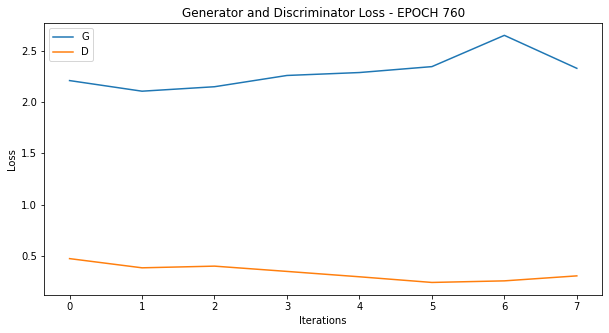

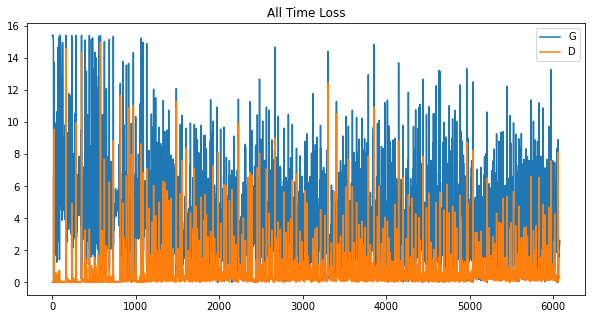

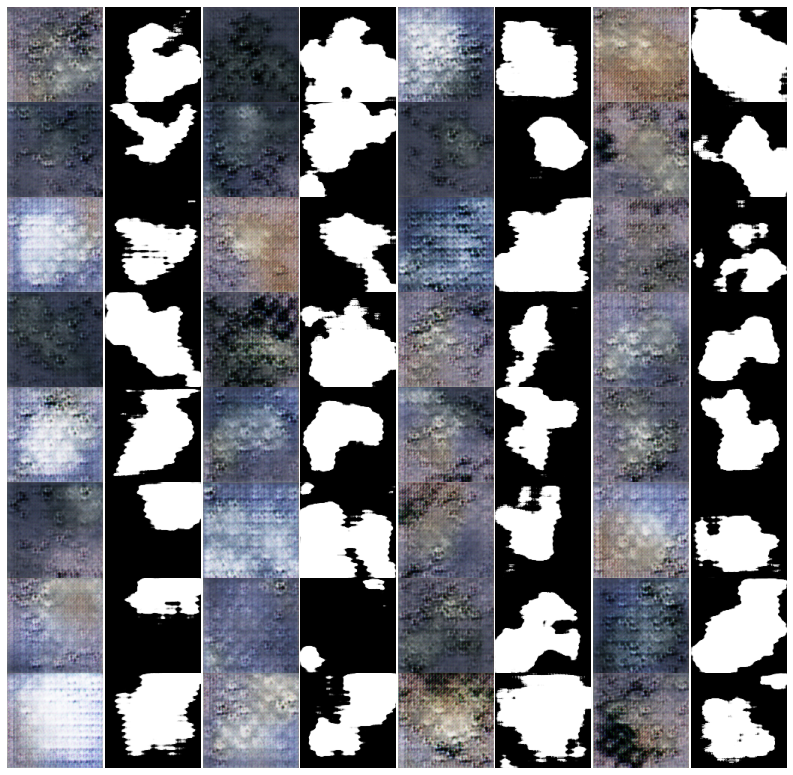





 25%|██▌       | 760/3000 [2:11:10<7:06:19, 11.42s/it]

Epoch: 760 computed for 14.256220817565918 sec
Gen_loss mean:  2.2897902  std:  0.15607259
Disc_loss mean:  0.33916062  std:  0.07340431






 25%|██▌       | 761/3000 [2:11:21<6:55:00, 11.12s/it]

Epoch: 761 computed for 10.414583206176758 sec
Gen_loss mean:  1.7989228  std:  1.6975851
Disc_loss mean:  1.3410065  std:  0.90573734






 25%|██▌       | 762/3000 [2:11:31<6:46:36, 10.90s/it]

Epoch: 762 computed for 10.371896743774414 sec
Gen_loss mean:  1.8523166  std:  0.36099988
Disc_loss mean:  0.48159903  std:  0.13133359






 25%|██▌       | 763/3000 [2:11:41<6:38:26, 10.69s/it]

Epoch: 763 computed for 10.16645860671997 sec
Gen_loss mean:  1.721257  std:  0.6716115
Disc_loss mean:  0.90929097  std:  0.4436763






 25%|██▌       | 764/3000 [2:11:51<6:32:30, 10.53s/it]

Epoch: 764 computed for 10.154984474182129 sec
Gen_loss mean:  2.7632692  std:  2.1470375
Disc_loss mean:  0.8358  std:  0.8051286






 26%|██▌       | 765/3000 [2:12:02<6:27:47, 10.41s/it]

Epoch: 765 computed for 10.113374710083008 sec
Gen_loss mean:  2.0931032  std:  0.57939357
Disc_loss mean:  0.40076494  std:  0.17695312






 26%|██▌       | 766/3000 [2:12:12<6:24:58, 10.34s/it]

Epoch: 766 computed for 10.15518307685852 sec
Gen_loss mean:  2.4278622  std:  1.1103985
Disc_loss mean:  0.68372995  std:  0.4232445






 26%|██▌       | 767/3000 [2:12:22<6:22:36, 10.28s/it]

Epoch: 767 computed for 10.126867532730103 sec
Gen_loss mean:  2.4051552  std:  0.6275542
Disc_loss mean:  0.30719596  std:  0.08777319






 26%|██▌       | 768/3000 [2:12:32<6:21:03, 10.24s/it]

Epoch: 768 computed for 10.14174747467041 sec
Gen_loss mean:  2.7820568  std:  2.1824918
Disc_loss mean:  0.7542478  std:  0.54994875






 26%|██▌       | 769/3000 [2:12:42<6:20:22, 10.23s/it]

Epoch: 769 computed for 10.179109334945679 sec
Gen_loss mean:  2.352742  std:  0.83715844
Disc_loss mean:  0.41542846  std:  0.25506702






 26%|██▌       | 770/3000 [2:12:52<6:18:37, 10.19s/it]

Epoch: 770 computed for 10.074862480163574 sec
Gen_loss mean:  3.4396992  std:  1.837877
Disc_loss mean:  0.5379758  std:  0.50883013






 26%|██▌       | 771/3000 [2:13:03<6:18:48, 10.20s/it]

Epoch: 771 computed for 10.203439712524414 sec
Gen_loss mean:  2.9418356  std:  1.0646827
Disc_loss mean:  0.28305715  std:  0.18776429






 26%|██▌       | 772/3000 [2:13:13<6:17:56, 10.18s/it]

Epoch: 772 computed for 10.119853496551514 sec
Gen_loss mean:  2.7081826  std:  2.0412428
Disc_loss mean:  1.1598742  std:  0.9370564






 26%|██▌       | 773/3000 [2:13:23<6:18:07, 10.19s/it]

Epoch: 773 computed for 10.19560956954956 sec
Gen_loss mean:  2.2194471  std:  0.51229864
Disc_loss mean:  0.3519157  std:  0.11344692






 26%|██▌       | 774/3000 [2:13:33<6:17:56, 10.19s/it]

Epoch: 774 computed for 10.168943166732788 sec
Gen_loss mean:  2.3940456  std:  1.7632141
Disc_loss mean:  1.1054873  std:  0.85263544






 26%|██▌       | 775/3000 [2:13:43<6:17:39, 10.18s/it]

Epoch: 775 computed for 10.162624597549438 sec
Gen_loss mean:  2.481119  std:  0.63913506
Disc_loss mean:  0.43843734  std:  0.18052758






 26%|██▌       | 776/3000 [2:13:53<6:17:15, 10.18s/it]

Epoch: 776 computed for 10.14826226234436 sec
Gen_loss mean:  3.1155453  std:  1.8044015
Disc_loss mean:  0.6813872  std:  0.49458167






 26%|██▌       | 777/3000 [2:14:04<6:16:17, 10.16s/it]

Epoch: 777 computed for 10.088513851165771 sec
Gen_loss mean:  2.79112  std:  2.8075466
Disc_loss mean:  1.003004  std:  1.1802022






 26%|██▌       | 778/3000 [2:14:14<6:16:07, 10.16s/it]

Epoch: 778 computed for 10.13811707496643 sec
Gen_loss mean:  2.503641  std:  0.49466136
Disc_loss mean:  0.29165658  std:  0.06316282






 26%|██▌       | 779/3000 [2:14:24<6:15:06, 10.13s/it]

Epoch: 779 computed for 10.065704584121704 sec
Gen_loss mean:  2.8464892  std:  1.751613
Disc_loss mean:  0.6708644  std:  0.61520773






 26%|██▌       | 780/3000 [2:14:34<6:15:36, 10.15s/it]

Epoch: 780 computed for 10.178815364837646 sec
Gen_loss mean:  2.7019405  std:  2.3629174
Disc_loss mean:  0.7767885  std:  0.6704433






 26%|██▌       | 781/3000 [2:14:44<6:15:52, 10.16s/it]

Epoch: 781 computed for 10.172566413879395 sec
Gen_loss mean:  2.9049902  std:  1.0178477
Disc_loss mean:  0.34618026  std:  0.15959221






 26%|██▌       | 782/3000 [2:14:54<6:15:21, 10.15s/it]

Epoch: 782 computed for 10.116718053817749 sec
Gen_loss mean:  3.7374177  std:  2.8139064
Disc_loss mean:  0.6463322  std:  0.60182977






 26%|██▌       | 783/3000 [2:15:04<6:15:00, 10.15s/it]

Epoch: 783 computed for 10.122625350952148 sec
Gen_loss mean:  2.3480573  std:  1.1233616
Disc_loss mean:  0.48100567  std:  0.2763534






 26%|██▌       | 784/3000 [2:15:15<6:14:39, 10.14s/it]

Epoch: 784 computed for 10.119450569152832 sec
Gen_loss mean:  3.0863743  std:  1.4850006
Disc_loss mean:  0.36843312  std:  0.28060254






 26%|██▌       | 785/3000 [2:15:25<6:14:01, 10.13s/it]

Epoch: 785 computed for 10.087360382080078 sec
Gen_loss mean:  3.752431  std:  3.4091294
Disc_loss mean:  0.7862541  std:  1.0152447






 26%|██▌       | 786/3000 [2:15:35<6:13:56, 10.13s/it]

Epoch: 786 computed for 10.126456499099731 sec
Gen_loss mean:  3.2043161  std:  2.5643187
Disc_loss mean:  1.2526196  std:  1.3343569






 26%|██▌       | 787/3000 [2:15:45<6:13:19, 10.12s/it]

Epoch: 787 computed for 10.07704782485962 sec
Gen_loss mean:  2.3712876  std:  1.0225694
Disc_loss mean:  0.41396713  std:  0.19882722






 26%|██▋       | 788/3000 [2:15:55<6:13:25, 10.13s/it]

Epoch: 788 computed for 10.131936311721802 sec
Gen_loss mean:  2.948821  std:  1.8139522
Disc_loss mean:  0.55189645  std:  0.25210705






 26%|██▋       | 789/3000 [2:16:05<6:12:45, 10.12s/it]

Epoch: 789 computed for 10.068034172058105 sec
Gen_loss mean:  3.4434733  std:  1.3040018
Disc_loss mean:  0.3663777  std:  0.18039854






 26%|██▋       | 790/3000 [2:16:15<6:11:47, 10.09s/it]

Epoch: 790 computed for 10.030636310577393 sec
Gen_loss mean:  4.007299  std:  2.8522143
Disc_loss mean:  1.3637263  std:  1.4769228






 26%|██▋       | 791/3000 [2:16:25<6:12:25, 10.12s/it]

Epoch: 791 computed for 10.152010202407837 sec
Gen_loss mean:  2.1923983  std:  0.40886453
Disc_loss mean:  0.39653635  std:  0.096179165






 26%|██▋       | 792/3000 [2:16:36<6:12:59, 10.14s/it]

Epoch: 792 computed for 10.162374019622803 sec
Gen_loss mean:  2.3918986  std:  1.962335
Disc_loss mean:  0.9587841  std:  0.7966154






 26%|██▋       | 793/3000 [2:16:46<6:13:50, 10.16s/it]

Epoch: 793 computed for 10.21253776550293 sec
Gen_loss mean:  2.559171  std:  1.254851
Disc_loss mean:  0.56622624  std:  0.36180043






 26%|██▋       | 794/3000 [2:16:56<6:13:55, 10.17s/it]

Epoch: 794 computed for 10.166794300079346 sec
Gen_loss mean:  2.7767963  std:  1.8990324
Disc_loss mean:  0.9853631  std:  0.62719506






 26%|██▋       | 795/3000 [2:17:06<6:12:41, 10.14s/it]

Epoch: 795 computed for 10.057547092437744 sec
Gen_loss mean:  2.5168655  std:  0.9889245
Disc_loss mean:  0.4322918  std:  0.16614743






 27%|██▋       | 796/3000 [2:17:16<6:13:03, 10.16s/it]

Epoch: 796 computed for 10.176511764526367 sec
Gen_loss mean:  4.5568113  std:  2.0987792
Disc_loss mean:  0.23694451  std:  0.10742766






 27%|██▋       | 797/3000 [2:17:26<6:13:08, 10.16s/it]

Epoch: 797 computed for 10.164810180664062 sec
Gen_loss mean:  3.256558  std:  3.1244273
Disc_loss mean:  1.639692  std:  1.1562288






 27%|██▋       | 798/3000 [2:17:36<6:12:40, 10.15s/it]

Epoch: 798 computed for 10.118313074111938 sec
Gen_loss mean:  2.5433834  std:  0.89879775
Disc_loss mean:  0.44739643  std:  0.20151064






 27%|██▋       | 799/3000 [2:17:47<6:13:05, 10.17s/it]

Epoch: 799 computed for 10.191195964813232 sec
Gen_loss mean:  2.4429371  std:  1.1901945
Disc_loss mean:  0.49056262  std:  0.18304528


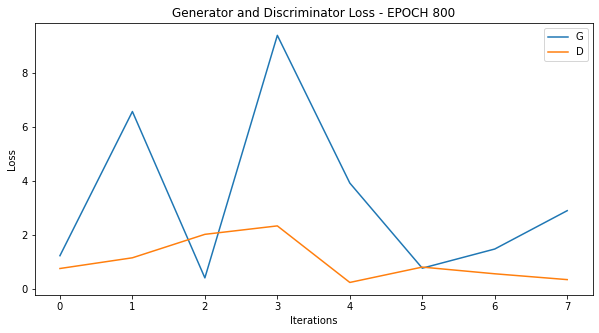

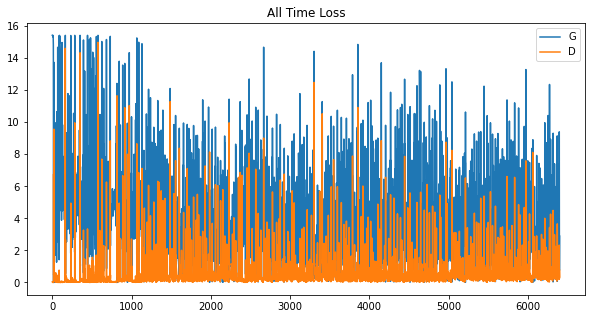

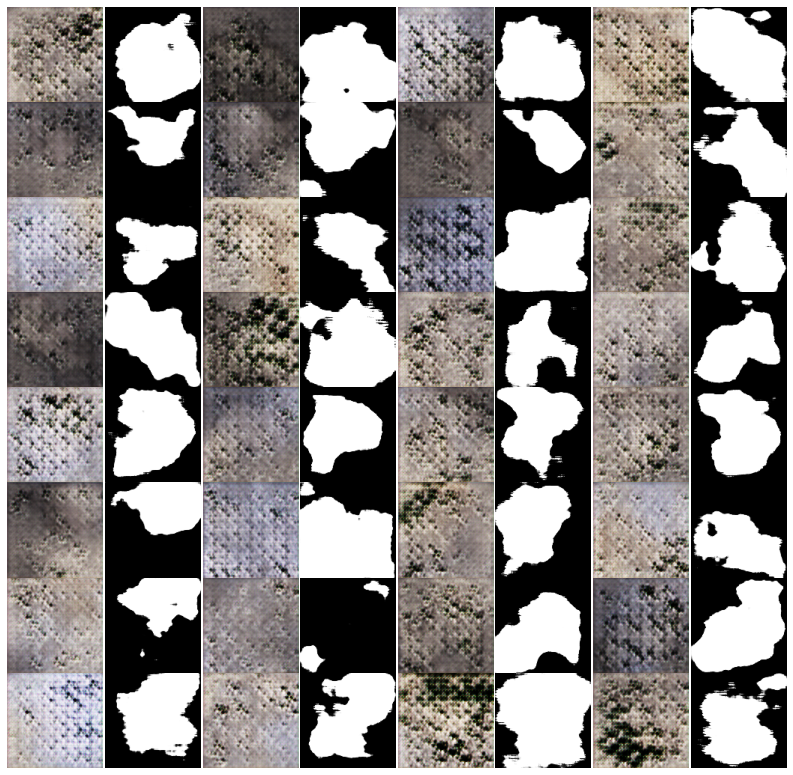

Saved temporary images for evaluation.
Removed temporary image directory.






 27%|██▋       | 800/3000 [2:18:07<8:01:31, 13.13s/it]

Epoch: 800 computed for 20.012452125549316 sec
Gen_loss mean:  3.3302531  std:  2.9792075
Disc_loss mean:  1.0194709  std:  0.72073936






 27%|██▋       | 801/3000 [2:18:17<7:29:58, 12.28s/it]

Epoch: 801 computed for 10.25136137008667 sec
Gen_loss mean:  2.6018958  std:  1.242863
Disc_loss mean:  0.5570015  std:  0.156448






 27%|██▋       | 802/3000 [2:18:27<7:06:09, 11.63s/it]

Epoch: 802 computed for 10.11502742767334 sec
Gen_loss mean:  3.3832295  std:  2.2061493
Disc_loss mean:  0.5418211  std:  0.36883557






 27%|██▋       | 803/3000 [2:18:37<6:50:11, 11.20s/it]

Epoch: 803 computed for 10.181341409683228 sec
Gen_loss mean:  3.0436904  std:  1.7390343
Disc_loss mean:  0.64856434  std:  0.48420805






 27%|██▋       | 804/3000 [2:18:47<6:37:43, 10.87s/it]

Epoch: 804 computed for 10.068543195724487 sec
Gen_loss mean:  3.4978886  std:  2.445915
Disc_loss mean:  0.96739274  std:  1.4207623






 27%|██▋       | 805/3000 [2:18:58<6:29:33, 10.65s/it]

Epoch: 805 computed for 10.123638391494751 sec
Gen_loss mean:  2.4825833  std:  0.7910046
Disc_loss mean:  0.24823661  std:  0.12991984






 27%|██▋       | 806/3000 [2:19:08<6:23:53, 10.50s/it]

Epoch: 806 computed for 10.133366346359253 sec
Gen_loss mean:  2.4176712  std:  0.7447098
Disc_loss mean:  0.3804653  std:  0.15014382






 27%|██▋       | 807/3000 [2:19:18<6:20:21, 10.41s/it]

Epoch: 807 computed for 10.176567316055298 sec
Gen_loss mean:  3.4743555  std:  2.25678
Disc_loss mean:  1.576524  std:  1.7036964






 27%|██▋       | 808/3000 [2:19:28<6:17:04, 10.32s/it]

Epoch: 808 computed for 10.101077318191528 sec
Gen_loss mean:  2.2609653  std:  0.98163015
Disc_loss mean:  0.5882144  std:  0.33031747






 27%|██▋       | 809/3000 [2:19:38<6:14:42, 10.26s/it]

Epoch: 809 computed for 10.107585906982422 sec
Gen_loss mean:  2.58517  std:  1.5881432
Disc_loss mean:  0.62138414  std:  0.3125926






 27%|██▋       | 810/3000 [2:19:48<6:14:12, 10.25s/it]

Epoch: 810 computed for 10.217267274856567 sec
Gen_loss mean:  2.937486  std:  2.10264
Disc_loss mean:  0.87739915  std:  1.0721276






 27%|██▋       | 811/3000 [2:19:58<6:12:17, 10.20s/it]

Epoch: 811 computed for 10.077450037002563 sec
Gen_loss mean:  2.311933  std:  0.41882244
Disc_loss mean:  0.30901575  std:  0.047532346






 27%|██▋       | 812/3000 [2:20:09<6:12:02, 10.20s/it]

Epoch: 812 computed for 10.181654930114746 sec
Gen_loss mean:  3.0449467  std:  1.3537134
Disc_loss mean:  0.32563627  std:  0.24929397






 27%|██▋       | 813/3000 [2:20:19<6:10:46, 10.17s/it]

Epoch: 813 computed for 10.088688850402832 sec
Gen_loss mean:  3.1735263  std:  2.2053547
Disc_loss mean:  1.310745  std:  1.5438985






 27%|██▋       | 814/3000 [2:20:29<6:10:04, 10.16s/it]

Epoch: 814 computed for 10.109756231307983 sec
Gen_loss mean:  1.9052566  std:  0.4216106
Disc_loss mean:  0.44123065  std:  0.12699938






 27%|██▋       | 815/3000 [2:20:39<6:09:16, 10.14s/it]

Epoch: 815 computed for 10.084780931472778 sec
Gen_loss mean:  2.6022346  std:  0.6404077
Disc_loss mean:  0.31195888  std:  0.15022087






 27%|██▋       | 816/3000 [2:20:49<6:08:39, 10.13s/it]

Epoch: 816 computed for 10.083395719528198 sec
Gen_loss mean:  3.101099  std:  1.4610426
Disc_loss mean:  0.36295962  std:  0.1813276






 27%|██▋       | 817/3000 [2:20:59<6:08:44, 10.13s/it]

Epoch: 817 computed for 10.133806228637695 sec
Gen_loss mean:  3.5831652  std:  3.076646
Disc_loss mean:  1.0947361  std:  0.88869554






 27%|██▋       | 818/3000 [2:21:09<6:08:05, 10.12s/it]

Epoch: 818 computed for 10.07516074180603 sec
Gen_loss mean:  2.372397  std:  0.7621473
Disc_loss mean:  0.45742196  std:  0.14355384






 27%|██▋       | 819/3000 [2:21:19<6:08:01, 10.12s/it]

Epoch: 819 computed for 10.1171875 sec
Gen_loss mean:  2.8119652  std:  1.841818
Disc_loss mean:  0.70245934  std:  0.5237457






 27%|██▋       | 820/3000 [2:21:30<6:08:01, 10.13s/it]

Epoch: 820 computed for 10.125602006912231 sec
Gen_loss mean:  2.9817955  std:  0.8945758
Disc_loss mean:  0.20983577  std:  0.10788567






 27%|██▋       | 821/3000 [2:21:40<6:08:42, 10.15s/it]

Epoch: 821 computed for 10.194380521774292 sec
Gen_loss mean:  3.416288  std:  1.5430787
Disc_loss mean:  0.30469763  std:  0.12447498






 27%|██▋       | 822/3000 [2:21:50<6:10:22, 10.20s/it]

Epoch: 822 computed for 10.298712253570557 sec
Gen_loss mean:  5.23001  std:  2.9380782
Disc_loss mean:  1.2063448  std:  1.2436447






 27%|██▋       | 823/3000 [2:22:00<6:09:18, 10.18s/it]

Epoch: 823 computed for 10.103941917419434 sec
Gen_loss mean:  2.4000287  std:  0.7425655
Disc_loss mean:  0.3295173  std:  0.18894136






 27%|██▋       | 824/3000 [2:22:10<6:08:43, 10.17s/it]

Epoch: 824 computed for 10.122419834136963 sec
Gen_loss mean:  2.1128197  std:  0.836559
Disc_loss mean:  0.5377202  std:  0.12107673






 28%|██▊       | 825/3000 [2:22:21<6:08:57, 10.18s/it]

Epoch: 825 computed for 10.189513921737671 sec
Gen_loss mean:  3.3823686  std:  1.7616365
Disc_loss mean:  0.42459345  std:  0.16770358






 28%|██▊       | 826/3000 [2:22:31<6:07:57, 10.16s/it]

Epoch: 826 computed for 10.087311029434204 sec
Gen_loss mean:  4.1272798  std:  4.07022
Disc_loss mean:  1.4959823  std:  2.0120816






 28%|██▊       | 827/3000 [2:22:41<6:07:23, 10.14s/it]

Epoch: 827 computed for 10.104431867599487 sec
Gen_loss mean:  2.1307335  std:  0.65702033
Disc_loss mean:  0.44492415  std:  0.09470532






 28%|██▊       | 828/3000 [2:22:51<6:07:16, 10.15s/it]

Epoch: 828 computed for 10.136965990066528 sec
Gen_loss mean:  2.3331354  std:  0.7178002
Disc_loss mean:  0.4435804  std:  0.15853465






 28%|██▊       | 829/3000 [2:23:01<6:07:53, 10.17s/it]

Epoch: 829 computed for 10.204298973083496 sec
Gen_loss mean:  2.9954057  std:  2.2413683
Disc_loss mean:  1.2870003  std:  0.8935437






 28%|██▊       | 830/3000 [2:23:11<6:06:46, 10.14s/it]

Epoch: 830 computed for 10.065272092819214 sec
Gen_loss mean:  2.4120226  std:  1.3944315
Disc_loss mean:  0.56974345  std:  0.28770614






 28%|██▊       | 831/3000 [2:23:22<6:07:32, 10.17s/it]

Epoch: 831 computed for 10.213997602462769 sec
Gen_loss mean:  3.5767326  std:  0.9865293
Disc_loss mean:  0.28621978  std:  0.2856947






 28%|██▊       | 832/3000 [2:23:32<6:08:08, 10.19s/it]

Epoch: 832 computed for 10.22159481048584 sec
Gen_loss mean:  3.3135326  std:  1.5554527
Disc_loss mean:  0.3730544  std:  0.45517814






 28%|██▊       | 833/3000 [2:23:42<6:08:14, 10.20s/it]

Epoch: 833 computed for 10.19551134109497 sec
Gen_loss mean:  3.3313832  std:  2.4727478
Disc_loss mean:  0.65271187  std:  0.6043798






 28%|██▊       | 834/3000 [2:23:52<6:08:04, 10.20s/it]

Epoch: 834 computed for 10.180083751678467 sec
Gen_loss mean:  3.6980796  std:  2.4709013
Disc_loss mean:  0.6373043  std:  0.5565516






 28%|██▊       | 835/3000 [2:24:02<6:07:28, 10.18s/it]

Epoch: 835 computed for 10.14322805404663 sec
Gen_loss mean:  2.9913874  std:  0.80158746
Disc_loss mean:  0.26628906  std:  0.075151816






 28%|██▊       | 836/3000 [2:24:12<6:06:39, 10.17s/it]

Epoch: 836 computed for 10.108248472213745 sec
Gen_loss mean:  3.482266  std:  2.5407789
Disc_loss mean:  0.75753504  std:  0.648639






 28%|██▊       | 837/3000 [2:24:23<6:06:44, 10.17s/it]

Epoch: 837 computed for 10.17720890045166 sec
Gen_loss mean:  3.2416444  std:  0.3411776
Disc_loss mean:  0.17002125  std:  0.08406933






 28%|██▊       | 838/3000 [2:24:33<6:05:46, 10.15s/it]

Epoch: 838 computed for 10.08510947227478 sec
Gen_loss mean:  3.6393065  std:  3.1638865
Disc_loss mean:  1.2180241  std:  1.7270775






 28%|██▊       | 839/3000 [2:24:43<6:05:37, 10.15s/it]

Epoch: 839 computed for 10.139153242111206 sec
Gen_loss mean:  2.5367067  std:  0.43450007
Disc_loss mean:  0.29889002  std:  0.054879785


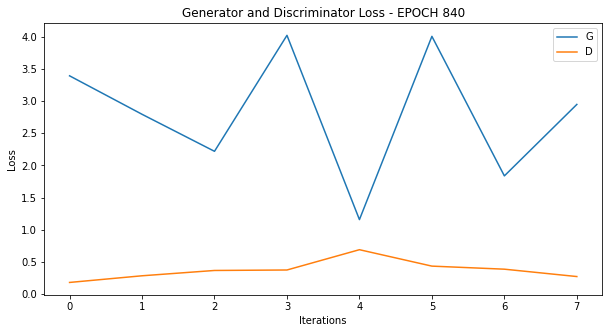

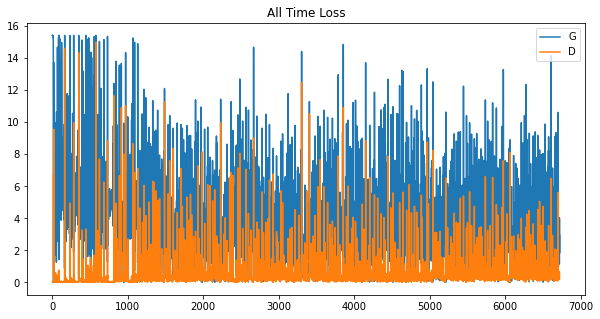

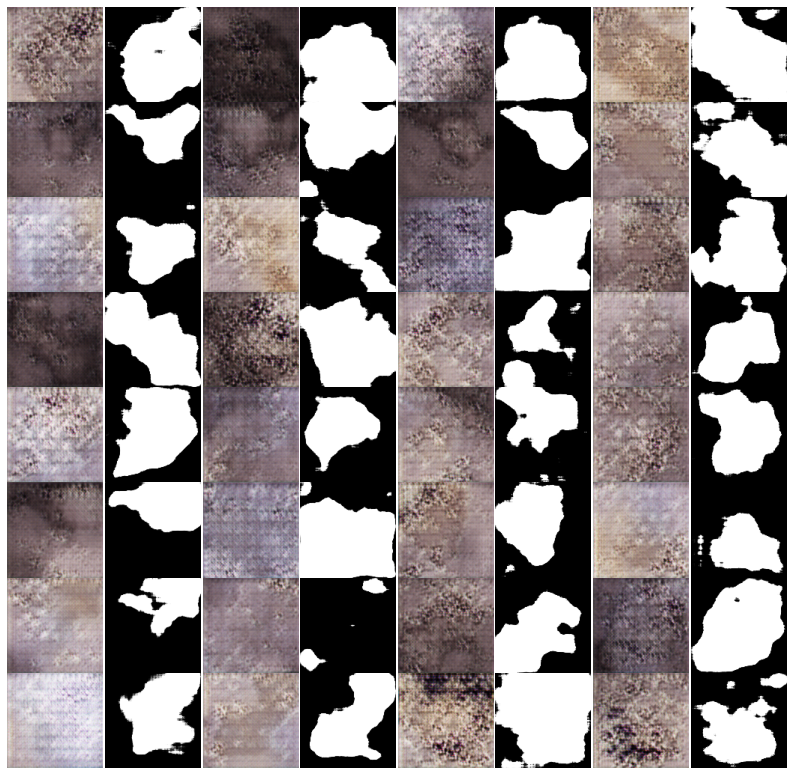





 28%|██▊       | 840/3000 [2:24:57<6:50:48, 11.41s/it]

Epoch: 840 computed for 14.321020364761353 sec
Gen_loss mean:  2.7975488  std:  0.9550845
Disc_loss mean:  0.37155926  std:  0.14128284






 28%|██▊       | 841/3000 [2:25:07<6:38:03, 11.06s/it]

Epoch: 841 computed for 10.23479413986206 sec
Gen_loss mean:  3.8667004  std:  1.7198819
Disc_loss mean:  0.31211317  std:  0.23880537






 28%|██▊       | 842/3000 [2:25:18<6:28:23, 10.80s/it]

Epoch: 842 computed for 10.169997692108154 sec
Gen_loss mean:  4.492526  std:  3.032806
Disc_loss mean:  1.3443232  std:  1.2667269






 28%|██▊       | 843/3000 [2:25:28<6:20:36, 10.59s/it]

Epoch: 843 computed for 10.078840970993042 sec
Gen_loss mean:  1.8991458  std:  0.40018705
Disc_loss mean:  0.4406674  std:  0.096334495






 28%|██▊       | 844/3000 [2:25:38<6:14:49, 10.43s/it]

Epoch: 844 computed for 10.03871750831604 sec
Gen_loss mean:  2.4680696  std:  1.077039
Disc_loss mean:  0.54666454  std:  0.21447165






 28%|██▊       | 845/3000 [2:25:48<6:11:43, 10.35s/it]

Epoch: 845 computed for 10.146416425704956 sec
Gen_loss mean:  2.8506913  std:  2.2573328
Disc_loss mean:  0.79493725  std:  0.73918223






 28%|██▊       | 846/3000 [2:25:58<6:08:54, 10.28s/it]

Epoch: 846 computed for 10.086816310882568 sec
Gen_loss mean:  3.0209343  std:  1.4370811
Disc_loss mean:  0.39574063  std:  0.171314






 28%|██▊       | 847/3000 [2:26:08<6:07:25, 10.24s/it]

Epoch: 847 computed for 10.140403032302856 sec
Gen_loss mean:  3.8147292  std:  2.0865142
Disc_loss mean:  0.46747142  std:  0.3237397






 28%|██▊       | 848/3000 [2:26:18<6:05:43, 10.20s/it]

Epoch: 848 computed for 10.082810640335083 sec
Gen_loss mean:  4.1124973  std:  2.369561
Disc_loss mean:  0.6409379  std:  1.10361






 28%|██▊       | 849/3000 [2:26:28<6:04:54, 10.18s/it]

Epoch: 849 computed for 10.11899471282959 sec
Gen_loss mean:  2.7137098  std:  1.8619425
Disc_loss mean:  1.0071167  std:  0.9613118
Saved temporary images for evaluation.
Removed temporary image directory.






 28%|██▊       | 850/3000 [2:26:44<7:00:45, 11.74s/it]

Epoch: 850 computed for 15.351796865463257 sec
Gen_loss mean:  2.3122313  std:  1.1167694
Disc_loss mean:  0.6630216  std:  0.49266016






 28%|██▊       | 851/3000 [2:26:54<6:43:55, 11.28s/it]

Epoch: 851 computed for 10.180216073989868 sec
Gen_loss mean:  2.6265626  std:  0.95918393
Disc_loss mean:  0.46270528  std:  0.18051925






 28%|██▊       | 852/3000 [2:27:04<6:33:38, 11.00s/it]

Epoch: 852 computed for 10.318705081939697 sec
Gen_loss mean:  3.6082625  std:  2.1086133
Disc_loss mean:  0.6550467  std:  0.5220916






 28%|██▊       | 853/3000 [2:27:15<6:24:00, 10.73s/it]

Epoch: 853 computed for 10.100801944732666 sec
Gen_loss mean:  2.342554  std:  0.33207572
Disc_loss mean:  0.30959114  std:  0.114903346






 28%|██▊       | 854/3000 [2:27:25<6:17:40, 10.56s/it]

Epoch: 854 computed for 10.13952112197876 sec
Gen_loss mean:  2.5527687  std:  1.7015557
Disc_loss mean:  0.67585635  std:  0.7561619






 28%|██▊       | 855/3000 [2:27:35<6:12:31, 10.42s/it]

Epoch: 855 computed for 10.083831310272217 sec
Gen_loss mean:  2.70954  std:  1.8216714
Disc_loss mean:  0.9465163  std:  1.0790114






 29%|██▊       | 856/3000 [2:27:45<6:10:02, 10.36s/it]

Epoch: 856 computed for 10.188405275344849 sec
Gen_loss mean:  2.3846736  std:  0.58005834
Disc_loss mean:  0.32894015  std:  0.12566257






 29%|██▊       | 857/3000 [2:27:55<6:07:56, 10.30s/it]

Epoch: 857 computed for 10.154964447021484 sec
Gen_loss mean:  2.7123246  std:  0.90619236
Disc_loss mean:  0.3531839  std:  0.12110434






 29%|██▊       | 858/3000 [2:28:05<6:05:44, 10.24s/it]

Epoch: 858 computed for 10.09425973892212 sec
Gen_loss mean:  3.0109272  std:  2.2241771
Disc_loss mean:  0.6553345  std:  0.5756838






 29%|██▊       | 859/3000 [2:28:15<6:04:32, 10.22s/it]

Epoch: 859 computed for 10.135373592376709 sec
Gen_loss mean:  3.1437244  std:  1.9922311
Disc_loss mean:  0.5352037  std:  0.1528099






 29%|██▊       | 860/3000 [2:28:26<6:03:06, 10.18s/it]

Epoch: 860 computed for 10.081849098205566 sec
Gen_loss mean:  2.9294138  std:  1.4920571
Disc_loss mean:  0.82373124  std:  1.2833546






 29%|██▊       | 861/3000 [2:28:36<6:02:06, 10.16s/it]

Epoch: 861 computed for 10.085795640945435 sec
Gen_loss mean:  3.2536864  std:  3.3801877
Disc_loss mean:  1.5175251  std:  1.6257253






 29%|██▊       | 862/3000 [2:28:46<6:02:19, 10.17s/it]

Epoch: 862 computed for 10.173139095306396 sec
Gen_loss mean:  1.9206077  std:  0.27820247
Disc_loss mean:  0.52004635  std:  0.15280633






 29%|██▉       | 863/3000 [2:28:56<6:01:29, 10.15s/it]

Epoch: 863 computed for 10.090185165405273 sec
Gen_loss mean:  2.6397386  std:  1.9382069
Disc_loss mean:  1.3925276  std:  1.5239751






 29%|██▉       | 864/3000 [2:29:06<6:01:17, 10.15s/it]

Epoch: 864 computed for 10.128262281417847 sec
Gen_loss mean:  1.9278007  std:  0.2938717
Disc_loss mean:  0.43889892  std:  0.061356816






 29%|██▉       | 865/3000 [2:29:16<6:00:25, 10.13s/it]

Epoch: 865 computed for 10.066797256469727 sec
Gen_loss mean:  2.8790383  std:  0.7861648
Disc_loss mean:  0.2907006  std:  0.11348676






 29%|██▉       | 866/3000 [2:29:26<6:00:08, 10.13s/it]

Epoch: 866 computed for 10.103403091430664 sec
Gen_loss mean:  3.1057281  std:  2.8409197
Disc_loss mean:  1.2057204  std:  1.1307074






 29%|██▉       | 867/3000 [2:29:36<5:59:50, 10.12s/it]

Epoch: 867 computed for 10.096699714660645 sec
Gen_loss mean:  2.1845627  std:  0.44417173
Disc_loss mean:  0.38704115  std:  0.08698891






 29%|██▉       | 868/3000 [2:29:46<5:58:57, 10.10s/it]

Epoch: 868 computed for 10.042802333831787 sec
Gen_loss mean:  3.4685886  std:  2.3460023
Disc_loss mean:  0.86464727  std:  0.6822812






 29%|██▉       | 869/3000 [2:29:57<5:59:35, 10.12s/it]

Epoch: 869 computed for 10.156028270721436 sec
Gen_loss mean:  2.2454224  std:  0.54424006
Disc_loss mean:  0.28889316  std:  0.117507376






 29%|██▉       | 870/3000 [2:30:07<5:59:00, 10.11s/it]

Epoch: 870 computed for 10.07200837135315 sec
Gen_loss mean:  3.0175934  std:  1.3442919
Disc_loss mean:  0.44036365  std:  0.37593016






 29%|██▉       | 871/3000 [2:30:17<5:58:27, 10.10s/it]

Epoch: 871 computed for 10.057255983352661 sec
Gen_loss mean:  3.4707243  std:  2.3398547
Disc_loss mean:  1.1825397  std:  1.2699683






 29%|██▉       | 872/3000 [2:30:27<5:58:33, 10.11s/it]

Epoch: 872 computed for 10.11060380935669 sec
Gen_loss mean:  2.269952  std:  0.46618453
Disc_loss mean:  0.29810753  std:  0.13060923






 29%|██▉       | 873/3000 [2:30:37<5:58:17, 10.11s/it]

Epoch: 873 computed for 10.085753679275513 sec
Gen_loss mean:  2.8165364  std:  0.8856026
Disc_loss mean:  0.38286442  std:  0.14206982






 29%|██▉       | 874/3000 [2:30:47<5:58:20, 10.11s/it]

Epoch: 874 computed for 10.110634803771973 sec
Gen_loss mean:  3.0717387  std:  2.2958734
Disc_loss mean:  0.7256156  std:  0.7505285






 29%|██▉       | 875/3000 [2:30:57<5:58:34, 10.12s/it]

Epoch: 875 computed for 10.136140584945679 sec
Gen_loss mean:  2.9488916  std:  1.0215728
Disc_loss mean:  0.32545123  std:  0.14448404






 29%|██▉       | 876/3000 [2:31:07<5:57:53, 10.11s/it]

Epoch: 876 computed for 10.052397966384888 sec
Gen_loss mean:  4.0840354  std:  3.1669674
Disc_loss mean:  0.9203201  std:  0.9957944






 29%|██▉       | 877/3000 [2:31:17<5:58:02, 10.12s/it]

Epoch: 877 computed for 10.125733375549316 sec
Gen_loss mean:  2.854813  std:  0.6725098
Disc_loss mean:  0.2360614  std:  0.08406999






 29%|██▉       | 878/3000 [2:31:28<5:57:36, 10.11s/it]

Epoch: 878 computed for 10.080194473266602 sec
Gen_loss mean:  3.494142  std:  2.1478949
Disc_loss mean:  0.65344  std:  0.48914987






 29%|██▉       | 879/3000 [2:31:38<5:57:47, 10.12s/it]

Epoch: 879 computed for 10.129696607589722 sec
Gen_loss mean:  2.755906  std:  1.9869525
Disc_loss mean:  0.89478016  std:  0.7233296


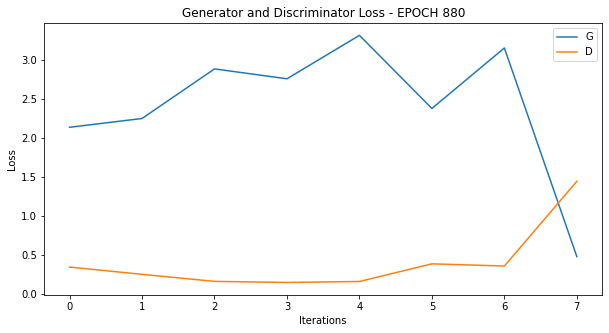

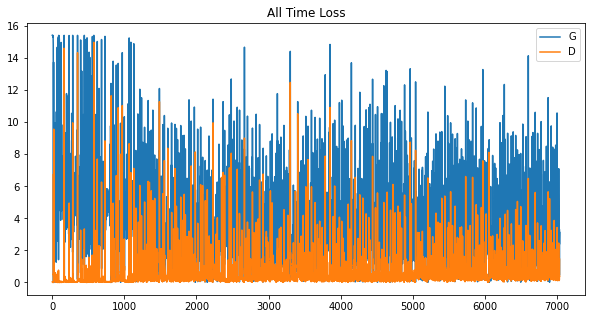

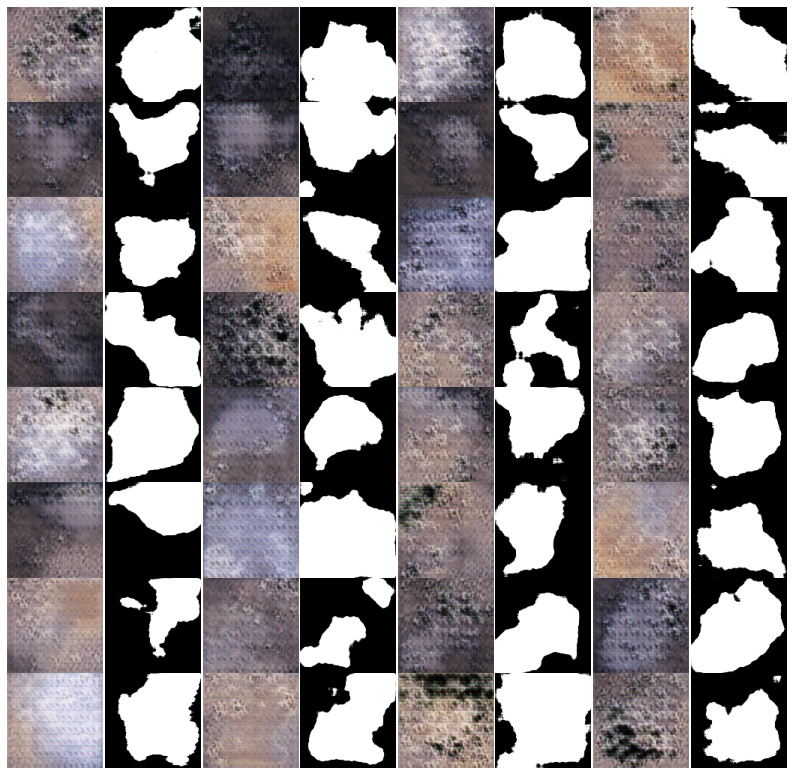





 29%|██▉       | 880/3000 [2:31:52<6:41:31, 11.36s/it]

Epoch: 880 computed for 14.236145973205566 sec
Gen_loss mean:  2.4237056  std:  0.83310485
Disc_loss mean:  0.4106467  std:  0.40249503






 29%|██▉       | 881/3000 [2:32:02<6:30:43, 11.06s/it]

Epoch: 881 computed for 10.350388050079346 sec
Gen_loss mean:  3.9411113  std:  3.0952177
Disc_loss mean:  0.8917113  std:  1.3802009






 29%|██▉       | 882/3000 [2:32:13<6:22:39, 10.84s/it]

Epoch: 882 computed for 10.302467346191406 sec
Gen_loss mean:  3.2549472  std:  2.17682
Disc_loss mean:  0.68261504  std:  0.53911114






 29%|██▉       | 883/3000 [2:32:23<6:15:18, 10.64s/it]

Epoch: 883 computed for 10.144494771957397 sec
Gen_loss mean:  2.7448645  std:  1.3030027
Disc_loss mean:  0.3903098  std:  0.1672836






 29%|██▉       | 884/3000 [2:32:33<6:09:11, 10.47s/it]

Epoch: 884 computed for 10.064673662185669 sec
Gen_loss mean:  3.7345192  std:  2.0435705
Disc_loss mean:  0.44644034  std:  0.27346802






 30%|██▉       | 885/3000 [2:32:43<6:04:44, 10.35s/it]

Epoch: 885 computed for 10.04796314239502 sec
Gen_loss mean:  3.9329395  std:  1.6676648
Disc_loss mean:  0.23231222  std:  0.1434631






 30%|██▉       | 886/3000 [2:32:53<6:02:20, 10.28s/it]

Epoch: 886 computed for 10.121361494064331 sec
Gen_loss mean:  4.525538  std:  3.1571803
Disc_loss mean:  0.6481401  std:  0.599386






 30%|██▉       | 887/3000 [2:33:03<6:00:00, 10.22s/it]

Epoch: 887 computed for 10.06501030921936 sec
Gen_loss mean:  3.6467252  std:  1.3964337
Disc_loss mean:  0.20062624  std:  0.15933236






 30%|██▉       | 888/3000 [2:33:13<5:58:03, 10.17s/it]

Epoch: 888 computed for 10.036093711853027 sec
Gen_loss mean:  3.6071024  std:  1.1946385
Disc_loss mean:  0.15046708  std:  0.08555046






 30%|██▉       | 889/3000 [2:33:23<5:56:51, 10.14s/it]

Epoch: 889 computed for 10.055328845977783 sec
Gen_loss mean:  4.3671284  std:  2.8767142
Disc_loss mean:  0.44208223  std:  0.44533816






 30%|██▉       | 890/3000 [2:33:33<5:56:36, 10.14s/it]

Epoch: 890 computed for 10.112818002700806 sec
Gen_loss mean:  3.5405192  std:  2.5855224
Disc_loss mean:  1.8959131  std:  2.029392






 30%|██▉       | 891/3000 [2:33:44<5:56:10, 10.13s/it]

Epoch: 891 computed for 10.096367597579956 sec
Gen_loss mean:  1.4283832  std:  0.49177992
Disc_loss mean:  0.76762366  std:  0.22865486






 30%|██▉       | 892/3000 [2:33:54<5:56:39, 10.15s/it]

Epoch: 892 computed for 10.174487352371216 sec
Gen_loss mean:  1.9720875  std:  1.1739167
Disc_loss mean:  0.79476833  std:  0.4199635






 30%|██▉       | 893/3000 [2:34:04<5:55:23, 10.12s/it]

Epoch: 893 computed for 10.032035112380981 sec
Gen_loss mean:  1.9861348  std:  0.997897
Disc_loss mean:  0.9079966  std:  0.50780004






 30%|██▉       | 894/3000 [2:34:14<5:54:41, 10.11s/it]

Epoch: 894 computed for 10.054051876068115 sec
Gen_loss mean:  2.5071733  std:  0.91732305
Disc_loss mean:  0.43017438  std:  0.111709096






 30%|██▉       | 895/3000 [2:34:24<5:54:57, 10.12s/it]

Epoch: 895 computed for 10.132479906082153 sec
Gen_loss mean:  2.338459  std:  1.5908098
Disc_loss mean:  0.6621223  std:  0.30013987






 30%|██▉       | 896/3000 [2:34:34<5:54:21, 10.11s/it]

Epoch: 896 computed for 10.061058044433594 sec
Gen_loss mean:  3.2060204  std:  1.9499503
Disc_loss mean:  0.74094677  std:  0.53861785






 30%|██▉       | 897/3000 [2:34:44<5:53:59, 10.10s/it]

Epoch: 897 computed for 10.072881698608398 sec
Gen_loss mean:  3.037612  std:  1.585005
Disc_loss mean:  0.83391786  std:  0.783532






 30%|██▉       | 898/3000 [2:34:54<5:54:14, 10.11s/it]

Epoch: 898 computed for 10.124300241470337 sec
Gen_loss mean:  2.121121  std:  0.46618515
Disc_loss mean:  0.44270223  std:  0.20616707






 30%|██▉       | 899/3000 [2:35:05<5:56:18, 10.18s/it]

Epoch: 899 computed for 10.305469512939453 sec
Gen_loss mean:  3.0558789  std:  2.2428858
Disc_loss mean:  1.0053471  std:  0.69097054
Saved temporary images for evaluation.
Removed temporary image directory.






 30%|███       | 900/3000 [2:35:20<6:51:32, 11.76s/it]

Epoch: 900 computed for 15.422797918319702 sec
Gen_loss mean:  2.2881687  std:  0.37756857
Disc_loss mean:  0.32031548  std:  0.058399264






 30%|███       | 901/3000 [2:35:30<6:34:09, 11.27s/it]

Epoch: 901 computed for 10.097150325775146 sec
Gen_loss mean:  2.9638243  std:  2.3856742
Disc_loss mean:  1.2709224  std:  1.3257893






 30%|███       | 902/3000 [2:35:40<6:21:56, 10.92s/it]

Epoch: 902 computed for 10.105423212051392 sec
Gen_loss mean:  1.6916245  std:  0.26542777
Disc_loss mean:  0.5462663  std:  0.10491129






 30%|███       | 903/3000 [2:35:50<6:13:20, 10.68s/it]

Epoch: 903 computed for 10.10211706161499 sec
Gen_loss mean:  2.9482186  std:  1.3120964
Disc_loss mean:  0.3290561  std:  0.12043936






 30%|███       | 904/3000 [2:36:01<6:07:19, 10.52s/it]

Epoch: 904 computed for 10.11212158203125 sec
Gen_loss mean:  3.2998223  std:  2.4579558
Disc_loss mean:  0.9502733  std:  0.70838594






 30%|███       | 905/3000 [2:36:11<6:03:09, 10.40s/it]

Epoch: 905 computed for 10.12076997756958 sec
Gen_loss mean:  2.6361294  std:  0.54213905
Disc_loss mean:  0.2687479  std:  0.10731543






 30%|███       | 906/3000 [2:36:21<5:59:34, 10.30s/it]

Epoch: 906 computed for 10.056118488311768 sec
Gen_loss mean:  3.1135468  std:  2.3454092
Disc_loss mean:  0.9677731  std:  1.1549518






 30%|███       | 907/3000 [2:36:31<5:57:18, 10.24s/it]

Epoch: 907 computed for 10.082062005996704 sec
Gen_loss mean:  2.4386816  std:  1.4357156
Disc_loss mean:  0.6008373  std:  0.398862






 30%|███       | 908/3000 [2:36:41<5:55:45, 10.20s/it]

Epoch: 908 computed for 10.09500503540039 sec
Gen_loss mean:  3.0757103  std:  0.78040296
Disc_loss mean:  0.2588119  std:  0.099404834






 30%|███       | 909/3000 [2:36:51<5:54:28, 10.17s/it]

Epoch: 909 computed for 10.084590911865234 sec
Gen_loss mean:  4.1054044  std:  2.2495403
Disc_loss mean:  0.37780234  std:  0.20322439






 30%|███       | 910/3000 [2:37:01<5:53:56, 10.16s/it]

Epoch: 910 computed for 10.121772050857544 sec
Gen_loss mean:  3.1160653  std:  2.1199074
Disc_loss mean:  0.62382865  std:  0.7123226






 30%|███       | 911/3000 [2:37:11<5:53:09, 10.14s/it]

Epoch: 911 computed for 10.085598468780518 sec
Gen_loss mean:  2.7290444  std:  2.2064102
Disc_loss mean:  0.8987665  std:  1.0512182






 30%|███       | 912/3000 [2:37:22<5:54:33, 10.19s/it]

Epoch: 912 computed for 10.278870105743408 sec
Gen_loss mean:  2.9998744  std:  1.2990453
Disc_loss mean:  0.57476187  std:  0.61962837






 30%|███       | 913/3000 [2:37:32<5:53:57, 10.18s/it]

Epoch: 913 computed for 10.13171100616455 sec
Gen_loss mean:  1.5355408  std:  0.72225183
Disc_loss mean:  1.052208  std:  0.81437975






 30%|███       | 914/3000 [2:37:42<5:52:55, 10.15s/it]

Epoch: 914 computed for 10.07884931564331 sec
Gen_loss mean:  2.1860363  std:  1.4042742
Disc_loss mean:  0.71008253  std:  0.33298457






 30%|███       | 915/3000 [2:37:52<5:52:19, 10.14s/it]

Epoch: 915 computed for 10.094871997833252 sec
Gen_loss mean:  3.046231  std:  1.5748358
Disc_loss mean:  0.74126637  std:  0.830318






 31%|███       | 916/3000 [2:38:02<5:51:17, 10.11s/it]

Epoch: 916 computed for 10.040271759033203 sec
Gen_loss mean:  2.1439068  std:  0.55451506
Disc_loss mean:  0.30095345  std:  0.18606012






 31%|███       | 917/3000 [2:38:12<5:51:16, 10.12s/it]

Epoch: 917 computed for 10.11077880859375 sec
Gen_loss mean:  2.4073558  std:  0.78575164
Disc_loss mean:  0.37851226  std:  0.12714463






 31%|███       | 918/3000 [2:38:22<5:50:38, 10.10s/it]

Epoch: 918 computed for 10.060697317123413 sec
Gen_loss mean:  2.262187  std:  1.5251672
Disc_loss mean:  0.9528888  std:  0.95046455






 31%|███       | 919/3000 [2:38:32<5:50:48, 10.11s/it]

Epoch: 919 computed for 10.119306564331055 sec
Gen_loss mean:  2.550982  std:  0.47494102
Disc_loss mean:  0.29474136  std:  0.06662208


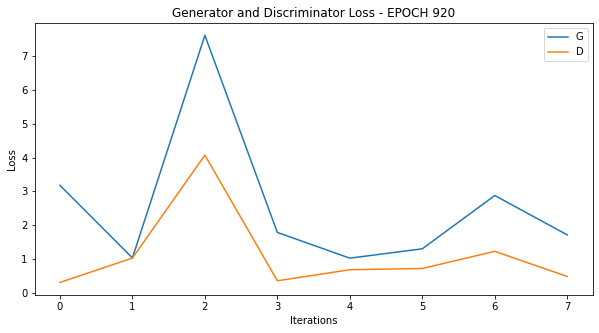

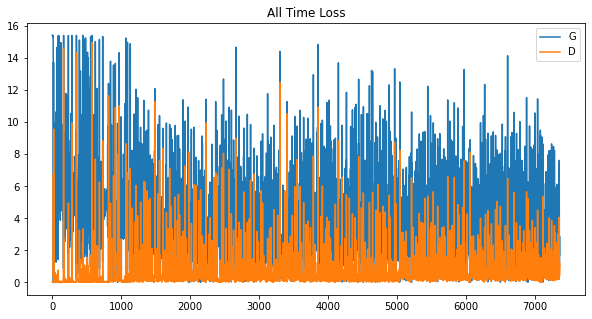

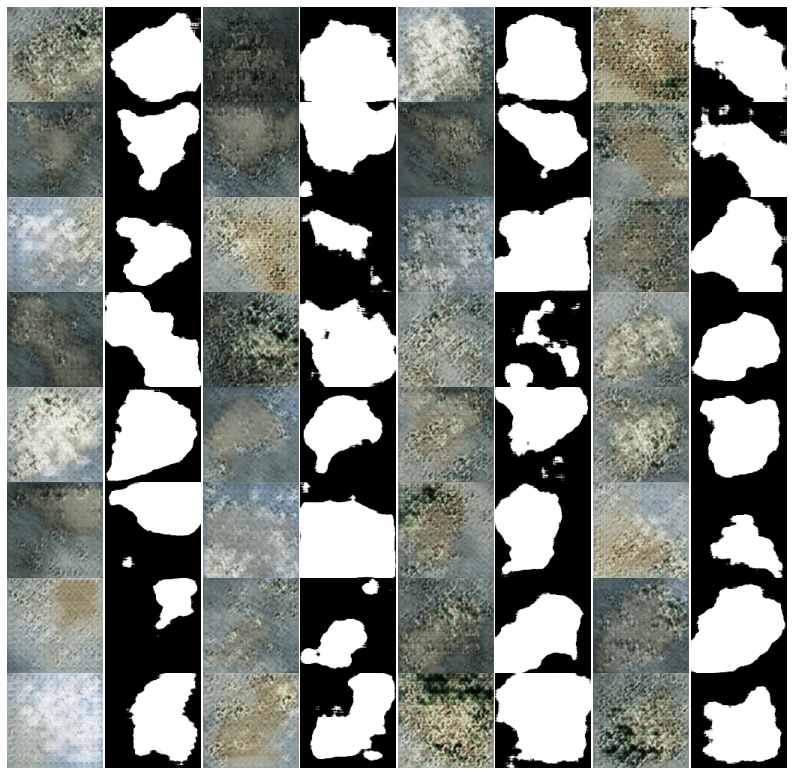





 31%|███       | 920/3000 [2:38:47<6:33:22, 11.35s/it]

Epoch: 920 computed for 14.196945190429688 sec
Gen_loss mean:  2.562402  std:  2.0540874
Disc_loss mean:  1.102838  std:  1.1608402






 31%|███       | 921/3000 [2:38:57<6:24:05, 11.09s/it]

Epoch: 921 computed for 10.460496664047241 sec
Gen_loss mean:  2.6208174  std:  0.8908656
Disc_loss mean:  0.38988796  std:  0.12649666






 31%|███       | 922/3000 [2:39:07<6:14:16, 10.81s/it]

Epoch: 922 computed for 10.139090299606323 sec
Gen_loss mean:  3.0447612  std:  2.1992824
Disc_loss mean:  1.100956  std:  1.2538279






 31%|███       | 923/3000 [2:39:17<6:06:55, 10.60s/it]

Epoch: 923 computed for 10.095966100692749 sec
Gen_loss mean:  2.2523649  std:  0.802679
Disc_loss mean:  0.46098536  std:  0.11478521






 31%|███       | 924/3000 [2:39:28<6:02:19, 10.47s/it]

Epoch: 924 computed for 10.155006170272827 sec
Gen_loss mean:  2.4197414  std:  1.223525
Disc_loss mean:  0.600801  std:  0.29293942






 31%|███       | 925/3000 [2:39:38<5:58:34, 10.37s/it]

Epoch: 925 computed for 10.109230756759644 sec
Gen_loss mean:  2.8310728  std:  0.7185756
Disc_loss mean:  0.34270042  std:  0.10549336






 31%|███       | 926/3000 [2:39:48<5:56:02, 10.30s/it]

Epoch: 926 computed for 10.128166198730469 sec
Gen_loss mean:  3.383665  std:  1.9150146
Disc_loss mean:  1.7437885  std:  2.7150993






 31%|███       | 927/3000 [2:39:58<5:53:26, 10.23s/it]

Epoch: 927 computed for 10.052199840545654 sec
Gen_loss mean:  1.893608  std:  0.7358536
Disc_loss mean:  0.704407  std:  0.33779344






 31%|███       | 928/3000 [2:40:08<5:51:57, 10.19s/it]

Epoch: 928 computed for 10.088225841522217 sec
Gen_loss mean:  2.313939  std:  1.4360943
Disc_loss mean:  0.9309423  std:  0.5076874






 31%|███       | 929/3000 [2:40:18<5:51:27, 10.18s/it]

Epoch: 929 computed for 10.146093845367432 sec
Gen_loss mean:  2.4229422  std:  0.90870744
Disc_loss mean:  0.56106675  std:  0.27010548






 31%|███       | 930/3000 [2:40:28<5:50:23, 10.16s/it]

Epoch: 930 computed for 10.07743239402771 sec
Gen_loss mean:  2.3480434  std:  1.2825314
Disc_loss mean:  0.8892468  std:  0.5689187






 31%|███       | 931/3000 [2:40:38<5:50:23, 10.16s/it]

Epoch: 931 computed for 10.157378673553467 sec
Gen_loss mean:  2.1282606  std:  1.5340533
Disc_loss mean:  1.0483931  std:  0.66322565






 31%|███       | 932/3000 [2:40:49<5:49:42, 10.15s/it]

Epoch: 932 computed for 10.09427547454834 sec
Gen_loss mean:  2.1361547  std:  0.601297
Disc_loss mean:  0.4501667  std:  0.08284735






 31%|███       | 933/3000 [2:40:59<5:50:07, 10.16s/it]

Epoch: 933 computed for 10.189716815948486 sec
Gen_loss mean:  2.9772415  std:  2.148299
Disc_loss mean:  0.9335526  std:  0.9550197






 31%|███       | 934/3000 [2:41:09<5:48:53, 10.13s/it]

Epoch: 934 computed for 10.039213180541992 sec
Gen_loss mean:  2.897745  std:  1.5564653
Disc_loss mean:  0.6781334  std:  0.54727167






 31%|███       | 935/3000 [2:41:19<5:48:32, 10.13s/it]

Epoch: 935 computed for 10.091621398925781 sec
Gen_loss mean:  2.160023  std:  1.0029085
Disc_loss mean:  0.68267906  std:  0.1771902






 31%|███       | 936/3000 [2:41:29<5:48:08, 10.12s/it]

Epoch: 936 computed for 10.091992378234863 sec
Gen_loss mean:  3.0081515  std:  2.2394524
Disc_loss mean:  0.8298324  std:  0.5211313






 31%|███       | 937/3000 [2:41:39<5:47:59, 10.12s/it]

Epoch: 937 computed for 10.109511613845825 sec
Gen_loss mean:  2.6566648  std:  1.576481
Disc_loss mean:  0.87820196  std:  0.586032






 31%|███▏      | 938/3000 [2:41:49<5:48:33, 10.14s/it]

Epoch: 938 computed for 10.178645133972168 sec
Gen_loss mean:  2.2736514  std:  1.1171361
Disc_loss mean:  0.63494384  std:  0.36322632






 31%|███▏      | 939/3000 [2:41:59<5:48:48, 10.15s/it]

Epoch: 939 computed for 10.168367147445679 sec
Gen_loss mean:  3.2309961  std:  2.2569044
Disc_loss mean:  0.9049128  std:  1.3155643






 31%|███▏      | 940/3000 [2:42:10<5:48:15, 10.14s/it]

Epoch: 940 computed for 10.095952272415161 sec
Gen_loss mean:  2.1625967  std:  0.79752403
Disc_loss mean:  0.49702144  std:  0.20045216






 31%|███▏      | 941/3000 [2:42:20<5:47:42, 10.13s/it]

Epoch: 941 computed for 10.092127561569214 sec
Gen_loss mean:  2.4816704  std:  0.3497808
Disc_loss mean:  0.37765095  std:  0.058988824






 31%|███▏      | 942/3000 [2:42:30<5:48:18, 10.15s/it]

Epoch: 942 computed for 10.186223030090332 sec
Gen_loss mean:  2.9144511  std:  1.9608585
Disc_loss mean:  1.1832641  std:  1.2329292






 31%|███▏      | 943/3000 [2:42:40<5:48:29, 10.16s/it]

Epoch: 943 computed for 10.172364234924316 sec
Gen_loss mean:  2.3774216  std:  0.5614403
Disc_loss mean:  0.3514252  std:  0.1240488






 31%|███▏      | 944/3000 [2:42:50<5:48:42, 10.18s/it]

Epoch: 944 computed for 10.189140558242798 sec
Gen_loss mean:  3.0305846  std:  2.2225828
Disc_loss mean:  1.0897402  std:  0.9417203






 32%|███▏      | 945/3000 [2:43:00<5:48:13, 10.17s/it]

Epoch: 945 computed for 10.126250267028809 sec
Gen_loss mean:  2.164306  std:  0.8615077
Disc_loss mean:  0.471358  std:  0.11964652






 32%|███▏      | 946/3000 [2:43:11<5:47:32, 10.15s/it]

Epoch: 946 computed for 10.103401899337769 sec
Gen_loss mean:  3.3776176  std:  2.3038085
Disc_loss mean:  0.7465767  std:  0.7994367






 32%|███▏      | 947/3000 [2:43:21<5:46:49, 10.14s/it]

Epoch: 947 computed for 10.07406997680664 sec
Gen_loss mean:  2.8338463  std:  1.5002455
Disc_loss mean:  0.53679514  std:  0.2907156






 32%|███▏      | 948/3000 [2:43:31<5:46:49, 10.14s/it]

Epoch: 948 computed for 10.135090827941895 sec
Gen_loss mean:  3.083506  std:  1.8680363
Disc_loss mean:  0.9222673  std:  1.1432172






 32%|███▏      | 949/3000 [2:43:41<5:46:25, 10.13s/it]

Epoch: 949 computed for 10.103951692581177 sec
Gen_loss mean:  3.4841914  std:  1.1581998
Disc_loss mean:  0.37385064  std:  0.40756726
Saved temporary images for evaluation.
Removed temporary image directory.






 32%|███▏      | 950/3000 [2:43:56<6:41:42, 11.76s/it]

Epoch: 950 computed for 15.504074811935425 sec
Gen_loss mean:  3.4230044  std:  1.8604784
Disc_loss mean:  0.41396642  std:  0.24149151






 32%|███▏      | 951/3000 [2:44:07<6:25:45, 11.30s/it]

Epoch: 951 computed for 10.208479642868042 sec
Gen_loss mean:  3.4599931  std:  2.1536908
Disc_loss mean:  0.49857205  std:  0.26450297






 32%|███▏      | 952/3000 [2:44:17<6:13:47, 10.95s/it]

Epoch: 952 computed for 10.127654552459717 sec
Gen_loss mean:  2.980158  std:  2.2966065
Disc_loss mean:  0.9102837  std:  0.92433774






 32%|███▏      | 953/3000 [2:44:27<6:05:48, 10.72s/it]

Epoch: 953 computed for 10.173742294311523 sec
Gen_loss mean:  2.6287389  std:  0.5500274
Disc_loss mean:  0.35289937  std:  0.10802537






 32%|███▏      | 954/3000 [2:44:37<6:00:14, 10.56s/it]

Epoch: 954 computed for 10.181274175643921 sec
Gen_loss mean:  2.8826108  std:  2.1612158
Disc_loss mean:  0.90489614  std:  1.0155382






 32%|███▏      | 955/3000 [2:44:47<5:55:26, 10.43s/it]

Epoch: 955 computed for 10.097830057144165 sec
Gen_loss mean:  2.4165323  std:  0.25394085
Disc_loss mean:  0.30799  std:  0.11711234






 32%|███▏      | 956/3000 [2:44:58<5:52:40, 10.35s/it]

Epoch: 956 computed for 10.159800052642822 sec
Gen_loss mean:  3.011033  std:  1.8560313
Disc_loss mean:  0.61525965  std:  0.3255518






 32%|███▏      | 957/3000 [2:45:08<5:50:02, 10.28s/it]

Epoch: 957 computed for 10.095332384109497 sec
Gen_loss mean:  3.0455208  std:  1.3934737
Disc_loss mean:  0.41103858  std:  0.21808685






 32%|███▏      | 958/3000 [2:45:18<5:48:17, 10.23s/it]

Epoch: 958 computed for 10.112075567245483 sec
Gen_loss mean:  4.3274097  std:  1.6446478
Disc_loss mean:  0.23088114  std:  0.0820587






 32%|███▏      | 959/3000 [2:45:28<5:46:46, 10.19s/it]

Epoch: 959 computed for 10.085932970046997 sec
Gen_loss mean:  4.304578  std:  1.2304692
Disc_loss mean:  0.1648603  std:  0.12799914


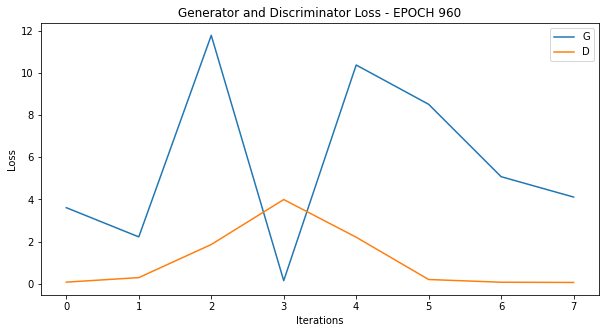

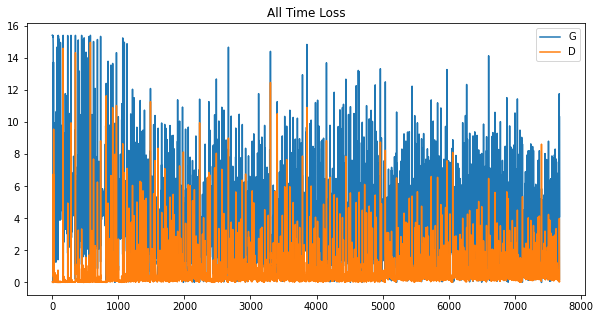

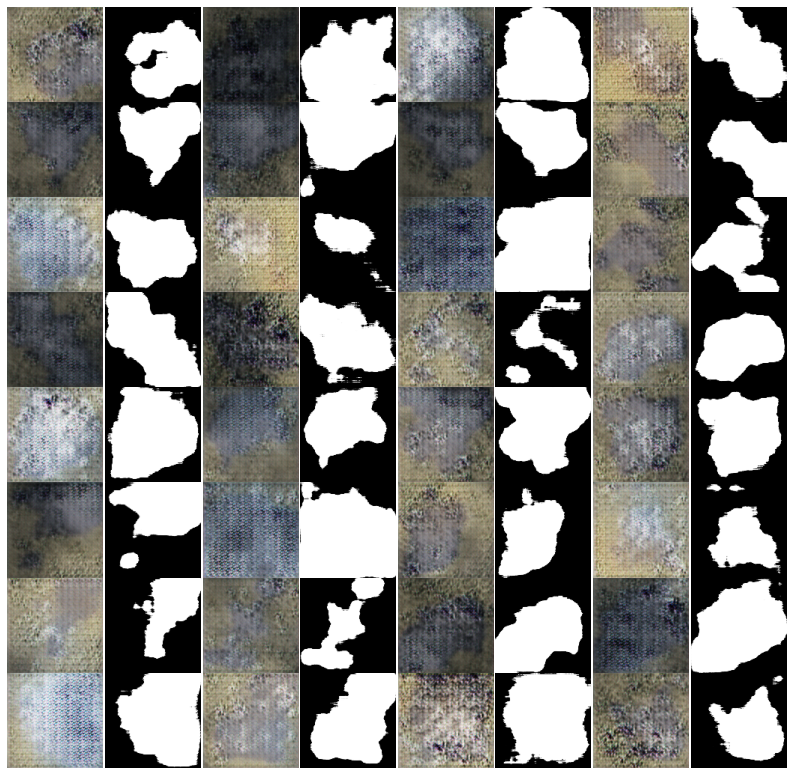





 32%|███▏      | 960/3000 [2:45:42<6:28:47, 11.44s/it]

Epoch: 960 computed for 14.285631656646729 sec
Gen_loss mean:  5.7282524  std:  3.8246865
Disc_loss mean:  1.0931668  std:  1.361488






 32%|███▏      | 961/3000 [2:45:53<6:17:25, 11.11s/it]

Epoch: 961 computed for 10.32794737815857 sec
Gen_loss mean:  2.6527984  std:  0.49507862
Disc_loss mean:  0.16966107  std:  0.07559062






 32%|███▏      | 962/3000 [2:46:03<6:07:05, 10.81s/it]

Epoch: 962 computed for 10.096842765808105 sec
Gen_loss mean:  3.0457  std:  1.6979995
Disc_loss mean:  0.6979091  std:  0.6130023






 32%|███▏      | 963/3000 [2:46:13<5:59:40, 10.59s/it]

Epoch: 963 computed for 10.068308353424072 sec
Gen_loss mean:  3.6839619  std:  1.7530891
Disc_loss mean:  0.33665812  std:  0.22578944






 32%|███▏      | 964/3000 [2:46:23<5:55:00, 10.46s/it]

Epoch: 964 computed for 10.139564275741577 sec
Gen_loss mean:  3.8747807  std:  3.3075516
Disc_loss mean:  0.90541345  std:  1.1372019






 32%|███▏      | 965/3000 [2:46:33<5:51:18, 10.36s/it]

Epoch: 965 computed for 10.09576940536499 sec
Gen_loss mean:  2.5650055  std:  0.8256115
Disc_loss mean:  0.46139976  std:  0.22189343






 32%|███▏      | 966/3000 [2:46:43<5:48:55, 10.29s/it]

Epoch: 966 computed for 10.118062734603882 sec
Gen_loss mean:  3.0561  std:  1.7867455
Disc_loss mean:  0.5144118  std:  0.44903806






 32%|███▏      | 967/3000 [2:46:53<5:46:41, 10.23s/it]

Epoch: 967 computed for 10.075514793395996 sec
Gen_loss mean:  2.9123592  std:  1.1708866
Disc_loss mean:  0.39871383  std:  0.18703881






 32%|███▏      | 968/3000 [2:47:03<5:45:32, 10.20s/it]

Epoch: 968 computed for 10.120814323425293 sec
Gen_loss mean:  3.6058702  std:  3.364632
Disc_loss mean:  1.4149377  std:  1.6200588






 32%|███▏      | 969/3000 [2:47:14<5:44:41, 10.18s/it]

Epoch: 969 computed for 10.120695352554321 sec
Gen_loss mean:  2.2926068  std:  0.4510006
Disc_loss mean:  0.39547807  std:  0.12734704






 32%|███▏      | 970/3000 [2:47:24<5:43:30, 10.15s/it]

Epoch: 970 computed for 10.064277410507202 sec
Gen_loss mean:  2.5500226  std:  0.92687356
Disc_loss mean:  0.4314783  std:  0.2128806






 32%|███▏      | 971/3000 [2:47:34<5:43:24, 10.15s/it]

Epoch: 971 computed for 10.14535927772522 sec
Gen_loss mean:  3.1343005  std:  1.8674941
Disc_loss mean:  0.7147403  std:  0.97452277






 32%|███▏      | 972/3000 [2:47:44<5:43:44, 10.17s/it]

Epoch: 972 computed for 10.186959981918335 sec
Gen_loss mean:  4.0880203  std:  2.4454546
Disc_loss mean:  0.61656  std:  1.1097707






 32%|███▏      | 973/3000 [2:47:54<5:43:21, 10.16s/it]

Epoch: 973 computed for 10.135708808898926 sec
Gen_loss mean:  2.8244648  std:  0.7509122
Disc_loss mean:  0.29906633  std:  0.15436931






 32%|███▏      | 974/3000 [2:48:04<5:42:37, 10.15s/it]

Epoch: 974 computed for 10.093661546707153 sec
Gen_loss mean:  3.276463  std:  2.585717
Disc_loss mean:  0.792619  std:  0.90159595






 32%|███▎      | 975/3000 [2:48:14<5:42:33, 10.15s/it]

Epoch: 975 computed for 10.139984607696533 sec
Gen_loss mean:  3.0750203  std:  0.9534117
Disc_loss mean:  0.2848391  std:  0.12632264






 33%|███▎      | 976/3000 [2:48:25<5:42:10, 10.14s/it]

Epoch: 976 computed for 10.114235639572144 sec
Gen_loss mean:  3.578759  std:  1.7635598
Disc_loss mean:  0.45238197  std:  0.22578986






 33%|███▎      | 977/3000 [2:48:35<5:42:00, 10.14s/it]

Epoch: 977 computed for 10.1255521774292 sec
Gen_loss mean:  3.5331936  std:  1.005808
Disc_loss mean:  0.20577146  std:  0.061494026






 33%|███▎      | 978/3000 [2:48:45<5:41:07, 10.12s/it]

Epoch: 978 computed for 10.055786609649658 sec
Gen_loss mean:  5.0365777  std:  3.5601687
Disc_loss mean:  1.0967515  std:  1.9111853






 33%|███▎      | 979/3000 [2:48:55<5:41:37, 10.14s/it]

Epoch: 979 computed for 10.176153182983398 sec
Gen_loss mean:  2.4029047  std:  0.6825776
Disc_loss mean:  0.41867048  std:  0.34221518






 33%|███▎      | 980/3000 [2:49:05<5:41:57, 10.16s/it]

Epoch: 980 computed for 10.176613569259644 sec
Gen_loss mean:  2.3554842  std:  1.0514749
Disc_loss mean:  0.6047752  std:  0.4366026






 33%|███▎      | 981/3000 [2:49:15<5:41:14, 10.14s/it]

Epoch: 981 computed for 10.089014768600464 sec
Gen_loss mean:  3.1879377  std:  2.0140002
Disc_loss mean:  1.0452347  std:  1.269485






 33%|███▎      | 982/3000 [2:49:25<5:40:41, 10.13s/it]

Epoch: 982 computed for 10.089062213897705 sec
Gen_loss mean:  1.9474934  std:  0.59882015
Disc_loss mean:  0.49481332  std:  0.1717164






 33%|███▎      | 983/3000 [2:49:35<5:40:27, 10.13s/it]

Epoch: 983 computed for 10.107498168945312 sec
Gen_loss mean:  2.5811353  std:  1.752989
Disc_loss mean:  1.4629714  std:  1.5663905






 33%|███▎      | 984/3000 [2:49:46<5:40:08, 10.12s/it]

Epoch: 984 computed for 10.098900318145752 sec
Gen_loss mean:  2.0142217  std:  0.39588714
Disc_loss mean:  0.45547172  std:  0.13235225






 33%|███▎      | 985/3000 [2:49:56<5:39:48, 10.12s/it]

Epoch: 985 computed for 10.08594012260437 sec
Gen_loss mean:  2.7209213  std:  1.2754891
Disc_loss mean:  0.5217674  std:  0.30534294






 33%|███▎      | 986/3000 [2:50:06<5:39:55, 10.13s/it]

Epoch: 986 computed for 10.134121656417847 sec
Gen_loss mean:  4.04634  std:  2.0010743
Disc_loss mean:  0.41331822  std:  0.19080013






 33%|███▎      | 987/3000 [2:50:16<5:39:07, 10.11s/it]

Epoch: 987 computed for 10.0482497215271 sec
Gen_loss mean:  4.193048  std:  3.943977
Disc_loss mean:  0.87039834  std:  1.2007635






 33%|███▎      | 988/3000 [2:50:26<5:39:01, 10.11s/it]

Epoch: 988 computed for 10.100353717803955 sec
Gen_loss mean:  2.8069797  std:  1.467606
Disc_loss mean:  0.47346377  std:  0.38523278






 33%|███▎      | 989/3000 [2:50:36<5:39:04, 10.12s/it]

Epoch: 989 computed for 10.109204053878784 sec
Gen_loss mean:  2.889287  std:  0.61336505
Disc_loss mean:  0.27825665  std:  0.05093846






 33%|███▎      | 990/3000 [2:50:46<5:38:22, 10.10s/it]

Epoch: 990 computed for 10.045676946640015 sec
Gen_loss mean:  3.5532532  std:  1.4502437
Disc_loss mean:  0.28145546  std:  0.20698825






 33%|███▎      | 991/3000 [2:50:56<5:38:18, 10.10s/it]

Epoch: 991 computed for 10.094048023223877 sec
Gen_loss mean:  3.5290866  std:  2.435947
Disc_loss mean:  1.2278755  std:  1.3810753






 33%|███▎      | 992/3000 [2:51:07<5:40:09, 10.16s/it]

Epoch: 992 computed for 10.29133653640747 sec
Gen_loss mean:  3.218452  std:  0.38605076
Disc_loss mean:  0.15640047  std:  0.050360344






 33%|███▎      | 993/3000 [2:51:17<5:39:16, 10.14s/it]

Epoch: 993 computed for 10.079295635223389 sec
Gen_loss mean:  3.4122214  std:  1.4445577
Disc_loss mean:  0.2862221  std:  0.13673918






 33%|███▎      | 994/3000 [2:51:27<5:39:45, 10.16s/it]

Epoch: 994 computed for 10.186334609985352 sec
Gen_loss mean:  4.943306  std:  2.1299765
Disc_loss mean:  0.26524732  std:  0.13507208






 33%|███▎      | 995/3000 [2:51:37<5:38:48, 10.14s/it]

Epoch: 995 computed for 10.069686889648438 sec
Gen_loss mean:  3.7338505  std:  2.5370476
Disc_loss mean:  0.6097839  std:  0.691042






 33%|███▎      | 996/3000 [2:51:47<5:38:03, 10.12s/it]

Epoch: 996 computed for 10.063678741455078 sec
Gen_loss mean:  3.2384202  std:  0.6032961
Disc_loss mean:  0.14700021  std:  0.07416417






 33%|███▎      | 997/3000 [2:51:57<5:38:07, 10.13s/it]

Epoch: 997 computed for 10.13233494758606 sec
Gen_loss mean:  3.419279  std:  1.7346134
Disc_loss mean:  0.4892918  std:  0.6207856






 33%|███▎      | 998/3000 [2:52:07<5:37:30, 10.12s/it]

Epoch: 998 computed for 10.067463159561157 sec
Gen_loss mean:  3.0382626  std:  3.1421688
Disc_loss mean:  1.2548122  std:  1.1269982






 33%|███▎      | 999/3000 [2:52:17<5:36:45, 10.10s/it]

Epoch: 999 computed for 10.041438102722168 sec
Gen_loss mean:  2.6707983  std:  0.69963723
Disc_loss mean:  0.40413237  std:  0.117827594


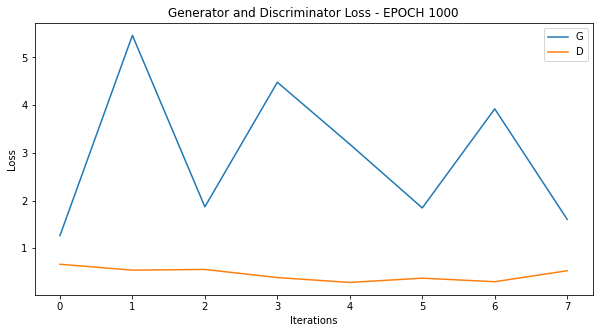

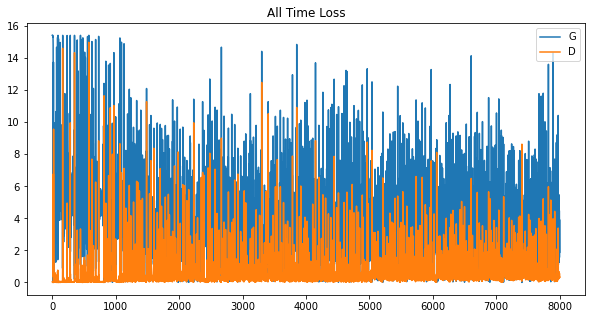

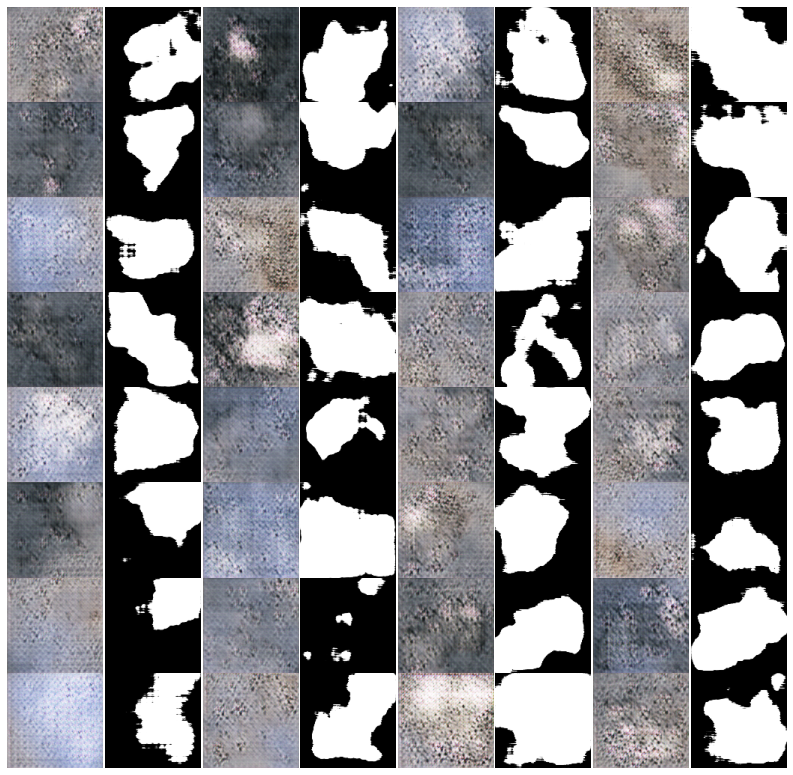

Saved temporary images for evaluation.
Removed temporary image directory.






 33%|███▎      | 1000/3000 [2:52:37<7:15:25, 13.06s/it]

Epoch: 1000 computed for 19.95335555076599 sec
Gen_loss mean:  2.9531074  std:  1.4455717
Disc_loss mean:  0.452318  std:  0.12879367






 33%|███▎      | 1001/3000 [2:52:48<6:46:49, 12.21s/it]

Epoch: 1001 computed for 10.20168399810791 sec
Gen_loss mean:  3.5187938  std:  2.8318508
Disc_loss mean:  1.0975133  std:  1.0371699






 33%|███▎      | 1002/3000 [2:52:58<6:27:41, 11.64s/it]

Epoch: 1002 computed for 10.301478147506714 sec
Gen_loss mean:  2.8632069  std:  0.8317635
Disc_loss mean:  0.33799344  std:  0.12276202






 33%|███▎      | 1003/3000 [2:53:08<6:12:46, 11.20s/it]

Epoch: 1003 computed for 10.15122127532959 sec
Gen_loss mean:  3.2772603  std:  2.3300753
Disc_loss mean:  0.80015624  std:  0.60637844






 33%|███▎      | 1004/3000 [2:53:18<6:01:41, 10.87s/it]

Epoch: 1004 computed for 10.085334539413452 sec
Gen_loss mean:  3.1504104  std:  1.0958438
Disc_loss mean:  0.32209647  std:  0.13505189






 34%|███▎      | 1005/3000 [2:53:28<5:54:38, 10.67s/it]

Epoch: 1005 computed for 10.165398836135864 sec
Gen_loss mean:  4.350577  std:  2.921043
Disc_loss mean:  1.3913352  std:  1.710741






 34%|███▎      | 1006/3000 [2:53:38<5:49:29, 10.52s/it]

Epoch: 1006 computed for 10.152276992797852 sec
Gen_loss mean:  2.2815375  std:  0.6901584
Disc_loss mean:  0.3574043  std:  0.18388036






 34%|███▎      | 1007/3000 [2:53:49<5:45:57, 10.42s/it]

Epoch: 1007 computed for 10.166094303131104 sec
Gen_loss mean:  1.9434084  std:  0.81996584
Disc_loss mean:  0.7857391  std:  0.34185663






 34%|███▎      | 1008/3000 [2:53:59<5:43:25, 10.34s/it]

Epoch: 1008 computed for 10.152103900909424 sec
Gen_loss mean:  2.4314404  std:  1.0470088
Disc_loss mean:  0.47789845  std:  0.19598821






 34%|███▎      | 1009/3000 [2:54:09<5:41:13, 10.28s/it]

Epoch: 1009 computed for 10.126376867294312 sec
Gen_loss mean:  2.78354  std:  1.635277
Disc_loss mean:  0.5627769  std:  0.30425194






 34%|███▎      | 1010/3000 [2:54:19<5:40:07, 10.26s/it]

Epoch: 1010 computed for 10.175442457199097 sec
Gen_loss mean:  3.6781578  std:  2.1088371
Disc_loss mean:  0.77305174  std:  0.7275903






 34%|███▎      | 1011/3000 [2:54:29<5:39:32, 10.24s/it]

Epoch: 1011 computed for 10.197245597839355 sec
Gen_loss mean:  2.5353506  std:  0.7649267
Disc_loss mean:  0.30077013  std:  0.14322871






 34%|███▎      | 1012/3000 [2:54:40<5:38:08, 10.21s/it]

Epoch: 1012 computed for 10.099811553955078 sec
Gen_loss mean:  3.0548809  std:  2.4852006
Disc_loss mean:  0.9171001  std:  0.9959297






 34%|███▍      | 1013/3000 [2:54:50<5:37:35, 10.19s/it]

Epoch: 1013 computed for 10.152201414108276 sec
Gen_loss mean:  2.6672866  std:  0.5652576
Disc_loss mean:  0.29796752  std:  0.14665325






 34%|███▍      | 1014/3000 [2:55:00<5:36:26, 10.16s/it]

Epoch: 1014 computed for 10.075016498565674 sec
Gen_loss mean:  3.0366  std:  2.2330143
Disc_loss mean:  1.022577  std:  0.9968781






 34%|███▍      | 1015/3000 [2:55:10<5:35:59, 10.16s/it]

Epoch: 1015 computed for 10.121635913848877 sec
Gen_loss mean:  2.6393423  std:  0.5538927
Disc_loss mean:  0.3595662  std:  0.06939821






 34%|███▍      | 1016/3000 [2:55:20<5:35:33, 10.15s/it]

Epoch: 1016 computed for 10.112918138504028 sec
Gen_loss mean:  3.4303944  std:  2.353948
Disc_loss mean:  0.79047847  std:  0.8502393






 34%|███▍      | 1017/3000 [2:55:30<5:35:29, 10.15s/it]

Epoch: 1017 computed for 10.142898082733154 sec
Gen_loss mean:  2.8063648  std:  0.81403613
Disc_loss mean:  0.29728633  std:  0.12249876






 34%|███▍      | 1018/3000 [2:55:40<5:35:10, 10.15s/it]

Epoch: 1018 computed for 10.11942172050476 sec
Gen_loss mean:  3.8515592  std:  1.9557962
Disc_loss mean:  0.27339515  std:  0.15952316






 34%|███▍      | 1019/3000 [2:55:51<5:35:31, 10.16s/it]

Epoch: 1019 computed for 10.182493925094604 sec
Gen_loss mean:  4.156942  std:  2.5779526
Disc_loss mean:  0.49547732  std:  0.45782965






 34%|███▍      | 1020/3000 [2:56:01<5:35:26, 10.16s/it]

Epoch: 1020 computed for 10.15848445892334 sec
Gen_loss mean:  2.9518654  std:  1.1462407
Disc_loss mean:  0.35092267  std:  0.21540304






 34%|███▍      | 1021/3000 [2:56:11<5:34:25, 10.14s/it]

Epoch: 1021 computed for 10.066896915435791 sec
Gen_loss mean:  3.7117987  std:  2.0928524
Disc_loss mean:  0.639486  std:  0.6386617






 34%|███▍      | 1022/3000 [2:56:21<5:34:05, 10.13s/it]

Epoch: 1022 computed for 10.107686042785645 sec
Gen_loss mean:  3.3265207  std:  2.0391357
Disc_loss mean:  0.6693853  std:  0.3895849






 34%|███▍      | 1023/3000 [2:56:31<5:33:46, 10.13s/it]

Epoch: 1023 computed for 10.10143494606018 sec
Gen_loss mean:  3.2335753  std:  1.6622075
Disc_loss mean:  0.51572764  std:  0.24403629






 34%|███▍      | 1024/3000 [2:56:41<5:33:47, 10.14s/it]

Epoch: 1024 computed for 10.134980201721191 sec
Gen_loss mean:  3.2890232  std:  2.0946476
Disc_loss mean:  0.5449542  std:  0.23719576






 34%|███▍      | 1025/3000 [2:56:51<5:34:28, 10.16s/it]

Epoch: 1025 computed for 10.20472526550293 sec
Gen_loss mean:  4.2989388  std:  2.9503663
Disc_loss mean:  0.891169  std:  0.8406875






 34%|███▍      | 1026/3000 [2:57:01<5:33:36, 10.14s/it]

Epoch: 1026 computed for 10.07666563987732 sec
Gen_loss mean:  2.8029034  std:  0.55400676
Disc_loss mean:  0.27089638  std:  0.10925226






 34%|███▍      | 1027/3000 [2:57:12<5:33:31, 10.14s/it]

Epoch: 1027 computed for 10.133093357086182 sec
Gen_loss mean:  2.7676373  std:  1.7530684
Disc_loss mean:  0.63513446  std:  0.43409863






 34%|███▍      | 1028/3000 [2:57:22<5:33:07, 10.14s/it]

Epoch: 1028 computed for 10.10228443145752 sec
Gen_loss mean:  3.0519872  std:  1.1291845
Disc_loss mean:  0.4253435  std:  0.2634482






 34%|███▍      | 1029/3000 [2:57:32<5:32:57, 10.14s/it]

Epoch: 1029 computed for 10.124892950057983 sec
Gen_loss mean:  3.8665245  std:  2.0097184
Disc_loss mean:  0.34830093  std:  0.148304






 34%|███▍      | 1030/3000 [2:57:42<5:32:37, 10.13s/it]

Epoch: 1030 computed for 10.103764533996582 sec
Gen_loss mean:  5.347662  std:  3.6763499
Disc_loss mean:  1.2259618  std:  1.7110591






 34%|███▍      | 1031/3000 [2:57:52<5:31:59, 10.12s/it]

Epoch: 1031 computed for 10.068918466567993 sec
Gen_loss mean:  4.0052557  std:  2.286142
Disc_loss mean:  0.28982115  std:  0.35186604






 34%|███▍      | 1032/3000 [2:58:02<5:32:58, 10.15s/it]

Epoch: 1032 computed for 10.21590518951416 sec
Gen_loss mean:  3.1768897  std:  1.147462
Disc_loss mean:  0.3410565  std:  0.11634286






 34%|███▍      | 1033/3000 [2:58:13<5:33:58, 10.19s/it]

Epoch: 1033 computed for 10.256291151046753 sec
Gen_loss mean:  3.9149349  std:  2.2187722
Disc_loss mean:  1.0155221  std:  1.4113637






 34%|███▍      | 1034/3000 [2:58:23<5:33:39, 10.18s/it]

Epoch: 1034 computed for 10.156901836395264 sec
Gen_loss mean:  2.4757628  std:  0.45891047
Disc_loss mean:  0.28620526  std:  0.13153392






 34%|███▍      | 1035/3000 [2:58:33<5:32:45, 10.16s/it]

Epoch: 1035 computed for 10.089601755142212 sec
Gen_loss mean:  2.96942  std:  1.0720907
Disc_loss mean:  0.36365402  std:  0.13033982






 35%|███▍      | 1036/3000 [2:58:43<5:32:43, 10.16s/it]

Epoch: 1036 computed for 10.15847134590149 sec
Gen_loss mean:  3.1974654  std:  1.8656964
Disc_loss mean:  0.6229404  std:  0.56353503






 35%|███▍      | 1037/3000 [2:58:53<5:31:53, 10.14s/it]

Epoch: 1037 computed for 10.08230996131897 sec
Gen_loss mean:  3.212886  std:  2.0185444
Disc_loss mean:  0.77258635  std:  0.7029271






 35%|███▍      | 1038/3000 [2:59:03<5:32:40, 10.17s/it]

Epoch: 1038 computed for 10.226126909255981 sec
Gen_loss mean:  3.2624373  std:  1.03533
Disc_loss mean:  0.2628922  std:  0.05323081






 35%|███▍      | 1039/3000 [2:59:14<5:32:20, 10.17s/it]

Epoch: 1039 computed for 10.139956951141357 sec
Gen_loss mean:  4.3724174  std:  1.7723191
Disc_loss mean:  0.22904031  std:  0.17344165


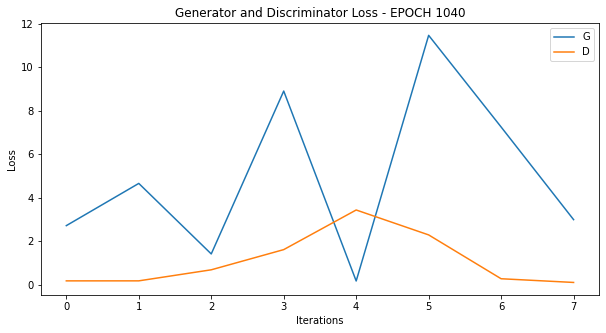

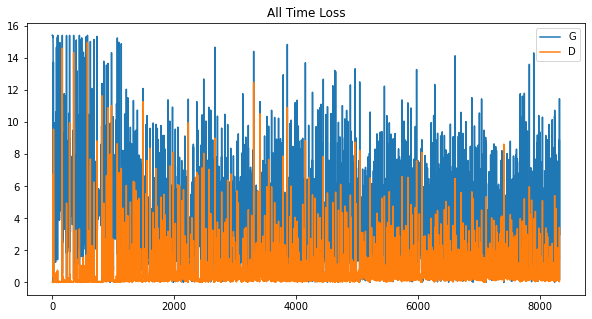

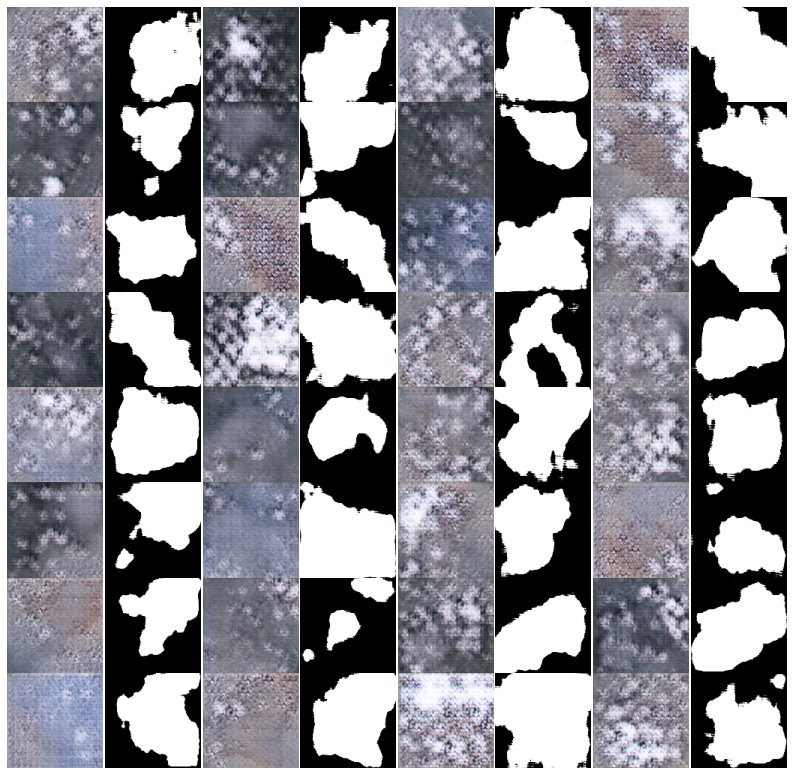





 35%|███▍      | 1040/3000 [2:59:28<6:12:57, 11.42s/it]

Epoch: 1040 computed for 14.298988103866577 sec
Gen_loss mean:  4.9480944  std:  3.6677775
Disc_loss mean:  1.0961171  std:  1.1556854






 35%|███▍      | 1041/3000 [2:59:38<6:02:34, 11.11s/it]

Epoch: 1041 computed for 10.36623215675354 sec
Gen_loss mean:  3.1363344  std:  1.0377709
Disc_loss mean:  0.24614  std:  0.12954886






 35%|███▍      | 1042/3000 [2:59:48<5:53:04, 10.82s/it]

Epoch: 1042 computed for 10.136721849441528 sec
Gen_loss mean:  2.9763815  std:  1.8384006
Disc_loss mean:  0.485142  std:  0.16971959






 35%|███▍      | 1043/3000 [2:59:59<5:46:10, 10.61s/it]

Epoch: 1043 computed for 10.107362031936646 sec
Gen_loss mean:  4.1465955  std:  2.8850315
Disc_loss mean:  0.7200096  std:  0.85372406






 35%|███▍      | 1044/3000 [3:00:09<5:40:30, 10.44s/it]

Epoch: 1044 computed for 10.037493705749512 sec
Gen_loss mean:  3.483244  std:  1.2344284
Disc_loss mean:  0.13409367  std:  0.09099107






 35%|███▍      | 1045/3000 [3:00:19<5:37:23, 10.35s/it]

Epoch: 1045 computed for 10.13205337524414 sec
Gen_loss mean:  3.000736  std:  2.1646264
Disc_loss mean:  0.9091929  std:  1.0055261






 35%|███▍      | 1046/3000 [3:00:29<5:34:29, 10.27s/it]

Epoch: 1046 computed for 10.05889081954956 sec
Gen_loss mean:  3.1394007  std:  1.4046899
Disc_loss mean:  0.33990288  std:  0.15115166






 35%|███▍      | 1047/3000 [3:00:39<5:33:25, 10.24s/it]

Epoch: 1047 computed for 10.158441066741943 sec
Gen_loss mean:  4.0248756  std:  2.1342385
Disc_loss mean:  0.369479  std:  0.4577692






 35%|███▍      | 1048/3000 [3:00:49<5:31:45, 10.20s/it]

Epoch: 1048 computed for 10.075149297714233 sec
Gen_loss mean:  4.0014906  std:  1.6747643
Disc_loss mean:  0.24222985  std:  0.15832037






 35%|███▍      | 1049/3000 [3:00:59<5:30:23, 10.16s/it]

Epoch: 1049 computed for 10.059337139129639 sec
Gen_loss mean:  4.2395725  std:  1.2547779
Disc_loss mean:  0.1181384  std:  0.047898572
Saved temporary images for evaluation.
Removed temporary image directory.






 35%|███▌      | 1050/3000 [3:01:15<6:20:48, 11.72s/it]

Epoch: 1050 computed for 15.316818237304688 sec
Gen_loss mean:  5.1148205  std:  3.4085941
Disc_loss mean:  0.59420955  std:  0.36574727






 35%|███▌      | 1051/3000 [3:01:25<6:05:21, 11.25s/it]

Epoch: 1051 computed for 10.13519287109375 sec
Gen_loss mean:  3.9703526  std:  2.3213017
Disc_loss mean:  0.37984192  std:  0.28763705






 35%|███▌      | 1052/3000 [3:01:35<5:53:58, 10.90s/it]

Epoch: 1052 computed for 10.084502935409546 sec
Gen_loss mean:  3.947196  std:  1.1903692
Disc_loss mean:  0.26759765  std:  0.2869973






 35%|███▌      | 1053/3000 [3:01:45<5:46:25, 10.68s/it]

Epoch: 1053 computed for 10.132141590118408 sec
Gen_loss mean:  3.070676  std:  2.905471
Disc_loss mean:  1.6502199  std:  1.7146171






 35%|███▌      | 1054/3000 [3:01:55<5:40:54, 10.51s/it]

Epoch: 1054 computed for 10.108019351959229 sec
Gen_loss mean:  2.5879624  std:  0.29142934
Disc_loss mean:  0.22036138  std:  0.05941998






 35%|███▌      | 1055/3000 [3:02:05<5:36:56, 10.39s/it]

Epoch: 1055 computed for 10.103179454803467 sec
Gen_loss mean:  2.9457154  std:  1.2502766
Disc_loss mean:  0.3828863  std:  0.13570298






 35%|███▌      | 1056/3000 [3:02:15<5:33:45, 10.30s/it]

Epoch: 1056 computed for 10.06620979309082 sec
Gen_loss mean:  3.1218588  std:  1.369667
Disc_loss mean:  0.3395032  std:  0.14861462






 35%|███▌      | 1057/3000 [3:02:25<5:32:31, 10.27s/it]

Epoch: 1057 computed for 10.17796516418457 sec
Gen_loss mean:  3.5373702  std:  1.89371
Disc_loss mean:  1.4417907  std:  2.2224777






 35%|███▌      | 1058/3000 [3:02:36<5:30:52, 10.22s/it]

Epoch: 1058 computed for 10.09746503829956 sec
Gen_loss mean:  2.2648816  std:  0.64329153
Disc_loss mean:  0.3295049  std:  0.11168508






 35%|███▌      | 1059/3000 [3:02:46<5:29:47, 10.19s/it]

Epoch: 1059 computed for 10.111019849777222 sec
Gen_loss mean:  2.8822684  std:  1.144632
Disc_loss mean:  0.42749196  std:  0.18027793






 35%|███▌      | 1060/3000 [3:02:56<5:28:43, 10.17s/it]

Epoch: 1060 computed for 10.086439371109009 sec
Gen_loss mean:  3.1905138  std:  2.7878697
Disc_loss mean:  1.0044967  std:  1.0524526






 35%|███▌      | 1061/3000 [3:03:06<5:27:52, 10.15s/it]

Epoch: 1061 computed for 10.083301782608032 sec
Gen_loss mean:  2.85197  std:  0.6743291
Disc_loss mean:  0.2895006  std:  0.09172907






 35%|███▌      | 1062/3000 [3:03:16<5:28:31, 10.17s/it]

Epoch: 1062 computed for 10.207195520401001 sec
Gen_loss mean:  3.040844  std:  1.0387726
Disc_loss mean:  0.3240732  std:  0.12751113






 35%|███▌      | 1063/3000 [3:03:26<5:28:40, 10.18s/it]

Epoch: 1063 computed for 10.185624837875366 sec
Gen_loss mean:  3.9963527  std:  1.9223711
Disc_loss mean:  0.346901  std:  0.26297253






 35%|███▌      | 1064/3000 [3:03:36<5:27:52, 10.16s/it]

Epoch: 1064 computed for 10.09125280380249 sec
Gen_loss mean:  3.7815857  std:  1.8173206
Disc_loss mean:  0.22846898  std:  0.10260086






 36%|███▌      | 1065/3000 [3:03:47<5:27:37, 10.16s/it]

Epoch: 1065 computed for 10.13815975189209 sec
Gen_loss mean:  5.7131777  std:  3.707009
Disc_loss mean:  0.5750736  std:  0.5152854






 36%|███▌      | 1066/3000 [3:03:57<5:27:05, 10.15s/it]

Epoch: 1066 computed for 10.10819697380066 sec
Gen_loss mean:  3.107329  std:  1.0705503
Disc_loss mean:  0.24669185  std:  0.15903507






 36%|███▌      | 1067/3000 [3:04:07<5:27:08, 10.15s/it]

Epoch: 1067 computed for 10.151023149490356 sec
Gen_loss mean:  3.784064  std:  2.0897932
Disc_loss mean:  0.28567606  std:  0.16932206






 36%|███▌      | 1068/3000 [3:04:17<5:27:02, 10.16s/it]

Epoch: 1068 computed for 10.14679479598999 sec
Gen_loss mean:  5.406431  std:  4.0099216
Disc_loss mean:  0.7579869  std:  0.99238396






 36%|███▌      | 1069/3000 [3:04:27<5:26:36, 10.15s/it]

Epoch: 1069 computed for 10.116966724395752 sec
Gen_loss mean:  3.0355792  std:  0.95329964
Disc_loss mean:  0.3564624  std:  0.28706235






 36%|███▌      | 1070/3000 [3:04:37<5:26:18, 10.14s/it]

Epoch: 1070 computed for 10.115010499954224 sec
Gen_loss mean:  3.3679194  std:  2.6294188
Disc_loss mean:  0.90145636  std:  0.94605887






 36%|███▌      | 1071/3000 [3:04:47<5:26:14, 10.15s/it]

Epoch: 1071 computed for 10.135332345962524 sec
Gen_loss mean:  2.4553595  std:  0.97606385
Disc_loss mean:  0.5079758  std:  0.124407575






 36%|███▌      | 1072/3000 [3:04:58<5:25:41, 10.14s/it]

Epoch: 1072 computed for 10.093306541442871 sec
Gen_loss mean:  3.913934  std:  2.66855
Disc_loss mean:  0.9271985  std:  0.7220963






 36%|███▌      | 1073/3000 [3:05:08<5:25:48, 10.14s/it]

Epoch: 1073 computed for 10.141531467437744 sec
Gen_loss mean:  2.718049  std:  1.2992451
Disc_loss mean:  0.59142494  std:  0.5287767






 36%|███▌      | 1074/3000 [3:05:18<5:24:59, 10.12s/it]

Epoch: 1074 computed for 10.054687738418579 sec
Gen_loss mean:  2.5539126  std:  1.1962428
Disc_loss mean:  0.5055074  std:  0.53797424






 36%|███▌      | 1075/3000 [3:05:28<5:25:00, 10.13s/it]

Epoch: 1075 computed for 10.128936052322388 sec
Gen_loss mean:  3.4333467  std:  2.0873897
Disc_loss mean:  0.5145378  std:  0.55322045






 36%|███▌      | 1076/3000 [3:05:38<5:24:39, 10.12s/it]

Epoch: 1076 computed for 10.098642349243164 sec
Gen_loss mean:  2.56424  std:  1.3311555
Disc_loss mean:  0.45599183  std:  0.27243203






 36%|███▌      | 1077/3000 [3:05:48<5:25:03, 10.14s/it]

Epoch: 1077 computed for 10.169805765151978 sec
Gen_loss mean:  3.8657196  std:  3.4086342
Disc_loss mean:  1.0037184  std:  1.0763245






 36%|███▌      | 1078/3000 [3:05:58<5:24:37, 10.13s/it]

Epoch: 1078 computed for 10.098292112350464 sec
Gen_loss mean:  2.7917454  std:  1.1209388
Disc_loss mean:  0.44724676  std:  0.27259585






 36%|███▌      | 1079/3000 [3:06:08<5:24:21, 10.13s/it]

Epoch: 1079 computed for 10.10605263710022 sec
Gen_loss mean:  3.4003792  std:  1.5750105
Disc_loss mean:  0.36239034  std:  0.1609165


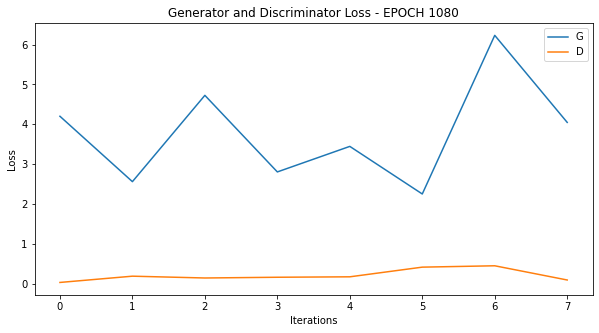

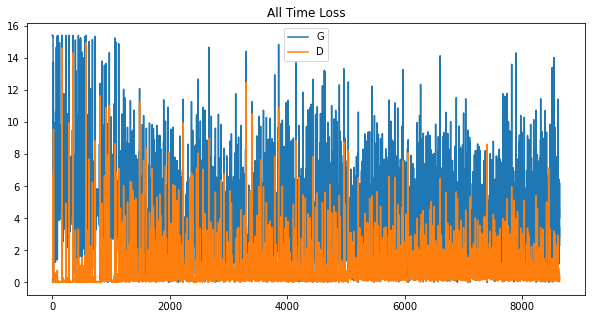

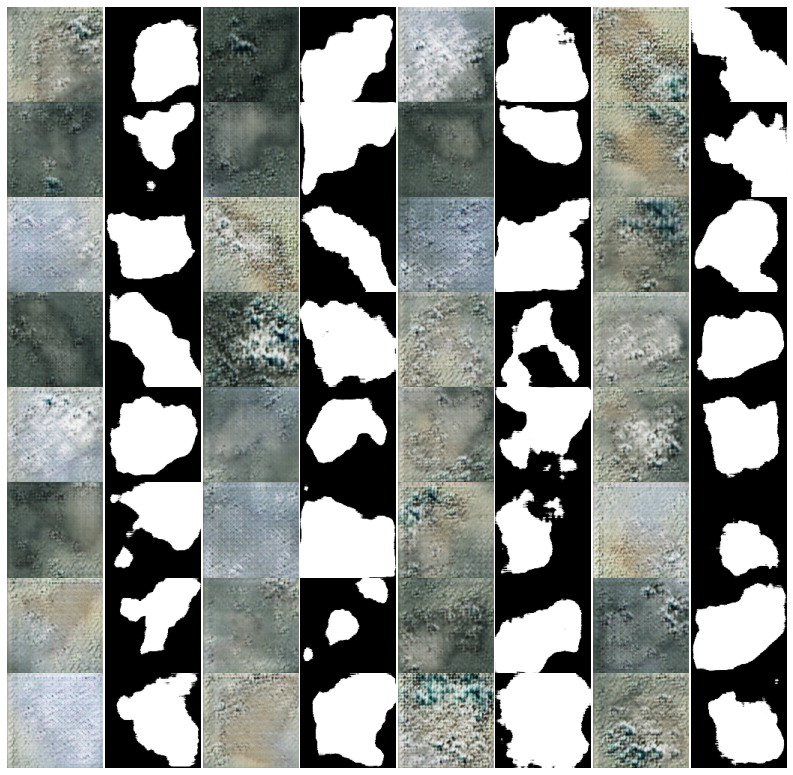





 36%|███▌      | 1080/3000 [3:06:23<6:05:29, 11.42s/it]

Epoch: 1080 computed for 14.408706903457642 sec
Gen_loss mean:  3.7836494  std:  1.2262597
Disc_loss mean:  0.20873022  std:  0.13858126






 36%|███▌      | 1081/3000 [3:06:33<5:54:58, 11.10s/it]

Epoch: 1081 computed for 10.332746982574463 sec
Gen_loss mean:  4.4525757  std:  3.8282638
Disc_loss mean:  1.1732198  std:  1.911414






 36%|███▌      | 1082/3000 [3:06:43<5:45:38, 10.81s/it]

Epoch: 1082 computed for 10.133150815963745 sec
Gen_loss mean:  2.7797487  std:  0.36577967
Disc_loss mean:  0.26448137  std:  0.08815982






 36%|███▌      | 1083/3000 [3:06:54<5:39:24, 10.62s/it]

Epoch: 1083 computed for 10.163110971450806 sec
Gen_loss mean:  3.661336  std:  1.8969791
Disc_loss mean:  0.47089297  std:  0.19908276






 36%|███▌      | 1084/3000 [3:07:04<5:34:11, 10.47s/it]

Epoch: 1084 computed for 10.08525824546814 sec
Gen_loss mean:  3.7710996  std:  1.9802958
Disc_loss mean:  0.5240184  std:  0.5387612






 36%|███▌      | 1085/3000 [3:07:14<5:31:24, 10.38s/it]

Epoch: 1085 computed for 10.180722951889038 sec
Gen_loss mean:  3.7666557  std:  3.0169854
Disc_loss mean:  0.89501375  std:  0.9163579






 36%|███▌      | 1086/3000 [3:07:24<5:28:30, 10.30s/it]

Epoch: 1086 computed for 10.084272384643555 sec
Gen_loss mean:  3.2616265  std:  1.4674923
Disc_loss mean:  0.32944375  std:  0.20727162






 36%|███▌      | 1087/3000 [3:07:34<5:26:49, 10.25s/it]

Epoch: 1087 computed for 10.126392602920532 sec
Gen_loss mean:  3.232654  std:  0.49840757
Disc_loss mean:  0.2203542  std:  0.059251625






 36%|███▋      | 1088/3000 [3:07:44<5:25:20, 10.21s/it]

Epoch: 1088 computed for 10.097113132476807 sec
Gen_loss mean:  4.227375  std:  3.2155416
Disc_loss mean:  0.8853252  std:  0.8205876






 36%|███▋      | 1089/3000 [3:07:54<5:25:22, 10.22s/it]

Epoch: 1089 computed for 10.217773675918579 sec
Gen_loss mean:  3.3319216  std:  0.5644209
Disc_loss mean:  0.24864852  std:  0.115188226






 36%|███▋      | 1090/3000 [3:08:05<5:24:01, 10.18s/it]

Epoch: 1090 computed for 10.077243328094482 sec
Gen_loss mean:  3.7497077  std:  2.4885979
Disc_loss mean:  0.67768496  std:  0.51147765






 36%|███▋      | 1091/3000 [3:08:15<5:23:18, 10.16s/it]

Epoch: 1091 computed for 10.106338739395142 sec
Gen_loss mean:  3.8088741  std:  1.8084042
Disc_loss mean:  0.2887137  std:  0.18906228






 36%|███▋      | 1092/3000 [3:08:25<5:23:42, 10.18s/it]

Epoch: 1092 computed for 10.206619501113892 sec
Gen_loss mean:  4.3537626  std:  3.2175596
Disc_loss mean:  0.71481717  std:  0.9265727






 36%|███▋      | 1093/3000 [3:08:35<5:23:48, 10.19s/it]

Epoch: 1093 computed for 10.192153453826904 sec
Gen_loss mean:  3.6685066  std:  0.8736281
Disc_loss mean:  0.17113122  std:  0.066254556






 36%|███▋      | 1094/3000 [3:08:45<5:23:33, 10.19s/it]

Epoch: 1094 computed for 10.159668207168579 sec
Gen_loss mean:  3.631932  std:  0.67718065
Disc_loss mean:  0.15165895  std:  0.045445114






 36%|███▋      | 1095/3000 [3:08:55<5:22:20, 10.15s/it]

Epoch: 1095 computed for 10.05806827545166 sec
Gen_loss mean:  4.397378  std:  1.8803684
Disc_loss mean:  0.22064255  std:  0.081617065






 37%|███▋      | 1096/3000 [3:09:06<5:22:16, 10.16s/it]

Epoch: 1096 computed for 10.150267362594604 sec
Gen_loss mean:  4.987173  std:  2.1883893
Disc_loss mean:  0.20865104  std:  0.16741082






 37%|███▋      | 1097/3000 [3:09:16<5:21:44, 10.14s/it]

Epoch: 1097 computed for 10.098865747451782 sec
Gen_loss mean:  4.34764  std:  4.028601
Disc_loss mean:  1.514091  std:  1.836423






 37%|███▋      | 1098/3000 [3:09:26<5:22:24, 10.17s/it]

Epoch: 1098 computed for 10.212787628173828 sec
Gen_loss mean:  2.833047  std:  0.5381247
Disc_loss mean:  0.1858242  std:  0.06502046






 37%|███▋      | 1099/3000 [3:09:36<5:21:52, 10.16s/it]

Epoch: 1099 computed for 10.115343570709229 sec
Gen_loss mean:  3.355988  std:  1.0801992
Disc_loss mean:  0.28443974  std:  0.1685132
Saved temporary images for evaluation.
Removed temporary image directory.






 37%|███▋      | 1100/3000 [3:09:51<6:11:58, 11.75s/it]

Epoch: 1100 computed for 15.415449619293213 sec
Gen_loss mean:  3.4219124  std:  1.782494
Disc_loss mean:  1.0497272  std:  1.2234125






 37%|███▋      | 1101/3000 [3:10:02<5:56:56, 11.28s/it]

Epoch: 1101 computed for 10.172251462936401 sec
Gen_loss mean:  2.8494802  std:  0.35336962
Disc_loss mean:  0.20299783  std:  0.042374924






 37%|███▋      | 1102/3000 [3:10:12<5:45:44, 10.93s/it]

Epoch: 1102 computed for 10.100989818572998 sec
Gen_loss mean:  3.0052578  std:  0.7204461
Disc_loss mean:  0.35926294  std:  0.16440417






 37%|███▋      | 1103/3000 [3:10:22<5:37:42, 10.68s/it]

Epoch: 1103 computed for 10.089016199111938 sec
Gen_loss mean:  3.5423393  std:  2.464379
Disc_loss mean:  0.707345  std:  0.7946764






 37%|███▋      | 1104/3000 [3:10:32<5:32:17, 10.52s/it]

Epoch: 1104 computed for 10.108920335769653 sec
Gen_loss mean:  3.4862428  std:  1.0866635
Disc_loss mean:  0.20468646  std:  0.08741296






 37%|███▋      | 1105/3000 [3:10:42<5:29:02, 10.42s/it]

Epoch: 1105 computed for 10.178465604782104 sec
Gen_loss mean:  3.4693756  std:  1.1225274
Disc_loss mean:  0.2470069  std:  0.0582701






 37%|███▋      | 1106/3000 [3:10:52<5:26:04, 10.33s/it]

Epoch: 1106 computed for 10.107022047042847 sec
Gen_loss mean:  3.0536275  std:  2.4928691
Disc_loss mean:  1.5065465  std:  1.6015403






 37%|███▋      | 1107/3000 [3:11:02<5:24:13, 10.28s/it]

Epoch: 1107 computed for 10.137702941894531 sec
Gen_loss mean:  2.439035  std:  0.43892053
Disc_loss mean:  0.27299702  std:  0.04901633






 37%|███▋      | 1108/3000 [3:11:13<5:22:34, 10.23s/it]

Epoch: 1108 computed for 10.105615854263306 sec
Gen_loss mean:  2.2964315  std:  1.4298496
Disc_loss mean:  1.0362048  std:  0.80798554






 37%|███▋      | 1109/3000 [3:11:23<5:21:07, 10.19s/it]

Epoch: 1109 computed for 10.078893184661865 sec
Gen_loss mean:  1.8921907  std:  0.3112207
Disc_loss mean:  0.49105367  std:  0.13949247






 37%|███▋      | 1110/3000 [3:11:33<5:20:30, 10.18s/it]

Epoch: 1110 computed for 10.127906799316406 sec
Gen_loss mean:  2.611988  std:  0.96281385
Disc_loss mean:  0.43530428  std:  0.14043751






 37%|███▋      | 1111/3000 [3:11:43<5:19:27, 10.15s/it]

Epoch: 1111 computed for 10.067656755447388 sec
Gen_loss mean:  2.9938412  std:  1.3366814
Disc_loss mean:  0.5115634  std:  0.6604854






 37%|███▋      | 1112/3000 [3:11:53<5:19:44, 10.16s/it]

Epoch: 1112 computed for 10.174662113189697 sec
Gen_loss mean:  3.7007215  std:  3.6408372
Disc_loss mean:  1.1274412  std:  2.025196






 37%|███▋      | 1113/3000 [3:12:03<5:18:42, 10.13s/it]

Epoch: 1113 computed for 10.055475234985352 sec
Gen_loss mean:  2.652771  std:  1.3989669
Disc_loss mean:  0.47379196  std:  0.27707174






 37%|███▋      | 1114/3000 [3:12:13<5:18:45, 10.14s/it]

Epoch: 1114 computed for 10.140322923660278 sec
Gen_loss mean:  3.7566833  std:  1.9928244
Disc_loss mean:  0.49925688  std:  0.5055683






 37%|███▋      | 1115/3000 [3:12:23<5:18:18, 10.13s/it]

Epoch: 1115 computed for 10.092265844345093 sec
Gen_loss mean:  2.5555089  std:  0.849886
Disc_loss mean:  0.36051163  std:  0.11076046






 37%|███▋      | 1116/3000 [3:12:34<5:17:52, 10.12s/it]

Epoch: 1116 computed for 10.086602449417114 sec
Gen_loss mean:  3.8203712  std:  1.1852561
Disc_loss mean:  0.29260704  std:  0.2519475






 37%|███▋      | 1117/3000 [3:12:44<5:17:43, 10.12s/it]

Epoch: 1117 computed for 10.10664415359497 sec
Gen_loss mean:  4.3566227  std:  2.7474978
Disc_loss mean:  1.3588198  std:  1.6771678






 37%|███▋      | 1118/3000 [3:12:54<5:17:08, 10.11s/it]

Epoch: 1118 computed for 10.066892147064209 sec
Gen_loss mean:  2.1714625  std:  0.53447014
Disc_loss mean:  0.29651153  std:  0.08312695






 37%|███▋      | 1119/3000 [3:13:04<5:17:02, 10.11s/it]

Epoch: 1119 computed for 10.094003200531006 sec
Gen_loss mean:  2.1478262  std:  0.3122297
Disc_loss mean:  0.4079966  std:  0.10412612


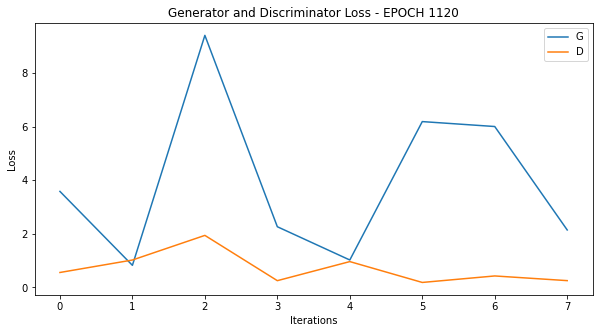

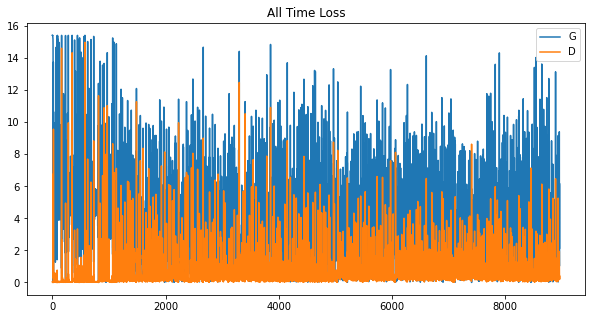

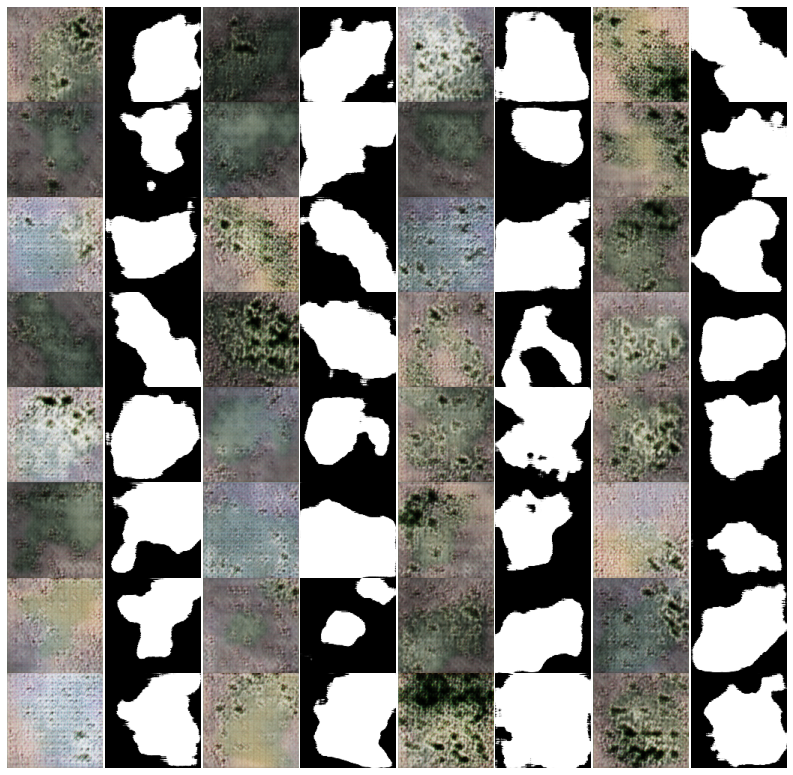





 37%|███▋      | 1120/3000 [3:13:18<5:56:37, 11.38s/it]

Epoch: 1120 computed for 14.301990747451782 sec
Gen_loss mean:  3.927037  std:  2.8192487
Disc_loss mean:  0.69732994  std:  0.55620605






 37%|███▋      | 1121/3000 [3:13:29<5:46:57, 11.08s/it]

Epoch: 1121 computed for 10.358289241790771 sec
Gen_loss mean:  3.096963  std:  1.2713718
Disc_loss mean:  0.40424487  std:  0.1742319






 37%|███▋      | 1122/3000 [3:13:39<5:39:36, 10.85s/it]

Epoch: 1122 computed for 10.298680067062378 sec
Gen_loss mean:  3.8110664  std:  2.3407538
Disc_loss mean:  0.58873844  std:  0.45815825






 37%|███▋      | 1123/3000 [3:13:49<5:33:12, 10.65s/it]

Epoch: 1123 computed for 10.15965723991394 sec
Gen_loss mean:  3.3482287  std:  1.1204542
Disc_loss mean:  0.30467206  std:  0.28040665






 37%|███▋      | 1124/3000 [3:13:59<5:28:26, 10.50s/it]

Epoch: 1124 computed for 10.149186849594116 sec
Gen_loss mean:  3.003331  std:  1.0768731
Disc_loss mean:  0.33979768  std:  0.15709276






 38%|███▊      | 1125/3000 [3:14:09<5:24:43, 10.39s/it]

Epoch: 1125 computed for 10.107563972473145 sec
Gen_loss mean:  4.6449957  std:  2.7219594
Disc_loss mean:  0.47928464  std:  0.28012967






 38%|███▊      | 1126/3000 [3:14:19<5:21:39, 10.30s/it]

Epoch: 1126 computed for 10.069240808486938 sec
Gen_loss mean:  3.5923371  std:  2.5876706
Disc_loss mean:  1.6434131  std:  1.9463052






 38%|███▊      | 1127/3000 [3:14:30<5:20:46, 10.28s/it]

Epoch: 1127 computed for 10.206475019454956 sec
Gen_loss mean:  2.4660292  std:  0.8905892
Disc_loss mean:  0.44387951  std:  0.15587722






 38%|███▊      | 1128/3000 [3:14:40<5:19:54, 10.25s/it]

Epoch: 1128 computed for 10.18607497215271 sec
Gen_loss mean:  2.7647932  std:  2.7776272
Disc_loss mean:  1.4342074  std:  1.6371154






 38%|███▊      | 1129/3000 [3:14:50<5:17:59, 10.20s/it]

Epoch: 1129 computed for 10.051913261413574 sec
Gen_loss mean:  1.9980987  std:  0.37439692
Disc_loss mean:  0.49240655  std:  0.0709974






 38%|███▊      | 1130/3000 [3:15:00<5:16:49, 10.17s/it]

Epoch: 1130 computed for 10.075026035308838 sec
Gen_loss mean:  2.0993752  std:  0.46693027
Disc_loss mean:  0.49916136  std:  0.13337633






 38%|███▊      | 1131/3000 [3:15:10<5:16:31, 10.16s/it]

Epoch: 1131 computed for 10.13786244392395 sec
Gen_loss mean:  3.0092828  std:  1.8243467
Disc_loss mean:  0.6383387  std:  0.53417134






 38%|███▊      | 1132/3000 [3:15:20<5:15:58, 10.15s/it]

Epoch: 1132 computed for 10.099926233291626 sec
Gen_loss mean:  2.4350648  std:  1.07528
Disc_loss mean:  0.5216917  std:  0.46579295






 38%|███▊      | 1133/3000 [3:15:30<5:15:53, 10.15s/it]

Epoch: 1133 computed for 10.14393925666809 sec
Gen_loss mean:  3.031388  std:  1.76746
Disc_loss mean:  0.53706735  std:  0.63538486






 38%|███▊      | 1134/3000 [3:15:40<5:14:51, 10.12s/it]

Epoch: 1134 computed for 10.04313349723816 sec
Gen_loss mean:  2.8623118  std:  0.78869885
Disc_loss mean:  0.36377573  std:  0.17020646






 38%|███▊      | 1135/3000 [3:15:51<5:15:19, 10.14s/it]

Epoch: 1135 computed for 10.175363540649414 sec
Gen_loss mean:  3.8386977  std:  2.07162
Disc_loss mean:  0.5792738  std:  0.46845233






 38%|███▊      | 1136/3000 [3:16:01<5:14:23, 10.12s/it]

Epoch: 1136 computed for 10.0465567111969 sec
Gen_loss mean:  4.0941334  std:  1.5595777
Disc_loss mean:  0.26889062  std:  0.08358317






 38%|███▊      | 1137/3000 [3:16:11<5:14:20, 10.12s/it]

Epoch: 1137 computed for 10.11924409866333 sec
Gen_loss mean:  5.0664425  std:  3.3626792
Disc_loss mean:  0.92880315  std:  1.4975827






 38%|███▊      | 1138/3000 [3:16:21<5:14:17, 10.13s/it]

Epoch: 1138 computed for 10.11829161643982 sec
Gen_loss mean:  3.1789694  std:  1.1802442
Disc_loss mean:  0.2620356  std:  0.20539589






 38%|███▊      | 1139/3000 [3:16:31<5:13:51, 10.12s/it]

Epoch: 1139 computed for 10.08470892906189 sec
Gen_loss mean:  3.2003613  std:  1.1251192
Disc_loss mean:  0.36718944  std:  0.17462273






 38%|███▊      | 1140/3000 [3:16:41<5:14:13, 10.14s/it]

Epoch: 1140 computed for 10.159295320510864 sec
Gen_loss mean:  3.065456  std:  2.1165276
Disc_loss mean:  1.1380827  std:  1.5423144






 38%|███▊      | 1141/3000 [3:16:51<5:13:37, 10.12s/it]

Epoch: 1141 computed for 10.073683023452759 sec
Gen_loss mean:  3.5378375  std:  2.091577
Disc_loss mean:  0.5443602  std:  0.48981753






 38%|███▊      | 1142/3000 [3:17:02<5:13:44, 10.13s/it]

Epoch: 1142 computed for 10.138858795166016 sec
Gen_loss mean:  3.014412  std:  1.4403424
Disc_loss mean:  0.5577247  std:  0.33485717






 38%|███▊      | 1143/3000 [3:17:12<5:13:52, 10.14s/it]

Epoch: 1143 computed for 10.145247459411621 sec
Gen_loss mean:  3.0532994  std:  0.6582431
Disc_loss mean:  0.25800544  std:  0.09701737






 38%|███▊      | 1144/3000 [3:17:22<5:13:37, 10.14s/it]

Epoch: 1144 computed for 10.116604089736938 sec
Gen_loss mean:  3.8636336  std:  1.2562038
Disc_loss mean:  0.20185833  std:  0.055402085






 38%|███▊      | 1145/3000 [3:17:32<5:12:55, 10.12s/it]

Epoch: 1145 computed for 10.065807580947876 sec
Gen_loss mean:  4.776897  std:  2.7615938
Disc_loss mean:  1.6013324  std:  2.447918






 38%|███▊      | 1146/3000 [3:17:42<5:12:28, 10.11s/it]

Epoch: 1146 computed for 10.075812339782715 sec
Gen_loss mean:  2.2646427  std:  0.4444988
Disc_loss mean:  0.3661296  std:  0.058836702






 38%|███▊      | 1147/3000 [3:17:52<5:12:30, 10.12s/it]

Epoch: 1147 computed for 10.119709491729736 sec
Gen_loss mean:  2.6639528  std:  1.2841858
Disc_loss mean:  0.56257135  std:  0.2239724






 38%|███▊      | 1148/3000 [3:18:02<5:11:55, 10.11s/it]

Epoch: 1148 computed for 10.05973219871521 sec
Gen_loss mean:  3.0520384  std:  1.8073771
Disc_loss mean:  0.6273664  std:  0.3775123






 38%|███▊      | 1149/3000 [3:18:12<5:12:36, 10.13s/it]

Epoch: 1149 computed for 10.18086862564087 sec
Gen_loss mean:  3.8413033  std:  2.728362
Disc_loss mean:  0.99476814  std:  1.3138038
Saved temporary images for evaluation.
Removed temporary image directory.






 38%|███▊      | 1150/3000 [3:18:28<6:01:05, 11.71s/it]

Epoch: 1150 computed for 15.35961651802063 sec
Gen_loss mean:  2.4755278  std:  0.8179828
Disc_loss mean:  0.4037556  std:  0.2148281






 38%|███▊      | 1151/3000 [3:18:38<5:46:55, 11.26s/it]

Epoch: 1151 computed for 10.182774782180786 sec
Gen_loss mean:  2.9603176  std:  0.96258044
Disc_loss mean:  0.36913428  std:  0.16050598


In [ ]:
#%%time
train(crack_features_data, EPOCHS)

In [ ]:
plot_losses(G_loss, D_loss, all_gl, all_dl, epoch + 1)

NameError: ignored

In [ ]:
!rm -rf '/content/training_checkpoints'

In [ ]:
!rm -f *.png

&nbsp;&nbsp;&nbsp;As we can observe, the MIFID steadily improves for 260 epochs (~ 8 hours). The best score that I achieved using this model during the competition was <b>55.87</b> (on the public dataset). The learning process does tend to be somewhat random so I think a score around the region of <b>[50, 65]</b> should be realistic.

In [ ]:
%cp '/content/image_at_epoch_0500.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_0600.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_0700.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_0800.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_0900.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_1000.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_1100.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_1200.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_1300.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_1400.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_1500.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_1600.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_1700.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_1800.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_1900.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_2000.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_2100.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_2200.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_2300.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_2400.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_2500.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_2600.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_2700.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_2800.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_2900.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'
%cp '/content/image_at_epoch_3000.png' '/content/drive/My Drive/Colab Notebooks/crack_cfd/'

### Generate a test image

&nbsp;&nbsp;&nbsp;We can also reuse one of the previous functions to generate a single random dog image.

In [ ]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [ ]:
generate_test_image(dog_generator)

### Generate 10000 images for submission and save them to a zip file

In [ ]:
#zip_images()

### Create an animated GIF using the training images

In [ ]:
# Display a single image using the epoch number
def display_image(epoch_no):
    return Image.open('./training_checkpoints/image_at_epoch_{:04d}.png'.format(epoch_no))

In [ ]:
display_image(EPOCHS)

FileNotFoundError: ignored

In [ ]:
anim_file = 'dcgan3.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('image*.png')
    filenames = sorted(filenames)
    last = -1
    for i,filename in enumerate(filenames):
        frame = 1*(i**2)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

import IPython
if IPython.version_info > (6,2,0,''):
    IPython.display.Image(filename=anim_file)

In [ ]:
%cp '/content/dcgan3.gif' '/content/drive/My Drive/DamageDetection'

In [ ]:
%cp '/content/training_checkpoints/ckpt-31.data-00000-of-00002' '/content/drive/My Drive/DamageDetection'

In [ ]:
%cp '/content/training_checkpoints/ckpt-31.data-00001-of-00002' '/content/drive/My Drive/DamageDetection'

In [ ]:
%cp '/content/training_checkpoints/ckpt-31.index' '/content/drive/My Drive/DamageDetection'

In [ ]:
%cp '/content/training_checkpoints/checkpoint' '/content/drive/My Drive/DamageDetection'

## Conclusion

&nbsp;&nbsp;&nbsp;To sum up, <b>DCGANs</b> seem to be extremely sensitive to hyperparameter choice and a lot of problems can arise during training, including <b>Mode Collapse</b>. They are also very computationally intensive and it is incredibly hard to build a high-scoring model for a runtime of <b>~9 hours</b>. Fortunately, there is a whole bucket list of possible methods and techniques that are well-documented and can be easily applied to your model to stabilize the training process.

&nbsp;&nbsp;&nbsp;For me personally, it was really fun to toy around with these techniques and break a few kernels in the process :D. Feel free to leave any suggestions down in the comments (for improving the model or fixing something that I messed up).

&nbsp;&nbsp;&nbsp;If this kernel helped you in any way, feel free to leave an upvote. Also big thanks to <b>Chris Deotte, Nanashi, Chad Malla and Nirjhar Roy</b> for their kernels. I'll leave links to them down below.

## References

### Useful Kernels and notebooks

[1]. My previous kernel on [EDA and image preprocessing](https://www.kaggle.com/jadeblue/dog-generator-starter-eda-preprocessing)

[2]. [Xml parsing and cropping to specified bounding box](https://www.kaggle.com/paulorzp/show-annotations-and-breeds)

[3]. [Image cropping method with interpolation](https://www.kaggle.com/amanooo/wgan-gp-keras)

[4]. [Another great Keras-based DCGAN approach by Chad Malla](https://www.kaggle.com/cmalla94/dcgan-generating-dog-images-with-tensorflow)

[5]. [DCGAN hacks for improving your model performance](https://www.kaggle.com/c/generative-dog-images/discussion/98595)

[6]. [Tensorflow DCGAN tutorial](https://www.tensorflow.org/beta/tutorials/generative/dcgan)

[7]. [DCGAN Dogs Images by Nanashi](https://www.kaggle.com/jesucristo/introducing-dcgan-dogs-images)

[8]. [GAN dogs starter 24-Jul -Custom Layers by Nirjhar Roy](https://www.kaggle.com/phoenix9032/gan-dogs-starter-24-jul-custom-layers)

[9]. [Supervised Generative Dog Net by Chris Deotte](https://www.kaggle.com/cdeotte/supervised-generative-dog-net)

[10]. [My best submission for this competition](https://www.kaggle.com/jadeblue/dogdcgan-v6-ksize)

### Research papers, posts and discussions

[1]. [Generative Adversarial Networks official paper](https://arxiv.org/pdf/1406.2661.pdf)

[2]. [Understanding Generative Adversarial Networks (GANs)](https://towardsdatascience.com/understanding-generative-adversarial-networks-gans-cd6e4651a29)

[3]. [A Gentle Introduction to Generative Adversarial Networks (GANs)](https://machinelearningmastery.com/what-are-generative-adversarial-networks-gans/)

[4]. [DCGAN official paper](https://arxiv.org/pdf/1511.06434.pdf)

[5]. [GAN — DCGAN (Deep convolutional generative adversarial networks)](https://medium.com/@jonathan_hui/gan-dcgan-deep-convolutional-generative-adversarial-networks-df855c438f)

[6]. [Weight Initialization Techniques in Neural Networks](https://towardsdatascience.com/weight-initialization-techniques-in-neural-networks-26c649eb3b78)

[7]. [Spectral Normalization for Generative Adversarial Networks paper](https://arxiv.org/pdf/1802.05957.pdf)

[8]. [Spectral Normalization implemented in Keras](https://github.com/IShengFang/SpectralNormalizationKeras)

[9]. [Spectral Normalization Explained](https://christiancosgrove.com/blog/2018/01/04/spectral-normalization-explained.html)

[10]. [GAN — Ways to improve GAN performance](https://towardsdatascience.com/gan-ways-to-improve-gan-performance-acf37f9f59b)

[11]. [How to Implement GAN Hacks in Keras to Train Stable Models](https://machinelearningmastery.com/how-to-code-generative-adversarial-network-hacks/)

[12]. [Tricks of GANS](https://lanpartis.github.io/deep%20learning/2018/03/12/tricks-of-gans.html)

[13]. [Instance Noise: A trick for stabilising GAN training](https://www.inference.vc/instance-noise-a-trick-for-stabilising-gan-training/)

[14]. [GAN — RSGAN & RaGAN (A new generation of cost function.)](https://medium.com/@jonathan_hui/gan-rsgan-ragan-a-new-generation-of-cost-function-84c5374d3c6e)

[15]. [A simple explanation of the Inception Score](https://medium.com/octavian-ai/a-simple-explanation-of-the-inception-score-372dff6a8c7a)

[16]. [GAN — How to measure GAN performance?](https://medium.com/@jonathan_hui/gan-how-to-measure-gan-performance-64b988c47732)

[17]. [All you need is GAN Hacks](https://www.kaggle.com/c/generative-dog-images/discussion/98595#latest-582912)

[18]. [How to train your touchy GANs - Things that seem to work.](https://www.kaggle.com/c/generative-dog-images/discussion/102155#latest-599429)

[19]. [Explaining the metric FID](https://www.kaggle.com/c/generative-dog-images/discussion/97809#latest-591866)